In [562]:
from numpy import asarray
import numpy as np
import random
import matplotlib.pyplot as plt
import matplotlib.ticker as plticker
import cv2
from statistics import mode
from collections import  Counter
import math 
import skimage
from PIL import Image

from skimage import io, measure, color
from skimage.restoration import denoise_tv_chambolle

from sklearn.cluster import KMeans
from sklearn.metrics import cohen_kappa_score

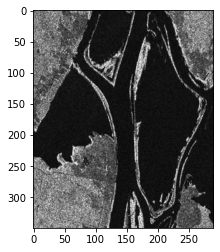

In [607]:
im1_path  = r'C:\Users\Asus\Desktop\AUT\Semister 2\DIP\proje\Ottawa_data\ottawa_1.bmp'
im2_path  =  r'C:\Users\Asus\Desktop\AUT\Semister 2\DIP\proje\Ottawa_data\ottawa_2.bmp'
imgt_path =  r'C:\Users\Asus\Desktop\AUT\Semister 2\DIP\proje\Ottawa_data\ottawa_gt.bmp'

im1 = io.imread(im1_path)
im1_gray= cv2.cvtColor(im1, cv2.COLOR_BGR2GRAY)
im2 = io.imread(im2_path)
im2_gray= cv2.cvtColor(im2, cv2.COLOR_BGR2GRAY)
im_gt = io.imread(imgt_path)
im_gt= cv2.cvtColor(im_gt, cv2.COLOR_BGR2GRAY)

plt.imshow(im1_gray, cmap='gray')

In [395]:
def logTrans (img):
    c  = 255/(np.log(1 + np.max(img)))
  #255/(math.log10(1+ np.amax(img)))
    img_log=img.copy()
    for i in range(0, img.shape[0]):
        for j in range(0, img.shape[1]):
            img_log[i][j] = c* np.log(img[i][j] + 1)
    print(c)
 # log_transformed = c * (np.log(img + 1))  
#  log_transformed = np.array(log_transformed, dtype = np.uint8) 
    plt.imshow(img_log, cmap='gray')
    
    plt.axis('off')
    return img_log

45.98590442833571


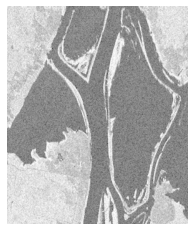

In [614]:

img1_log = logTrans(im1_gray)
img1_log=normalizer(img1_log)




45.98590442833571


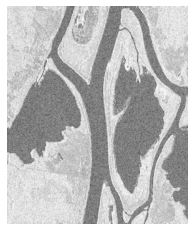

In [609]:
img2_log = logTrans(im2_gray)
img2_log=normalizer(img2_log)



In [398]:


def morphology(s1,s2,s3,s4, img):
  kernel1_S1= np.ones(s1,np.uint8)
  kernel1_S2= np.ones(s2,np.uint8)
  kernel1_S3= np.ones(s3,np.uint8)
  kernel1_S4= np.ones(s4,np.uint8)

  closing11 = cv2.morphologyEx(img, cv2.MORPH_CLOSE, kernel1_S1)
  closing12 = cv2.morphologyEx(img, cv2.MORPH_CLOSE, kernel1_S2)
  closing1= closing11.copy()

  for i in range(closing11.shape[0]):
    for j in range(closing11.shape[1]):
      closing1[i][j]= np.minimum(closing11[i][j], closing12[i][j])

  opening11 = cv2.morphologyEx(closing1, cv2.MORPH_OPEN, kernel1_S1)
  opening12 = cv2.morphologyEx(closing1, cv2.MORPH_OPEN, kernel1_S2)
  opening1 =opening12.copy()

  for i in range(opening11.shape[0]):
    for j in range(opening11.shape[1]):
      opening1[i][j]= np.maximum(opening11[i][j], opening12[i][j])


  ###########################


  closing13 = cv2.morphologyEx(opening1, cv2.MORPH_CLOSE, kernel1_S3)
  closing14 = cv2.morphologyEx(opening1, cv2.MORPH_CLOSE, kernel1_S4)
  closing2= closing13.copy()

  for i in range(closing13.shape[0]):
    for j in range(closing13.shape[1]):
      closing2[i][j]= np.minimum(closing13[i][j], closing14[i][j])

  opening13 = cv2.morphologyEx(closing2, cv2.MORPH_OPEN, kernel1_S3)
  opening14 = cv2.morphologyEx(closing2, cv2.MORPH_OPEN, kernel1_S4)
  opening2 =opening13.copy()

  for i in range(opening13.shape[0]):
    for j in range(opening13.shape[1]):
      opening2[i][j]= np.maximum(opening13[i][j], opening14[i][j])


  ############################


  fig= plt.figure(figsize=(15, 10))
  ax1 = fig.add_subplot(231)
  ax2 = fig.add_subplot(232)
  ax3 = fig.add_subplot(233)
  ax4 = fig.add_subplot(234)
  ax5 = fig.add_subplot(235)

  ax1.imshow(img, cmap='gray')
  ax1.set_title('logarithmic image')
  ax1.axis('off')

  ax2.imshow(closing1, cmap='gray')
  ax2.set_title('Min of closing')
  ax2.axis('off')

  ax3.imshow(opening1, cmap='gray')
  ax3.set_title('max of opening')
  ax3.axis('off')

  ax4.imshow(closing2, cmap='gray')
  ax4.set_title('Min of closing in part 2')
  ax4.axis('off')

  ax5.imshow(opening2, cmap='gray')
  ax5.set_title('final')
  ax5.axis('off')

  plt.show() 
  return opening2






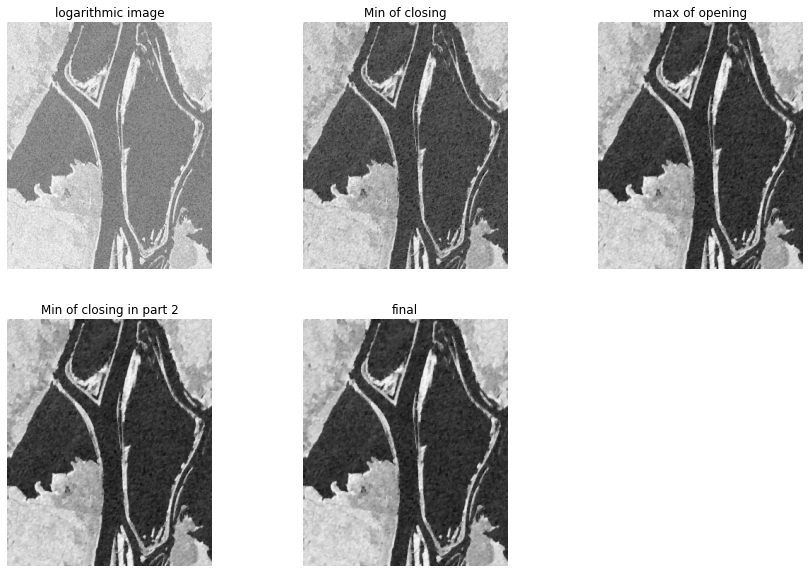

In [615]:
s1 =(1,2)
s2 =(2,1)
s3 =(1,3)
s4 =(3,1)

data1_img1 = morphology(s1,s2,s3,s4, img1_log)

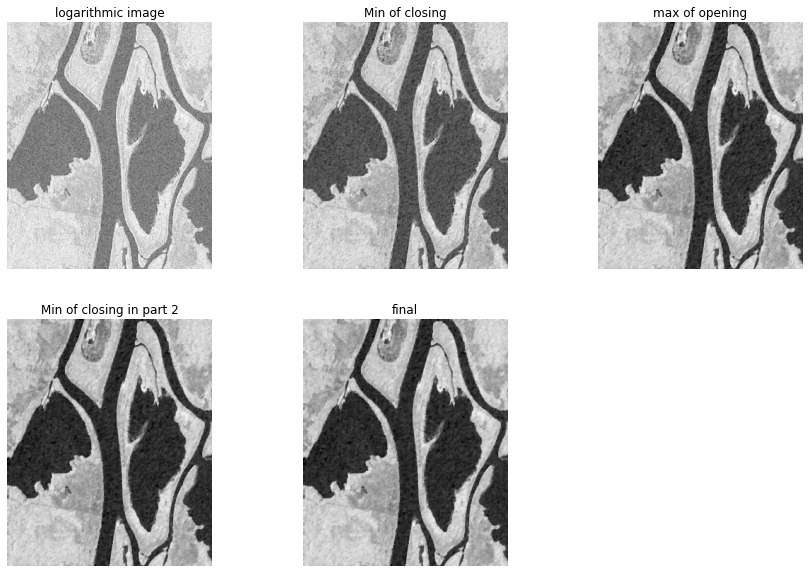

In [616]:
s1 =(1,2)
s2 =(2,1)
s3 =(1,3)
s4 =(3,1)

data1_img2 = morphology(s1,s2,s3,s4, img2_log)

In [566]:

def combined(img1 , img2 ,ground_truth, alpha, median_kernel,  ncls, init, max_iter, plotter):

  
  img1_mean = cv2.blur(img1, (3,3))
  img2_mean = cv2.blur(img2, (3,3))


  mean_ratio= img1_mean.copy()
  for i in range(img1_mean.shape[0]):
    for j in range(img1_mean.shape[1]):
      mean_ratio[i][j]= (1 - np.minimum( img1_mean[i][j]/img2_mean[i][j]  , img2_mean[i][j]/img1_mean[i][j]  ))*255


  subtraction= np.abs(img1 - img2)

  combined = (alpha * mean_ratio ) + ((1 - alpha) * subtraction)


  final = combined.copy()
  for i in range(combined.shape[0]):
    for j in range(combined.shape[1]):
      if combined[i][j] <= 0 :
        final[i][j] = -combined[i][j]
      else:
        final[i][j] = combined[i][j]
  final.astype('uint8')
  median = cv2.medianBlur(final.astype('uint8'),median_kernel)




  median_3channels = cv2.cvtColor(median.astype('uint8'), cv2.COLOR_GRAY2BGR)

  
  print('-----------------------------------------------------------')
  print('alpha is : ',alpha)
  print('median kernel is : ',median_kernel)
  
  if plotter:
    fig= plt.figure(figsize=(7, 20))
    ax1 = fig.add_subplot(421)
    ax2 = fig.add_subplot(422)
    ax3 = fig.add_subplot(423)
    ax4 = fig.add_subplot(424)
    ax5 = fig.add_subplot(425)
    ax6 = fig.add_subplot(426)



    ax1.imshow(img1_mean, cmap='gray')
    ax1.set_title('img1 mean')
    ax1.axis('off')

    ax2.imshow(img2_mean, cmap='gray')
    ax2.set_title('img2 mean')
    ax2.axis('off')

    ax3.imshow(mean_ratio, cmap='gray')
    ax3.set_title('mean ratio of 2 images')
    ax3.axis('off')

    ax4.imshow(subtraction, cmap='gray')
    ax4.set_title('subtraction of img1 and img2')
    ax4.axis('off')

    ax5.imshow(combined, cmap='gray')
    ax5.set_title('combined image')
    ax5.axis('off')

    ax6.imshow(median, cmap='gray')
    ax6.set_title('median image with kernel size of {} '.format(median_kernel) )
    ax6.axis('off')

    plt.show() 


  print('clustering image')
  kmeans_result= kmeans(median_3channels, ncls, init, max_iter )

  print('result of k means clustering')
  tp,tn,fp,fn,pcc,kaapa = results(ground_truth, kmeans_result)


  return median_3channels, kmeans_result, tp,tn,fp,fn,pcc,kaapa

In [463]:
def kmeans(img, ncls, init, max_iter):
  all_pixels  = img.reshape((-1,len(img.shape)))
  km = KMeans(n_clusters=ncls, init=init, max_iter=max_iter)
  km.fit(all_pixels)

  centers = km.cluster_centers_
  centers = np.array(centers,dtype='uint8')
  new_img = np.zeros((img.shape[0]*img.shape[1], 3),dtype='uint8')
  mode_list = mode(km.labels_) 
  for ix in range(new_img.shape[0]):
    
    if km.labels_[ix]== mode_list:
      new_img[ix] = 0
    else:
      new_img[ix] = 255
    
  new_img = new_img.reshape(img.shape)
  plt.imshow(new_img)
  im = Image.fromarray(new_img)
  im.save(r'C:\Users\Asus\Desktop\AUT\Semister 2\DIP\proje\Ottawa_data\bern_groundtruth.bmp')
  plt.show()
  return new_img

In [464]:
def results(ground_truth, img):
  tp = 0
  tn = 0
  fn = 0
  fp = 0
  result= cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
  

  for i in range(img.shape[0]):
    for j in range(img.shape[1]):
      if ground_truth[i][j] == 255 and result[i][j] == 255:
        tp = tp + 1
      if ground_truth[i][j] == 0 and result[i][j] == 0:
        tn = tn + 1
      if ground_truth[i][j] == 255 and result[i][j] == 0:
        fn = fn + 1
      if ground_truth[i][j] == 0 and result[i][j] == 255:
        fp = fp + 1

  pcc = (tp+tn)/ (result.shape[0]*result.shape[1])
  kaapa = cohen_kappa_score(ground_truth.reshape((-1,1)),result.reshape((-1,1)) )

  print('True Positive : ',tp )
  print('True Negative : ',tn )
  print('False Positive : ',fp )
  print('False Negative : ', fn)
  print('the oceral error is : ', fp + fn )
  print('the percentage correct classification : ', pcc )
  print('kappa score : ', kaapa)
  return tp,tn,fp,fn,pcc,kaapa


In [469]:
def alpha_plotter(alpha,median_kernel, pcc, kappa):
    itter= int(len(pcc)/len(median_kernel))
    counter=1
    
    for kernel in median_kernel:
        y=[]
        z=[]
        X = alpha
        
        for i in range(itter*(counter-1), itter*counter):
            y.append(pcc[i]) 
            z.append(kappa[i])
            
        plt.figure(figsize=(15, 5))
        
        plt.plot(X, y, 'o-',color='b', label='pcc')
        plt.plot(X, z,'o-', color='r', label='kappa')
        plt.xticks(np.arange(0, max(alpha)+0.1, 0.05))
        plt.yticks(np.arange(0, max(pcc)+0.1, 0.1))
        # Naming the x-axis, y-axis and the whole graph
        plt.xlabel("alpha")
        plt.ylabel("performance")
        plt.title("median {}".format( kernel))

        # Adding legend, which helps us recognize the curve according to it's color
        plt.legend()
        plt.grid(color='0.90')

        plt.show()
        print('***********************')
        print('max pcc is : ', max(y))
        print('max kaapa score is : ', max(z))
        print('***********************')
        print("     ---------------------------------------------------------------------------------------------------------------")
        
        counter+= 1

-----------------------------------------------------------
alpha is :  1
median kernel is :  5


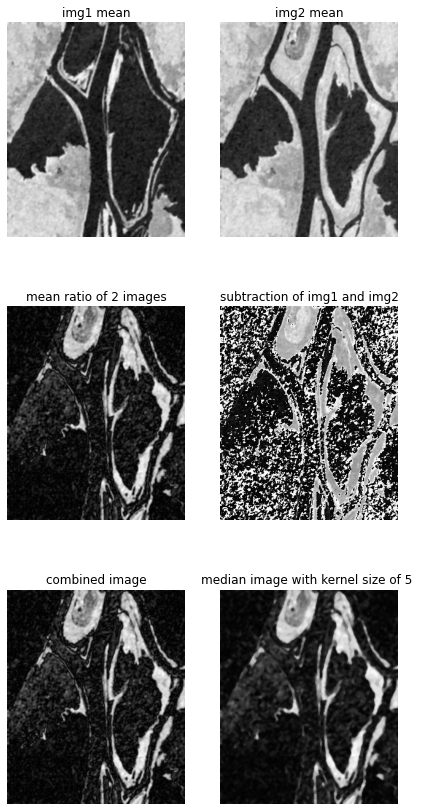

clustering image


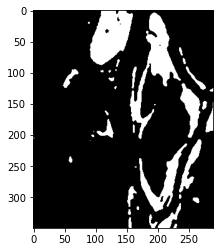

result of k means clustering
True Positive :  14358
True Negative :  84119
False Positive :  1508
False Negative :  1507
the oceral error is :  3015
the percentage correct classification :  0.9702167487684729
kappa score :  0.8871314315372869


In [617]:
median1_3channels, clustered_image, tp,tn,fp,fn,pcc,kaapa =combined(data1_img1, data1_img2 ,im_gt ,1 ,5,  2,'k-means++' , 500, True)

-----------------------------------------------------------
alpha is :  0
median kernel is :  3
clustering image


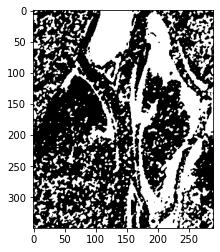

result of k means clustering
True Positive :  15564
True Negative :  60724
False Positive :  24903
False Negative :  301
the oceral error is :  25204
the percentage correct classification :  0.7516059113300493
kappa score :  0.42295922220862125
-----------------------------------------------------------
alpha is :  0.05
median kernel is :  3
clustering image


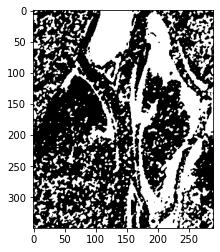

result of k means clustering
True Positive :  15564
True Negative :  60724
False Positive :  24903
False Negative :  301
the oceral error is :  25204
the percentage correct classification :  0.7516059113300493
kappa score :  0.42295922220862125
-----------------------------------------------------------
alpha is :  0.1
median kernel is :  3
clustering image


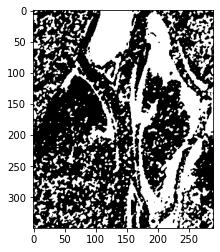

result of k means clustering
True Positive :  15564
True Negative :  60724
False Positive :  24903
False Negative :  301
the oceral error is :  25204
the percentage correct classification :  0.7516059113300493
kappa score :  0.42295922220862125
-----------------------------------------------------------
alpha is :  0.15
median kernel is :  3
clustering image


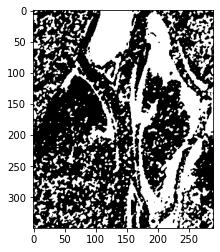

result of k means clustering
True Positive :  15564
True Negative :  60724
False Positive :  24903
False Negative :  301
the oceral error is :  25204
the percentage correct classification :  0.7516059113300493
kappa score :  0.42295922220862125
-----------------------------------------------------------
alpha is :  0.2
median kernel is :  3
clustering image


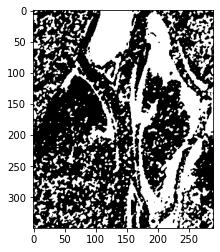

result of k means clustering
True Positive :  15564
True Negative :  60724
False Positive :  24903
False Negative :  301
the oceral error is :  25204
the percentage correct classification :  0.7516059113300493
kappa score :  0.42295922220862125
-----------------------------------------------------------
alpha is :  0.25
median kernel is :  3
clustering image


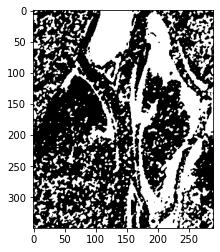

result of k means clustering
True Positive :  15564
True Negative :  60724
False Positive :  24903
False Negative :  301
the oceral error is :  25204
the percentage correct classification :  0.7516059113300493
kappa score :  0.42295922220862125
-----------------------------------------------------------
alpha is :  0.3
median kernel is :  3
clustering image


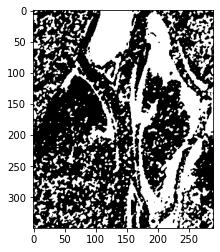

result of k means clustering
True Positive :  15564
True Negative :  60724
False Positive :  24903
False Negative :  301
the oceral error is :  25204
the percentage correct classification :  0.7516059113300493
kappa score :  0.42295922220862125
-----------------------------------------------------------
alpha is :  0.35
median kernel is :  3
clustering image


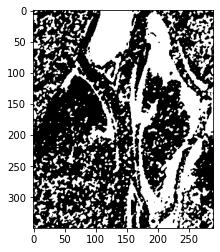

result of k means clustering
True Positive :  15564
True Negative :  60724
False Positive :  24903
False Negative :  301
the oceral error is :  25204
the percentage correct classification :  0.7516059113300493
kappa score :  0.42295922220862125
-----------------------------------------------------------
alpha is :  0.4
median kernel is :  3
clustering image


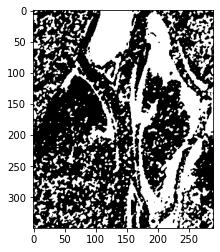

result of k means clustering
True Positive :  15564
True Negative :  60724
False Positive :  24903
False Negative :  301
the oceral error is :  25204
the percentage correct classification :  0.7516059113300493
kappa score :  0.42295922220862125
-----------------------------------------------------------
alpha is :  0.45
median kernel is :  3
clustering image


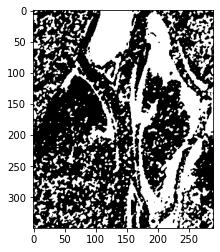

result of k means clustering
True Positive :  15564
True Negative :  60724
False Positive :  24903
False Negative :  301
the oceral error is :  25204
the percentage correct classification :  0.7516059113300493
kappa score :  0.42295922220862125
-----------------------------------------------------------
alpha is :  0.5
median kernel is :  3
clustering image


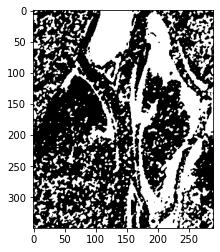

result of k means clustering
True Positive :  15564
True Negative :  60724
False Positive :  24903
False Negative :  301
the oceral error is :  25204
the percentage correct classification :  0.7516059113300493
kappa score :  0.42295922220862125
-----------------------------------------------------------
alpha is :  0.55
median kernel is :  3
clustering image


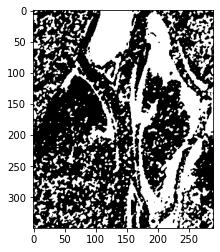

result of k means clustering
True Positive :  15564
True Negative :  60724
False Positive :  24903
False Negative :  301
the oceral error is :  25204
the percentage correct classification :  0.7516059113300493
kappa score :  0.42295922220862125
-----------------------------------------------------------
alpha is :  0.6
median kernel is :  3
clustering image


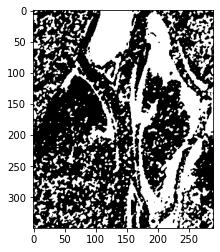

result of k means clustering
True Positive :  15564
True Negative :  60724
False Positive :  24903
False Negative :  301
the oceral error is :  25204
the percentage correct classification :  0.7516059113300493
kappa score :  0.42295922220862125
-----------------------------------------------------------
alpha is :  0.65
median kernel is :  3
clustering image


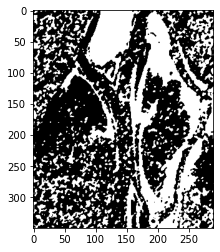

result of k means clustering
True Positive :  15564
True Negative :  60723
False Positive :  24904
False Negative :  301
the oceral error is :  25205
the percentage correct classification :  0.7515960591133005
kappa score :  0.4229454122208942
-----------------------------------------------------------
alpha is :  0.7
median kernel is :  3
clustering image


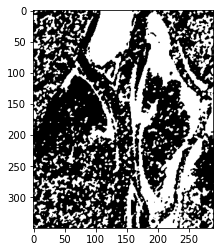

result of k means clustering
True Positive :  15567
True Negative :  60723
False Positive :  24904
False Negative :  298
the oceral error is :  25202
the percentage correct classification :  0.7516256157635468
kappa score :  0.42304130149242936
-----------------------------------------------------------
alpha is :  0.75
median kernel is :  3
clustering image


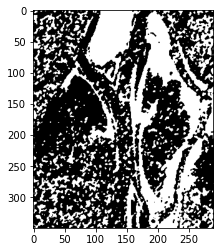

result of k means clustering
True Positive :  15573
True Negative :  60707
False Positive :  24920
False Negative :  292
the oceral error is :  25212
the percentage correct classification :  0.7515270935960591
kappa score :  0.4230121110529437
-----------------------------------------------------------
alpha is :  0.8
median kernel is :  3
clustering image


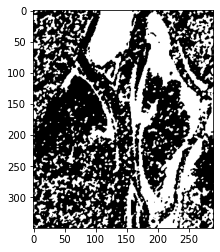

result of k means clustering
True Positive :  15581
True Negative :  60661
False Positive :  24966
False Negative :  284
the oceral error is :  25250
the percentage correct classification :  0.7511527093596059
kappa score :  0.4226329928810042
-----------------------------------------------------------
alpha is :  0.85
median kernel is :  3
clustering image


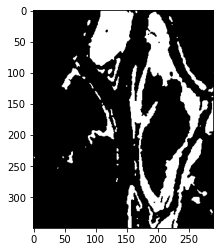

result of k means clustering
True Positive :  15304
True Negative :  80968
False Positive :  4659
False Negative :  561
the oceral error is :  5220
the percentage correct classification :  0.9484926108374384
kappa score :  0.8233740516187762
-----------------------------------------------------------
alpha is :  0.9
median kernel is :  3
clustering image


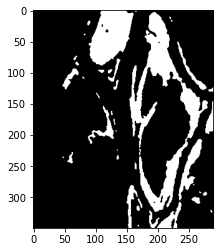

result of k means clustering
True Positive :  15065
True Negative :  82292
False Positive :  3335
False Negative :  800
the oceral error is :  4135
the percentage correct classification :  0.9591822660098522
kappa score :  0.854759028295432
-----------------------------------------------------------
alpha is :  0.95
median kernel is :  3
clustering image


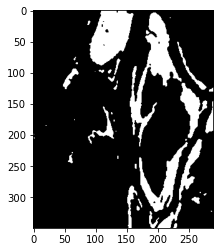

result of k means clustering
True Positive :  14767
True Negative :  83175
False Positive :  2452
False Negative :  1098
the oceral error is :  3550
the percentage correct classification :  0.9649458128078817
kappa score :  0.8716139686689707
-----------------------------------------------------------
alpha is :  1
median kernel is :  3
clustering image


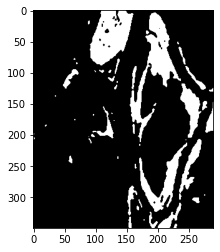

result of k means clustering
True Positive :  14262
True Negative :  83869
False Positive :  1758
False Negative :  1603
the oceral error is :  3361
the percentage correct classification :  0.966807881773399
kappa score :  0.8747081087887096
-----------------------------------------------------------
alpha is :  1.05
median kernel is :  3
clustering image


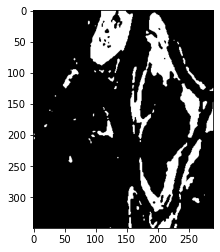

result of k means clustering
True Positive :  13631
True Negative :  84284
False Positive :  1343
False Negative :  2234
the oceral error is :  3577
the percentage correct classification :  0.964679802955665
kappa score :  0.8630089680326218
-----------------------------------------------------------
alpha is :  1.1
median kernel is :  3
clustering image


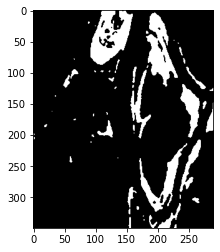

result of k means clustering
True Positive :  12612
True Negative :  84765
False Positive :  862
False Negative :  3253
the oceral error is :  4115
the percentage correct classification :  0.9593793103448276
kappa score :  0.8359760224921708
-----------------------------------------------------------
alpha is :  1.15
median kernel is :  3
clustering image


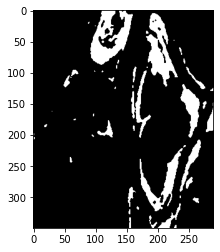

result of k means clustering
True Positive :  11673
True Negative :  85036
False Positive :  591
False Negative :  4192
the oceral error is :  4783
the percentage correct classification :  0.9527980295566503
kappa score :  0.8028794438548661
-----------------------------------------------------------
alpha is :  1.2
median kernel is :  3
clustering image


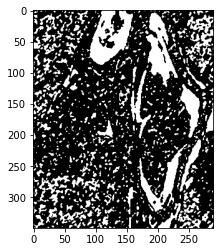

result of k means clustering
True Positive :  12494
True Negative :  69636
False Positive :  15991
False Negative :  3371
the oceral error is :  19362
the percentage correct classification :  0.8091625615763547
kappa score :  0.4536549392322642
-----------------------------------------------------------
alpha is :  1.25
median kernel is :  3
clustering image


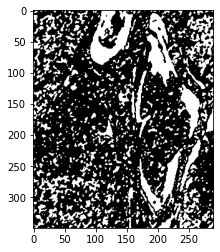

result of k means clustering
True Positive :  11709
True Negative :  67129
False Positive :  18498
False Negative :  4156
the oceral error is :  22654
the percentage correct classification :  0.7767290640394089
kappa score :  0.3814506064989379
-----------------------------------------------------------
alpha is :  1.3
median kernel is :  3
clustering image


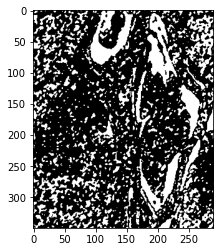

result of k means clustering
True Positive :  10738
True Negative :  66562
False Positive :  19065
False Negative :  5127
the oceral error is :  24192
the percentage correct classification :  0.761576354679803
kappa score :  0.3344146278889535
-----------------------------------------------------------
alpha is :  1.35
median kernel is :  3
clustering image


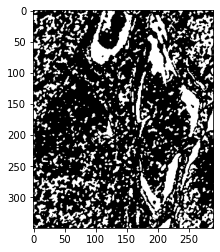

result of k means clustering
True Positive :  9673
True Negative :  66172
False Positive :  19455
False Negative :  6192
the oceral error is :  25647
the percentage correct classification :  0.7472413793103448
kappa score :  0.2852772506758142
-----------------------------------------------------------
alpha is :  1.4
median kernel is :  3
clustering image


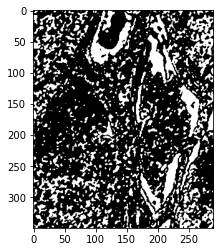

result of k means clustering
True Positive :  8514
True Negative :  65770
False Positive :  19857
False Negative :  7351
the oceral error is :  27208
the percentage correct classification :  0.7318620689655172
kappa score :  0.23062258730983698
-----------------------------------------------------------
alpha is :  1.45
median kernel is :  3
clustering image


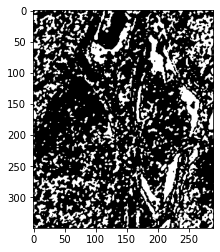

result of k means clustering
True Positive :  6973
True Negative :  65497
False Positive :  20130
False Negative :  8892
the oceral error is :  29022
the percentage correct classification :  0.7139901477832512
kappa score :  0.15861283843653473
-----------------------------------------------------------
alpha is :  1.5
median kernel is :  3
clustering image


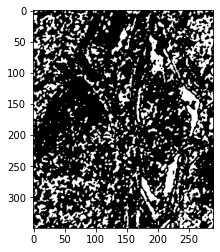

result of k means clustering
True Positive :  4771
True Negative :  65366
False Positive :  20261
False Negative :  11094
the oceral error is :  31355
the percentage correct classification :  0.6910049261083744
kappa score :  0.051840056214301544
-----------------------------------------------------------
alpha is :  0
median kernel is :  5
clustering image


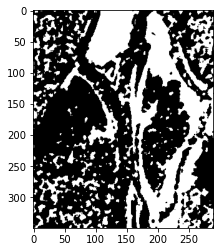

result of k means clustering
True Positive :  15638
True Negative :  63583
False Positive :  22044
False Negative :  227
the oceral error is :  22271
the percentage correct classification :  0.7805024630541872
kappa score :  0.46672541435376946
-----------------------------------------------------------
alpha is :  0.05
median kernel is :  5
clustering image


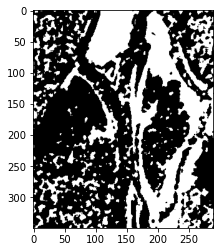

result of k means clustering
True Positive :  15638
True Negative :  63583
False Positive :  22044
False Negative :  227
the oceral error is :  22271
the percentage correct classification :  0.7805024630541872
kappa score :  0.46672541435376946
-----------------------------------------------------------
alpha is :  0.1
median kernel is :  5
clustering image


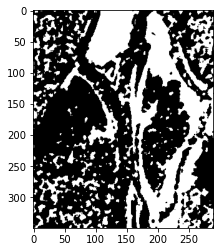

result of k means clustering
True Positive :  15638
True Negative :  63583
False Positive :  22044
False Negative :  227
the oceral error is :  22271
the percentage correct classification :  0.7805024630541872
kappa score :  0.46672541435376946
-----------------------------------------------------------
alpha is :  0.15
median kernel is :  5
clustering image


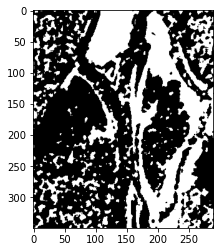

result of k means clustering
True Positive :  15638
True Negative :  63583
False Positive :  22044
False Negative :  227
the oceral error is :  22271
the percentage correct classification :  0.7805024630541872
kappa score :  0.46672541435376946
-----------------------------------------------------------
alpha is :  0.2
median kernel is :  5
clustering image


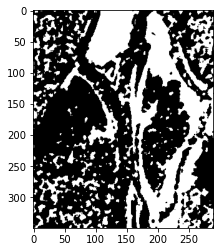

result of k means clustering
True Positive :  15638
True Negative :  63583
False Positive :  22044
False Negative :  227
the oceral error is :  22271
the percentage correct classification :  0.7805024630541872
kappa score :  0.46672541435376946
-----------------------------------------------------------
alpha is :  0.25
median kernel is :  5
clustering image


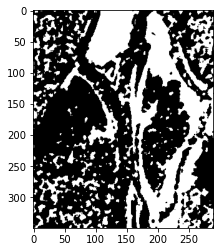

result of k means clustering
True Positive :  15638
True Negative :  63583
False Positive :  22044
False Negative :  227
the oceral error is :  22271
the percentage correct classification :  0.7805024630541872
kappa score :  0.46672541435376946
-----------------------------------------------------------
alpha is :  0.3
median kernel is :  5
clustering image


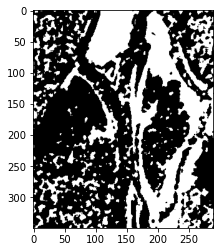

result of k means clustering
True Positive :  15638
True Negative :  63583
False Positive :  22044
False Negative :  227
the oceral error is :  22271
the percentage correct classification :  0.7805024630541872
kappa score :  0.46672541435376946
-----------------------------------------------------------
alpha is :  0.35
median kernel is :  5
clustering image


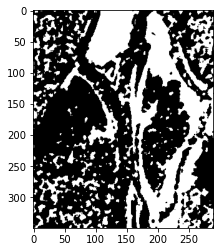

result of k means clustering
True Positive :  15638
True Negative :  63583
False Positive :  22044
False Negative :  227
the oceral error is :  22271
the percentage correct classification :  0.7805024630541872
kappa score :  0.46672541435376946
-----------------------------------------------------------
alpha is :  0.4
median kernel is :  5
clustering image


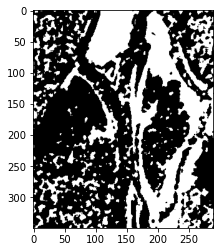

result of k means clustering
True Positive :  15638
True Negative :  63583
False Positive :  22044
False Negative :  227
the oceral error is :  22271
the percentage correct classification :  0.7805024630541872
kappa score :  0.46672541435376946
-----------------------------------------------------------
alpha is :  0.45
median kernel is :  5
clustering image


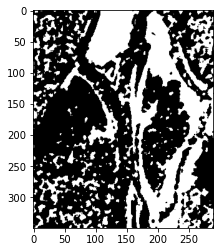

result of k means clustering
True Positive :  15639
True Negative :  63583
False Positive :  22044
False Negative :  226
the oceral error is :  22270
the percentage correct classification :  0.780512315270936
kappa score :  0.4667581232338285
-----------------------------------------------------------
alpha is :  0.5
median kernel is :  5
clustering image


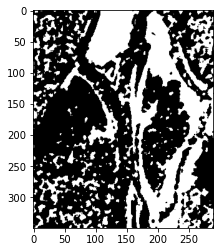

result of k means clustering
True Positive :  15639
True Negative :  63583
False Positive :  22044
False Negative :  226
the oceral error is :  22270
the percentage correct classification :  0.780512315270936
kappa score :  0.4667581232338285
-----------------------------------------------------------
alpha is :  0.55
median kernel is :  5
clustering image


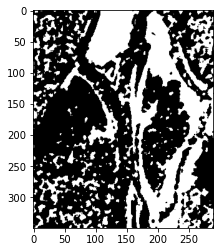

result of k means clustering
True Positive :  15639
True Negative :  63583
False Positive :  22044
False Negative :  226
the oceral error is :  22270
the percentage correct classification :  0.780512315270936
kappa score :  0.4667581232338285
-----------------------------------------------------------
alpha is :  0.6
median kernel is :  5
clustering image


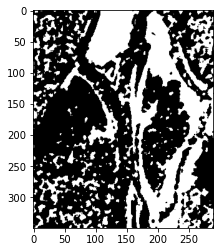

result of k means clustering
True Positive :  15639
True Negative :  63583
False Positive :  22044
False Negative :  226
the oceral error is :  22270
the percentage correct classification :  0.780512315270936
kappa score :  0.4667581232338285
-----------------------------------------------------------
alpha is :  0.65
median kernel is :  5
clustering image


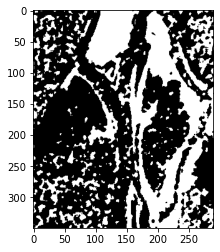

result of k means clustering
True Positive :  15641
True Negative :  63583
False Positive :  22044
False Negative :  224
the oceral error is :  22268
the percentage correct classification :  0.7805320197044335
kappa score :  0.46682353776542584
-----------------------------------------------------------
alpha is :  0.7
median kernel is :  5
clustering image


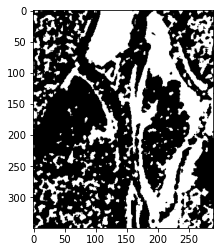

result of k means clustering
True Positive :  15642
True Negative :  63581
False Positive :  22046
False Negative :  223
the oceral error is :  22269
the percentage correct classification :  0.7805221674876848
kappa score :  0.4668259161448546
-----------------------------------------------------------
alpha is :  0.75
median kernel is :  5
clustering image


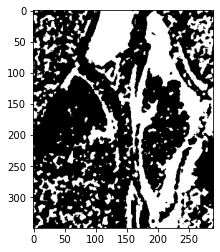

result of k means clustering
True Positive :  15647
True Negative :  63574
False Positive :  22053
False Negative :  218
the oceral error is :  22271
the percentage correct classification :  0.7805024630541872
kappa score :  0.46688328554210834
-----------------------------------------------------------
alpha is :  0.8
median kernel is :  5
clustering image


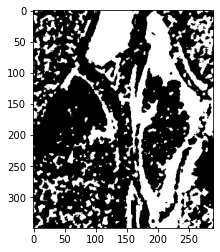

result of k means clustering
True Positive :  15658
True Negative :  63571
False Positive :  22056
False Negative :  207
the oceral error is :  22263
the percentage correct classification :  0.7805812807881773
kappa score :  0.46719739847396313
-----------------------------------------------------------
alpha is :  0.85
median kernel is :  5
clustering image


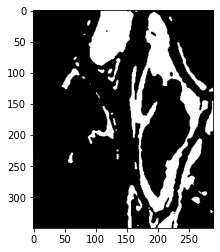

result of k means clustering
True Positive :  15357
True Negative :  81142
False Positive :  4485
False Negative :  508
the oceral error is :  4993
the percentage correct classification :  0.9507290640394088
kappa score :  0.8305671058423734
-----------------------------------------------------------
alpha is :  0.9
median kernel is :  5
clustering image


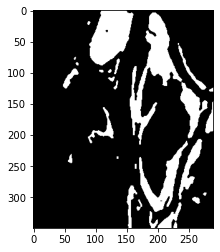

result of k means clustering
True Positive :  15079
True Negative :  82592
False Positive :  3035
False Negative :  786
the oceral error is :  3821
the percentage correct classification :  0.9622758620689655
kappa score :  0.8648354706080756
-----------------------------------------------------------
alpha is :  0.95
median kernel is :  5
clustering image


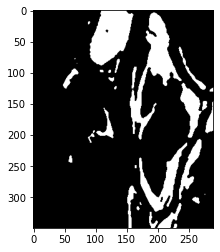

result of k means clustering
True Positive :  14760
True Negative :  83475
False Positive :  2152
False Negative :  1105
the oceral error is :  3257
the percentage correct classification :  0.9678325123152709
kappa score :  0.8812826176587871
-----------------------------------------------------------
alpha is :  1
median kernel is :  5
clustering image


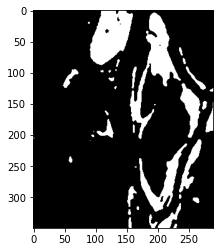

result of k means clustering
True Positive :  14358
True Negative :  84119
False Positive :  1508
False Negative :  1507
the oceral error is :  3015
the percentage correct classification :  0.9702167487684729
kappa score :  0.8871314315372869
-----------------------------------------------------------
alpha is :  1.05
median kernel is :  5
clustering image


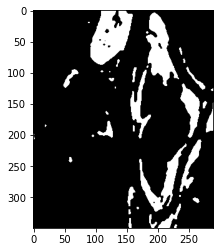

result of k means clustering
True Positive :  13532
True Negative :  84532
False Positive :  1095
False Negative :  2333
the oceral error is :  3428
the percentage correct classification :  0.9661477832512315
kappa score :  0.8674915013519287
-----------------------------------------------------------
alpha is :  1.1
median kernel is :  5
clustering image


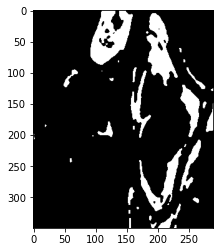

result of k means clustering
True Positive :  12448
True Negative :  84916
False Positive :  711
False Negative :  3417
the oceral error is :  4128
the percentage correct classification :  0.9592512315270936
kappa score :  0.8340201768385325
-----------------------------------------------------------
alpha is :  1.15
median kernel is :  5
clustering image


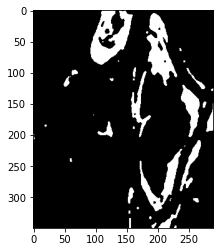

result of k means clustering
True Positive :  11642
True Negative :  85126
False Positive :  501
False Negative :  4223
the oceral error is :  4724
the percentage correct classification :  0.9533793103448276
kappa score :  0.8046273761368915
-----------------------------------------------------------
alpha is :  1.2
median kernel is :  5
clustering image


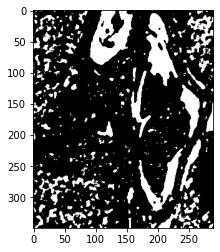

result of k means clustering
True Positive :  12313
True Negative :  76001
False Positive :  9626
False Negative :  3552
the oceral error is :  13178
the percentage correct classification :  0.870088669950739
kappa score :  0.5740030915472853
-----------------------------------------------------------
alpha is :  1.25
median kernel is :  5
clustering image


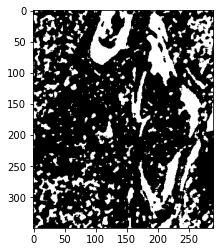

result of k means clustering
True Positive :  11944
True Negative :  71715
False Positive :  13912
False Negative :  3921
the oceral error is :  17833
the percentage correct classification :  0.8242266009852217
kappa score :  0.46974629643324095
-----------------------------------------------------------
alpha is :  1.3
median kernel is :  5
clustering image


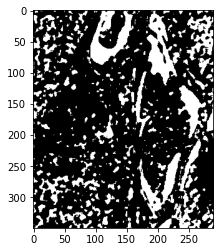

result of k means clustering
True Positive :  11035
True Negative :  71041
False Positive :  14586
False Negative :  4830
the oceral error is :  19416
the percentage correct classification :  0.8086305418719212
kappa score :  0.41991313509788253
-----------------------------------------------------------
alpha is :  1.35
median kernel is :  5
clustering image


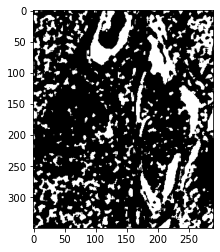

result of k means clustering
True Positive :  10099
True Negative :  70543
False Positive :  15084
False Negative :  5766
the oceral error is :  20850
the percentage correct classification :  0.7945024630541871
kappa score :  0.37143646137305686
-----------------------------------------------------------
alpha is :  1.4
median kernel is :  5
clustering image


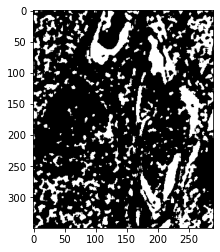

result of k means clustering
True Positive :  9105
True Negative :  70015
False Positive :  15612
False Negative :  6760
the oceral error is :  22372
the percentage correct classification :  0.7795073891625616
kappa score :  0.31899742217513616
-----------------------------------------------------------
alpha is :  1.45
median kernel is :  5
clustering image


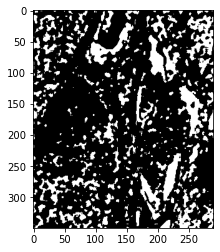

result of k means clustering
True Positive :  7357
True Negative :  69824
False Positive :  15803
False Negative :  8508
the oceral error is :  24311
the percentage correct classification :  0.7604039408866995
kappa score :  0.2350707364798139
-----------------------------------------------------------
alpha is :  1.5
median kernel is :  5
clustering image


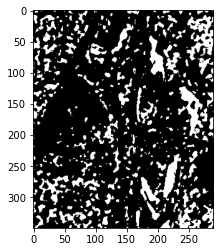

result of k means clustering
True Positive :  5306
True Negative :  69706
False Positive :  15921
False Negative :  10559
the oceral error is :  26480
the percentage correct classification :  0.7390344827586207
kappa score :  0.13047293894618084
-----------------------------------------------------------
alpha is :  0
median kernel is :  7
clustering image


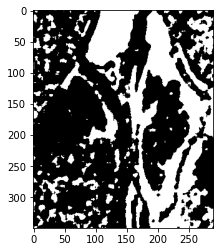

result of k means clustering
True Positive :  15669
True Negative :  65456
False Positive :  20171
False Negative :  196
the oceral error is :  20367
the percentage correct classification :  0.7992610837438424
kappa score :  0.49705888976124646
-----------------------------------------------------------
alpha is :  0.05
median kernel is :  7
clustering image


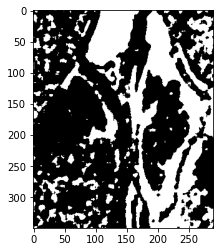

result of k means clustering
True Positive :  15669
True Negative :  65456
False Positive :  20171
False Negative :  196
the oceral error is :  20367
the percentage correct classification :  0.7992610837438424
kappa score :  0.49705888976124646
-----------------------------------------------------------
alpha is :  0.1
median kernel is :  7
clustering image


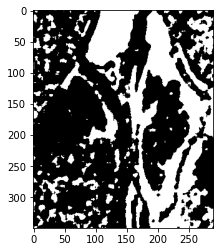

result of k means clustering
True Positive :  15669
True Negative :  65456
False Positive :  20171
False Negative :  196
the oceral error is :  20367
the percentage correct classification :  0.7992610837438424
kappa score :  0.49705888976124646
-----------------------------------------------------------
alpha is :  0.15
median kernel is :  7
clustering image


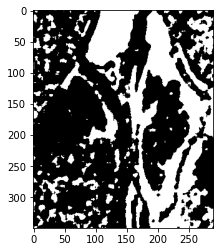

result of k means clustering
True Positive :  15669
True Negative :  65456
False Positive :  20171
False Negative :  196
the oceral error is :  20367
the percentage correct classification :  0.7992610837438424
kappa score :  0.49705888976124646
-----------------------------------------------------------
alpha is :  0.2
median kernel is :  7
clustering image


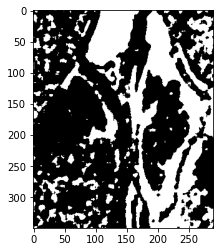

result of k means clustering
True Positive :  15669
True Negative :  65456
False Positive :  20171
False Negative :  196
the oceral error is :  20367
the percentage correct classification :  0.7992610837438424
kappa score :  0.49705888976124646
-----------------------------------------------------------
alpha is :  0.25
median kernel is :  7
clustering image


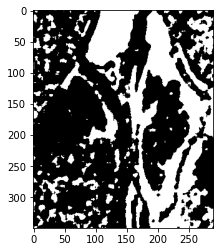

result of k means clustering
True Positive :  15669
True Negative :  65456
False Positive :  20171
False Negative :  196
the oceral error is :  20367
the percentage correct classification :  0.7992610837438424
kappa score :  0.49705888976124646
-----------------------------------------------------------
alpha is :  0.3
median kernel is :  7
clustering image


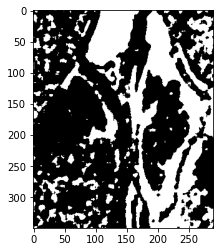

result of k means clustering
True Positive :  15669
True Negative :  65456
False Positive :  20171
False Negative :  196
the oceral error is :  20367
the percentage correct classification :  0.7992610837438424
kappa score :  0.49705888976124646
-----------------------------------------------------------
alpha is :  0.35
median kernel is :  7
clustering image


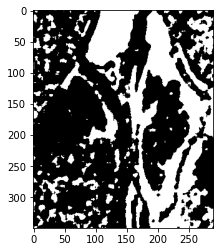

result of k means clustering
True Positive :  15669
True Negative :  65456
False Positive :  20171
False Negative :  196
the oceral error is :  20367
the percentage correct classification :  0.7992610837438424
kappa score :  0.49705888976124646
-----------------------------------------------------------
alpha is :  0.4
median kernel is :  7
clustering image


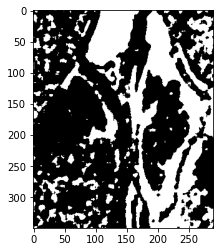

result of k means clustering
True Positive :  15669
True Negative :  65456
False Positive :  20171
False Negative :  196
the oceral error is :  20367
the percentage correct classification :  0.7992610837438424
kappa score :  0.49705888976124646
-----------------------------------------------------------
alpha is :  0.45
median kernel is :  7
clustering image


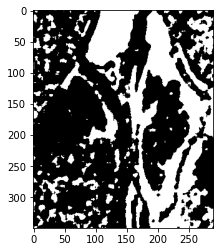

result of k means clustering
True Positive :  15669
True Negative :  65456
False Positive :  20171
False Negative :  196
the oceral error is :  20367
the percentage correct classification :  0.7992610837438424
kappa score :  0.49705888976124646
-----------------------------------------------------------
alpha is :  0.5
median kernel is :  7
clustering image


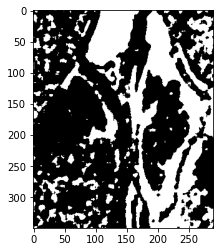

result of k means clustering
True Positive :  15669
True Negative :  65456
False Positive :  20171
False Negative :  196
the oceral error is :  20367
the percentage correct classification :  0.7992610837438424
kappa score :  0.49705888976124646
-----------------------------------------------------------
alpha is :  0.55
median kernel is :  7
clustering image


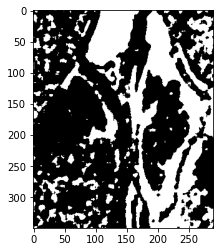

result of k means clustering
True Positive :  15669
True Negative :  65456
False Positive :  20171
False Negative :  196
the oceral error is :  20367
the percentage correct classification :  0.7992610837438424
kappa score :  0.49705888976124646
-----------------------------------------------------------
alpha is :  0.6
median kernel is :  7
clustering image


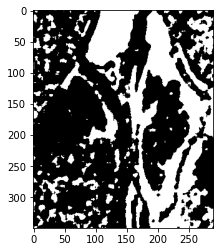

result of k means clustering
True Positive :  15669
True Negative :  65456
False Positive :  20171
False Negative :  196
the oceral error is :  20367
the percentage correct classification :  0.7992610837438424
kappa score :  0.49705888976124646
-----------------------------------------------------------
alpha is :  0.65
median kernel is :  7
clustering image


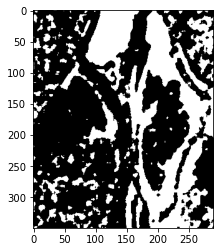

result of k means clustering
True Positive :  15671
True Negative :  65456
False Positive :  20171
False Negative :  194
the oceral error is :  20365
the percentage correct classification :  0.7992807881773399
kappa score :  0.49712532147985944
-----------------------------------------------------------
alpha is :  0.7
median kernel is :  7
clustering image


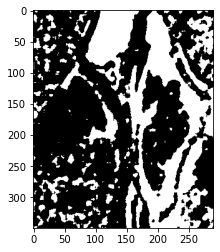

result of k means clustering
True Positive :  15671
True Negative :  65452
False Positive :  20175
False Negative :  194
the oceral error is :  20369
the percentage correct classification :  0.7992413793103448
kappa score :  0.49706071768323123
-----------------------------------------------------------
alpha is :  0.75
median kernel is :  7
clustering image


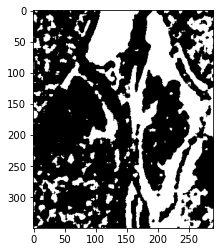

result of k means clustering
True Positive :  15679
True Negative :  65446
False Positive :  20181
False Negative :  186
the oceral error is :  20367
the percentage correct classification :  0.7992610837438424
kappa score :  0.49722948707709225
-----------------------------------------------------------
alpha is :  0.8
median kernel is :  7
clustering image


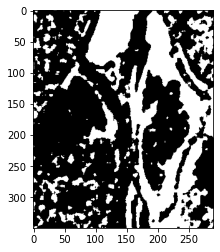

result of k means clustering
True Positive :  15686
True Negative :  65435
False Positive :  20192
False Negative :  179
the oceral error is :  20371
the percentage correct classification :  0.7992216748768473
kappa score :  0.4972842524491766
-----------------------------------------------------------
alpha is :  0.85
median kernel is :  7
clustering image


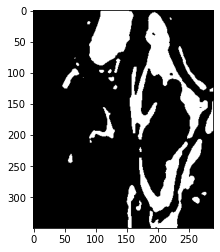

result of k means clustering
True Positive :  15267
True Negative :  81471
False Positive :  4156
False Negative :  598
the oceral error is :  4754
the percentage correct classification :  0.9530837438423645
kappa score :  0.8370747482574922
-----------------------------------------------------------
alpha is :  0.9
median kernel is :  7
clustering image


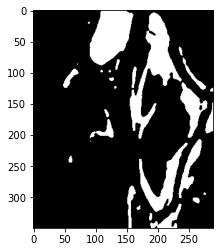

result of k means clustering
True Positive :  14915
True Negative :  82898
False Positive :  2729
False Negative :  950
the oceral error is :  3679
the percentage correct classification :  0.9636748768472907
kappa score :  0.8683468292024012
-----------------------------------------------------------
alpha is :  0.95
median kernel is :  7
clustering image


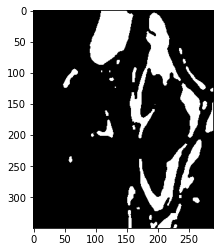

result of k means clustering
True Positive :  14480
True Negative :  83752
False Positive :  1875
False Negative :  1385
the oceral error is :  3260
the percentage correct classification :  0.9678029556650246
kappa score :  0.8794961219829839
-----------------------------------------------------------
alpha is :  1
median kernel is :  7
clustering image


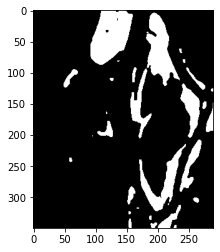

result of k means clustering
True Positive :  13960
True Negative :  84231
False Positive :  1396
False Negative :  1905
the oceral error is :  3301
the percentage correct classification :  0.9673990147783251
kappa score :  0.8748082848978471
-----------------------------------------------------------
alpha is :  1.05
median kernel is :  7
clustering image


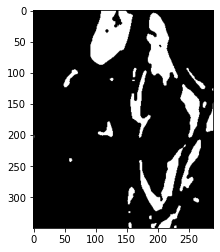

result of k means clustering
True Positive :  13125
True Negative :  84628
False Positive :  999
False Negative :  2740
the oceral error is :  3739
the percentage correct classification :  0.9630837438423645
kappa score :  0.8535373861096589
-----------------------------------------------------------
alpha is :  1.1
median kernel is :  7
clustering image


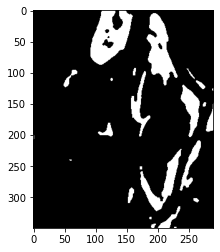

result of k means clustering
True Positive :  12160
True Negative :  84948
False Positive :  679
False Negative :  3705
the oceral error is :  4384
the percentage correct classification :  0.9567290640394088
kappa score :  0.8221821993492009
-----------------------------------------------------------
alpha is :  1.15
median kernel is :  7
clustering image


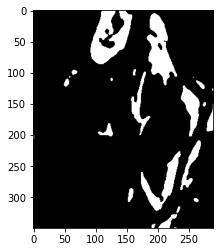

result of k means clustering
True Positive :  11314
True Negative :  85144
False Positive :  483
False Negative :  4551
the oceral error is :  5034
the percentage correct classification :  0.9503251231527093
kappa score :  0.7897579992035828
-----------------------------------------------------------
alpha is :  1.2
median kernel is :  7
clustering image


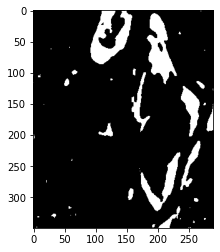

result of k means clustering
True Positive :  10675
True Negative :  85089
False Positive :  538
False Negative :  5190
the oceral error is :  5728
the percentage correct classification :  0.9434876847290641
kappa score :  0.756748142059085
-----------------------------------------------------------
alpha is :  1.25
median kernel is :  7
clustering image


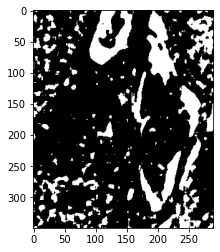

result of k means clustering
True Positive :  11738
True Negative :  75143
False Positive :  10484
False Negative :  4127
the oceral error is :  14611
the percentage correct classification :  0.8559704433497537
kappa score :  0.5306671927344198
-----------------------------------------------------------
alpha is :  1.3
median kernel is :  7
clustering image


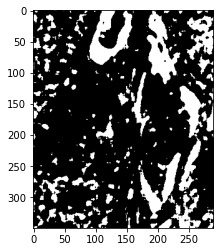

result of k means clustering
True Positive :  11313
True Negative :  73919
False Positive :  11708
False Negative :  4552
the oceral error is :  16260
the percentage correct classification :  0.8397241379310345
kappa score :  0.4867866926051668
-----------------------------------------------------------
alpha is :  1.35
median kernel is :  7
clustering image


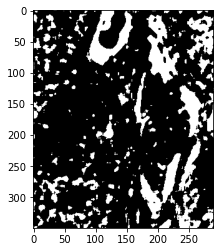

result of k means clustering
True Positive :  10419
True Negative :  73555
False Positive :  12072
False Negative :  5446
the oceral error is :  17518
the percentage correct classification :  0.8273300492610838
kappa score :  0.44067229989140155
-----------------------------------------------------------
alpha is :  1.4
median kernel is :  7
clustering image


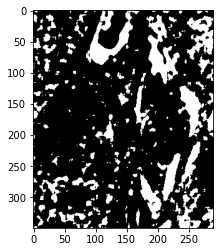

result of k means clustering
True Positive :  9537
True Negative :  73103
False Positive :  12524
False Negative :  6328
the oceral error is :  18852
the percentage correct classification :  0.8141871921182267
kappa score :  0.39234068576883385
-----------------------------------------------------------
alpha is :  1.45
median kernel is :  7
clustering image


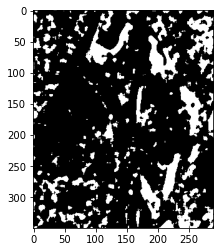

result of k means clustering
True Positive :  7969
True Negative :  73006
False Positive :  12621
False Negative :  7896
the oceral error is :  20517
the percentage correct classification :  0.797783251231527
kappa score :  0.31642791847271645
-----------------------------------------------------------
alpha is :  1.5
median kernel is :  7
clustering image


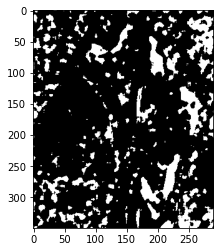

result of k means clustering
True Positive :  5733
True Negative :  73033
False Positive :  12594
False Negative :  10132
the oceral error is :  22726
the percentage correct classification :  0.7760197044334975
kappa score :  0.20147591024159295


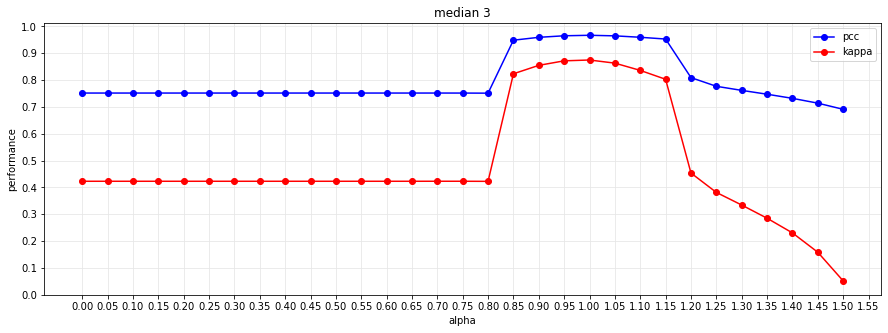

***********************
max pcc is :  0.966807881773399
max kaapa score is :  0.8747081087887096
***********************
     ---------------------------------------------------------------------------------------------------------------


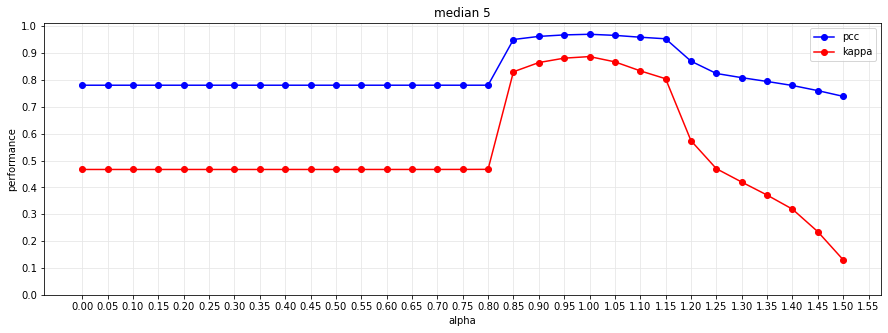

***********************
max pcc is :  0.9702167487684729
max kaapa score is :  0.8871314315372869
***********************
     ---------------------------------------------------------------------------------------------------------------


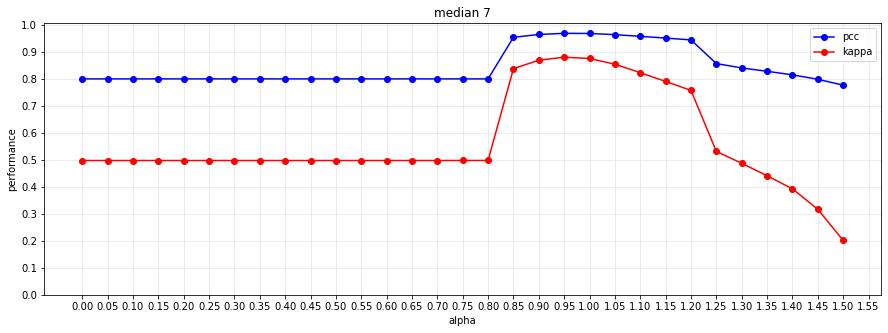

***********************
max pcc is :  0.9678029556650246
max kaapa score is :  0.8794961219829839
***********************
     ---------------------------------------------------------------------------------------------------------------


In [567]:
alpha_set = [0,0.05, 0.1 , 0.15, 0.2,0.25, 0.3 ,0.35, 0.4,0.45, 0.5,0.55 , 0.6 ,0.65, 0.7 ,0.75 ,0.8,0.85, 0.9,0.95, 1,1.05, 1.1 , 1.15,1.2,1.25, 1.3,1.35, 1.4,1.45, 1.5]
median_kernel=[3,5, 7]

tp1=[]
tn1=[]
fp1=[]
fn1=[]
pcc1=[]
kaapa1=[]
clustered_image1=[]
median1_3channels=[]
for kernel in median_kernel:
  for alpha in alpha_set:
    temp_median1_3channels, temp_clustered_image, temp_tp,temp_tn,temp_fp,temp_fn,temp_pcc,temp_kaapa =combined(data1_img1, data1_img2 ,im_gt , alpha , kernel ,  2,'k-means++' , 500, False)
    
    median1_3channels.append(temp_median1_3channels)
    clustered_image1.append(temp_clustered_image)
    tp1.append(temp_tp)
    tn1.append(temp_tn)
    fp1.append(temp_fp)
    fn1.append(temp_fn)
    pcc1.append(temp_pcc)
    kaapa1.append(temp_kaapa)
    

alpha_plotter(alpha_set, median_kernel, pcc1, kaapa1)

(301, 301)


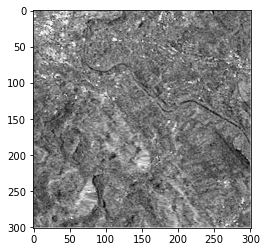

In [472]:
im1_path  = r'C:\Users\Asus\Desktop\AUT\Semister 2\DIP\proje\Ottawa_data\im1.bmp'
im2_path  = r'C:\Users\Asus\Desktop\AUT\Semister 2\DIP\proje\Ottawa_data\im2.bmp'
imgt_path = r'C:\Users\Asus\Desktop\AUT\Semister 2\DIP\proje\Ottawa_data\im3.bmp'

data2_im1 = io.imread(im1_path)
data2_im1_gray= cv2.cvtColor(data2_im1, cv2.COLOR_BGR2GRAY)
data2_im2 = io.imread(im2_path)
data2_im2_gray= cv2.cvtColor(data2_im2, cv2.COLOR_BGR2GRAY)
data2_im_gt = io.imread(imgt_path)
data2_im_gt= cv2.cvtColor(data2_im_gt, cv2.COLOR_BGR2GRAY)

print(data2_im1_gray.shape)
plt.imshow(data2_im1_gray, cmap='gray')

45.98590442833571


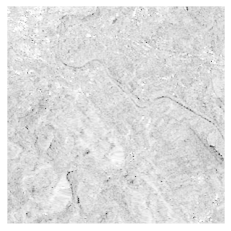

In [583]:
data2_img1_log = logTrans(data2_im1_gray)
data2_img1_log=normalizer(data2_img1_log)

45.98590442833571


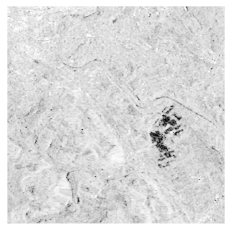

In [584]:
data2_img2_log = logTrans(data2_im2_gray)
data2_img2_log=normalizer(data2_img2_log)

In [475]:
data2_img1= cv2.cvtColor(data2_img1_log, cv2.COLOR_GRAY2BGR)
data2_img1 = Image.fromarray(data2_img1, "RGB")
data2_img2= cv2.cvtColor(data2_img2_log, cv2.COLOR_GRAY2BGR)
data2_img2 = Image.fromarray(data2_img2, "RGB")


In [476]:
data2_img2.size

(301, 301)

In [477]:



def cropping(shape, rotated):
  width= shape[1]
  height = shape[0]
  rotated_width = rotated.shape[1]
  rotated_height = rotated.shape[0]

  new_width1 = int(rotated_width/2 - width/2)+1
  new_width2 = int(rotated_width/2 + width/2)+1
  new_height1 = int(rotated_height/2 - height/2)
  new_height2 = int(rotated_height/2 + height/2)

  cropped = rotated[new_height1:new_height2,new_width1:new_width2]
  return cropped


def rotate(img, angel):
  img =img.rotate(angel, expand=True)
  return asarray(img)

def rotateback(img1, angel):
  img3 =img1.rotate(angel, expand=True)
  return img3

def morphology_with_angel(s1,s2,s3,s4, img, angel1, angel2, angel3, angel4, plot):

  kernel_S1= np.ones(s1,np.uint8)
  kernel_S2= np.ones(s2,np.uint8)
  kernel_S3= np.ones(s3,np.uint8)
  kernel_S4= np.ones(s4,np.uint8)

  img_shape = (img.size[1] , img.size[0])

  rotated1_img = rotate(img, angel1)
  #plt.imshow(rotated1_img, cmap='gray')
  rotated2_img = rotate(img, angel2)
  #plt.imshow(rotated2_img, cmap='gray')
  closing11 = cv2.morphologyEx(rotated1_img, cv2.MORPH_CLOSE, kernel_S1)
  closing12 = cv2.morphologyEx(rotated2_img, cv2.MORPH_CLOSE, kernel_S2)

  closing11 = Image.fromarray(closing11, "RGB")
  closing12 = Image.fromarray(closing12, "RGB")

  closing11 = rotateback(closing11, -angel1)
  closing12 = rotateback(closing12, -angel2)

  closing11=asarray(closing11)
  closing12=asarray(closing12)

  closing11= cropping(img_shape, closing11)
  closing12= cropping(img_shape, closing12)


  closing1= closing11.copy()

  for i in range(closing11.shape[0]):
    for j in range(closing11.shape[1]):
      closing1[i][j]= np.minimum(closing11[i][j], closing12[i][j])

  closing1 = Image.fromarray(closing1, "RGB")

  rotated3_img = rotate(closing1, angel1)
  rotated4_img =  rotate(closing1, angel2)

  opening11 = cv2.morphologyEx(rotated3_img, cv2.MORPH_OPEN, kernel_S1)
  opening12 = cv2.morphologyEx(rotated4_img, cv2.MORPH_OPEN, kernel_S2)

  opening11 = Image.fromarray(opening11, "RGB")
  opening12 = Image.fromarray(opening12, "RGB")

  opening11 = rotateback(opening11, -angel1)
  opening12 = rotateback(opening12, -angel2)

  opening11=asarray(opening11)
  opening12=asarray(opening12)

  opening11= cropping(img_shape, opening11)
  opening12= cropping(img_shape, opening12)

  opening1 =opening11.copy()

  for i in range(opening11.shape[0]):
    for j in range(opening11.shape[1]):
      opening1[i][j]= np.maximum(opening11[i][j], opening12[i][j])


  ###########################
  opening1 = Image.fromarray(opening1, "RGB")

  rotated5_img = rotate(opening1, angel3)
  rotated6_img = rotate(opening1, angel4)

  closing13 = cv2.morphologyEx(rotated5_img, cv2.MORPH_CLOSE, kernel_S3)
  closing14 = cv2.morphologyEx(rotated6_img, cv2.MORPH_CLOSE, kernel_S4)

  closing13 = Image.fromarray(closing13, "RGB")
  closing14 = Image.fromarray(closing14, "RGB")

  closing13 = rotateback(closing13, -angel3)
  closing14 = rotateback(closing14, -angel4)

  closing13=asarray(closing13)
  closing14=asarray(closing14)

  closing13= cropping(img_shape, closing13)
  closing14= cropping(img_shape, closing14)

  closing2= closing13.copy()

  for i in range(closing13.shape[0]):
    for j in range(closing13.shape[1]):
      closing2[i][j]= np.minimum(closing13[i][j], closing14[i][j])

  closing2 = Image.fromarray(closing2, "RGB")

  rotated7_img = rotate(closing2, angel3)
  rotated8_img = rotate(closing2, angel4)

  opening13 = cv2.morphologyEx(rotated7_img, cv2.MORPH_OPEN, kernel_S3)
  opening14 = cv2.morphologyEx(rotated8_img, cv2.MORPH_OPEN, kernel_S4)

  opening13 = Image.fromarray(opening13, "RGB")
  opening14 = Image.fromarray(opening14, "RGB")

  opening13 = rotateback(opening13, -angel3)
  opening14 = rotateback(opening14, -angel4)

  opening13=asarray(opening13)
  opening14=asarray(opening14)

  opening13= cropping(img_shape, opening13)
  opening14= cropping(img_shape, opening14)

  opening2 =opening13.copy()

  for i in range(opening13.shape[0]):
    for j in range(opening13.shape[1]):
      opening2[i][j]= np.maximum(opening13[i][j], opening14[i][j])

  opening2= cv2.cvtColor(opening2, cv2.COLOR_BGR2GRAY)

  ############################

  if plot:
      fig= plt.figure(figsize=(15, 10))
      ax1 = fig.add_subplot(231)
      ax2 = fig.add_subplot(232)
      ax3 = fig.add_subplot(233)
      ax4 = fig.add_subplot(234)
      ax5 = fig.add_subplot(235)

      ax1.imshow(img, cmap='gray')
      ax1.set_title('logarithmic image')
      ax1.axis('off')

      ax2.imshow(closing1, cmap='gray')
      ax2.set_title('Min of closing')
      ax2.axis('off')

      ax3.imshow(opening1, cmap='gray')
      ax3.set_title('max of opening')
      ax3.axis('off')

      ax4.imshow(closing2, cmap='gray')
      ax4.set_title('Min of closing in part 2')
      ax4.axis('off')

      ax5.imshow(opening2, cmap='gray')
      ax5.set_title('final')
      ax5.axis('off')

      plt.show() 
  return opening2





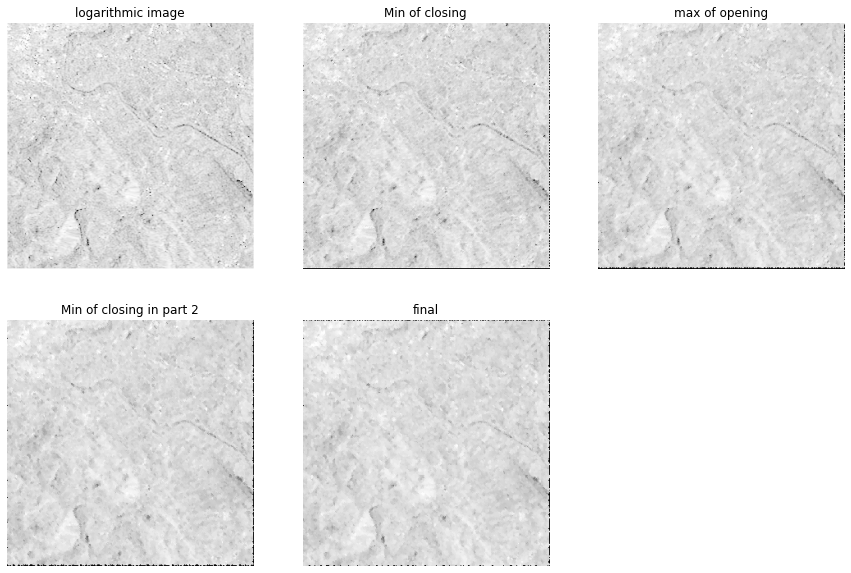

In [585]:
s21=(1,2)
s22=(1,2)  
s23= (1,2)
s24=(1,2)
angel1= -45
angel2= -30
angel3= 45
angel4= 30

data2_morphology1 = morphology_with_angel(s21, s22, s23, s24, data2_img1, angel1, angel2, angel3, angel4, True)  

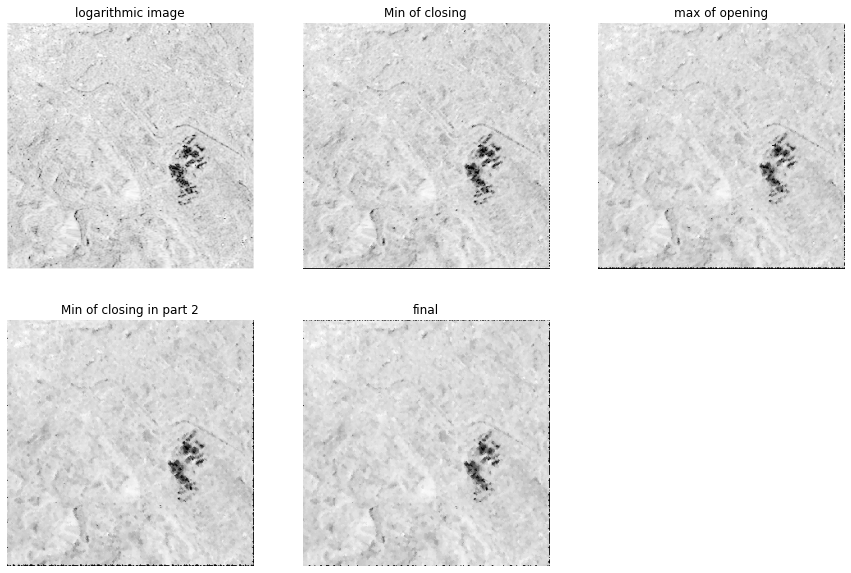

In [586]:
s21=(1,2)
s22=(1,2)  
s23= (1,2)
s24=(1,2)
angel1= -45
angel2= -30
angel3= 45
angel4= 30

data2_morphology2 = morphology_with_angel(s21, s22, s23, s24, data2_img2, angel1, angel2, angel3, angel4, True)  

<ipython-input-566-bc8eda5bb2b1>:11: RuntimeWarning: invalid value encountered in ubyte_scalars
  mean_ratio[i][j]= (1 - np.minimum( img1_mean[i][j]/img2_mean[i][j]  , img2_mean[i][j]/img1_mean[i][j]  ))*255


-----------------------------------------------------------
alpha is :  1
median kernel is :  3


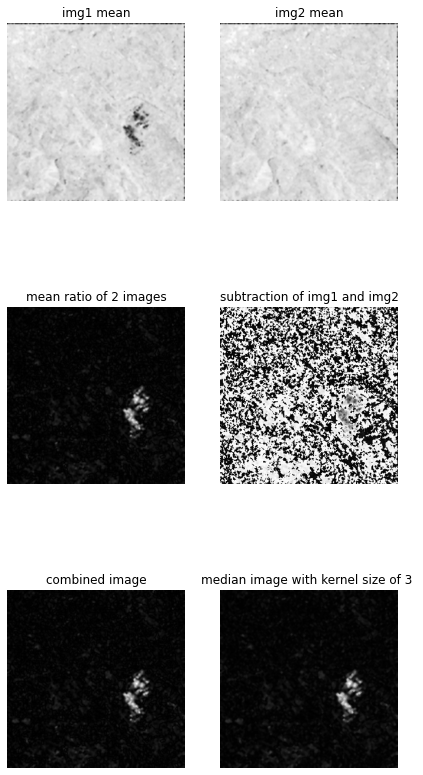

clustering image


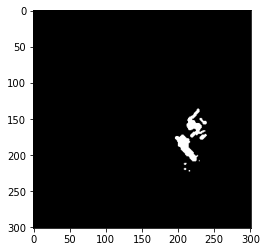

result of k means clustering
True Positive :  898
True Negative :  89410
False Positive :  115
False Negative :  178
the oceral error is :  293
the percentage correct classification :  0.9967660401099325
kappa score :  0.8581071694204351


In [587]:
median2_3channels,best_clustered_image2, best_tp2,best_tn2,best_fp2,best_fn2,best_pcc2,best_kaapa2 =combined(data2_morphology2, data2_morphology1 ,data2_im_gt ,1 , 3 ,  2,'k-means++' , 500, True)

<ipython-input-566-bc8eda5bb2b1>:11: RuntimeWarning: invalid value encountered in ubyte_scalars
  mean_ratio[i][j]= (1 - np.minimum( img1_mean[i][j]/img2_mean[i][j]  , img2_mean[i][j]/img1_mean[i][j]  ))*255


-----------------------------------------------------------
alpha is :  0
median kernel is :  3
clustering image


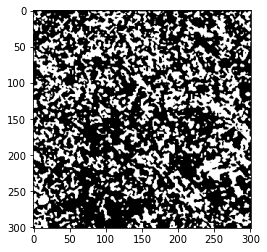

result of k means clustering
True Positive :  333
True Negative :  57405
False Positive :  32120
False Negative :  743
the oceral error is :  32863
the percentage correct classification :  0.6372777342413439
kappa score :  -0.0032004175872444307


<ipython-input-566-bc8eda5bb2b1>:11: RuntimeWarning: invalid value encountered in ubyte_scalars
  mean_ratio[i][j]= (1 - np.minimum( img1_mean[i][j]/img2_mean[i][j]  , img2_mean[i][j]/img1_mean[i][j]  ))*255


-----------------------------------------------------------
alpha is :  0.05
median kernel is :  3
clustering image


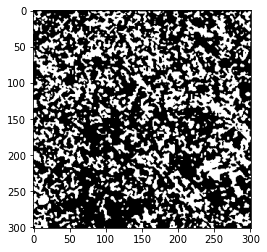

result of k means clustering
True Positive :  363
True Negative :  57405
False Positive :  32120
False Negative :  713
the oceral error is :  32833
the percentage correct classification :  0.6376088564143884
kappa score :  -0.0013893233618398337


<ipython-input-566-bc8eda5bb2b1>:11: RuntimeWarning: invalid value encountered in ubyte_scalars
  mean_ratio[i][j]= (1 - np.minimum( img1_mean[i][j]/img2_mean[i][j]  , img2_mean[i][j]/img1_mean[i][j]  ))*255


-----------------------------------------------------------
alpha is :  0.1
median kernel is :  3
clustering image


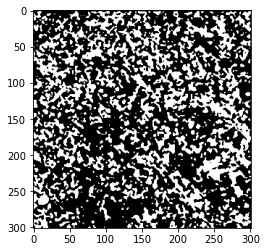

result of k means clustering
True Positive :  400
True Negative :  57404
False Positive :  32121
False Negative :  676
the oceral error is :  32797
the percentage correct classification :  0.6380062030220417
kappa score :  0.0008391597843089293


<ipython-input-566-bc8eda5bb2b1>:11: RuntimeWarning: invalid value encountered in ubyte_scalars
  mean_ratio[i][j]= (1 - np.minimum( img1_mean[i][j]/img2_mean[i][j]  , img2_mean[i][j]/img1_mean[i][j]  ))*255


-----------------------------------------------------------
alpha is :  0.15
median kernel is :  3
clustering image


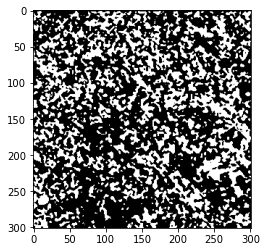

result of k means clustering
True Positive :  474
True Negative :  57404
False Positive :  32121
False Negative :  602
the oceral error is :  32723
the percentage correct classification :  0.6388229710488846
kappa score :  0.0052828062349628


<ipython-input-566-bc8eda5bb2b1>:11: RuntimeWarning: invalid value encountered in ubyte_scalars
  mean_ratio[i][j]= (1 - np.minimum( img1_mean[i][j]/img2_mean[i][j]  , img2_mean[i][j]/img1_mean[i][j]  ))*255


-----------------------------------------------------------
alpha is :  0.2
median kernel is :  3
clustering image


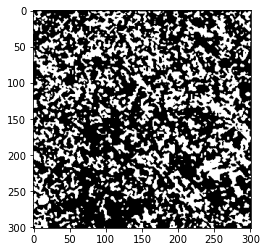

result of k means clustering
True Positive :  522
True Negative :  57402
False Positive :  32123
False Negative :  554
the oceral error is :  32677
the percentage correct classification :  0.6393306917142195
kappa score :  0.008152825588044421


<ipython-input-566-bc8eda5bb2b1>:11: RuntimeWarning: invalid value encountered in ubyte_scalars
  mean_ratio[i][j]= (1 - np.minimum( img1_mean[i][j]/img2_mean[i][j]  , img2_mean[i][j]/img1_mean[i][j]  ))*255


-----------------------------------------------------------
alpha is :  0.25
median kernel is :  3
clustering image


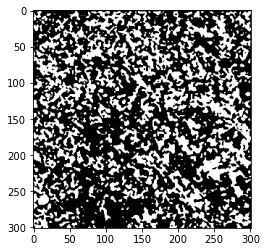

result of k means clustering
True Positive :  584
True Negative :  57391
False Positive :  32134
False Negative :  492
the oceral error is :  32626
the percentage correct classification :  0.6398935994083951
kappa score :  0.011838367657188376


<ipython-input-566-bc8eda5bb2b1>:11: RuntimeWarning: invalid value encountered in ubyte_scalars
  mean_ratio[i][j]= (1 - np.minimum( img1_mean[i][j]/img2_mean[i][j]  , img2_mean[i][j]/img1_mean[i][j]  ))*255


-----------------------------------------------------------
alpha is :  0.3
median kernel is :  3
clustering image


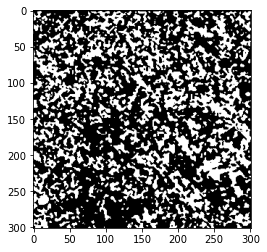

result of k means clustering
True Positive :  648
True Negative :  57378
False Positive :  32147
False Negative :  428
the oceral error is :  32575
the percentage correct classification :  0.6404565071025706
kappa score :  0.015624207605611895


<ipython-input-566-bc8eda5bb2b1>:11: RuntimeWarning: invalid value encountered in ubyte_scalars
  mean_ratio[i][j]= (1 - np.minimum( img1_mean[i][j]/img2_mean[i][j]  , img2_mean[i][j]/img1_mean[i][j]  ))*255


-----------------------------------------------------------
alpha is :  0.35
median kernel is :  3
clustering image


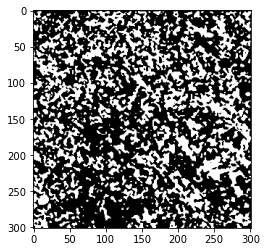

result of k means clustering
True Positive :  705
True Negative :  57367
False Positive :  32158
False Negative :  371
the oceral error is :  32529
the percentage correct classification :  0.6409642277679054
kappa score :  0.018982257059280583


<ipython-input-566-bc8eda5bb2b1>:11: RuntimeWarning: invalid value encountered in ubyte_scalars
  mean_ratio[i][j]= (1 - np.minimum( img1_mean[i][j]/img2_mean[i][j]  , img2_mean[i][j]/img1_mean[i][j]  ))*255


-----------------------------------------------------------
alpha is :  0.4
median kernel is :  3
clustering image


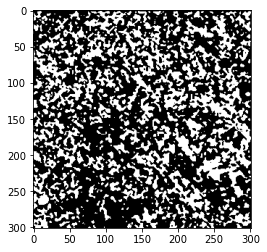

result of k means clustering
True Positive :  742
True Negative :  57359
False Positive :  32166
False Negative :  334
the oceral error is :  32500
the percentage correct classification :  0.6412843125351817
kappa score :  0.02115370634979452


<ipython-input-566-bc8eda5bb2b1>:11: RuntimeWarning: invalid value encountered in ubyte_scalars
  mean_ratio[i][j]= (1 - np.minimum( img1_mean[i][j]/img2_mean[i][j]  , img2_mean[i][j]/img1_mean[i][j]  ))*255


-----------------------------------------------------------
alpha is :  0.45
median kernel is :  3
clustering image


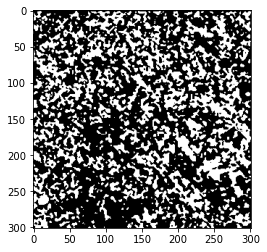

result of k means clustering
True Positive :  789
True Negative :  57338
False Positive :  32187
False Negative :  287
the oceral error is :  32474
the percentage correct classification :  0.6415712850851536
kappa score :  0.023888422224425776


<ipython-input-566-bc8eda5bb2b1>:11: RuntimeWarning: invalid value encountered in ubyte_scalars
  mean_ratio[i][j]= (1 - np.minimum( img1_mean[i][j]/img2_mean[i][j]  , img2_mean[i][j]/img1_mean[i][j]  ))*255


-----------------------------------------------------------
alpha is :  0.5
median kernel is :  3
clustering image


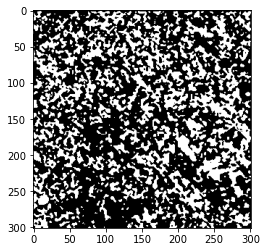

result of k means clustering
True Positive :  845
True Negative :  57326
False Positive :  32199
False Negative :  231
the oceral error is :  32430
the percentage correct classification :  0.6420569309389521
kappa score :  0.027152217082089702


<ipython-input-566-bc8eda5bb2b1>:11: RuntimeWarning: invalid value encountered in ubyte_scalars
  mean_ratio[i][j]= (1 - np.minimum( img1_mean[i][j]/img2_mean[i][j]  , img2_mean[i][j]/img1_mean[i][j]  ))*255


-----------------------------------------------------------
alpha is :  0.55
median kernel is :  3
clustering image


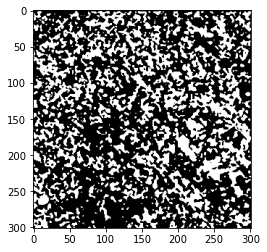

result of k means clustering
True Positive :  890
True Negative :  57293
False Positive :  32232
False Negative :  186
the oceral error is :  32418
the percentage correct classification :  0.6421893798081699
kappa score :  0.029728585403433816


<ipython-input-566-bc8eda5bb2b1>:11: RuntimeWarning: invalid value encountered in ubyte_scalars
  mean_ratio[i][j]= (1 - np.minimum( img1_mean[i][j]/img2_mean[i][j]  , img2_mean[i][j]/img1_mean[i][j]  ))*255


-----------------------------------------------------------
alpha is :  0.6
median kernel is :  3
clustering image


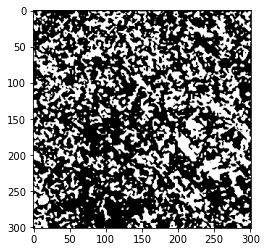

result of k means clustering
True Positive :  926
True Negative :  57230
False Positive :  32295
False Negative :  150
the oceral error is :  32445
the percentage correct classification :  0.6418913698524299
kappa score :  0.03172140629218423


<ipython-input-566-bc8eda5bb2b1>:11: RuntimeWarning: invalid value encountered in ubyte_scalars
  mean_ratio[i][j]= (1 - np.minimum( img1_mean[i][j]/img2_mean[i][j]  , img2_mean[i][j]/img1_mean[i][j]  ))*255


-----------------------------------------------------------
alpha is :  0.65
median kernel is :  3
clustering image


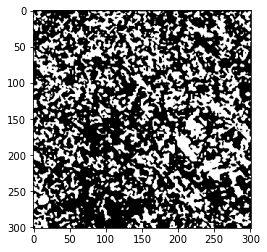

result of k means clustering
True Positive :  968
True Negative :  57126
False Positive :  32399
False Negative :  108
the oceral error is :  32507
the percentage correct classification :  0.6412070506948047
kappa score :  0.0339802413053516


<ipython-input-566-bc8eda5bb2b1>:11: RuntimeWarning: invalid value encountered in ubyte_scalars
  mean_ratio[i][j]= (1 - np.minimum( img1_mean[i][j]/img2_mean[i][j]  , img2_mean[i][j]/img1_mean[i][j]  ))*255


-----------------------------------------------------------
alpha is :  0.7
median kernel is :  3
clustering image


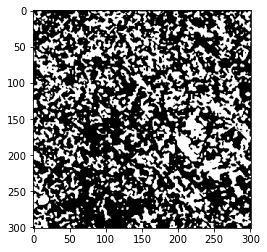

result of k means clustering
True Positive :  996
True Negative :  57002
False Positive :  32523
False Negative :  80
the oceral error is :  32603
the percentage correct classification :  0.6401474597410625
kappa score :  0.03538109722969973


<ipython-input-566-bc8eda5bb2b1>:11: RuntimeWarning: invalid value encountered in ubyte_scalars
  mean_ratio[i][j]= (1 - np.minimum( img1_mean[i][j]/img2_mean[i][j]  , img2_mean[i][j]/img1_mean[i][j]  ))*255


-----------------------------------------------------------
alpha is :  0.75
median kernel is :  3
clustering image


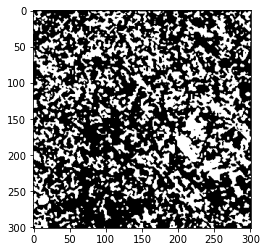

result of k means clustering
True Positive :  1017
True Negative :  56829
False Positive :  32696
False Negative :  59
the oceral error is :  32755
the percentage correct classification :  0.6384697740643039
kappa score :  0.0362840897174761


<ipython-input-566-bc8eda5bb2b1>:11: RuntimeWarning: invalid value encountered in ubyte_scalars
  mean_ratio[i][j]= (1 - np.minimum( img1_mean[i][j]/img2_mean[i][j]  , img2_mean[i][j]/img1_mean[i][j]  ))*255


-----------------------------------------------------------
alpha is :  0.8
median kernel is :  3
clustering image


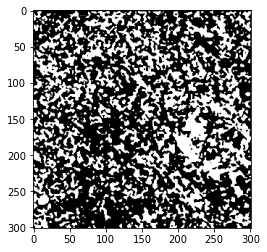

result of k means clustering
True Positive :  1034
True Negative :  56484
False Positive :  33041
False Negative :  42
the oceral error is :  33083
the percentage correct classification :  0.6348495049723513
kappa score :  0.03665037225716106


<ipython-input-566-bc8eda5bb2b1>:11: RuntimeWarning: invalid value encountered in ubyte_scalars
  mean_ratio[i][j]= (1 - np.minimum( img1_mean[i][j]/img2_mean[i][j]  , img2_mean[i][j]/img1_mean[i][j]  ))*255


-----------------------------------------------------------
alpha is :  0.85
median kernel is :  3
clustering image


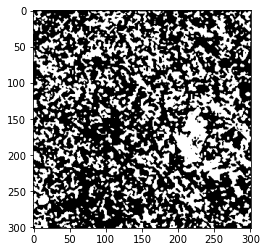

result of k means clustering
True Positive :  1054
True Negative :  55509
False Positive :  34016
False Negative :  22
the oceral error is :  34038
the percentage correct classification :  0.6243087824637698
kappa score :  0.036105681350430574


<ipython-input-566-bc8eda5bb2b1>:11: RuntimeWarning: invalid value encountered in ubyte_scalars
  mean_ratio[i][j]= (1 - np.minimum( img1_mean[i][j]/img2_mean[i][j]  , img2_mean[i][j]/img1_mean[i][j]  ))*255


-----------------------------------------------------------
alpha is :  0.9
median kernel is :  3
clustering image


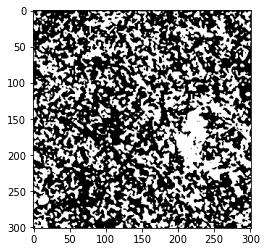

result of k means clustering
True Positive :  1070
True Negative :  52500
False Positive :  37025
False Negative :  6
the oceral error is :  37031
the percentage correct classification :  0.591273826999702
kappa score :  0.032277839899102934


<ipython-input-566-bc8eda5bb2b1>:11: RuntimeWarning: invalid value encountered in ubyte_scalars
  mean_ratio[i][j]= (1 - np.minimum( img1_mean[i][j]/img2_mean[i][j]  , img2_mean[i][j]/img1_mean[i][j]  ))*255


-----------------------------------------------------------
alpha is :  0.95
median kernel is :  3
clustering image


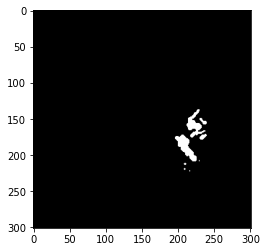

result of k means clustering
True Positive :  873
True Negative :  89431
False Positive :  94
False Negative :  203
the oceral error is :  297
the percentage correct classification :  0.99672189048686
kappa score :  0.852972577788585


<ipython-input-566-bc8eda5bb2b1>:11: RuntimeWarning: invalid value encountered in ubyte_scalars
  mean_ratio[i][j]= (1 - np.minimum( img1_mean[i][j]/img2_mean[i][j]  , img2_mean[i][j]/img1_mean[i][j]  ))*255


-----------------------------------------------------------
alpha is :  1
median kernel is :  3
clustering image


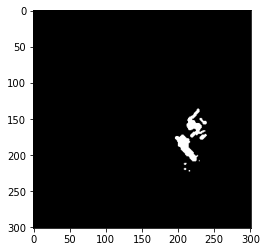

result of k means clustering
True Positive :  898
True Negative :  89410
False Positive :  115
False Negative :  178
the oceral error is :  293
the percentage correct classification :  0.9967660401099325
kappa score :  0.8581071694204351


<ipython-input-566-bc8eda5bb2b1>:11: RuntimeWarning: invalid value encountered in ubyte_scalars
  mean_ratio[i][j]= (1 - np.minimum( img1_mean[i][j]/img2_mean[i][j]  , img2_mean[i][j]/img1_mean[i][j]  ))*255


-----------------------------------------------------------
alpha is :  1.05
median kernel is :  3
clustering image


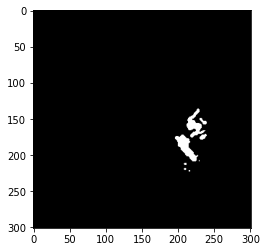

result of k means clustering
True Positive :  902
True Negative :  89409
False Positive :  116
False Negative :  174
the oceral error is :  290
the percentage correct classification :  0.996799152327237
kappa score :  0.8598911954143876


<ipython-input-566-bc8eda5bb2b1>:11: RuntimeWarning: invalid value encountered in ubyte_scalars
  mean_ratio[i][j]= (1 - np.minimum( img1_mean[i][j]/img2_mean[i][j]  , img2_mean[i][j]/img1_mean[i][j]  ))*255


-----------------------------------------------------------
alpha is :  1.1
median kernel is :  3
clustering image


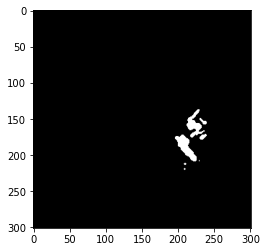

result of k means clustering
True Positive :  867
True Negative :  89423
False Positive :  102
False Negative :  209
the oceral error is :  311
the percentage correct classification :  0.9965673668061059
kappa score :  0.8461906592155322


<ipython-input-566-bc8eda5bb2b1>:11: RuntimeWarning: invalid value encountered in ubyte_scalars
  mean_ratio[i][j]= (1 - np.minimum( img1_mean[i][j]/img2_mean[i][j]  , img2_mean[i][j]/img1_mean[i][j]  ))*255


-----------------------------------------------------------
alpha is :  1.15
median kernel is :  3
clustering image


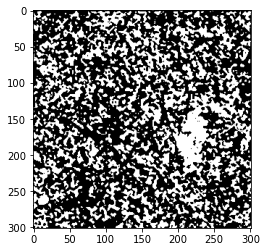

result of k means clustering
True Positive :  1070
True Negative :  55220
False Positive :  34305
False Negative :  6
the oceral error is :  34311
the percentage correct classification :  0.6212955706890653
kappa score :  0.03649895645525869


<ipython-input-566-bc8eda5bb2b1>:11: RuntimeWarning: invalid value encountered in ubyte_scalars
  mean_ratio[i][j]= (1 - np.minimum( img1_mean[i][j]/img2_mean[i][j]  , img2_mean[i][j]/img1_mean[i][j]  ))*255


-----------------------------------------------------------
alpha is :  1.2
median kernel is :  3
clustering image


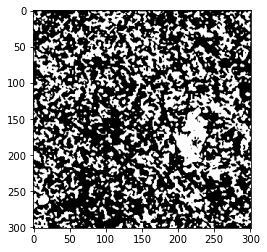

result of k means clustering
True Positive :  1061
True Negative :  56290
False Positive :  33235
False Negative :  15
the oceral error is :  33250
the percentage correct classification :  0.6330062582090705
kappa score :  0.03783227174049464


<ipython-input-566-bc8eda5bb2b1>:11: RuntimeWarning: invalid value encountered in ubyte_scalars
  mean_ratio[i][j]= (1 - np.minimum( img1_mean[i][j]/img2_mean[i][j]  , img2_mean[i][j]/img1_mean[i][j]  ))*255


-----------------------------------------------------------
alpha is :  1.25
median kernel is :  3
clustering image


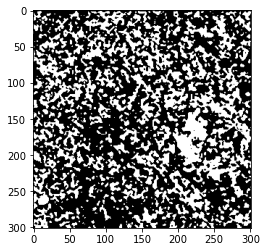

result of k means clustering
True Positive :  1047
True Negative :  56770
False Positive :  32755
False Negative :  29
the oceral error is :  32784
the percentage correct classification :  0.6381496892970276
kappa score :  0.0378903481955466


<ipython-input-566-bc8eda5bb2b1>:11: RuntimeWarning: invalid value encountered in ubyte_scalars
  mean_ratio[i][j]= (1 - np.minimum( img1_mean[i][j]/img2_mean[i][j]  , img2_mean[i][j]/img1_mean[i][j]  ))*255


-----------------------------------------------------------
alpha is :  1.3
median kernel is :  3
clustering image


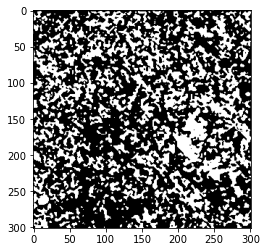

result of k means clustering
True Positive :  1033
True Negative :  56918
False Positive :  32607
False Negative :  43
the oceral error is :  32650
the percentage correct classification :  0.6396287016699594
kappa score :  0.037354933044016825


<ipython-input-566-bc8eda5bb2b1>:11: RuntimeWarning: invalid value encountered in ubyte_scalars
  mean_ratio[i][j]= (1 - np.minimum( img1_mean[i][j]/img2_mean[i][j]  , img2_mean[i][j]/img1_mean[i][j]  ))*255


-----------------------------------------------------------
alpha is :  1.35
median kernel is :  3
clustering image


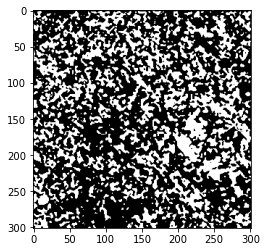

result of k means clustering
True Positive :  1018
True Negative :  57056
False Positive :  32469
False Negative :  58
the oceral error is :  32527
the percentage correct classification :  0.6409863025794418
kappa score :  0.036739363212181075


<ipython-input-566-bc8eda5bb2b1>:11: RuntimeWarning: invalid value encountered in ubyte_scalars
  mean_ratio[i][j]= (1 - np.minimum( img1_mean[i][j]/img2_mean[i][j]  , img2_mean[i][j]/img1_mean[i][j]  ))*255


-----------------------------------------------------------
alpha is :  1.4
median kernel is :  3
clustering image


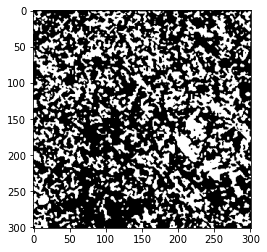

result of k means clustering
True Positive :  991
True Negative :  57123
False Positive :  32402
False Negative :  85
the oceral error is :  32487
the percentage correct classification :  0.6414277988101676
kappa score :  0.03530225564091727


<ipython-input-566-bc8eda5bb2b1>:11: RuntimeWarning: invalid value encountered in ubyte_scalars
  mean_ratio[i][j]= (1 - np.minimum( img1_mean[i][j]/img2_mean[i][j]  , img2_mean[i][j]/img1_mean[i][j]  ))*255


-----------------------------------------------------------
alpha is :  1.45
median kernel is :  3
clustering image


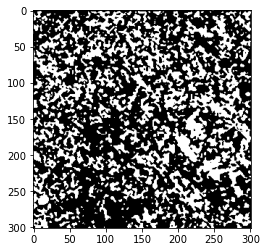

result of k means clustering
True Positive :  962
True Negative :  57196
False Positive :  32329
False Negative :  114
the oceral error is :  32443
the percentage correct classification :  0.6419134446639662
kappa score :  0.03375169727872973


<ipython-input-566-bc8eda5bb2b1>:11: RuntimeWarning: invalid value encountered in ubyte_scalars
  mean_ratio[i][j]= (1 - np.minimum( img1_mean[i][j]/img2_mean[i][j]  , img2_mean[i][j]/img1_mean[i][j]  ))*255


-----------------------------------------------------------
alpha is :  1.5
median kernel is :  3
clustering image


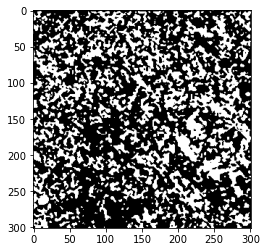

result of k means clustering
True Positive :  947
True Negative :  57237
False Positive :  32288
False Negative :  129
the oceral error is :  32417
the percentage correct classification :  0.6422004172139381
kappa score :  0.032951476794479295


<ipython-input-566-bc8eda5bb2b1>:11: RuntimeWarning: invalid value encountered in ubyte_scalars
  mean_ratio[i][j]= (1 - np.minimum( img1_mean[i][j]/img2_mean[i][j]  , img2_mean[i][j]/img1_mean[i][j]  ))*255


-----------------------------------------------------------
alpha is :  0
median kernel is :  5
clustering image


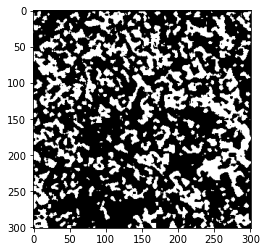

result of k means clustering
True Positive :  249
True Negative :  60373
False Positive :  29152
False Negative :  827
the oceral error is :  29979
the percentage correct classification :  0.6691096124766834
kappa score :  -0.006727878917442753


<ipython-input-566-bc8eda5bb2b1>:11: RuntimeWarning: invalid value encountered in ubyte_scalars
  mean_ratio[i][j]= (1 - np.minimum( img1_mean[i][j]/img2_mean[i][j]  , img2_mean[i][j]/img1_mean[i][j]  ))*255


-----------------------------------------------------------
alpha is :  0.05
median kernel is :  5
clustering image


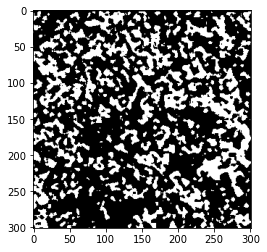

result of k means clustering
True Positive :  294
True Negative :  60373
False Positive :  29152
False Negative :  782
the oceral error is :  29934
the percentage correct classification :  0.6696062957362502
kappa score :  -0.0037359617482730645


<ipython-input-566-bc8eda5bb2b1>:11: RuntimeWarning: invalid value encountered in ubyte_scalars
  mean_ratio[i][j]= (1 - np.minimum( img1_mean[i][j]/img2_mean[i][j]  , img2_mean[i][j]/img1_mean[i][j]  ))*255


-----------------------------------------------------------
alpha is :  0.1
median kernel is :  5
clustering image


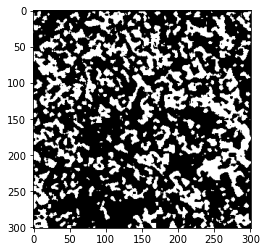

result of k means clustering
True Positive :  351
True Negative :  60372
False Positive :  29153
False Negative :  725
the oceral error is :  29878
the percentage correct classification :  0.6702243904592664
kappa score :  4.037330218942259e-05


<ipython-input-566-bc8eda5bb2b1>:11: RuntimeWarning: invalid value encountered in ubyte_scalars
  mean_ratio[i][j]= (1 - np.minimum( img1_mean[i][j]/img2_mean[i][j]  , img2_mean[i][j]/img1_mean[i][j]  ))*255


-----------------------------------------------------------
alpha is :  0.15
median kernel is :  5
clustering image


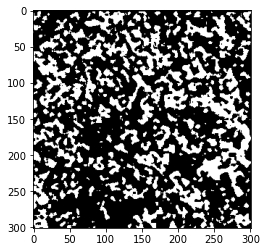

result of k means clustering
True Positive :  434
True Negative :  60363
False Positive :  29162
False Negative :  642
the oceral error is :  29804
the percentage correct classification :  0.6710411584861095
kappa score :  0.005506389146751833


<ipython-input-566-bc8eda5bb2b1>:11: RuntimeWarning: invalid value encountered in ubyte_scalars
  mean_ratio[i][j]= (1 - np.minimum( img1_mean[i][j]/img2_mean[i][j]  , img2_mean[i][j]/img1_mean[i][j]  ))*255


-----------------------------------------------------------
alpha is :  0.2
median kernel is :  5
clustering image


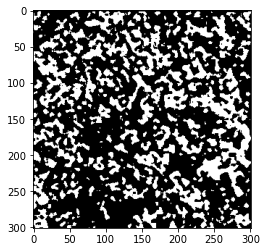

result of k means clustering
True Positive :  493
True Negative :  60359
False Positive :  29166
False Negative :  583
the oceral error is :  29749
the percentage correct classification :  0.6716482158033575
kappa score :  0.009374617596912604


<ipython-input-566-bc8eda5bb2b1>:11: RuntimeWarning: invalid value encountered in ubyte_scalars
  mean_ratio[i][j]= (1 - np.minimum( img1_mean[i][j]/img2_mean[i][j]  , img2_mean[i][j]/img1_mean[i][j]  ))*255


-----------------------------------------------------------
alpha is :  0.25
median kernel is :  5
clustering image


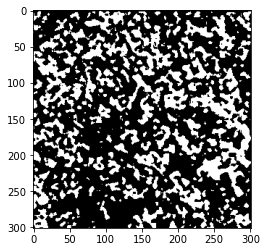

result of k means clustering
True Positive :  575
True Negative :  60354
False Positive :  29171
False Negative :  501
the oceral error is :  29672
the percentage correct classification :  0.672498096047505
kappa score :  0.014725268820146131


<ipython-input-566-bc8eda5bb2b1>:11: RuntimeWarning: invalid value encountered in ubyte_scalars
  mean_ratio[i][j]= (1 - np.minimum( img1_mean[i][j]/img2_mean[i][j]  , img2_mean[i][j]/img1_mean[i][j]  ))*255


-----------------------------------------------------------
alpha is :  0.3
median kernel is :  5
clustering image


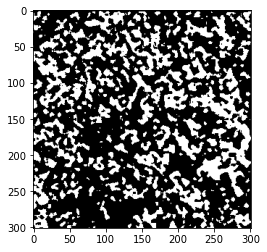

result of k means clustering
True Positive :  643
True Negative :  60335
False Positive :  29190
False Negative :  433
the oceral error is :  29623
the percentage correct classification :  0.6730389289301443
kappa score :  0.019118684135302155


<ipython-input-566-bc8eda5bb2b1>:11: RuntimeWarning: invalid value encountered in ubyte_scalars
  mean_ratio[i][j]= (1 - np.minimum( img1_mean[i][j]/img2_mean[i][j]  , img2_mean[i][j]/img1_mean[i][j]  ))*255


-----------------------------------------------------------
alpha is :  0.35
median kernel is :  5
clustering image


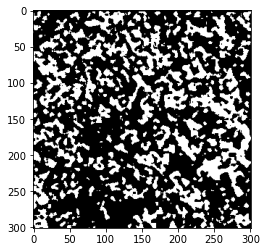

result of k means clustering
True Positive :  698
True Negative :  60320
False Positive :  29205
False Negative :  378
the oceral error is :  29583
the percentage correct classification :  0.6734804251608701
kappa score :  0.022654703278751187


<ipython-input-566-bc8eda5bb2b1>:11: RuntimeWarning: invalid value encountered in ubyte_scalars
  mean_ratio[i][j]= (1 - np.minimum( img1_mean[i][j]/img2_mean[i][j]  , img2_mean[i][j]/img1_mean[i][j]  ))*255


-----------------------------------------------------------
alpha is :  0.4
median kernel is :  5
clustering image


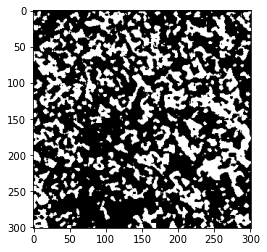

result of k means clustering
True Positive :  730
True Negative :  60304
False Positive :  29221
False Negative :  346
the oceral error is :  29567
the percentage correct classification :  0.6736570236531606
kappa score :  0.0246932018064695


<ipython-input-566-bc8eda5bb2b1>:11: RuntimeWarning: invalid value encountered in ubyte_scalars
  mean_ratio[i][j]= (1 - np.minimum( img1_mean[i][j]/img2_mean[i][j]  , img2_mean[i][j]/img1_mean[i][j]  ))*255


-----------------------------------------------------------
alpha is :  0.45
median kernel is :  5
clustering image


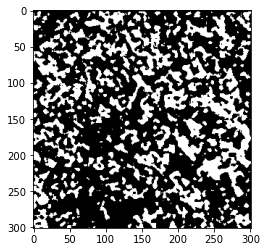

result of k means clustering
True Positive :  758
True Negative :  60269
False Positive :  29256
False Negative :  318
the oceral error is :  29574
the percentage correct classification :  0.6735797618127836
kappa score :  0.02643743957264022


<ipython-input-566-bc8eda5bb2b1>:11: RuntimeWarning: invalid value encountered in ubyte_scalars
  mean_ratio[i][j]= (1 - np.minimum( img1_mean[i][j]/img2_mean[i][j]  , img2_mean[i][j]/img1_mean[i][j]  ))*255


-----------------------------------------------------------
alpha is :  0.5
median kernel is :  5
clustering image


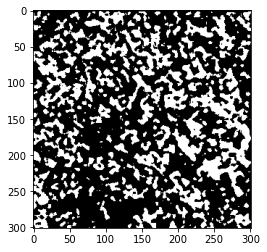

result of k means clustering
True Positive :  810
True Negative :  60244
False Positive :  29281
False Negative :  266
the oceral error is :  29547
the percentage correct classification :  0.6738777717685235
kappa score :  0.02972730100014087


<ipython-input-566-bc8eda5bb2b1>:11: RuntimeWarning: invalid value encountered in ubyte_scalars
  mean_ratio[i][j]= (1 - np.minimum( img1_mean[i][j]/img2_mean[i][j]  , img2_mean[i][j]/img1_mean[i][j]  ))*255


-----------------------------------------------------------
alpha is :  0.55
median kernel is :  5
clustering image


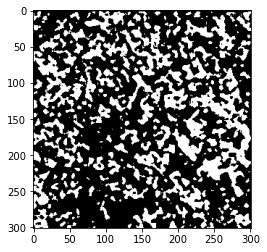

result of k means clustering
True Positive :  870
True Negative :  60202
False Positive :  29323
False Negative :  206
the oceral error is :  29529
the percentage correct classification :  0.6740764450723502
kappa score :  0.03347886160486846


<ipython-input-566-bc8eda5bb2b1>:11: RuntimeWarning: invalid value encountered in ubyte_scalars
  mean_ratio[i][j]= (1 - np.minimum( img1_mean[i][j]/img2_mean[i][j]  , img2_mean[i][j]/img1_mean[i][j]  ))*255


-----------------------------------------------------------
alpha is :  0.6
median kernel is :  5
clustering image


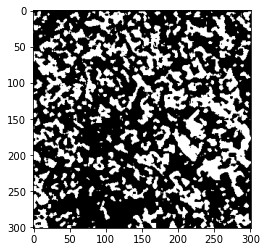

result of k means clustering
True Positive :  916
True Negative :  60133
False Positive :  29392
False Negative :  160
the oceral error is :  29552
the percentage correct classification :  0.6738225847396828
kappa score :  0.03626745858038194


<ipython-input-566-bc8eda5bb2b1>:11: RuntimeWarning: invalid value encountered in ubyte_scalars
  mean_ratio[i][j]= (1 - np.minimum( img1_mean[i][j]/img2_mean[i][j]  , img2_mean[i][j]/img1_mean[i][j]  ))*255


-----------------------------------------------------------
alpha is :  0.65
median kernel is :  5
clustering image


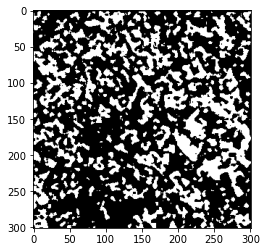

result of k means clustering
True Positive :  948
True Negative :  60032
False Positive :  29493
False Negative :  128
the oceral error is :  29621
the percentage correct classification :  0.6730610037416805
kappa score :  0.03809028148345994


<ipython-input-566-bc8eda5bb2b1>:11: RuntimeWarning: invalid value encountered in ubyte_scalars
  mean_ratio[i][j]= (1 - np.minimum( img1_mean[i][j]/img2_mean[i][j]  , img2_mean[i][j]/img1_mean[i][j]  ))*255


-----------------------------------------------------------
alpha is :  0.7
median kernel is :  5
clustering image


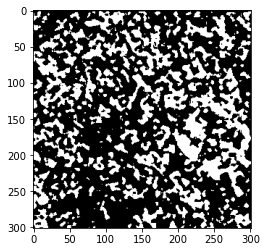

result of k means clustering
True Positive :  1001
True Negative :  59882
False Positive :  29643
False Negative :  75
the oceral error is :  29718
the percentage correct classification :  0.6719903753821702
kappa score :  0.04111135756340045


<ipython-input-566-bc8eda5bb2b1>:11: RuntimeWarning: invalid value encountered in ubyte_scalars
  mean_ratio[i][j]= (1 - np.minimum( img1_mean[i][j]/img2_mean[i][j]  , img2_mean[i][j]/img1_mean[i][j]  ))*255


-----------------------------------------------------------
alpha is :  0.75
median kernel is :  5
clustering image


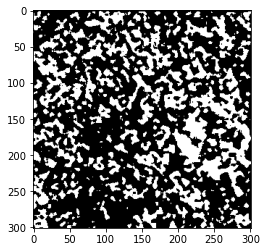

result of k means clustering
True Positive :  1024
True Negative :  59717
False Positive :  29808
False Negative :  52
the oceral error is :  29860
the percentage correct classification :  0.6704230637630931
kappa score :  0.04220160468365841


<ipython-input-566-bc8eda5bb2b1>:11: RuntimeWarning: invalid value encountered in ubyte_scalars
  mean_ratio[i][j]= (1 - np.minimum( img1_mean[i][j]/img2_mean[i][j]  , img2_mean[i][j]/img1_mean[i][j]  ))*255


-----------------------------------------------------------
alpha is :  0.8
median kernel is :  5
clustering image


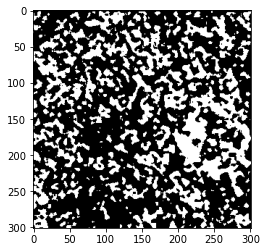

result of k means clustering
True Positive :  1038
True Negative :  59329
False Positive :  30196
False Negative :  38
the oceral error is :  30234
the percentage correct classification :  0.6662950740058057
kappa score :  0.042261456634063777


<ipython-input-566-bc8eda5bb2b1>:11: RuntimeWarning: invalid value encountered in ubyte_scalars
  mean_ratio[i][j]= (1 - np.minimum( img1_mean[i][j]/img2_mean[i][j]  , img2_mean[i][j]/img1_mean[i][j]  ))*255


-----------------------------------------------------------
alpha is :  0.85
median kernel is :  5
clustering image


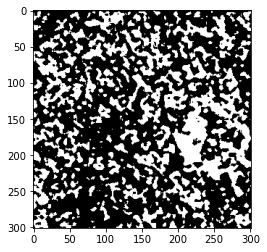

result of k means clustering
True Positive :  1051
True Negative :  58414
False Positive :  31111
False Negative :  25
the oceral error is :  31136
the percentage correct classification :  0.656339334002936
kappa score :  0.04120432377639671


<ipython-input-566-bc8eda5bb2b1>:11: RuntimeWarning: invalid value encountered in ubyte_scalars
  mean_ratio[i][j]= (1 - np.minimum( img1_mean[i][j]/img2_mean[i][j]  , img2_mean[i][j]/img1_mean[i][j]  ))*255


-----------------------------------------------------------
alpha is :  0.9
median kernel is :  5
clustering image


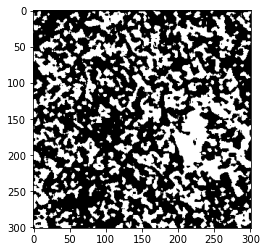

result of k means clustering
True Positive :  1070
True Negative :  55681
False Positive :  33844
False Negative :  6
the oceral error is :  33850
the percentage correct classification :  0.6263838147481816
kappa score :  0.03727756029526397


<ipython-input-566-bc8eda5bb2b1>:11: RuntimeWarning: invalid value encountered in ubyte_scalars
  mean_ratio[i][j]= (1 - np.minimum( img1_mean[i][j]/img2_mean[i][j]  , img2_mean[i][j]/img1_mean[i][j]  ))*255


-----------------------------------------------------------
alpha is :  0.95
median kernel is :  5
clustering image


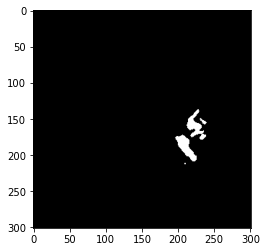

result of k means clustering
True Positive :  850
True Negative :  89421
False Positive :  104
False Negative :  226
the oceral error is :  330
the percentage correct classification :  0.9963576560965111
kappa score :  0.835603345393757


<ipython-input-566-bc8eda5bb2b1>:11: RuntimeWarning: invalid value encountered in ubyte_scalars
  mean_ratio[i][j]= (1 - np.minimum( img1_mean[i][j]/img2_mean[i][j]  , img2_mean[i][j]/img1_mean[i][j]  ))*255


-----------------------------------------------------------
alpha is :  1
median kernel is :  5
clustering image


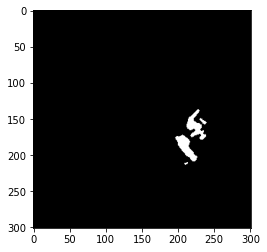

result of k means clustering
True Positive :  871
True Negative :  89399
False Positive :  126
False Negative :  205
the oceral error is :  331
the percentage correct classification :  0.9963466186907429
kappa score :  0.8384829112895039


<ipython-input-566-bc8eda5bb2b1>:11: RuntimeWarning: invalid value encountered in ubyte_scalars
  mean_ratio[i][j]= (1 - np.minimum( img1_mean[i][j]/img2_mean[i][j]  , img2_mean[i][j]/img1_mean[i][j]  ))*255


-----------------------------------------------------------
alpha is :  1.05
median kernel is :  5
clustering image


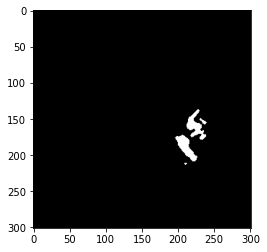

result of k means clustering
True Positive :  864
True Negative :  89406
False Positive :  119
False Negative :  212
the oceral error is :  331
the percentage correct classification :  0.9963466186907429
kappa score :  0.8373984774435319


<ipython-input-566-bc8eda5bb2b1>:11: RuntimeWarning: invalid value encountered in ubyte_scalars
  mean_ratio[i][j]= (1 - np.minimum( img1_mean[i][j]/img2_mean[i][j]  , img2_mean[i][j]/img1_mean[i][j]  ))*255


-----------------------------------------------------------
alpha is :  1.1
median kernel is :  5
clustering image


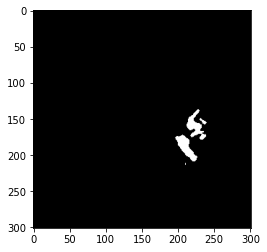

result of k means clustering
True Positive :  853
True Negative :  89411
False Positive :  114
False Negative :  223
the oceral error is :  337
the percentage correct classification :  0.996280394256134
kappa score :  0.8331709047634787


<ipython-input-566-bc8eda5bb2b1>:11: RuntimeWarning: invalid value encountered in ubyte_scalars
  mean_ratio[i][j]= (1 - np.minimum( img1_mean[i][j]/img2_mean[i][j]  , img2_mean[i][j]/img1_mean[i][j]  ))*255


-----------------------------------------------------------
alpha is :  1.15
median kernel is :  5
clustering image


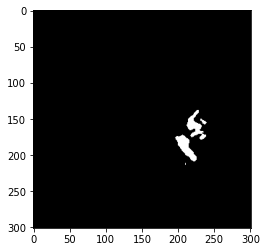

result of k means clustering
True Positive :  837
True Negative :  89428
False Positive :  97
False Negative :  239
the oceral error is :  336
the percentage correct classification :  0.9962914316619021
kappa score :  0.8309702001091162


<ipython-input-566-bc8eda5bb2b1>:11: RuntimeWarning: invalid value encountered in ubyte_scalars
  mean_ratio[i][j]= (1 - np.minimum( img1_mean[i][j]/img2_mean[i][j]  , img2_mean[i][j]/img1_mean[i][j]  ))*255


-----------------------------------------------------------
alpha is :  1.2
median kernel is :  5
clustering image


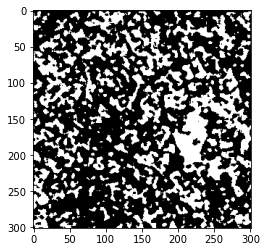

result of k means clustering
True Positive :  1051
True Negative :  59383
False Positive :  30142
False Negative :  25
the oceral error is :  30167
the percentage correct classification :  0.6670345801922716
kappa score :  0.04317065910029372


<ipython-input-566-bc8eda5bb2b1>:11: RuntimeWarning: invalid value encountered in ubyte_scalars
  mean_ratio[i][j]= (1 - np.minimum( img1_mean[i][j]/img2_mean[i][j]  , img2_mean[i][j]/img1_mean[i][j]  ))*255


-----------------------------------------------------------
alpha is :  1.25
median kernel is :  5
clustering image


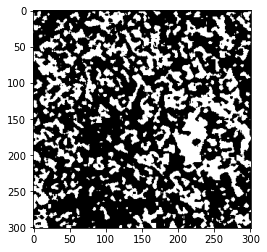

result of k means clustering
True Positive :  1044
True Negative :  59709
False Positive :  29816
False Negative :  32
the oceral error is :  29848
the percentage correct classification :  0.670555512632311
kappa score :  0.04342524839389206


<ipython-input-566-bc8eda5bb2b1>:11: RuntimeWarning: invalid value encountered in ubyte_scalars
  mean_ratio[i][j]= (1 - np.minimum( img1_mean[i][j]/img2_mean[i][j]  , img2_mean[i][j]/img1_mean[i][j]  ))*255


-----------------------------------------------------------
alpha is :  1.3
median kernel is :  5
clustering image


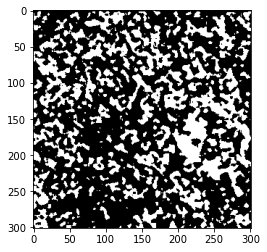

result of k means clustering
True Positive :  1039
True Negative :  59770
False Positive :  29755
False Negative :  37
the oceral error is :  29792
the percentage correct classification :  0.6711736073553272
kappa score :  0.04324430412381197


<ipython-input-566-bc8eda5bb2b1>:11: RuntimeWarning: invalid value encountered in ubyte_scalars
  mean_ratio[i][j]= (1 - np.minimum( img1_mean[i][j]/img2_mean[i][j]  , img2_mean[i][j]/img1_mean[i][j]  ))*255


-----------------------------------------------------------
alpha is :  1.35
median kernel is :  5
clustering image


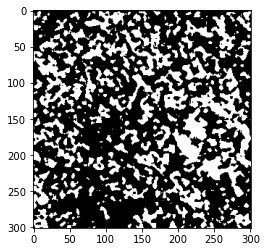

result of k means clustering
True Positive :  1025
True Negative :  59911
False Positive :  29614
False Negative :  51
the oceral error is :  29665
the percentage correct classification :  0.672575357887882
kappa score :  0.04267069055015793


<ipython-input-566-bc8eda5bb2b1>:11: RuntimeWarning: invalid value encountered in ubyte_scalars
  mean_ratio[i][j]= (1 - np.minimum( img1_mean[i][j]/img2_mean[i][j]  , img2_mean[i][j]/img1_mean[i][j]  ))*255


-----------------------------------------------------------
alpha is :  1.4
median kernel is :  5
clustering image


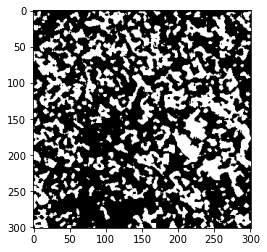

result of k means clustering
True Positive :  985
True Negative :  60001
False Positive :  29524
False Negative :  91
the oceral error is :  29615
the percentage correct classification :  0.6731272281762894
kappa score :  0.04035390607404932


<ipython-input-566-bc8eda5bb2b1>:11: RuntimeWarning: invalid value encountered in ubyte_scalars
  mean_ratio[i][j]= (1 - np.minimum( img1_mean[i][j]/img2_mean[i][j]  , img2_mean[i][j]/img1_mean[i][j]  ))*255


-----------------------------------------------------------
alpha is :  1.45
median kernel is :  5
clustering image


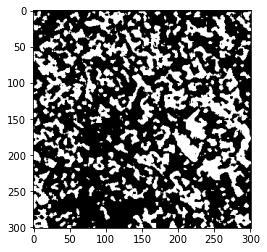

result of k means clustering
True Positive :  962
True Negative :  60094
False Positive :  29431
False Negative :  114
the oceral error is :  29545
the percentage correct classification :  0.6738998465800599
kappa score :  0.03909606855262859


<ipython-input-566-bc8eda5bb2b1>:11: RuntimeWarning: invalid value encountered in ubyte_scalars
  mean_ratio[i][j]= (1 - np.minimum( img1_mean[i][j]/img2_mean[i][j]  , img2_mean[i][j]/img1_mean[i][j]  ))*255


-----------------------------------------------------------
alpha is :  1.5
median kernel is :  5
clustering image


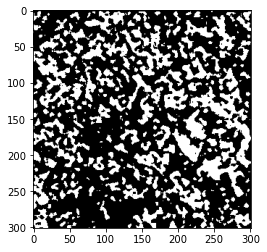

result of k means clustering
True Positive :  948
True Negative :  60136
False Positive :  29389
False Negative :  128
the oceral error is :  29517
the percentage correct classification :  0.674208893941568
kappa score :  0.03829676751470612


<ipython-input-566-bc8eda5bb2b1>:11: RuntimeWarning: invalid value encountered in ubyte_scalars
  mean_ratio[i][j]= (1 - np.minimum( img1_mean[i][j]/img2_mean[i][j]  , img2_mean[i][j]/img1_mean[i][j]  ))*255


-----------------------------------------------------------
alpha is :  0
median kernel is :  7
clustering image


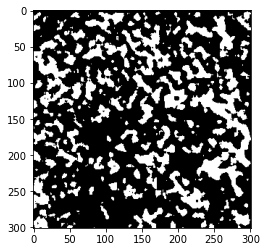

result of k means clustering
True Positive :  200
True Negative :  63176
False Positive :  26349
False Negative :  876
the oceral error is :  27225
the percentage correct classification :  0.6995066279621638
kappa score :  -0.008542701139395925


<ipython-input-566-bc8eda5bb2b1>:11: RuntimeWarning: invalid value encountered in ubyte_scalars
  mean_ratio[i][j]= (1 - np.minimum( img1_mean[i][j]/img2_mean[i][j]  , img2_mean[i][j]/img1_mean[i][j]  ))*255


-----------------------------------------------------------
alpha is :  0.05
median kernel is :  7
clustering image


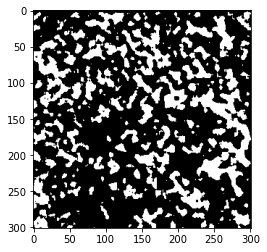

result of k means clustering
True Positive :  241
True Negative :  63175
False Positive :  26350
False Negative :  835
the oceral error is :  27185
the percentage correct classification :  0.6999481241928897
kappa score :  -0.005533584414327608


<ipython-input-566-bc8eda5bb2b1>:11: RuntimeWarning: invalid value encountered in ubyte_scalars
  mean_ratio[i][j]= (1 - np.minimum( img1_mean[i][j]/img2_mean[i][j]  , img2_mean[i][j]/img1_mean[i][j]  ))*255


-----------------------------------------------------------
alpha is :  0.1
median kernel is :  7
clustering image


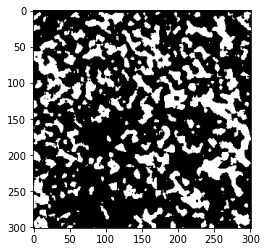

result of k means clustering
True Positive :  312
True Negative :  63170
False Positive :  26355
False Negative :  764
the oceral error is :  27119
the percentage correct classification :  0.7006765929735875
kappa score :  -0.00034703005217195937


<ipython-input-566-bc8eda5bb2b1>:11: RuntimeWarning: invalid value encountered in ubyte_scalars
  mean_ratio[i][j]= (1 - np.minimum( img1_mean[i][j]/img2_mean[i][j]  , img2_mean[i][j]/img1_mean[i][j]  ))*255


-----------------------------------------------------------
alpha is :  0.15
median kernel is :  7
clustering image


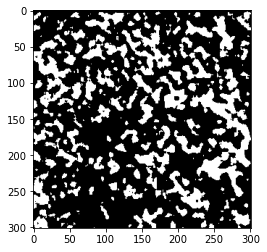

result of k means clustering
True Positive :  400
True Negative :  63157
False Positive :  26368
False Negative :  676
the oceral error is :  27044
the percentage correct classification :  0.7015043984061986
kappa score :  0.006034695272412072


<ipython-input-566-bc8eda5bb2b1>:11: RuntimeWarning: invalid value encountered in ubyte_scalars
  mean_ratio[i][j]= (1 - np.minimum( img1_mean[i][j]/img2_mean[i][j]  , img2_mean[i][j]/img1_mean[i][j]  ))*255


-----------------------------------------------------------
alpha is :  0.2
median kernel is :  7
clustering image


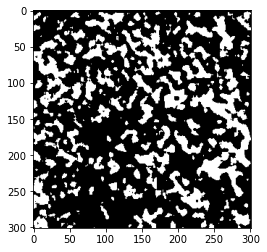

result of k means clustering
True Positive :  461
True Negative :  63142
False Positive :  26383
False Negative :  615
the oceral error is :  26998
the percentage correct classification :  0.7020121190715334
kappa score :  0.01042386631183223


<ipython-input-566-bc8eda5bb2b1>:11: RuntimeWarning: invalid value encountered in ubyte_scalars
  mean_ratio[i][j]= (1 - np.minimum( img1_mean[i][j]/img2_mean[i][j]  , img2_mean[i][j]/img1_mean[i][j]  ))*255


-----------------------------------------------------------
alpha is :  0.25
median kernel is :  7
clustering image


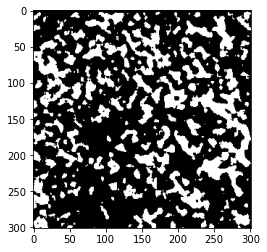

result of k means clustering
True Positive :  536
True Negative :  63123
False Positive :  26402
False Negative :  540
the oceral error is :  26942
the percentage correct classification :  0.7026302137945497
kappa score :  0.015786979595992512


<ipython-input-566-bc8eda5bb2b1>:11: RuntimeWarning: invalid value encountered in ubyte_scalars
  mean_ratio[i][j]= (1 - np.minimum( img1_mean[i][j]/img2_mean[i][j]  , img2_mean[i][j]/img1_mean[i][j]  ))*255


-----------------------------------------------------------
alpha is :  0.3
median kernel is :  7
clustering image


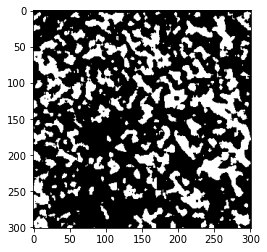

result of k means clustering
True Positive :  602
True Negative :  63098
False Positive :  26427
False Negative :  474
the oceral error is :  26901
the percentage correct classification :  0.7030827474310438
kappa score :  0.02046367405849392


<ipython-input-566-bc8eda5bb2b1>:11: RuntimeWarning: invalid value encountered in ubyte_scalars
  mean_ratio[i][j]= (1 - np.minimum( img1_mean[i][j]/img2_mean[i][j]  , img2_mean[i][j]/img1_mean[i][j]  ))*255


-----------------------------------------------------------
alpha is :  0.35
median kernel is :  7
clustering image


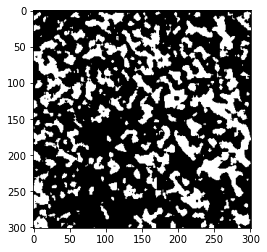

result of k means clustering
True Positive :  667
True Negative :  63080
False Positive :  26445
False Negative :  409
the oceral error is :  26854
the percentage correct classification :  0.7036015055021467
kappa score :  0.025051616940888533


<ipython-input-566-bc8eda5bb2b1>:11: RuntimeWarning: invalid value encountered in ubyte_scalars
  mean_ratio[i][j]= (1 - np.minimum( img1_mean[i][j]/img2_mean[i][j]  , img2_mean[i][j]/img1_mean[i][j]  ))*255


-----------------------------------------------------------
alpha is :  0.4
median kernel is :  7
clustering image


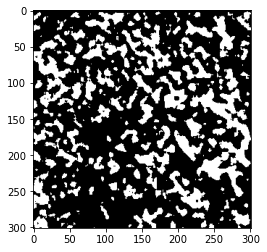

result of k means clustering
True Positive :  699
True Negative :  63053
False Positive :  26472
False Negative :  377
the oceral error is :  26849
the percentage correct classification :  0.7036566925309875
kappa score :  0.027267271766365786


<ipython-input-566-bc8eda5bb2b1>:11: RuntimeWarning: invalid value encountered in ubyte_scalars
  mean_ratio[i][j]= (1 - np.minimum( img1_mean[i][j]/img2_mean[i][j]  , img2_mean[i][j]/img1_mean[i][j]  ))*255


-----------------------------------------------------------
alpha is :  0.45
median kernel is :  7
clustering image


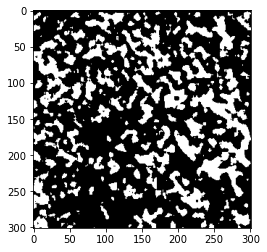

result of k means clustering
True Positive :  739
True Negative :  63013
False Positive :  26512
False Negative :  337
the oceral error is :  26849
the percentage correct classification :  0.7036566925309875
kappa score :  0.030011888757737637


<ipython-input-566-bc8eda5bb2b1>:11: RuntimeWarning: invalid value encountered in ubyte_scalars
  mean_ratio[i][j]= (1 - np.minimum( img1_mean[i][j]/img2_mean[i][j]  , img2_mean[i][j]/img1_mean[i][j]  ))*255


-----------------------------------------------------------
alpha is :  0.5
median kernel is :  7
clustering image


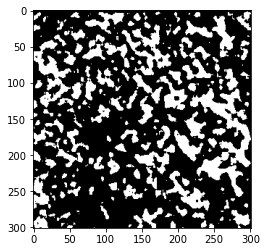

result of k means clustering
True Positive :  779
True Negative :  62988
False Positive :  26537
False Negative :  297
the oceral error is :  26834
the percentage correct classification :  0.7038222536175097
kappa score :  0.03277118525888456


<ipython-input-566-bc8eda5bb2b1>:11: RuntimeWarning: invalid value encountered in ubyte_scalars
  mean_ratio[i][j]= (1 - np.minimum( img1_mean[i][j]/img2_mean[i][j]  , img2_mean[i][j]/img1_mean[i][j]  ))*255


-----------------------------------------------------------
alpha is :  0.55
median kernel is :  7
clustering image


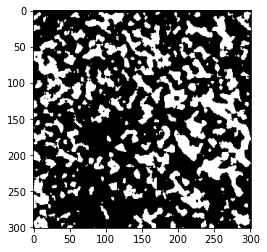

result of k means clustering
True Positive :  840
True Negative :  62937
False Positive :  26588
False Negative :  236
the oceral error is :  26824
the percentage correct classification :  0.7039326276751913
kappa score :  0.036927238018241604


<ipython-input-566-bc8eda5bb2b1>:11: RuntimeWarning: invalid value encountered in ubyte_scalars
  mean_ratio[i][j]= (1 - np.minimum( img1_mean[i][j]/img2_mean[i][j]  , img2_mean[i][j]/img1_mean[i][j]  ))*255


-----------------------------------------------------------
alpha is :  0.6
median kernel is :  7
clustering image


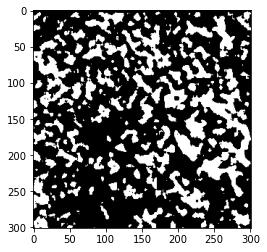

result of k means clustering
True Positive :  885
True Negative :  62871
False Positive :  26654
False Negative :  191
the oceral error is :  26845
the percentage correct classification :  0.7037008421540601
kappa score :  0.0399086144669909


<ipython-input-566-bc8eda5bb2b1>:11: RuntimeWarning: invalid value encountered in ubyte_scalars
  mean_ratio[i][j]= (1 - np.minimum( img1_mean[i][j]/img2_mean[i][j]  , img2_mean[i][j]/img1_mean[i][j]  ))*255


-----------------------------------------------------------
alpha is :  0.65
median kernel is :  7
clustering image


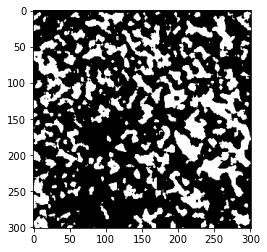

result of k means clustering
True Positive :  922
True Negative :  62763
False Positive :  26762
False Negative :  154
the oceral error is :  26916
the percentage correct classification :  0.7029171863445216
kappa score :  0.04221825726290496


<ipython-input-566-bc8eda5bb2b1>:11: RuntimeWarning: invalid value encountered in ubyte_scalars
  mean_ratio[i][j]= (1 - np.minimum( img1_mean[i][j]/img2_mean[i][j]  , img2_mean[i][j]/img1_mean[i][j]  ))*255


-----------------------------------------------------------
alpha is :  0.7
median kernel is :  7
clustering image


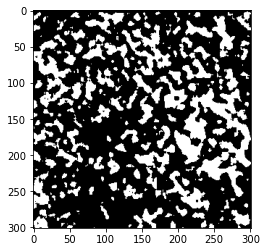

result of k means clustering
True Positive :  969
True Negative :  62584
False Positive :  26941
False Negative :  107
the oceral error is :  27048
the percentage correct classification :  0.701460248783126
kappa score :  0.04501870389401519


<ipython-input-566-bc8eda5bb2b1>:11: RuntimeWarning: invalid value encountered in ubyte_scalars
  mean_ratio[i][j]= (1 - np.minimum( img1_mean[i][j]/img2_mean[i][j]  , img2_mean[i][j]/img1_mean[i][j]  ))*255


-----------------------------------------------------------
alpha is :  0.75
median kernel is :  7
clustering image


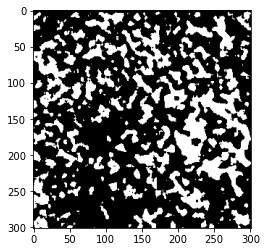

result of k means clustering
True Positive :  1006
True Negative :  62422
False Positive :  27103
False Negative :  70
the oceral error is :  27173
the percentage correct classification :  0.7000805730621075
kappa score :  0.047141178176673515


<ipython-input-566-bc8eda5bb2b1>:11: RuntimeWarning: invalid value encountered in ubyte_scalars
  mean_ratio[i][j]= (1 - np.minimum( img1_mean[i][j]/img2_mean[i][j]  , img2_mean[i][j]/img1_mean[i][j]  ))*255


-----------------------------------------------------------
alpha is :  0.8
median kernel is :  7
clustering image


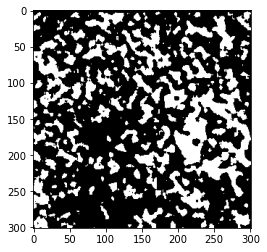

result of k means clustering
True Positive :  1030
True Negative :  62065
False Positive :  27460
False Negative :  46
the oceral error is :  27506
the percentage correct classification :  0.6964051169413141
kappa score :  0.0478824951927862


<ipython-input-566-bc8eda5bb2b1>:11: RuntimeWarning: invalid value encountered in ubyte_scalars
  mean_ratio[i][j]= (1 - np.minimum( img1_mean[i][j]/img2_mean[i][j]  , img2_mean[i][j]/img1_mean[i][j]  ))*255


-----------------------------------------------------------
alpha is :  0.85
median kernel is :  7
clustering image


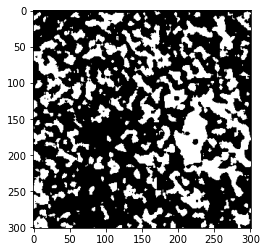

result of k means clustering
True Positive :  1049
True Negative :  61118
False Positive :  28407
False Negative :  27
the oceral error is :  28434
the percentage correct classification :  0.6861624043884725
kappa score :  0.04687349836214161


<ipython-input-566-bc8eda5bb2b1>:11: RuntimeWarning: invalid value encountered in ubyte_scalars
  mean_ratio[i][j]= (1 - np.minimum( img1_mean[i][j]/img2_mean[i][j]  , img2_mean[i][j]/img1_mean[i][j]  ))*255


-----------------------------------------------------------
alpha is :  0.9
median kernel is :  7
clustering image


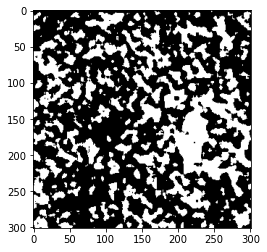

result of k means clustering
True Positive :  1066
True Negative :  58131
False Positive :  31394
False Negative :  10
the oceral error is :  31404
the percentage correct classification :  0.6533813092570722
kappa score :  0.04153804950909601


<ipython-input-566-bc8eda5bb2b1>:11: RuntimeWarning: invalid value encountered in ubyte_scalars
  mean_ratio[i][j]= (1 - np.minimum( img1_mean[i][j]/img2_mean[i][j]  , img2_mean[i][j]/img1_mean[i][j]  ))*255


-----------------------------------------------------------
alpha is :  0.95
median kernel is :  7
clustering image


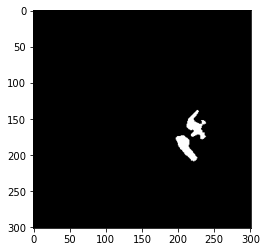

result of k means clustering
True Positive :  826
True Negative :  89372
False Positive :  153
False Negative :  250
the oceral error is :  403
the percentage correct classification :  0.9955519254754363
kappa score :  0.8016484641990316


<ipython-input-566-bc8eda5bb2b1>:11: RuntimeWarning: invalid value encountered in ubyte_scalars
  mean_ratio[i][j]= (1 - np.minimum( img1_mean[i][j]/img2_mean[i][j]  , img2_mean[i][j]/img1_mean[i][j]  ))*255


-----------------------------------------------------------
alpha is :  1
median kernel is :  7
clustering image


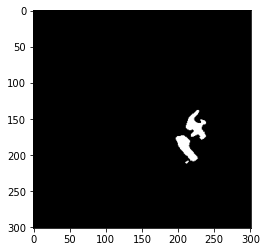

result of k means clustering
True Positive :  868
True Negative :  89323
False Positive :  202
False Negative :  208
the oceral error is :  410
the percentage correct classification :  0.9954746636350592
kappa score :  0.8066571095907726


<ipython-input-566-bc8eda5bb2b1>:11: RuntimeWarning: invalid value encountered in ubyte_scalars
  mean_ratio[i][j]= (1 - np.minimum( img1_mean[i][j]/img2_mean[i][j]  , img2_mean[i][j]/img1_mean[i][j]  ))*255


-----------------------------------------------------------
alpha is :  1.05
median kernel is :  7
clustering image


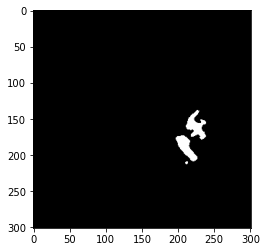

result of k means clustering
True Positive :  868
True Negative :  89334
False Positive :  191
False Negative :  208
the oceral error is :  399
the percentage correct classification :  0.9955960750985089
kappa score :  0.8108866808014705


<ipython-input-566-bc8eda5bb2b1>:11: RuntimeWarning: invalid value encountered in ubyte_scalars
  mean_ratio[i][j]= (1 - np.minimum( img1_mean[i][j]/img2_mean[i][j]  , img2_mean[i][j]/img1_mean[i][j]  ))*255


-----------------------------------------------------------
alpha is :  1.1
median kernel is :  7
clustering image


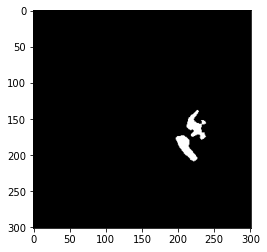

result of k means clustering
True Positive :  823
True Negative :  89370
False Positive :  155
False Negative :  253
the oceral error is :  408
the percentage correct classification :  0.9954967384465955
kappa score :  0.7990909909037457


<ipython-input-566-bc8eda5bb2b1>:11: RuntimeWarning: invalid value encountered in ubyte_scalars
  mean_ratio[i][j]= (1 - np.minimum( img1_mean[i][j]/img2_mean[i][j]  , img2_mean[i][j]/img1_mean[i][j]  ))*255


-----------------------------------------------------------
alpha is :  1.15
median kernel is :  7
clustering image


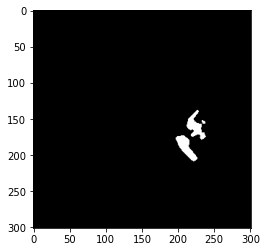

result of k means clustering
True Positive :  813
True Negative :  89384
False Positive :  141
False Negative :  263
the oceral error is :  404
the percentage correct classification :  0.9955408880696681
kappa score :  0.7987386410275086


<ipython-input-566-bc8eda5bb2b1>:11: RuntimeWarning: invalid value encountered in ubyte_scalars
  mean_ratio[i][j]= (1 - np.minimum( img1_mean[i][j]/img2_mean[i][j]  , img2_mean[i][j]/img1_mean[i][j]  ))*255


-----------------------------------------------------------
alpha is :  1.2
median kernel is :  7
clustering image


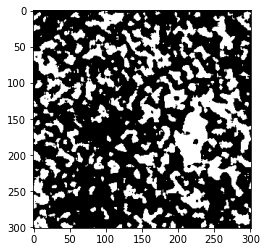

result of k means clustering
True Positive :  1052
True Negative :  61832
False Positive :  27693
False Negative :  24
the oceral error is :  27717
the percentage correct classification :  0.6940762243242349
kappa score :  0.04877558622127698


<ipython-input-566-bc8eda5bb2b1>:11: RuntimeWarning: invalid value encountered in ubyte_scalars
  mean_ratio[i][j]= (1 - np.minimum( img1_mean[i][j]/img2_mean[i][j]  , img2_mean[i][j]/img1_mean[i][j]  ))*255


-----------------------------------------------------------
alpha is :  1.25
median kernel is :  7
clustering image


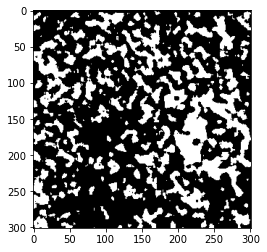

result of k means clustering
True Positive :  1040
True Negative :  62269
False Positive :  27256
False Negative :  36
the oceral error is :  27292
the percentage correct classification :  0.6987671217756979
kappa score :  0.04905589814920053


<ipython-input-566-bc8eda5bb2b1>:11: RuntimeWarning: invalid value encountered in ubyte_scalars
  mean_ratio[i][j]= (1 - np.minimum( img1_mean[i][j]/img2_mean[i][j]  , img2_mean[i][j]/img1_mean[i][j]  ))*255


-----------------------------------------------------------
alpha is :  1.3
median kernel is :  7
clustering image


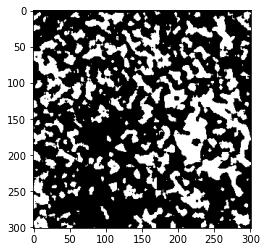

result of k means clustering
True Positive :  1033
True Negative :  62529
False Positive :  26996
False Negative :  43
the oceral error is :  27039
the percentage correct classification :  0.7015595854350394
kappa score :  0.0492362381622542


<ipython-input-566-bc8eda5bb2b1>:11: RuntimeWarning: invalid value encountered in ubyte_scalars
  mean_ratio[i][j]= (1 - np.minimum( img1_mean[i][j]/img2_mean[i][j]  , img2_mean[i][j]/img1_mean[i][j]  ))*255


-----------------------------------------------------------
alpha is :  1.35
median kernel is :  7
clustering image


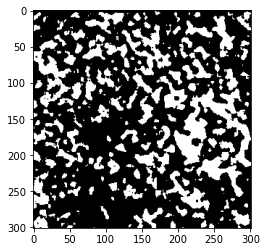

result of k means clustering
True Positive :  1009
True Negative :  62599
False Positive :  26926
False Negative :  67
the oceral error is :  26993
the percentage correct classification :  0.7020673061003742
kappa score :  0.04778111766904647


<ipython-input-566-bc8eda5bb2b1>:11: RuntimeWarning: invalid value encountered in ubyte_scalars
  mean_ratio[i][j]= (1 - np.minimum( img1_mean[i][j]/img2_mean[i][j]  , img2_mean[i][j]/img1_mean[i][j]  ))*255


-----------------------------------------------------------
alpha is :  1.4
median kernel is :  7
clustering image


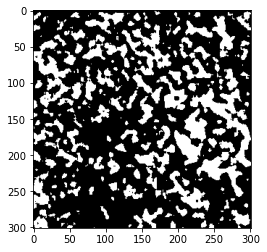

result of k means clustering
True Positive :  974
True Negative :  62743
False Positive :  26782
False Negative :  102
the oceral error is :  26884
the percentage correct classification :  0.7032703833291023
kappa score :  0.04574373461964676


<ipython-input-566-bc8eda5bb2b1>:11: RuntimeWarning: invalid value encountered in ubyte_scalars
  mean_ratio[i][j]= (1 - np.minimum( img1_mean[i][j]/img2_mean[i][j]  , img2_mean[i][j]/img1_mean[i][j]  ))*255


-----------------------------------------------------------
alpha is :  1.45
median kernel is :  7
clustering image


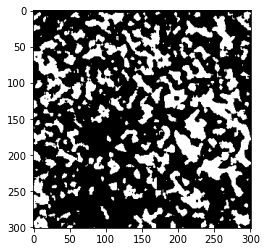

result of k means clustering
True Positive :  945
True Negative :  62794
False Positive :  26731
False Negative :  131
the oceral error is :  26862
the percentage correct classification :  0.7035132062560016
kappa score :  0.04387408083252253


<ipython-input-566-bc8eda5bb2b1>:11: RuntimeWarning: invalid value encountered in ubyte_scalars
  mean_ratio[i][j]= (1 - np.minimum( img1_mean[i][j]/img2_mean[i][j]  , img2_mean[i][j]/img1_mean[i][j]  ))*255


-----------------------------------------------------------
alpha is :  1.5
median kernel is :  7
clustering image


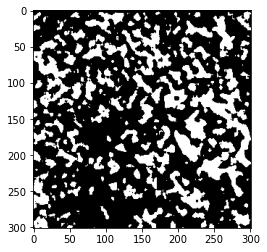

result of k means clustering
True Positive :  921
True Negative :  62864
False Positive :  26661
False Negative :  155
the oceral error is :  26816
the percentage correct classification :  0.7040209269213364
kappa score :  0.042383480840152754


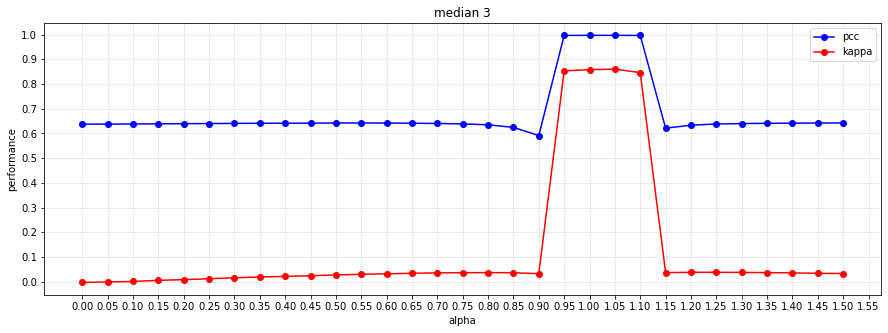

***********************
max pcc is :  0.996799152327237
max kaapa score is :  0.8598911954143876
***********************
     ---------------------------------------------------------------------------------------------------------------


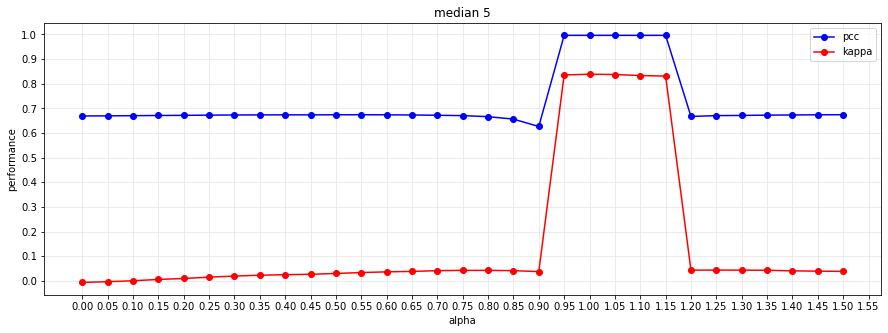

***********************
max pcc is :  0.9963576560965111
max kaapa score is :  0.8384829112895039
***********************
     ---------------------------------------------------------------------------------------------------------------


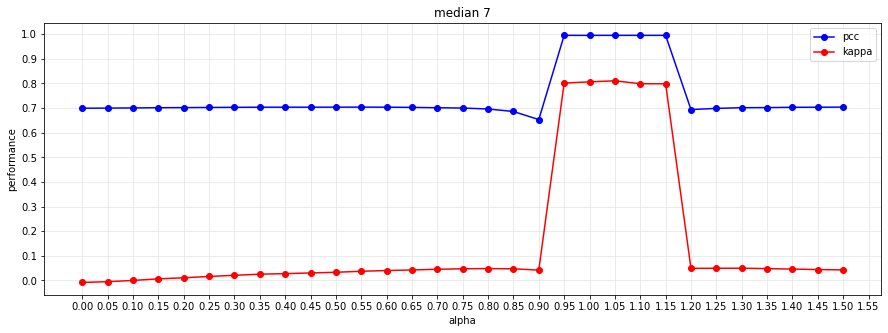

***********************
max pcc is :  0.9955960750985089
max kaapa score is :  0.8108866808014705
***********************
     ---------------------------------------------------------------------------------------------------------------


In [568]:
alpha_set = [0,0.05, 0.1 , 0.15, 0.2,0.25, 0.3 ,0.35, 0.4,0.45, 0.5,0.55 , 0.6 ,0.65, 0.7 ,0.75, 0.8, 0.85, 0.9, 0.95, 1 , 1.05, 1.1 , 1.15,1.2,1.25, 1.3,1.35, 1.4,1.45, 1.5]
median_kernel=[3, 5, 7]

tp2=[]
tn2=[]
fp2=[]
fn2=[]
pcc2=[]
kaapa2=[]
clustered_image2=[]
median2_3channels=[]
for kernel in median_kernel:
  for alpha in alpha_set:
    temp_median2_3channels,temp_clustered_image2, temp_tp2,temp_tn2,temp_fp2,temp_fn2,temp_pcc2,temp_kaapa2 =combined(data2_morphology1, data2_morphology2 ,data2_im_gt ,alpha , kernel,  2,'k-means++' , 500, False)

    median2_3channels.append(temp_median2_3channels)
    clustered_image2.append(temp_clustered_image2)
    tp2.append(temp_tp2)
    tn2.append(temp_tn2)
    fp2.append(temp_fp2)
    fn2.append(temp_fn2)
    pcc2.append(temp_pcc2)
    kaapa2.append(temp_kaapa2)

alpha_plotter(alpha_set,median_kernel, pcc2, kaapa2)

(289, 257)


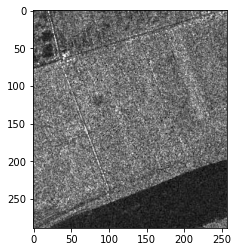

In [492]:
yellow1_path  = r'C:\Users\Asus\Desktop\AUT\Semister 2\DIP\proje\Ottawa_data\Yellow_River_1.bmp'
yellow2_path  = r'C:\Users\Asus\Desktop\AUT\Semister 2\DIP\proje\Ottawa_data\Yellow_River_2.bmp'
yellowgt_path = r'C:\Users\Asus\Desktop\AUT\Semister 2\DIP\proje\Ottawa_data\Yellow_River_gt.bmp'

data3_im1 = io.imread(yellow1_path)
data3_im2 = io.imread(yellow2_path)
data3_im_gt = io.imread(yellowgt_path)
data3_im_gt= cv2.cvtColor(data3_im_gt, cv2.COLOR_BGR2GRAY)


print(data3_im1.shape)
plt.imshow(data3_im1, cmap='gray')

45.98590442833571


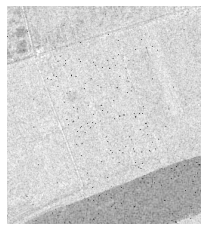

In [483]:
data3_img1_log = logTrans(data3_im1)

45.98590442833571


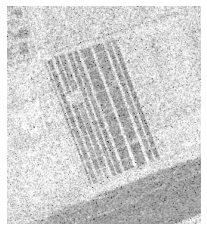

In [484]:
data3_img2_log = logTrans(data3_im2)

In [485]:
data3_img1= cv2.cvtColor(data3_img1_log, cv2.COLOR_GRAY2BGR)
data3_img1 = Image.fromarray(data3_img1, "RGB")
data3_img2= cv2.cvtColor(data3_img2_log, cv2.COLOR_GRAY2BGR)
data3_img2 = Image.fromarray(data3_img2, "RGB")

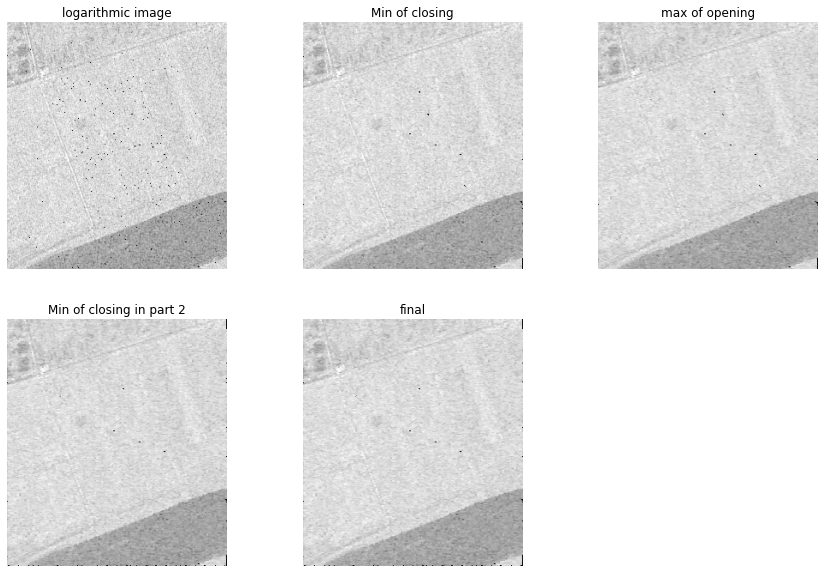

In [486]:

s21=(1,2)
s22=(1,2)  
s23= (1,2)
s24=(1,2)

angel1 = 2
angel2= 5
angel3 = -2
angel4= -5
data3_morphology1 = morphology_with_angel(s21, s22, s23, s24, data3_img1, angel1, angel2, angel3, angel4, True) 

#data3_morphology1 = morphology(s21, s22, s23, s24,  data3_img1_log)

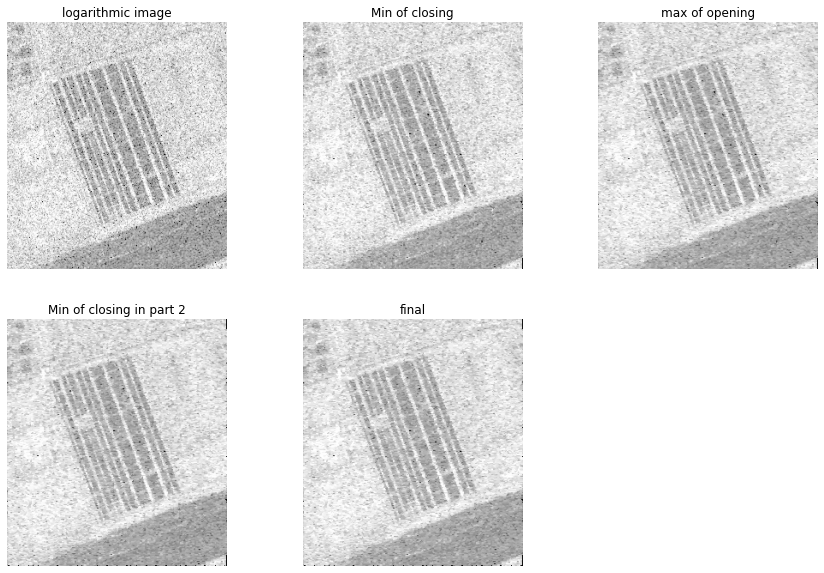

In [487]:

data3_morphology2 = morphology_with_angel(s21, s22, s23, s24, data3_img2, angel1, angel2, angel3, angel4, True)  

#data3_morphology2 = morphology(s21, s22, s23, s24,  data3_img2_log)

In [488]:
s21=(1,2)
s22=(1,2)  
s23= (1,2)
s24=(1,2)

angel1 = [1,2,3,4,5,6,7,8,9]
angel2= [1,2,3,4,5,6,7,8,9]
angel3 = -12
angel4= -24
pcc_tt=[]
#for i in angel1:
#    for j in angel2:
#        data3_morphology1 = morphology_with_angel(s21, s22, s23, s24, data3_img1, i, j, -i, -j, False) 
#
#        data3_morphology2 = morphology_with_angel(s21, s22, s23, s24, data3_img2, i, j, -i, -j, False)  


#        median3_3channels, clustered_image3, tp3,tn3,fp3,fn3,pcc3,kaapa3 =combined(data3_morphology1, data3_morphology2 ,data3_im_gt ,1.05, 5,  2,'k-means++' , 500, False)
        
#        pcc_tt.append(pcc3)
#        print('===-=-=-=--=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-')
#        print('***************************',i)
#        print('***************************',j)
#        print('===-=-=-=--=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-')
#print(np.max(pcc_tt))

-----------------------------------------------------------
alpha is :  1.05
median kernel is :  5


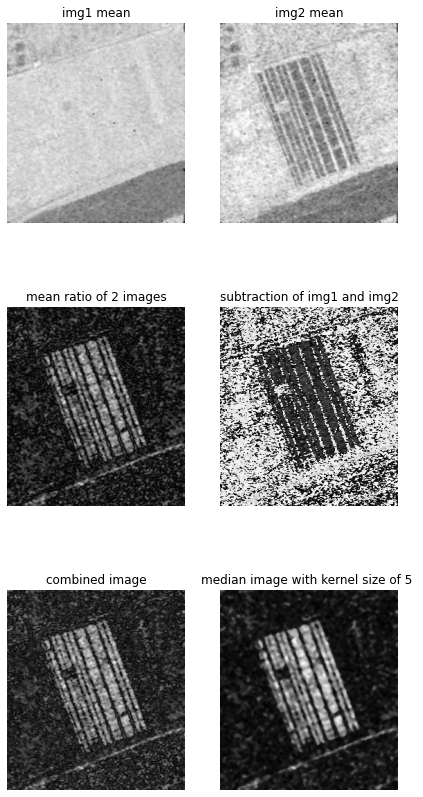

clustering image


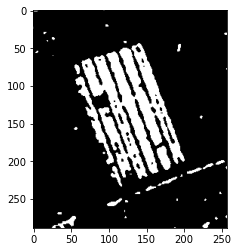

result of k means clustering
True Positive :  11322
True Negative :  59696
False Positive :  1160
False Negative :  2095
the oceral error is :  3255
the percentage correct classification :  0.9561751915231645
kappa score :  0.8478217735304487


In [493]:
median3_3channels, clustered_image3, tp3,tn3,fp3,fn3,pcc3,kaapa3 =combined(data3_morphology1, data3_morphology2 ,data3_im_gt ,1.05, 5,  2,'k-means++' , 500, True)

-----------------------------------------------------------
alpha is :  0
median kernel is :  3
clustering image


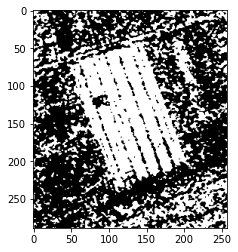

result of k means clustering
True Positive :  12552
True Negative :  40576
False Positive :  20280
False Negative :  865
the oceral error is :  21145
the percentage correct classification :  0.7153070429361948
kappa score :  0.3850903822601528
-----------------------------------------------------------
alpha is :  0.05
median kernel is :  3
clustering image


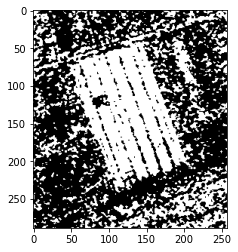

result of k means clustering
True Positive :  12550
True Negative :  40576
False Positive :  20280
False Negative :  867
the oceral error is :  21147
the percentage correct classification :  0.7152801152504948
kappa score :  0.385009375214334
-----------------------------------------------------------
alpha is :  0.1
median kernel is :  3
clustering image


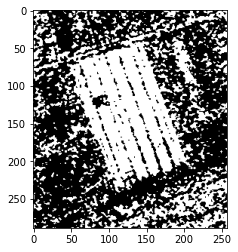

result of k means clustering
True Positive :  12550
True Negative :  40576
False Positive :  20280
False Negative :  867
the oceral error is :  21147
the percentage correct classification :  0.7152801152504948
kappa score :  0.385009375214334
-----------------------------------------------------------
alpha is :  0.15
median kernel is :  3
clustering image


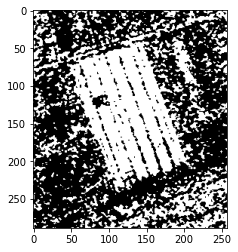

result of k means clustering
True Positive :  12550
True Negative :  40576
False Positive :  20280
False Negative :  867
the oceral error is :  21147
the percentage correct classification :  0.7152801152504948
kappa score :  0.385009375214334
-----------------------------------------------------------
alpha is :  0.2
median kernel is :  3
clustering image


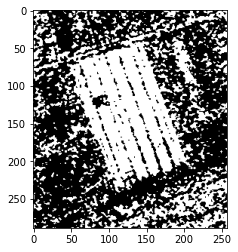

result of k means clustering
True Positive :  12550
True Negative :  40576
False Positive :  20280
False Negative :  867
the oceral error is :  21147
the percentage correct classification :  0.7152801152504948
kappa score :  0.385009375214334
-----------------------------------------------------------
alpha is :  0.25
median kernel is :  3
clustering image


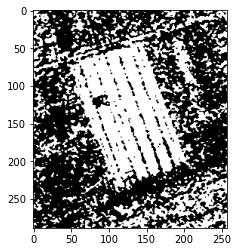

result of k means clustering
True Positive :  12550
True Negative :  40577
False Positive :  20279
False Negative :  867
the oceral error is :  21146
the percentage correct classification :  0.7152935790933448
kappa score :  0.3850270339066916
-----------------------------------------------------------
alpha is :  0.3
median kernel is :  3
clustering image


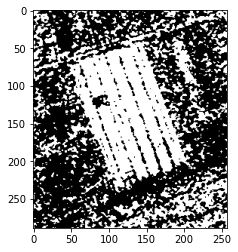

result of k means clustering
True Positive :  12547
True Negative :  40579
False Positive :  20277
False Negative :  870
the oceral error is :  21147
the percentage correct classification :  0.7152801152504948
kappa score :  0.3849408275850339
-----------------------------------------------------------
alpha is :  0.35
median kernel is :  3
clustering image


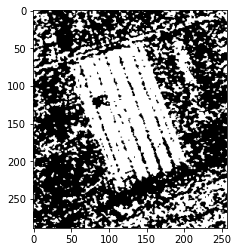

result of k means clustering
True Positive :  12547
True Negative :  40581
False Positive :  20275
False Negative :  870
the oceral error is :  21145
the percentage correct classification :  0.7153070429361948
kappa score :  0.3849761470156301
-----------------------------------------------------------
alpha is :  0.4
median kernel is :  3
clustering image


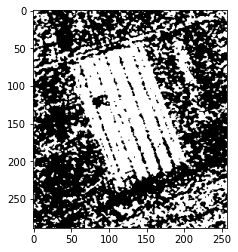

result of k means clustering
True Positive :  12545
True Negative :  40581
False Positive :  20275
False Negative :  872
the oceral error is :  21147
the percentage correct classification :  0.7152801152504948
kappa score :  0.38489512067553056
-----------------------------------------------------------
alpha is :  0.45
median kernel is :  3
clustering image


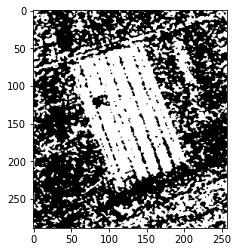

result of k means clustering
True Positive :  12525
True Negative :  40585
False Positive :  20271
False Negative :  892
the oceral error is :  21163
the percentage correct classification :  0.7150646937648943
kappa score :  0.38415513531392353
-----------------------------------------------------------
alpha is :  0.5
median kernel is :  3
clustering image


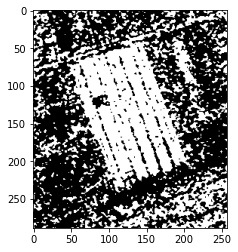

result of k means clustering
True Positive :  12448
True Negative :  40589
False Positive :  20267
False Negative :  969
the oceral error is :  21236
the percentage correct classification :  0.7140818332368425
kappa score :  0.38109906831860496
-----------------------------------------------------------
alpha is :  0.55
median kernel is :  3
clustering image


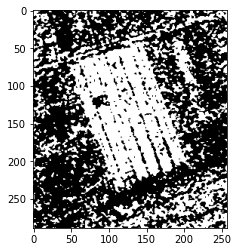

result of k means clustering
True Positive :  12224
True Negative :  40592
False Positive :  20264
False Negative :  1193
the oceral error is :  21457
the percentage correct classification :  0.7111063239669867
kappa score :  0.3720046564823214
-----------------------------------------------------------
alpha is :  0.6
median kernel is :  3
clustering image


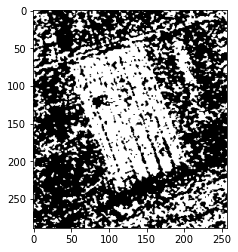

result of k means clustering
True Positive :  11635
True Negative :  40613
False Positive :  20243
False Negative :  1782
the oceral error is :  22025
the percentage correct classification :  0.7034588612281717
kappa score :  0.3479452210182963
-----------------------------------------------------------
alpha is :  0.65
median kernel is :  3
clustering image


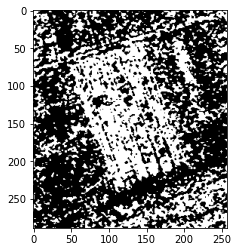

result of k means clustering
True Positive :  10167
True Negative :  40657
False Positive :  20199
False Negative :  3250
the oceral error is :  23449
the percentage correct classification :  0.6842863490097344
kappa score :  0.2853552183896133
-----------------------------------------------------------
alpha is :  0.7
median kernel is :  3
clustering image


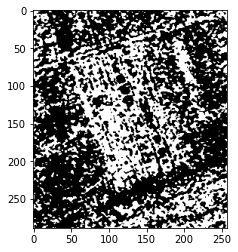

result of k means clustering
True Positive :  7951
True Negative :  40766
False Positive :  20090
False Negative :  5466
the oceral error is :  25556
the percentage correct classification :  0.655918032124729
kappa score :  0.18422074039299252
-----------------------------------------------------------
alpha is :  0.75
median kernel is :  3
clustering image


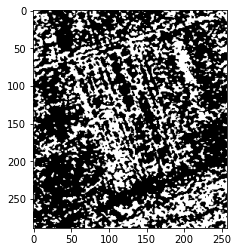

result of k means clustering
True Positive :  5235
True Negative :  41018
False Positive :  19838
False Negative :  8182
the oceral error is :  28020
the percentage correct classification :  0.6227431233422643
kappa score :  0.047955809496450286
-----------------------------------------------------------
alpha is :  0.8
median kernel is :  3
clustering image


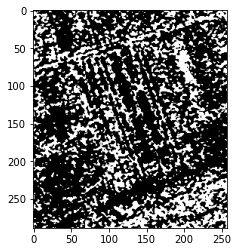

result of k means clustering
True Positive :  2931
True Negative :  41696
False Positive :  19160
False Negative :  10486
the oceral error is :  29646
the percentage correct classification :  0.6008509148681217
kappa score :  -0.07698796386369655
-----------------------------------------------------------
alpha is :  0.85
median kernel is :  3
clustering image


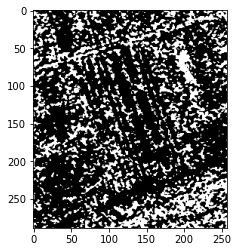

result of k means clustering
True Positive :  1739
True Negative :  42482
False Positive :  18374
False Negative :  11678
the oceral error is :  30052
the percentage correct classification :  0.595384594671011
kappa score :  -0.14425401613822242
-----------------------------------------------------------
alpha is :  0.9
median kernel is :  3
clustering image


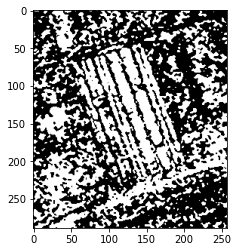

result of k means clustering
True Positive :  10893
True Negative :  37638
False Positive :  23218
False Negative :  2524
the oceral error is :  25742
the percentage correct classification :  0.6534137573546241
kappa score :  0.26877791924945693
-----------------------------------------------------------
alpha is :  0.95
median kernel is :  3
clustering image


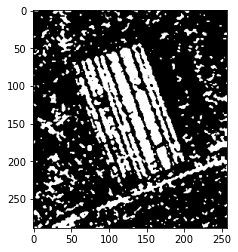

result of k means clustering
True Positive :  10728
True Negative :  53194
False Positive :  7662
False Negative :  2689
the oceral error is :  10351
the percentage correct classification :  0.8606357626593782
kappa score :  0.588640414473429
-----------------------------------------------------------
alpha is :  1
median kernel is :  3
clustering image


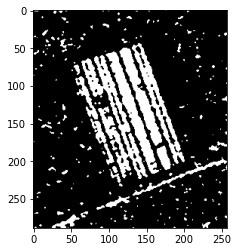

result of k means clustering
True Positive :  11014
True Negative :  58156
False Positive :  2700
False Negative :  2403
the oceral error is :  5103
the percentage correct classification :  0.9312940099363161
kappa score :  0.7698893309034625
-----------------------------------------------------------
alpha is :  1.05
median kernel is :  3
clustering image


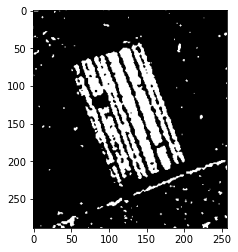

result of k means clustering
True Positive :  11145
True Negative :  59497
False Positive :  1359
False Negative :  2272
the oceral error is :  3631
the percentage correct classification :  0.9511127866115546
kappa score :  0.8303544154019328
-----------------------------------------------------------
alpha is :  1.1
median kernel is :  3
clustering image


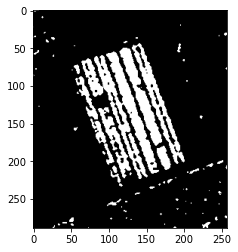

result of k means clustering
True Positive :  10524
True Negative :  60087
False Positive :  769
False Negative :  2893
the oceral error is :  3662
the percentage correct classification :  0.9506954074832038
kappa score :  0.8224912250385588
-----------------------------------------------------------
alpha is :  1.15
median kernel is :  3
clustering image


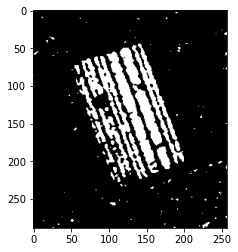

result of k means clustering
True Positive :  9669
True Negative :  60318
False Positive :  538
False Negative :  3748
the oceral error is :  4286
the percentage correct classification :  0.9422939695447875
kappa score :  0.7850155500995436
-----------------------------------------------------------
alpha is :  1.2
median kernel is :  3
clustering image


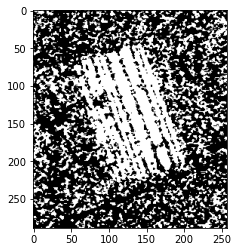

result of k means clustering
True Positive :  11516
True Negative :  41335
False Positive :  19521
False Negative :  1901
the oceral error is :  21422
the percentage correct classification :  0.7115775584667375
kappa score :  0.3555486983532685
-----------------------------------------------------------
alpha is :  1.25
median kernel is :  3
clustering image


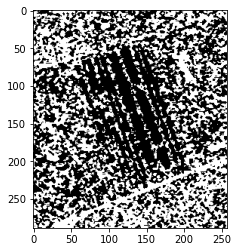

result of k means clustering
True Positive :  2323
True Negative :  29773
False Positive :  31083
False Negative :  11094
the oceral error is :  42177
the percentage correct classification :  0.4321355001144427
kappa score :  -0.2135943381239085
-----------------------------------------------------------
alpha is :  1.3
median kernel is :  3
clustering image


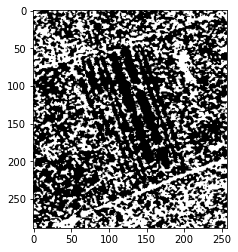

result of k means clustering
True Positive :  2805
True Negative :  35545
False Positive :  25311
False Negative :  10612
the oceral error is :  35923
the percentage correct classification :  0.5163383732985068
kappa score :  -0.14495598367974805
-----------------------------------------------------------
alpha is :  1.35
median kernel is :  3
clustering image


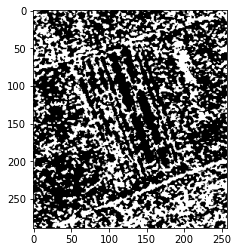

result of k means clustering
True Positive :  4003
True Negative :  37464
False Positive :  23392
False Negative :  9414
the oceral error is :  32806
the percentage correct classification :  0.5583051714620387
kappa score :  -0.061185071524591184
-----------------------------------------------------------
alpha is :  1.4
median kernel is :  3
clustering image


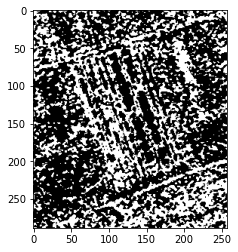

result of k means clustering
True Positive :  5469
True Negative :  38582
False Positive :  22274
False Negative :  7948
the oceral error is :  30222
the percentage correct classification :  0.5930957413865066
kappa score :  0.02937896502331272
-----------------------------------------------------------
alpha is :  1.45
median kernel is :  3
clustering image


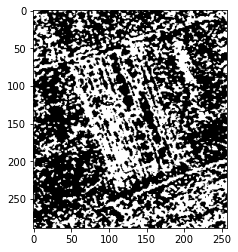

result of k means clustering
True Positive :  7849
True Negative :  38851
False Positive :  22005
False Negative :  5568
the oceral error is :  27573
the percentage correct classification :  0.6287614610962261
kappa score :  0.15121048102747325
-----------------------------------------------------------
alpha is :  1.5
median kernel is :  3
clustering image


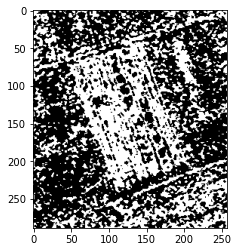

result of k means clustering
True Positive :  9906
True Negative :  39245
False Positive :  21611
False Negative :  3511
the oceral error is :  25122
the percentage correct classification :  0.6617613399216404
kappa score :  0.25114604392605744
-----------------------------------------------------------
alpha is :  0
median kernel is :  5
clustering image


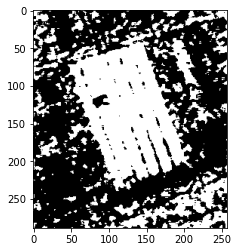

result of k means clustering
True Positive :  12595
True Negative :  42354
False Positive :  18502
False Negative :  822
the oceral error is :  19324
the percentage correct classification :  0.7398247007660926
kappa score :  0.41933357400241555
-----------------------------------------------------------
alpha is :  0.05
median kernel is :  5
clustering image


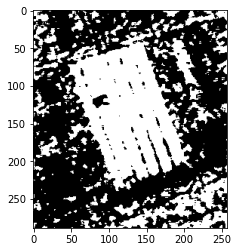

result of k means clustering
True Positive :  12595
True Negative :  42354
False Positive :  18502
False Negative :  822
the oceral error is :  19324
the percentage correct classification :  0.7398247007660926
kappa score :  0.41933357400241555
-----------------------------------------------------------
alpha is :  0.1
median kernel is :  5
clustering image


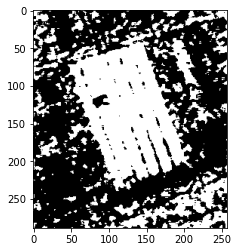

result of k means clustering
True Positive :  12595
True Negative :  42354
False Positive :  18502
False Negative :  822
the oceral error is :  19324
the percentage correct classification :  0.7398247007660926
kappa score :  0.41933357400241555
-----------------------------------------------------------
alpha is :  0.15
median kernel is :  5
clustering image


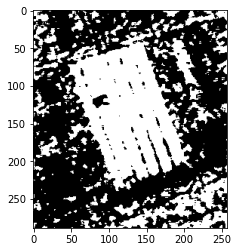

result of k means clustering
True Positive :  12595
True Negative :  42354
False Positive :  18502
False Negative :  822
the oceral error is :  19324
the percentage correct classification :  0.7398247007660926
kappa score :  0.41933357400241555
-----------------------------------------------------------
alpha is :  0.2
median kernel is :  5
clustering image


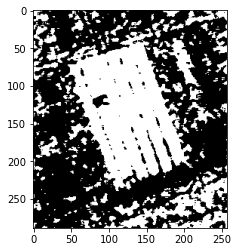

result of k means clustering
True Positive :  12595
True Negative :  42355
False Positive :  18501
False Negative :  822
the oceral error is :  19323
the percentage correct classification :  0.7398381646089427
kappa score :  0.4193524788323617
-----------------------------------------------------------
alpha is :  0.25
median kernel is :  5
clustering image


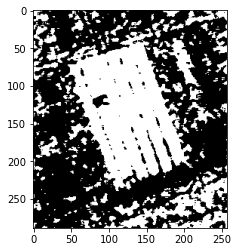

result of k means clustering
True Positive :  12595
True Negative :  42355
False Positive :  18501
False Negative :  822
the oceral error is :  19323
the percentage correct classification :  0.7398381646089427
kappa score :  0.4193524788323617
-----------------------------------------------------------
alpha is :  0.3
median kernel is :  5
clustering image


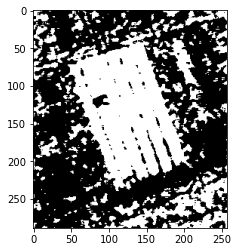

result of k means clustering
True Positive :  12595
True Negative :  42355
False Positive :  18501
False Negative :  822
the oceral error is :  19323
the percentage correct classification :  0.7398381646089427
kappa score :  0.4193524788323617
-----------------------------------------------------------
alpha is :  0.35
median kernel is :  5
clustering image


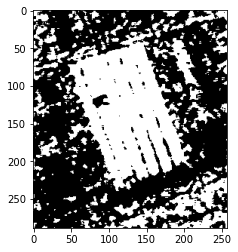

result of k means clustering
True Positive :  12594
True Negative :  42365
False Positive :  18491
False Negative :  823
the oceral error is :  19314
the percentage correct classification :  0.7399593391945929
kappa score :  0.41950036806892566
-----------------------------------------------------------
alpha is :  0.4
median kernel is :  5
clustering image


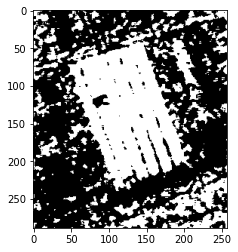

result of k means clustering
True Positive :  12594
True Negative :  42365
False Positive :  18491
False Negative :  823
the oceral error is :  19314
the percentage correct classification :  0.7399593391945929
kappa score :  0.41950036806892566
-----------------------------------------------------------
alpha is :  0.45
median kernel is :  5
clustering image


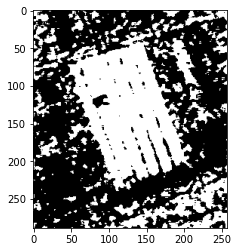

result of k means clustering
True Positive :  12592
True Negative :  42370
False Positive :  18486
False Negative :  825
the oceral error is :  19311
the percentage correct classification :  0.739999730723143
kappa score :  0.4195125302754378
-----------------------------------------------------------
alpha is :  0.5
median kernel is :  5
clustering image


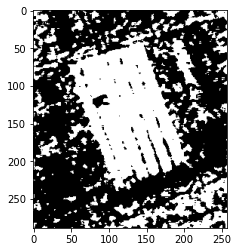

result of k means clustering
True Positive :  12589
True Negative :  42376
False Positive :  18480
False Negative :  828
the oceral error is :  19308
the percentage correct classification :  0.7400401222516931
kappa score :  0.41950240208811396
-----------------------------------------------------------
alpha is :  0.55
median kernel is :  5
clustering image


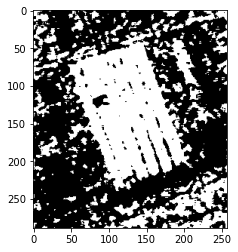

result of k means clustering
True Positive :  12534
True Negative :  42390
False Positive :  18466
False Negative :  883
the oceral error is :  19349
the percentage correct classification :  0.739488104694842
kappa score :  0.4174979147358139
-----------------------------------------------------------
alpha is :  0.6
median kernel is :  5
clustering image


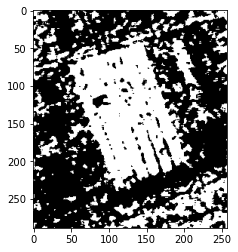

result of k means clustering
True Positive :  12232
True Negative :  42443
False Positive :  18413
False Negative :  1185
the oceral error is :  19598
the percentage correct classification :  0.7361356078251855
kappa score :  0.405946704092369
-----------------------------------------------------------
alpha is :  0.65
median kernel is :  5
clustering image


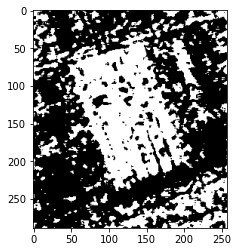

result of k means clustering
True Positive :  11425
True Negative :  42542
False Positive :  18314
False Negative :  1992
the oceral error is :  20306
the percentage correct classification :  0.7266032070873669
kappa score :  0.3734965582498557
-----------------------------------------------------------
alpha is :  0.7
median kernel is :  5
clustering image


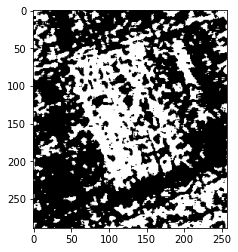

result of k means clustering
True Positive :  9288
True Negative :  42763
False Positive :  18093
False Negative :  4129
the oceral error is :  22222
the percentage correct classification :  0.7008064841867165
kappa score :  0.2809706279135651
-----------------------------------------------------------
alpha is :  0.75
median kernel is :  5
clustering image


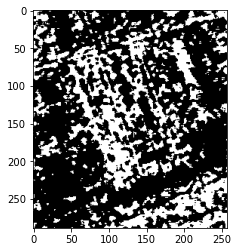

result of k means clustering
True Positive :  5544
True Negative :  43372
False Positive :  17484
False Negative :  7873
the oceral error is :  25357
the percentage correct classification :  0.6585973368518843
kappa score :  0.0984255499708474
-----------------------------------------------------------
alpha is :  0.8
median kernel is :  5
clustering image


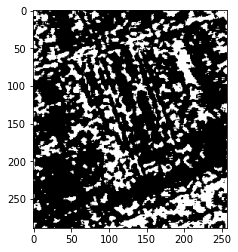

result of k means clustering
True Positive :  2722
True Negative :  44375
False Positive :  16481
False Negative :  10695
the oceral error is :  27176
the percentage correct classification :  0.6341066067076865
kappa score :  -0.05816595427030369
-----------------------------------------------------------
alpha is :  0.85
median kernel is :  5
clustering image


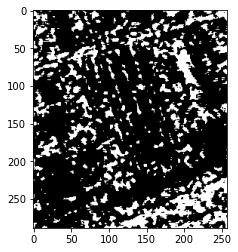

result of k means clustering
True Positive :  1115
True Negative :  45771
False Positive :  15085
False Negative :  12302
the oceral error is :  27387
the percentage correct classification :  0.631265735866331
kappa score :  -0.15245157723969815
-----------------------------------------------------------
alpha is :  0.9
median kernel is :  5
clustering image


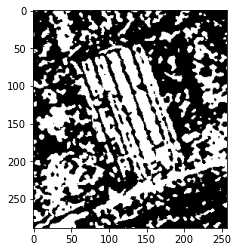

result of k means clustering
True Positive :  11029
True Negative :  40881
False Positive :  19975
False Negative :  2388
the oceral error is :  22363
the percentage correct classification :  0.6989080823448629
kappa score :  0.32681315342383666
-----------------------------------------------------------
alpha is :  0.95
median kernel is :  5
clustering image


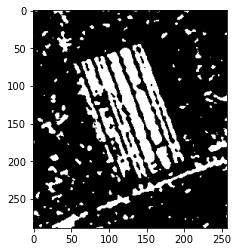

result of k means clustering
True Positive :  10561
True Negative :  56086
False Positive :  4770
False Negative :  2856
the oceral error is :  7626
the percentage correct classification :  0.8973247344256998
kappa score :  0.6714217310087552
-----------------------------------------------------------
alpha is :  1
median kernel is :  5
clustering image


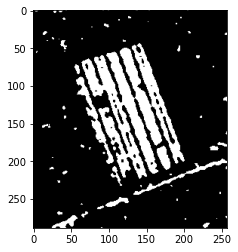

result of k means clustering
True Positive :  11063
True Negative :  59155
False Positive :  1701
False Negative :  2354
the oceral error is :  4055
the percentage correct classification :  0.9454041172431435
kappa score :  0.8120031494722038
-----------------------------------------------------------
alpha is :  1.05
median kernel is :  5
clustering image


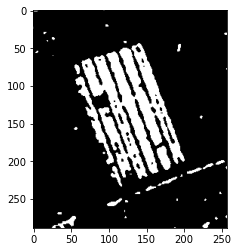

result of k means clustering
True Positive :  11322
True Negative :  59696
False Positive :  1160
False Negative :  2095
the oceral error is :  3255
the percentage correct classification :  0.9561751915231645
kappa score :  0.8478217735304487
-----------------------------------------------------------
alpha is :  1.1
median kernel is :  5
clustering image


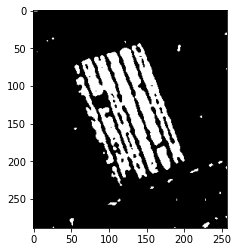

result of k means clustering
True Positive :  10671
True Negative :  60100
False Positive :  756
False Negative :  2746
the oceral error is :  3502
the percentage correct classification :  0.952849622339208
kappa score :  0.8309482763626339
-----------------------------------------------------------
alpha is :  1.15
median kernel is :  5
clustering image


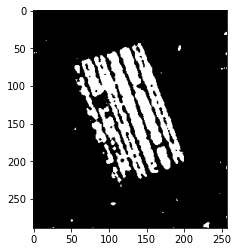

result of k means clustering
True Positive :  10504
True Negative :  60101
False Positive :  755
False Negative :  2913
the oceral error is :  3668
the percentage correct classification :  0.9506146244261037
kappa score :  0.8220130275708523
-----------------------------------------------------------
alpha is :  1.2
median kernel is :  5
clustering image


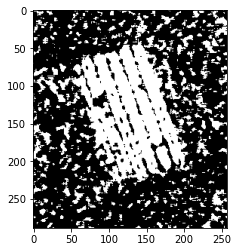

result of k means clustering
True Positive :  11832
True Negative :  47116
False Positive :  13740
False Negative :  1585
the oceral error is :  15325
the percentage correct classification :  0.7936666083233477
kappa score :  0.48487609412100063
-----------------------------------------------------------
alpha is :  1.25
median kernel is :  5
clustering image


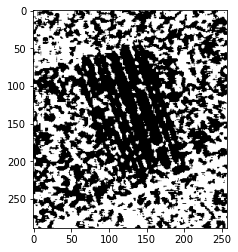

result of k means clustering
True Positive :  1756
True Negative :  27933
False Positive :  32923
False Negative :  11661
the oceral error is :  44584
the percentage correct classification :  0.39972803037442944
kappa score :  -0.25352620580523433
-----------------------------------------------------------
alpha is :  1.3
median kernel is :  5
clustering image


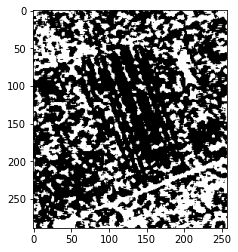

result of k means clustering
True Positive :  2165
True Negative :  36455
False Positive :  24401
False Negative :  11252
the oceral error is :  35653
the percentage correct classification :  0.519973610868014
kappa score :  -0.17337491138362893
-----------------------------------------------------------
alpha is :  1.35
median kernel is :  5
clustering image


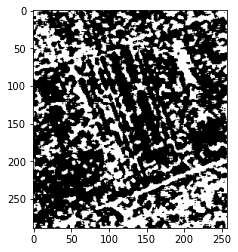

result of k means clustering
True Positive :  3497
True Negative :  39015
False Positive :  21841
False Negative :  9920
the oceral error is :  31761
the percentage correct classification :  0.5723748872403162
kappa score :  -0.07298263554505624
-----------------------------------------------------------
alpha is :  1.4
median kernel is :  5
clustering image


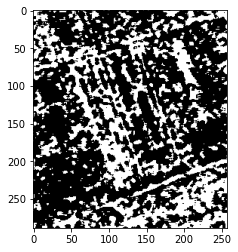

result of k means clustering
True Positive :  5165
True Negative :  40447
False Positive :  20409
False Negative :  8252
the oceral error is :  28661
the percentage correct classification :  0.6141128000753975
kappa score :  0.03665041744565711
-----------------------------------------------------------
alpha is :  1.45
median kernel is :  5
clustering image


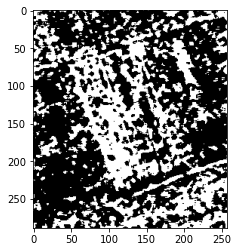

result of k means clustering
True Positive :  8089
True Negative :  40574
False Positive :  20282
False Negative :  5328
the oceral error is :  25610
the percentage correct classification :  0.6551909846108276
kappa score :  0.18796054944561846
-----------------------------------------------------------
alpha is :  1.5
median kernel is :  5
clustering image


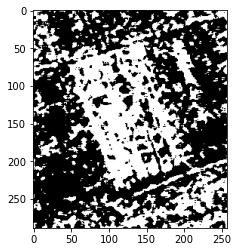

result of k means clustering
True Positive :  10468
True Negative :  40828
False Positive :  20028
False Negative :  2949
the oceral error is :  22977
the percentage correct classification :  0.6906412828349467
kappa score :  0.30150771834627454
-----------------------------------------------------------
alpha is :  0
median kernel is :  7
clustering image


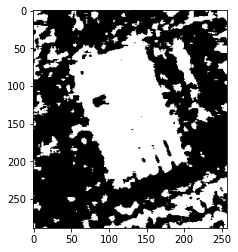

result of k means clustering
True Positive :  12603
True Negative :  43270
False Positive :  17586
False Negative :  814
the oceral error is :  18400
the percentage correct classification :  0.7522652915595169
kappa score :  0.43729258360114487
-----------------------------------------------------------
alpha is :  0.05
median kernel is :  7
clustering image


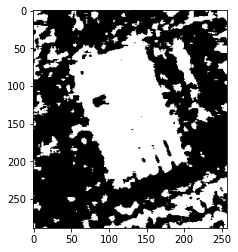

result of k means clustering
True Positive :  12603
True Negative :  43270
False Positive :  17586
False Negative :  814
the oceral error is :  18400
the percentage correct classification :  0.7522652915595169
kappa score :  0.43729258360114487
-----------------------------------------------------------
alpha is :  0.1
median kernel is :  7
clustering image


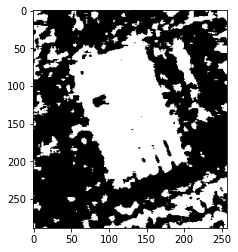

result of k means clustering
True Positive :  12603
True Negative :  43270
False Positive :  17586
False Negative :  814
the oceral error is :  18400
the percentage correct classification :  0.7522652915595169
kappa score :  0.43729258360114487
-----------------------------------------------------------
alpha is :  0.15
median kernel is :  7
clustering image


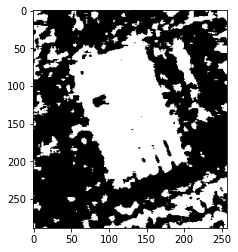

result of k means clustering
True Positive :  12603
True Negative :  43270
False Positive :  17586
False Negative :  814
the oceral error is :  18400
the percentage correct classification :  0.7522652915595169
kappa score :  0.43729258360114487
-----------------------------------------------------------
alpha is :  0.2
median kernel is :  7
clustering image


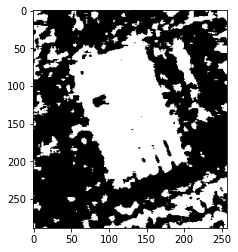

result of k means clustering
True Positive :  12603
True Negative :  43270
False Positive :  17586
False Negative :  814
the oceral error is :  18400
the percentage correct classification :  0.7522652915595169
kappa score :  0.43729258360114487
-----------------------------------------------------------
alpha is :  0.25
median kernel is :  7
clustering image


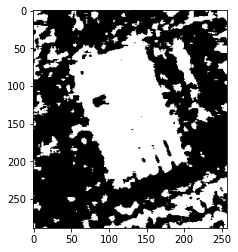

result of k means clustering
True Positive :  12603
True Negative :  43270
False Positive :  17586
False Negative :  814
the oceral error is :  18400
the percentage correct classification :  0.7522652915595169
kappa score :  0.43729258360114487
-----------------------------------------------------------
alpha is :  0.3
median kernel is :  7
clustering image


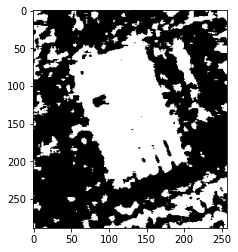

result of k means clustering
True Positive :  12603
True Negative :  43270
False Positive :  17586
False Negative :  814
the oceral error is :  18400
the percentage correct classification :  0.7522652915595169
kappa score :  0.43729258360114487
-----------------------------------------------------------
alpha is :  0.35
median kernel is :  7
clustering image


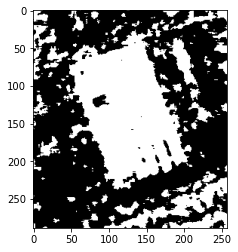

result of k means clustering
True Positive :  12603
True Negative :  43274
False Positive :  17582
False Negative :  814
the oceral error is :  18396
the percentage correct classification :  0.7523191469309171
kappa score :  0.4373709519244966
-----------------------------------------------------------
alpha is :  0.4
median kernel is :  7
clustering image


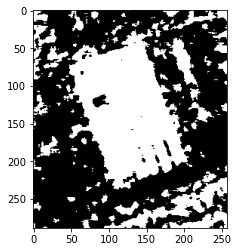

result of k means clustering
True Positive :  12603
True Negative :  43279
False Positive :  17577
False Negative :  814
the oceral error is :  18391
the percentage correct classification :  0.7523864661451671
kappa score :  0.4374689295528764
-----------------------------------------------------------
alpha is :  0.45
median kernel is :  7
clustering image


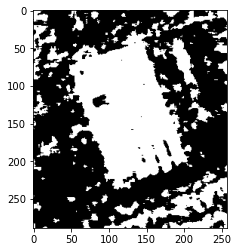

result of k means clustering
True Positive :  12601
True Negative :  43284
False Positive :  17572
False Negative :  816
the oceral error is :  18388
the percentage correct classification :  0.7524268576737172
kappa score :  0.4374837644524432
-----------------------------------------------------------
alpha is :  0.5
median kernel is :  7
clustering image


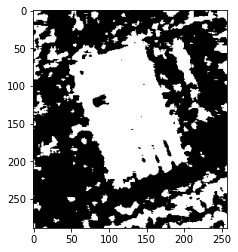

result of k means clustering
True Positive :  12600
True Negative :  43289
False Positive :  17567
False Negative :  817
the oceral error is :  18384
the percentage correct classification :  0.7524807130451173
kappa score :  0.43754019055706594
-----------------------------------------------------------
alpha is :  0.55
median kernel is :  7
clustering image


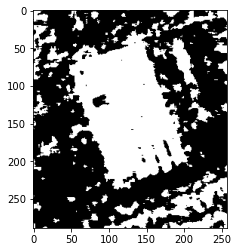

result of k means clustering
True Positive :  12598
True Negative :  43296
False Positive :  17560
False Negative :  819
the oceral error is :  18379
the percentage correct classification :  0.7525480322593675
kappa score :  0.43759425407379837
-----------------------------------------------------------
alpha is :  0.6
median kernel is :  7
clustering image


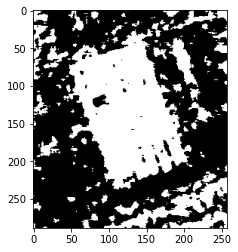

result of k means clustering
True Positive :  12521
True Negative :  43330
False Positive :  17526
False Negative :  896
the oceral error is :  18422
the percentage correct classification :  0.7519690870168163
kappa score :  0.43505279356253546
-----------------------------------------------------------
alpha is :  0.65
median kernel is :  7
clustering image


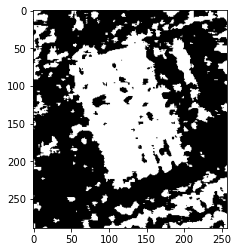

result of k means clustering
True Positive :  12000
True Negative :  43459
False Positive :  17397
False Negative :  1417
the oceral error is :  18814
the percentage correct classification :  0.746691260619606
kappa score :  0.41559076756650004
-----------------------------------------------------------
alpha is :  0.7
median kernel is :  7
clustering image


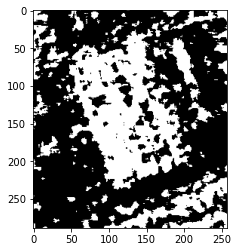

result of k means clustering
True Positive :  10323
True Negative :  43776
False Positive :  17080
False Negative :  3094
the oceral error is :  20174
the percentage correct classification :  0.7283804343435704
kappa score :  0.34753369056071304
-----------------------------------------------------------
alpha is :  0.75
median kernel is :  7
clustering image


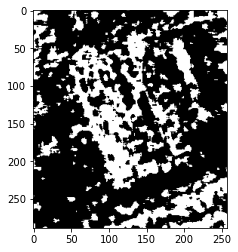

result of k means clustering
True Positive :  6514
True Negative :  44663
False Positive :  16193
False Negative :  6903
the oceral error is :  23096
the percentage correct classification :  0.6890390855357936
kappa score :  0.17278577367985648
-----------------------------------------------------------
alpha is :  0.8
median kernel is :  7
clustering image


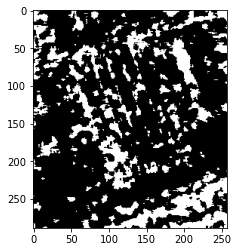

result of k means clustering
True Positive :  2506
True Negative :  46316
False Positive :  14540
False Negative :  10911
the oceral error is :  25451
the percentage correct classification :  0.6573317356239818
kappa score :  -0.047173548775528484
-----------------------------------------------------------
alpha is :  0.85
median kernel is :  7
clustering image


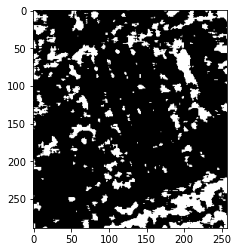

result of k means clustering
True Positive :  678
True Negative :  48365
False Positive :  12491
False Negative :  12739
the oceral error is :  25230
the percentage correct classification :  0.6603072448938376
kappa score :  -0.15584489266764945
-----------------------------------------------------------
alpha is :  0.9
median kernel is :  7
clustering image


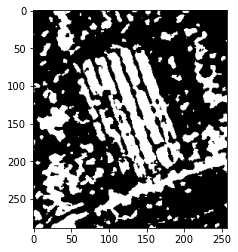

result of k means clustering
True Positive :  10339
True Negative :  46431
False Positive :  14425
False Negative :  3078
the oceral error is :  17503
the percentage correct classification :  0.7643423585959904
kappa score :  0.40128025740182327
-----------------------------------------------------------
alpha is :  0.95
median kernel is :  7
clustering image


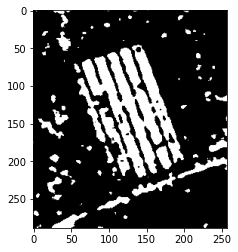

result of k means clustering
True Positive :  10879
True Negative :  56202
False Positive :  4654
False Negative :  2538
the oceral error is :  7192
the percentage correct classification :  0.9031680422226112
kappa score :  0.6918344049297116
-----------------------------------------------------------
alpha is :  1
median kernel is :  7
clustering image


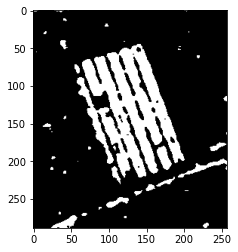

result of k means clustering
True Positive :  11526
True Negative :  58679
False Positive :  2177
False Negative :  1891
the oceral error is :  4068
the percentage correct classification :  0.9452290872860932
kappa score :  0.8165026719319997
-----------------------------------------------------------
alpha is :  1.05
median kernel is :  7
clustering image


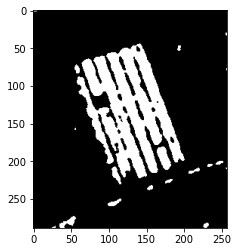

result of k means clustering
True Positive :  11462
True Negative :  59377
False Positive :  1479
False Negative :  1955
the oceral error is :  3434
the percentage correct classification :  0.9537651636530099
kappa score :  0.8416238831376193
-----------------------------------------------------------
alpha is :  1.1
median kernel is :  7
clustering image


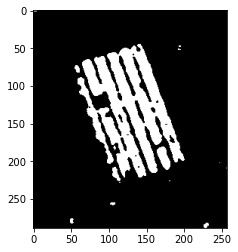

result of k means clustering
True Positive :  10767
True Negative :  59779
False Positive :  1077
False Negative :  2650
the oceral error is :  3727
the percentage correct classification :  0.9498202576979522
kappa score :  0.8223706756043224
-----------------------------------------------------------
alpha is :  1.15
median kernel is :  7
clustering image


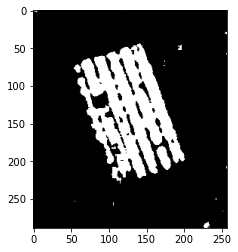

result of k means clustering
True Positive :  11251
True Negative :  59062
False Positive :  1794
False Negative :  2166
the oceral error is :  3960
the percentage correct classification :  0.946683182313896
kappa score :  0.8179225638080826
-----------------------------------------------------------
alpha is :  1.2
median kernel is :  7
clustering image


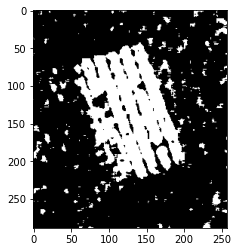

result of k means clustering
True Positive :  11524
True Negative :  55108
False Positive :  5748
False Negative :  1893
the oceral error is :  7641
the percentage correct classification :  0.8971227767829494
kappa score :  0.6874695863895017
-----------------------------------------------------------
alpha is :  1.25
median kernel is :  7
clustering image


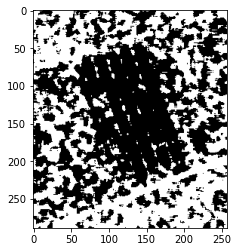

result of k means clustering
True Positive :  1432
True Negative :  27705
False Positive :  33151
False Negative :  11985
the oceral error is :  45136
the percentage correct classification :  0.392295989121215
kappa score :  -0.2712378465979355
-----------------------------------------------------------
alpha is :  1.3
median kernel is :  7
clustering image


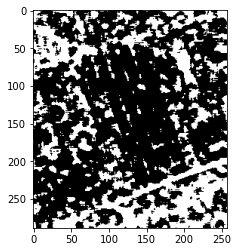

result of k means clustering
True Positive :  1748
True Negative :  38193
False Positive :  22663
False Negative :  11669
the oceral error is :  34332
the percentage correct classification :  0.5377593472728986
kappa score :  -0.18351190847469367
-----------------------------------------------------------
alpha is :  1.35
median kernel is :  7
clustering image


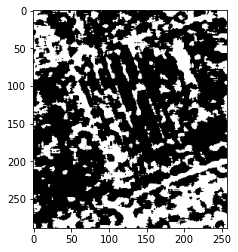

result of k means clustering
True Positive :  3435
True Negative :  39981
False Positive :  20875
False Negative :  9982
the oceral error is :  30857
the percentage correct classification :  0.5845462011767398
kappa score :  -0.06609055721967882
-----------------------------------------------------------
alpha is :  1.4
median kernel is :  7
clustering image


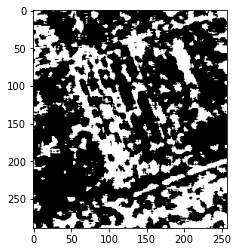

result of k means clustering
True Positive :  5273
True Negative :  41439
False Positive :  19417
False Negative :  8144
the oceral error is :  27561
the percentage correct classification :  0.6289230272104264
kappa score :  0.055702633497689114
-----------------------------------------------------------
alpha is :  1.45
median kernel is :  7
clustering image


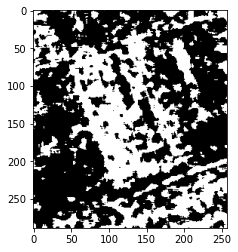

result of k means clustering
True Positive :  9150
True Negative :  40886
False Positive :  19970
False Negative :  4267
the oceral error is :  24237
the percentage correct classification :  0.6736768408439137
kappa score :  0.24297867965272002
-----------------------------------------------------------
alpha is :  1.5
median kernel is :  7
clustering image


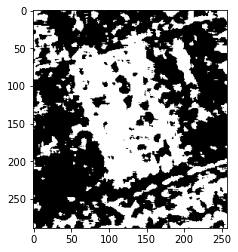

result of k means clustering
True Positive :  11427
True Negative :  41200
False Positive :  19656
False Negative :  1990
the oceral error is :  21646
the percentage correct classification :  0.7085616576683317
kappa score :  0.34938503200073545


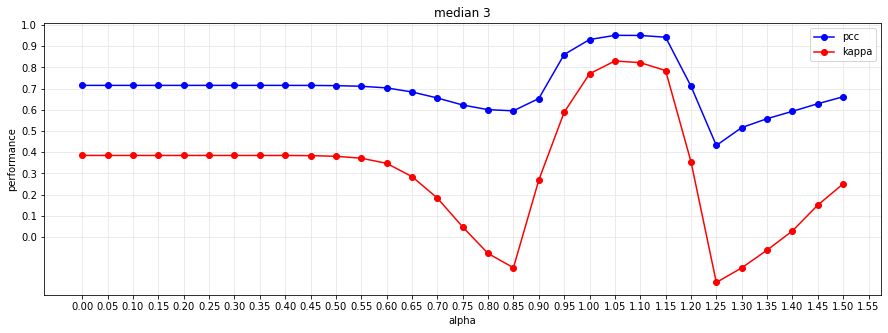

***********************
max pcc is :  0.9511127866115546
max kaapa score is :  0.8303544154019328
***********************
     ---------------------------------------------------------------------------------------------------------------


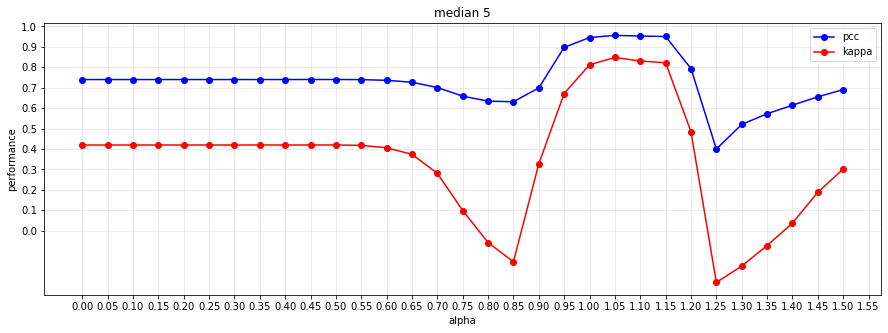

***********************
max pcc is :  0.9561751915231645
max kaapa score is :  0.8478217735304487
***********************
     ---------------------------------------------------------------------------------------------------------------


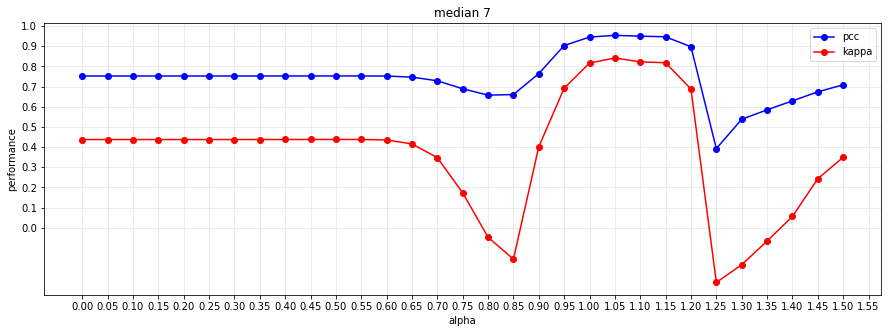

***********************
max pcc is :  0.9537651636530099
max kaapa score is :  0.8416238831376193
***********************
     ---------------------------------------------------------------------------------------------------------------


In [569]:
alpha_set = [0,0.05, 0.1 , 0.15, 0.2,0.25, 0.3 ,0.35, 0.4,0.45, 0.5,0.55 , 0.6 ,0.65, 0.7 ,0.75, 0.8, 0.85, 0.9, 0.95, 1 , 1.05, 1.1 , 1.15,1.2,1.25, 1.3,1.35, 1.4,1.45, 1.5]
median_kernel=[3,5,7]

tp3=[]
tn3=[]
fp3=[]
fn3=[]
pcc3=[]
kaapa3=[]
clustered_image3=[]
median3_3channels=[]


for kernel in median_kernel:
  for alpha in alpha_set:
    temp_median3_3channels,temp_clustered_image3, temp_tp3,temp_tn3,temp_fp3,temp_fn3,temp_pcc3,temp_kaapa3 =combined(data3_morphology1, data3_morphology2 ,data3_im_gt ,alpha, kernel,  2,'k-means++' , 500, False)

    median3_3channels.append(temp_median3_3channels)
    clustered_image3.append(temp_clustered_image3)
    tp3.append(temp_tp3)
    tn3.append(temp_tn3)
    fp3.append(temp_fp3)
    fn3.append(temp_fn3)
    pcc3.append(temp_pcc3)
    kaapa3.append(temp_kaapa3)

alpha_plotter(alpha_set,median_kernel, pcc3, kaapa3)

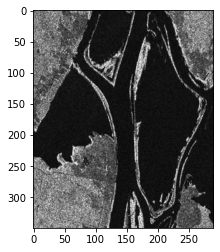

In [693]:
im1_path  = r'C:\Users\Asus\Desktop\AUT\Semister 2\DIP\proje\Ottawa_data\ottawa_1.bmp'
im2_path  =  r'C:\Users\Asus\Desktop\AUT\Semister 2\DIP\proje\Ottawa_data\ottawa_2.bmp'
imgt_path =  r'C:\Users\Asus\Desktop\AUT\Semister 2\DIP\proje\Ottawa_data\ottawa_gt.bmp'

im1 = io.imread(im1_path)
im1_gray= cv2.cvtColor(im1, cv2.COLOR_BGR2GRAY)
im2 = io.imread(im2_path)
im2_gray= cv2.cvtColor(im2, cv2.COLOR_BGR2GRAY)
im_gt = io.imread(imgt_path)
im_gt= cv2.cvtColor(im_gt, cv2.COLOR_BGR2GRAY)

plt.imshow(im1_gray, cmap='gray')

In [570]:
def normalizer(img):
    maximum = img.max()
    minimum = img.min()
    return ((img - minimum) / (maximum - minimum) * 255).astype(np.uint8)
def golden_denoiser(noisy_image):
    denoised_image = normalizer(denoise_tv_chambolle(noisy_image))
    denoised_image = cv2.fastNlMeansDenoising(denoised_image, h=5, templateWindowSize=11, searchWindowSize=11)
    plt.imshow(denoised_image, cmap='gray')
    return denoised_image

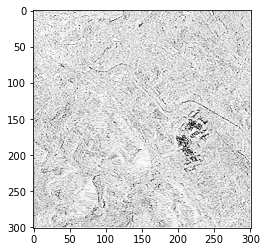

In [596]:
noisy_image1 = data2_img2_log
kernel = np.array([[0, -1, 0],
                       [-1, 5, -1],
                       [0, -1, 0]])
sharped_image1 = cv2.filter2D(src=noisy_image1, ddepth=-1, kernel=kernel)
plt.imshow(sharped_image1, cmap='gray')


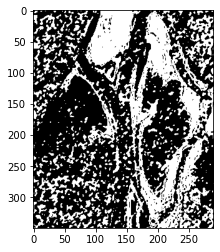

True Positive :  14585
True Negative :  60913
False Positive :  24714
False Negative :  1280
the oceral error is :  25994
the percentage correct classification :  0.7438226600985222
kappa score :  0.39371941302466795


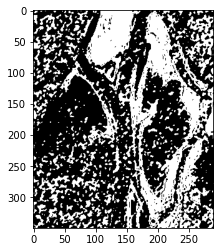

True Positive :  14695
True Negative :  60890
False Positive :  24737
False Negative :  1170
the oceral error is :  25907
the percentage correct classification :  0.744679802955665
kappa score :  0.39705243212506514


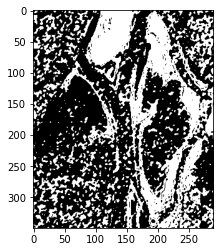

True Positive :  14817
True Negative :  60865
False Positive :  24762
False Negative :  1048
the oceral error is :  25810
the percentage correct classification :  0.7456354679802956
kappa score :  0.40071800501829935


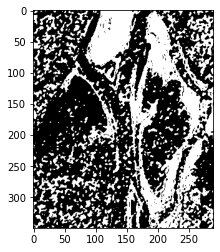

True Positive :  14965
True Negative :  60836
False Positive :  24791
False Negative :  900
the oceral error is :  25691
the percentage correct classification :  0.746807881773399
kappa score :  0.40515992072134166


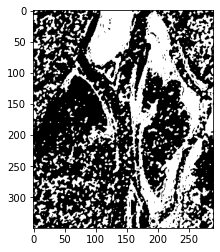

True Positive :  15105
True Negative :  60810
False Positive :  24817
False Negative :  760
the oceral error is :  25577
the percentage correct classification :  0.7479310344827587
kappa score :  0.4093584138904566


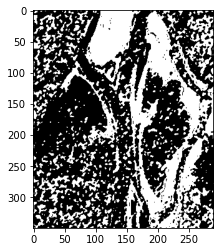

True Positive :  15268
True Negative :  60783
False Positive :  24844
False Negative :  597
the oceral error is :  25441
the percentage correct classification :  0.7492709359605911
kappa score :  0.41426385967037616


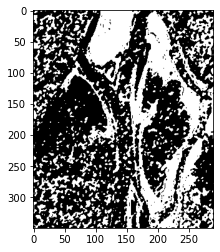

True Positive :  15239
True Negative :  60768
False Positive :  24859
False Negative :  626
the oceral error is :  25485
the percentage correct classification :  0.7488374384236454
kappa score :  0.4131211770401163


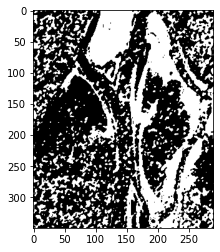

True Positive :  15474
True Negative :  60718
False Positive :  24909
False Negative :  391
the oceral error is :  25300
the percentage correct classification :  0.7506600985221675
kappa score :  0.41999560527727475


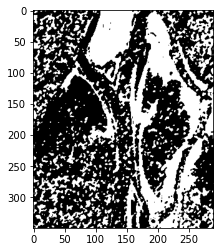

True Positive :  15522
True Negative :  60699
False Positive :  24928
False Negative :  343
the oceral error is :  25271
the percentage correct classification :  0.7509458128078818
kappa score :  0.42127099046125405


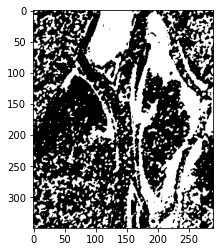

True Positive :  15537
True Negative :  60701
False Positive :  24926
False Negative :  328
the oceral error is :  25254
the percentage correct classification :  0.7511133004926108
kappa score :  0.4217784613154828


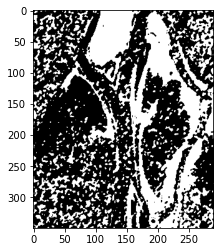

True Positive :  15542
True Negative :  60698
False Positive :  24929
False Negative :  323
the oceral error is :  25252
the percentage correct classification :  0.7511330049261083
kappa score :  0.42189699625937194


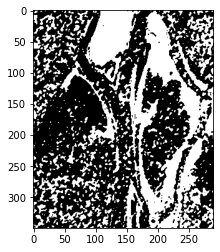

True Positive :  15530
True Negative :  60685
False Positive :  24942
False Negative :  335
the oceral error is :  25277
the percentage correct classification :  0.7508866995073892
kappa score :  0.4213339459768266


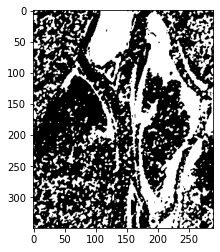

True Positive :  15550
True Negative :  60726
False Positive :  24901
False Negative :  315
the oceral error is :  25216
the percentage correct classification :  0.751487684729064
kappa score :  0.42253922852593695


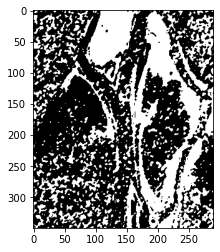

True Positive :  15524
True Negative :  60811
False Positive :  24816
False Negative :  341
the oceral error is :  25157
the percentage correct classification :  0.7520689655172413
kappa score :  0.422881960306027


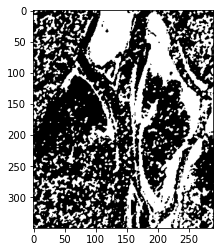

True Positive :  15493
True Negative :  61173
False Positive :  24454
False Negative :  372
the oceral error is :  24826
the percentage correct classification :  0.7553300492610837
kappa score :  0.42692292065299964


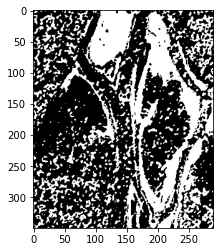

True Positive :  15395
True Negative :  62010
False Positive :  23617
False Negative :  470
the oceral error is :  24087
the percentage correct classification :  0.7626108374384236
kappa score :  0.4356065573495075


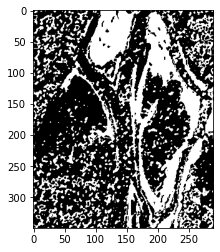

True Positive :  15201
True Negative :  63129
False Positive :  22498
False Negative :  664
the oceral error is :  23162
the percentage correct classification :  0.7717241379310344
kappa score :  0.44555332678879467


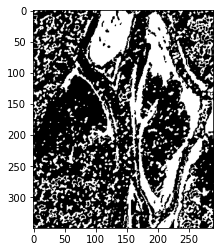

True Positive :  14988
True Negative :  64696
False Positive :  20931
False Negative :  877
the oceral error is :  21808
the percentage correct classification :  0.785064039408867
kappa score :  0.46220971583094883


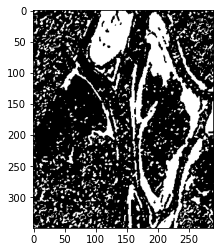

True Positive :  14755
True Negative :  72019
False Positive :  13608
False Negative :  1110
the oceral error is :  14718
the percentage correct classification :  0.8549162561576354
kappa score :  0.5836900327169678


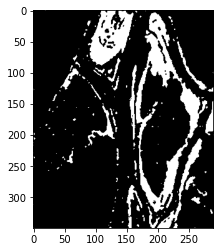

True Positive :  13771
True Negative :  82241
False Positive :  3386
False Negative :  2094
the oceral error is :  5480
the percentage correct classification :  0.9459310344827586
kappa score :  0.8016673392321199


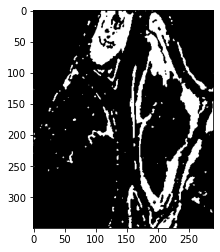

True Positive :  13316
True Negative :  82957
False Positive :  2670
False Negative :  2549
the oceral error is :  5219
the percentage correct classification :  0.9485024630541872
kappa score :  0.8054356981199936


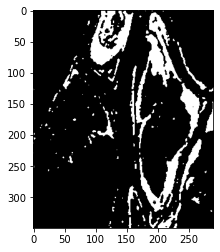

True Positive :  12447
True Negative :  83663
False Positive :  1964
False Negative :  3418
the oceral error is :  5382
the percentage correct classification :  0.9468965517241379
kappa score :  0.790939035939713


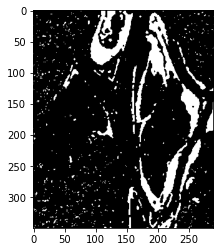

True Positive :  11594
True Negative :  83100
False Positive :  2527
False Negative :  4271
the oceral error is :  6798
the percentage correct classification :  0.9329458128078818
kappa score :  0.7339529987926614


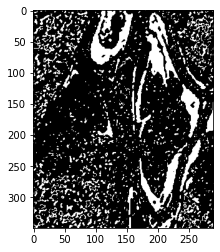

True Positive :  10966
True Negative :  75559
False Positive :  10068
False Negative :  4899
the oceral error is :  14967
the percentage correct classification :  0.8524630541871921
kappa score :  0.5063073160977899


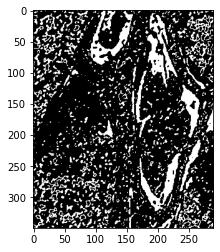

True Positive :  9472
True Negative :  72407
False Positive :  13220
False Negative :  6393
the oceral error is :  19613
the percentage correct classification :  0.8066896551724138
kappa score :  0.37656081393319896


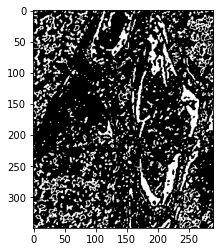

True Positive :  7107
True Negative :  70968
False Positive :  14659
False Negative :  8758
the oceral error is :  23417
the percentage correct classification :  0.7692118226600986
kappa score :  0.24031278556696345


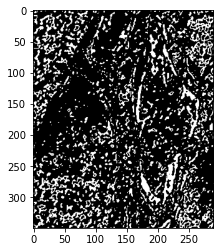

True Positive :  5023
True Negative :  69743
False Positive :  15884
False Negative :  10842
the oceral error is :  26726
the percentage correct classification :  0.7366108374384236
kappa score :  0.11607534653710083


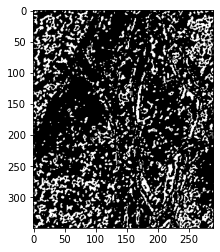

True Positive :  3729
True Negative :  68429
False Positive :  17198
False Negative :  12136
the oceral error is :  29334
the percentage correct classification :  0.7109162561576354
kappa score :  0.030263954493694567


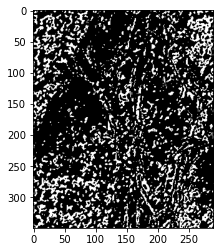

True Positive :  2778
True Negative :  67350
False Positive :  18277
False Negative :  13087
the oceral error is :  31364
the percentage correct classification :  0.6909162561576355
kappa score :  -0.03384390032098805


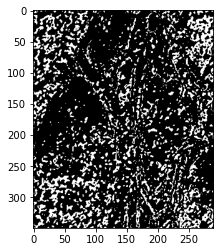

True Positive :  2028
True Negative :  66438
False Positive :  19189
False Negative :  13837
the oceral error is :  33026
the percentage correct classification :  0.6745418719211823
kappa score :  -0.0846586844675028


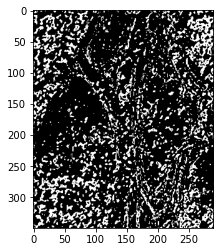

True Positive :  2092
True Negative :  65944
False Positive :  19683
False Negative :  13773
the oceral error is :  33456
the percentage correct classification :  0.6703054187192118
kappa score :  -0.08511306093692039


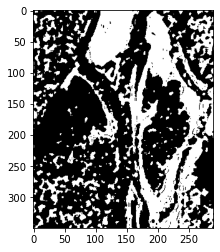

True Positive :  15342
True Negative :  63754
False Positive :  21873
False Negative :  523
the oceral error is :  22396
the percentage correct classification :  0.7792709359605912
kappa score :  0.4595814096044829


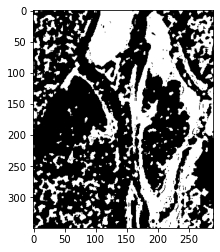

True Positive :  15398
True Negative :  63720
False Positive :  21907
False Negative :  467
the oceral error is :  22374
the percentage correct classification :  0.779487684729064
kappa score :  0.46091645368947276


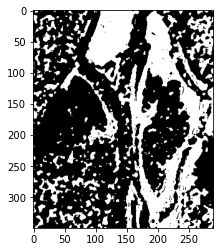

True Positive :  15449
True Negative :  63692
False Positive :  21935
False Negative :  416
the oceral error is :  22351
the percentage correct classification :  0.7797142857142857
kappa score :  0.46217378448841684


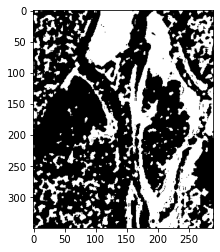

True Positive :  15505
True Negative :  63667
False Positive :  21960
False Negative :  360
the oceral error is :  22320
the percentage correct classification :  0.7800197044334976
kappa score :  0.4636377290775715


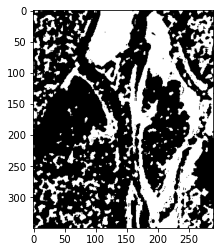

True Positive :  15549
True Negative :  63647
False Positive :  21980
False Negative :  316
the oceral error is :  22296
the percentage correct classification :  0.780256157635468
kappa score :  0.46477980962129384


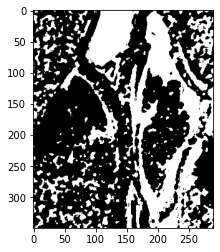

True Positive :  15595
True Negative :  63618
False Positive :  22009
False Negative :  270
the oceral error is :  22279
the percentage correct classification :  0.780423645320197
kappa score :  0.4658484883988999


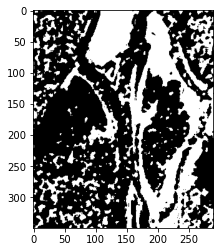

True Positive :  15614
True Negative :  63593
False Positive :  22034
False Negative :  251
the oceral error is :  22285
the percentage correct classification :  0.7803645320197045
kappa score :  0.46609166363200516


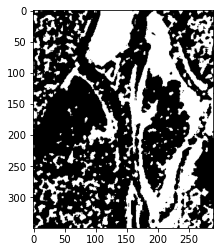

True Positive :  15623
True Negative :  63583
False Positive :  22044
False Negative :  242
the oceral error is :  22286
the percentage correct classification :  0.7803546798029557
kappa score :  0.466234651973808


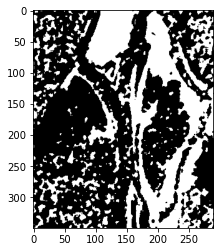

True Positive :  15638
True Negative :  63564
False Positive :  22063
False Negative :  227
the oceral error is :  22290
the percentage correct classification :  0.7803152709359605
kappa score :  0.4664374077483908


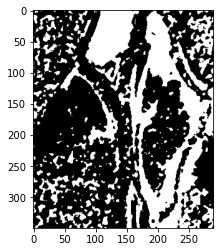

True Positive :  15638
True Negative :  63562
False Positive :  22065
False Negative :  227
the oceral error is :  22292
the percentage correct classification :  0.780295566502463
kappa score :  0.46640710173384337


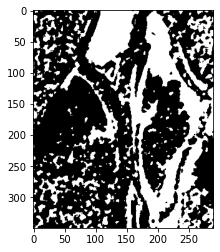

True Positive :  15638
True Negative :  63564
False Positive :  22063
False Negative :  227
the oceral error is :  22290
the percentage correct classification :  0.7803152709359605
kappa score :  0.4664374077483908


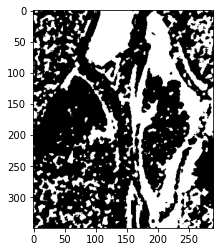

True Positive :  15639
True Negative :  63563
False Positive :  22064
False Negative :  226
the oceral error is :  22290
the percentage correct classification :  0.7803152709359605
kappa score :  0.46645495759915867


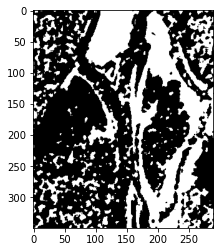

True Positive :  15639
True Negative :  63561
False Positive :  22066
False Negative :  226
the oceral error is :  22292
the percentage correct classification :  0.780295566502463
kappa score :  0.46642465200417127


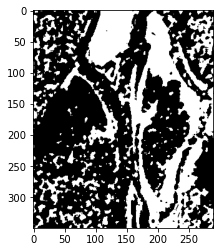

True Positive :  15631
True Negative :  63660
False Positive :  21967
False Negative :  234
the oceral error is :  22201
the percentage correct classification :  0.781192118226601
kappa score :  0.4676652967851206


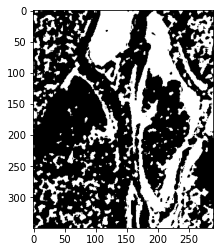

True Positive :  15595
True Negative :  64081
False Positive :  21546
False Negative :  270
the oceral error is :  21816
the percentage correct classification :  0.7849852216748768
kappa score :  0.472925254212613


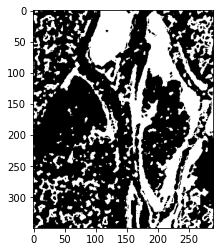

True Positive :  15534
True Negative :  65157
False Positive :  20470
False Negative :  331
the oceral error is :  20801
the percentage correct classification :  0.7949852216748768
kappa score :  0.48777115022570805


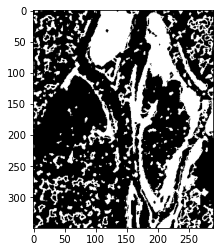

True Positive :  15415
True Negative :  67018
False Positive :  18609
False Negative :  450
the oceral error is :  19059
the percentage correct classification :  0.8121477832512315
kappa score :  0.5143841524794082


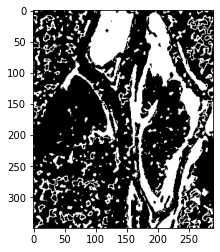

True Positive :  15258
True Negative :  69728
False Positive :  15899
False Negative :  607
the oceral error is :  16506
the percentage correct classification :  0.8373004926108374
kappa score :  0.5571826324044789


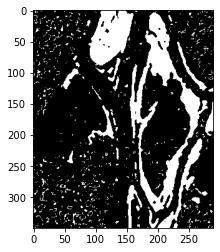

True Positive :  14798
True Negative :  79233
False Positive :  6394
False Negative :  1067
the oceral error is :  7461
the percentage correct classification :  0.9264137931034483
kappa score :  0.7546641349390866


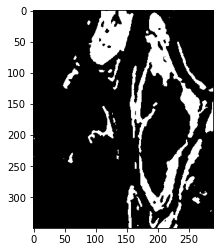

True Positive :  14181
True Negative :  83119
False Positive :  2508
False Negative :  1684
the oceral error is :  4192
the percentage correct classification :  0.9586206896551724
kappa score :  0.8464296024900615


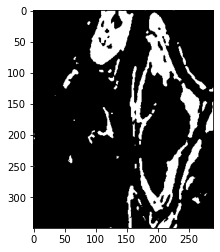

True Positive :  13642
True Negative :  83875
False Positive :  1752
False Negative :  2223
the oceral error is :  3975
the percentage correct classification :  0.9607586206896551
kappa score :  0.8494649482219997


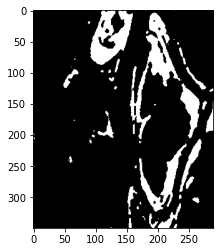

True Positive :  12716
True Negative :  84530
False Positive :  1097
False Negative :  3149
the oceral error is :  4246
the percentage correct classification :  0.9580886699507389
kappa score :  0.8323278631980642


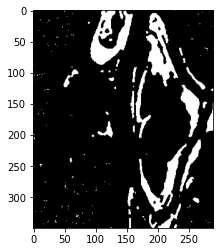

True Positive :  11651
True Negative :  84696
False Positive :  931
False Negative :  4214
the oceral error is :  5145
the percentage correct classification :  0.949231527093596
kappa score :  0.7898631361704876


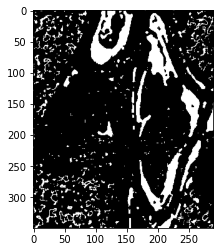

True Positive :  10836
True Negative :  80593
False Positive :  5034
False Negative :  5029
the oceral error is :  10063
the percentage correct classification :  0.9007783251231527
kappa score :  0.6239637130101008


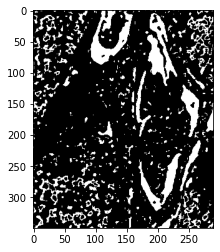

True Positive :  9952
True Negative :  76787
False Positive :  8840
False Negative :  5913
the oceral error is :  14753
the percentage correct classification :  0.8545714285714285
kappa score :  0.48729278421219036


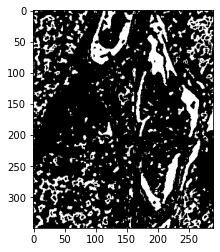

True Positive :  8774
True Negative :  74641
False Positive :  10986
False Negative :  7091
the oceral error is :  18077
the percentage correct classification :  0.8218226600985221
kappa score :  0.38602563174674676


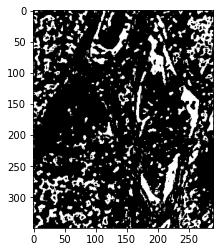

True Positive :  6842
True Negative :  73373
False Positive :  12254
False Negative :  9023
the oceral error is :  21277
the percentage correct classification :  0.790295566502463
kappa score :  0.26601557545948484


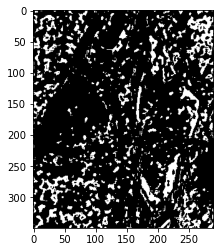

True Positive :  4246
True Negative :  72585
False Positive :  13042
False Negative :  11619
the oceral error is :  24661
the percentage correct classification :  0.7569556650246305
kappa score :  0.11126028268800614


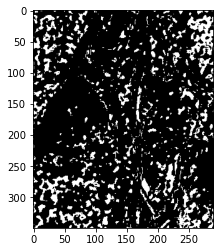

True Positive :  2501
True Negative :  71766
False Positive :  13861
False Negative :  13364
the oceral error is :  27225
the percentage correct classification :  0.7316945812807881
kappa score :  -0.004212142736847557


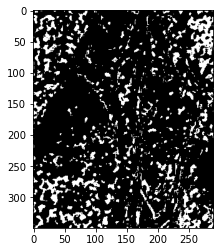

True Positive :  1577
True Negative :  70983
False Positive :  14644
False Negative :  14288
the oceral error is :  28932
the percentage correct classification :  0.7148768472906404
kappa score :  -0.07098470713058891


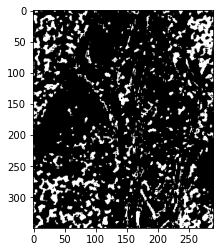

True Positive :  905
True Negative :  70342
False Positive :  15285
False Negative :  14960
the oceral error is :  30245
the percentage correct classification :  0.7019408866995074
kappa score :  -0.12045847129984866


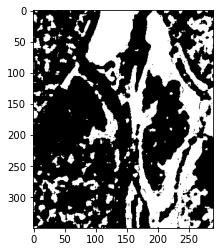

True Positive :  15601
True Negative :  65567
False Positive :  20060
False Negative :  264
the oceral error is :  20324
the percentage correct classification :  0.7996847290640394
kappa score :  0.4965915281190294


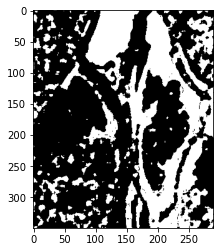

True Positive :  15618
True Negative :  65546
False Positive :  20081
False Negative :  247
the oceral error is :  20328
the percentage correct classification :  0.7996453201970444
kappa score :  0.49681787887343987


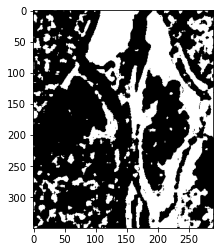

True Positive :  15630
True Negative :  65525
False Positive :  20102
False Negative :  235
the oceral error is :  20337
the percentage correct classification :  0.7995566502463054
kappa score :  0.49687754618309476


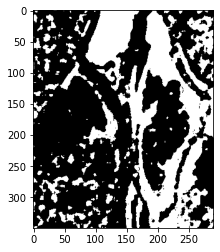

True Positive :  15641
True Negative :  65504
False Positive :  20123
False Negative :  224
the oceral error is :  20347
the percentage correct classification :  0.7994581280788178
kappa score :  0.49690388465627755


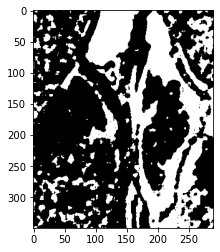

True Positive :  15649
True Negative :  65481
False Positive :  20146
False Negative :  216
the oceral error is :  20362
the percentage correct classification :  0.7993103448275862
kappa score :  0.49679813761492264


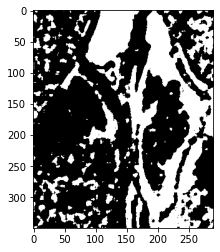

True Positive :  15661
True Negative :  65468
False Positive :  20159
False Negative :  204
the oceral error is :  20363
the percentage correct classification :  0.7993004926108375
kappa score :  0.49698694705313584


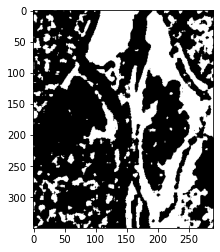

True Positive :  15666
True Negative :  65459
False Positive :  20168
False Negative :  199
the oceral error is :  20367
the percentage correct classification :  0.7992610837438424
kappa score :  0.49700768798859996


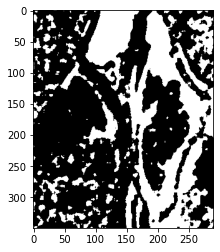

True Positive :  15668
True Negative :  65454
False Positive :  20173
False Negative :  197
the oceral error is :  20370
the percentage correct classification :  0.799231527093596
kappa score :  0.49699337095411156


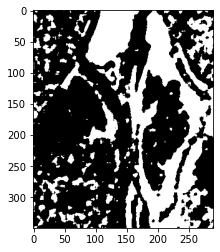

True Positive :  15669
True Negative :  65453
False Positive :  20174
False Negative :  196
the oceral error is :  20370
the percentage correct classification :  0.799231527093596
kappa score :  0.4970104378288025


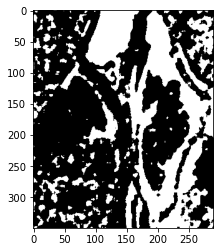

True Positive :  15669
True Negative :  65448
False Positive :  20179
False Negative :  196
the oceral error is :  20375
the percentage correct classification :  0.7991822660098522
kappa score :  0.49692969556686994


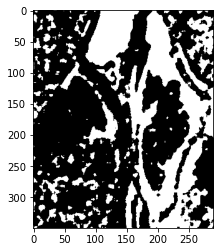

True Positive :  15669
True Negative :  65451
False Positive :  20176
False Negative :  196
the oceral error is :  20372
the percentage correct classification :  0.7992118226600985
kappa score :  0.49697813928034784


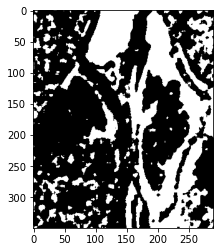

True Positive :  15669
True Negative :  65445
False Positive :  20182
False Negative :  196
the oceral error is :  20378
the percentage correct classification :  0.7991527093596059
kappa score :  0.49688125678376815


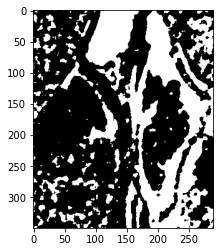

True Positive :  15667
True Negative :  65444
False Positive :  20183
False Negative :  198
the oceral error is :  20381
the percentage correct classification :  0.7991231527093596
kappa score :  0.4967986823405408


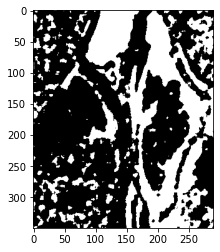

True Positive :  15667
True Negative :  65449
False Positive :  20178
False Negative :  198
the oceral error is :  20376
the percentage correct classification :  0.7991724137931034
kappa score :  0.4968794107502753


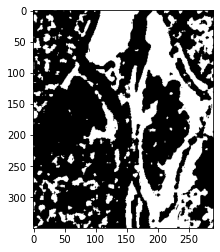

True Positive :  15658
True Negative :  65534
False Positive :  20093
False Negative :  207
the oceral error is :  20300
the percentage correct classification :  0.7999211822660098
kappa score :  0.49795466985511294


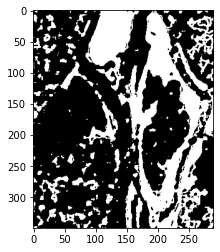

True Positive :  15602
True Negative :  66906
False Positive :  18721
False Negative :  263
the oceral error is :  18984
the percentage correct classification :  0.8128866995073891
kappa score :  0.5188128596176427


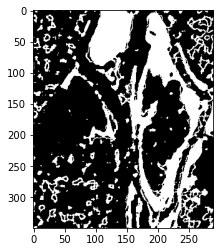

True Positive :  15509
True Negative :  69523
False Positive :  16104
False Negative :  356
the oceral error is :  16460
the percentage correct classification :  0.8377536945812808
kappa score :  0.5620962840726624


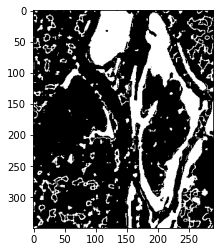

True Positive :  15251
True Negative :  73632
False Positive :  11995
False Negative :  614
the oceral error is :  12609
the percentage correct classification :  0.8756945812807881
kappa score :  0.6353990466073642


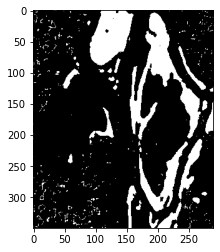

True Positive :  14839
True Negative :  81582
False Positive :  4045
False Negative :  1026
the oceral error is :  5071
the percentage correct classification :  0.9499605911330049
kappa score :  0.823998246499588


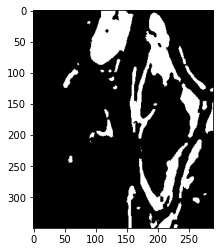

True Positive :  14342
True Negative :  83576
False Positive :  2051
False Negative :  1523
the oceral error is :  3574
the percentage correct classification :  0.9647093596059113
kappa score :  0.8680448013851325


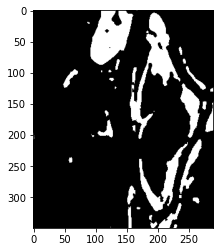

True Positive :  13817
True Negative :  84144
False Positive :  1483
False Negative :  2048
the oceral error is :  3531
the percentage correct classification :  0.9651330049261084
kappa score :  0.8659147661226954


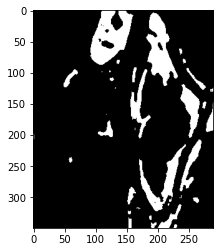

True Positive :  12836
True Negative :  84628
False Positive :  999
False Negative :  3029
the oceral error is :  4028
the percentage correct classification :  0.9602364532019705
kappa score :  0.8410151238404491


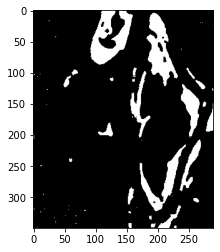

True Positive :  11580
True Negative :  84963
False Positive :  664
False Negative :  4285
the oceral error is :  4949
the percentage correct classification :  0.9511625615763547
kappa score :  0.7959225891804358


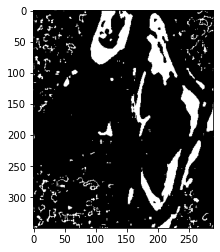

True Positive :  10673
True Negative :  82564
False Positive :  3063
False Negative :  5192
the oceral error is :  8255
the percentage correct classification :  0.9185911330049261
kappa score :  0.673596206654156


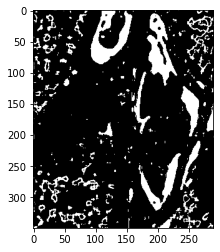

True Positive :  9828
True Negative :  79585
False Positive :  6042
False Negative :  6037
the oceral error is :  12079
the percentage correct classification :  0.8809162561576355
kappa score :  0.5486892462668145


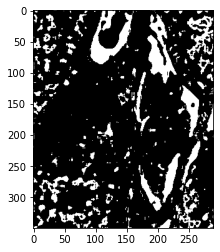

True Positive :  9153
True Negative :  76996
False Positive :  8631
False Negative :  6712
the oceral error is :  15343
the percentage correct classification :  0.8487586206896551
kappa score :  0.453652495049652


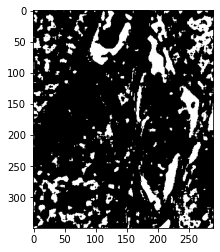

True Positive :  7919
True Negative :  75782
False Positive :  9845
False Negative :  7946
the oceral error is :  17791
the percentage correct classification :  0.82464039408867
kappa score :  0.3662172445076459


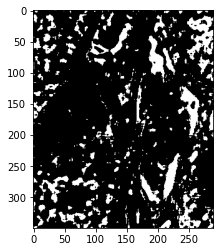

True Positive :  6060
True Negative :  75160
False Positive :  10467
False Negative :  9805
the oceral error is :  20272
the percentage correct classification :  0.8001970443349754
kappa score :  0.2553303554955032


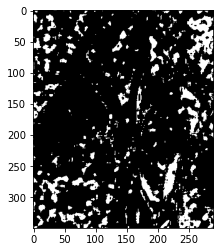

True Positive :  3353
True Negative :  74859
False Positive :  10768
False Negative :  12512
the oceral error is :  23280
the percentage correct classification :  0.7705615763546798
kappa score :  0.08959712248890572


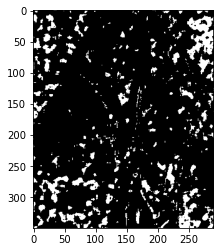

True Positive :  1343
True Negative :  74597
False Positive :  11030
False Negative :  14522
the oceral error is :  25552
the percentage correct classification :  0.7481773399014778
kappa score :  -0.04849587944683953


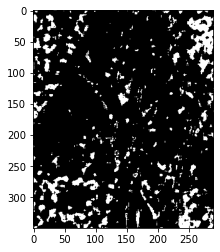

True Positive :  636
True Negative :  74111
False Positive :  11516
False Negative :  15229
the oceral error is :  26745
the percentage correct classification :  0.736423645320197
kappa score :  -0.10434610153899282


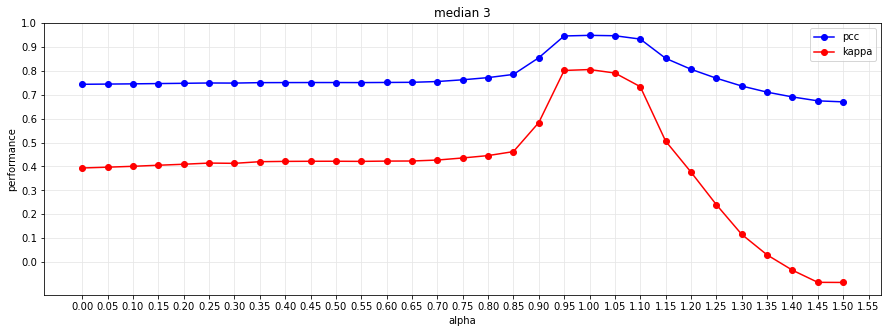

***********************
max pcc is :  0.9485024630541872
max kaapa score is :  0.8054356981199936
***********************
     ---------------------------------------------------------------------------------------------------------------


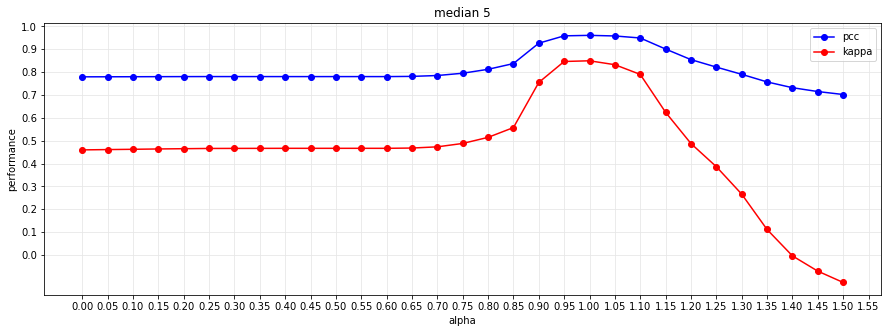

***********************
max pcc is :  0.9607586206896551
max kaapa score is :  0.8494649482219997
***********************
     ---------------------------------------------------------------------------------------------------------------


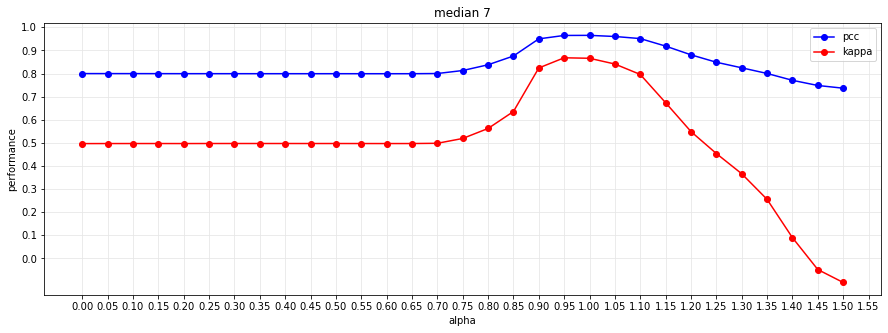

***********************
max pcc is :  0.9651330049261084
max kaapa score is :  0.8680448013851325
***********************
     ---------------------------------------------------------------------------------------------------------------


In [571]:
s1_tp=[]
s1_tn=[]
s1_fp=[]
s1_fn=[]
s1_pcc=[]
s1_kaapa=[]
s1_clustered_image=[]

for median in  median1_3channels:
    noisy_image1 = median
    kernel = np.array([[-1, -2, -1],
                       [-2, 13, -2],
                       [-1, -2, -1]])
    sharped_image1 = cv2.filter2D(src=noisy_image1, ddepth=-1, kernel=kernel)

    tem = golden_denoiser(sharped_image1)
    kmeans_result = kmeans(tem,  2,'k-means++' , 500 )
    tp,tn,fp,fn,pcc,kaapa = results(im_gt, kmeans_result)
    
    s1_clustered_image.append(kmeans_result)
    s1_tp.append(tp)
    s1_tn.append(tn)
    s1_fp.append(fp)
    s1_fn.append(fn)
    s1_pcc.append(pcc)
    s1_kaapa.append(kaapa)

alpha_plotter(alpha_set,median_kernel, s1_pcc, s1_kaapa)

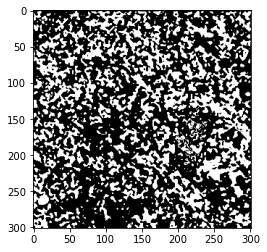

True Positive :  490
True Negative :  57254
False Positive :  32271
False Negative :  586
the oceral error is :  32857
the percentage correct classification :  0.6373439586759528
kappa score :  0.006105610835150377


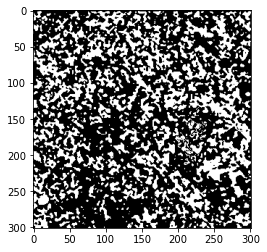

True Positive :  493
True Negative :  57260
False Positive :  32265
False Negative :  583
the oceral error is :  32848
the percentage correct classification :  0.6374432953278661
kappa score :  0.00628981808294149


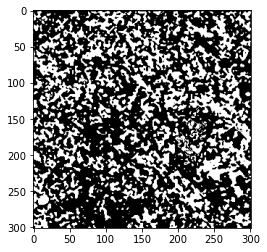

True Positive :  505
True Negative :  57261
False Positive :  32264
False Negative :  571
the oceral error is :  32835
the percentage correct classification :  0.6375867816028521
kappa score :  0.007005680583564322


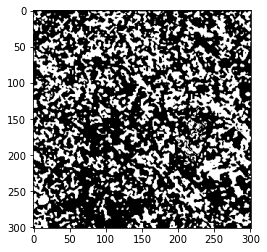

True Positive :  521
True Negative :  57268
False Positive :  32257
False Negative :  555
the oceral error is :  32812
the percentage correct classification :  0.6378406419355195
kappa score :  0.007964841622738805


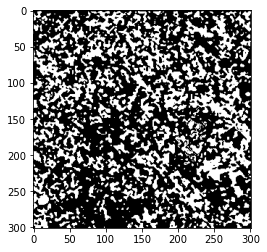

True Positive :  537
True Negative :  57273
False Positive :  32252
False Negative :  539
the oceral error is :  32791
the percentage correct classification :  0.6380724274566506
kappa score :  0.008921530817751822


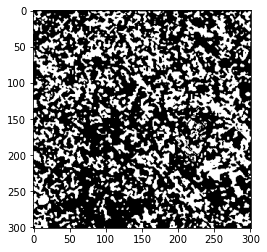

True Positive :  562
True Negative :  57285
False Positive :  32240
False Negative :  514
the oceral error is :  32754
the percentage correct classification :  0.6384808114700721
kappa score :  0.010419406472403692


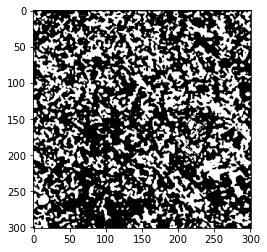

True Positive :  574
True Negative :  57295
False Positive :  32230
False Negative :  502
the oceral error is :  32732
the percentage correct classification :  0.6387236343969713
kappa score :  0.011142414208724971


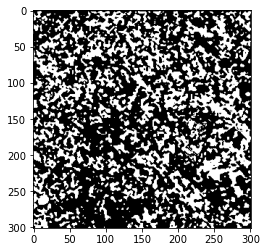

True Positive :  589
True Negative :  57296
False Positive :  32229
False Negative :  487
the oceral error is :  32716
the percentage correct classification :  0.6389002328892617
kappa score :  0.012033721186283985


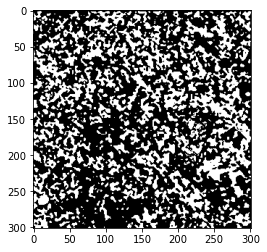

True Positive :  591
True Negative :  57303
False Positive :  32222
False Negative :  485
the oceral error is :  32707
the percentage correct classification :  0.6389995695411751
kappa score :  0.012159893074885075


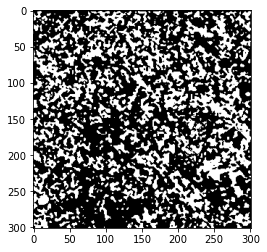

True Positive :  597
True Negative :  57300
False Positive :  32225
False Negative :  479
the oceral error is :  32704
the percentage correct classification :  0.6390326817584795
kappa score :  0.012512548683608071


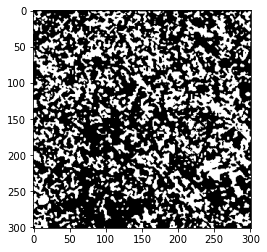

True Positive :  612
True Negative :  57299
False Positive :  32226
False Negative :  464
the oceral error is :  32690
the percentage correct classification :  0.6391872054392336
kappa score :  0.013400594219084683


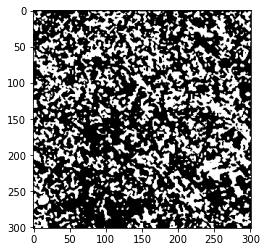

True Positive :  634
True Negative :  57295
False Positive :  32230
False Negative :  442
the oceral error is :  32672
the percentage correct classification :  0.6393858787430602
kappa score :  0.014698636344233074


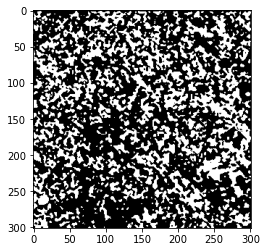

True Positive :  645
True Negative :  57296
False Positive :  32229
False Negative :  431
the oceral error is :  32660
the percentage correct classification :  0.639518327612278
kappa score :  0.015350415879578305


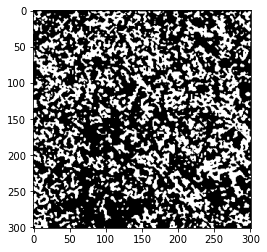

True Positive :  668
True Negative :  57572
False Positive :  31953
False Negative :  408
the oceral error is :  32361
the percentage correct classification :  0.6428185119369544
kappa score :  0.017045346403943173


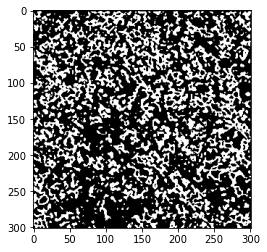

True Positive :  677
True Negative :  59619
False Positive :  29906
False Negative :  399
the oceral error is :  30305
the percentage correct classification :  0.6655114181962671
kappa score :  0.020288557596396584


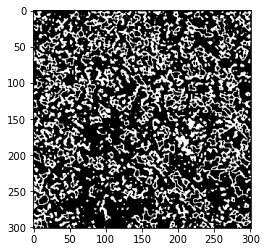

True Positive :  684
True Negative :  63656
False Positive :  25869
False Negative :  392
the oceral error is :  26261
the percentage correct classification :  0.7101466871226587
kappa score :  0.02730912476338454


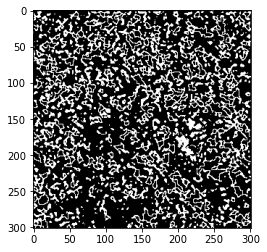

True Positive :  723
True Negative :  65042
False Positive :  24483
False Negative :  353
the oceral error is :  24836
the percentage correct classification :  0.72587499034227
kappa score :  0.03299010387569645


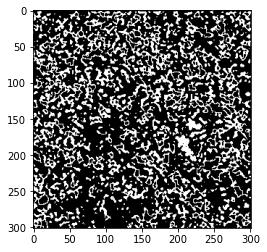

True Positive :  809
True Negative :  64109
False Positive :  25416
False Negative :  267
the oceral error is :  25683
the percentage correct classification :  0.7165263076566484
kappa score :  0.03729992410317884


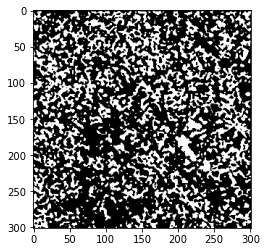

True Positive :  908
True Negative :  60167
False Positive :  29358
False Negative :  168
the oceral error is :  29526
the percentage correct classification :  0.6741095572896546
kappa score :  0.035826113994215536


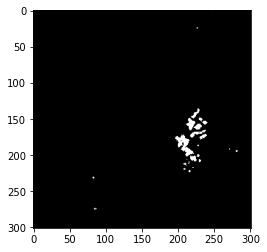

True Positive :  726
True Negative :  89414
False Positive :  111
False Negative :  350
the oceral error is :  461
the percentage correct classification :  0.9949117559408837
kappa score :  0.7564865383113304


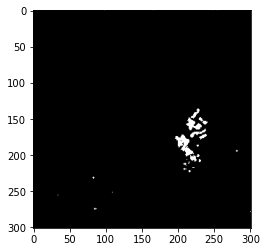

True Positive :  757
True Negative :  89405
False Positive :  120
False Negative :  319
the oceral error is :  439
the percentage correct classification :  0.9951545788677829
kappa score :  0.7727942087983288


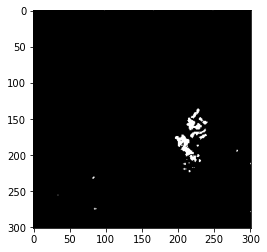

True Positive :  766
True Negative :  89399
False Positive :  126
False Negative :  310
the oceral error is :  436
the percentage correct classification :  0.9951876910850873
kappa score :  0.7760442061188781


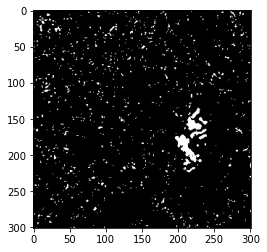

True Positive :  871
True Negative :  86861
False Positive :  2664
False Negative :  205
the oceral error is :  2869
the percentage correct classification :  0.9683336828511827
kappa score :  0.3662518515519825


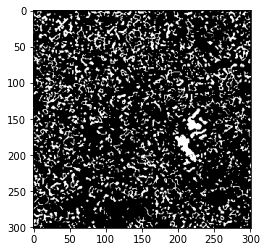

True Positive :  867
True Negative :  73973
False Positive :  15552
False Negative :  209
the oceral error is :  15761
the percentage correct classification :  0.8260394476882154
kappa score :  0.07857393390515466


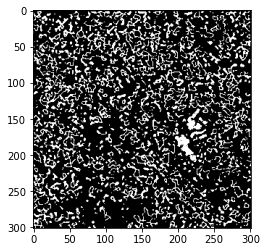

True Positive :  793
True Negative :  70111
False Positive :  19414
False Negative :  283
the oceral error is :  19697
the percentage correct classification :  0.7825962185847838
kappa score :  0.053166923950961675


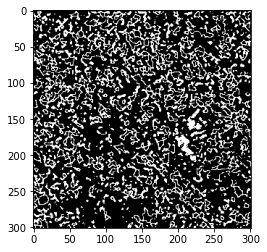

True Positive :  736
True Negative :  67680
False Positive :  21845
False Negative :  340
the oceral error is :  22185
the percentage correct classification :  0.755135153033631
kappa score :  0.040467939630578265


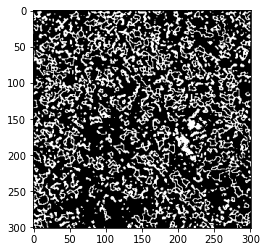

True Positive :  722
True Negative :  65432
False Positive :  24093
False Negative :  354
the oceral error is :  24447
the percentage correct classification :  0.7301685411860797
kappa score :  0.03377582433512327


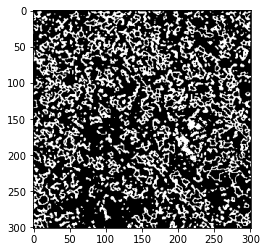

True Positive :  719
True Negative :  63176
False Positive :  26349
False Negative :  357
the oceral error is :  26706
the percentage correct classification :  0.7052350415558327
kappa score :  0.028910419865369907


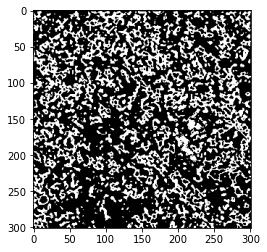

True Positive :  711
True Negative :  61123
False Positive :  28402
False Negative :  365
the oceral error is :  28767
the percentage correct classification :  0.6824869482676792
kappa score :  0.02476459728457514


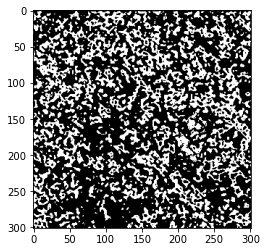

True Positive :  705
True Negative :  59562
False Positive :  29963
False Negative :  371
the oceral error is :  30334
the percentage correct classification :  0.6651913334289908
kappa score :  0.021974726565944347


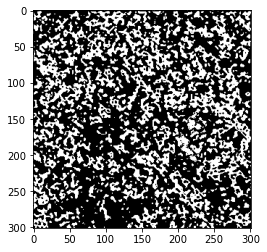

True Positive :  698
True Negative :  58663
False Positive :  30862
False Negative :  378
the oceral error is :  31240
the percentage correct classification :  0.6551914438030485
kappa score :  0.020271080209971704


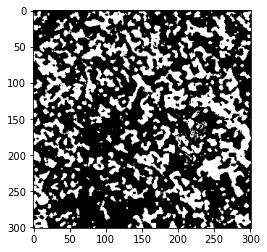

True Positive :  509
True Negative :  60288
False Positive :  29237
False Negative :  567
the oceral error is :  29804
the percentage correct classification :  0.6710411584861095
kappa score :  0.01034213777014148


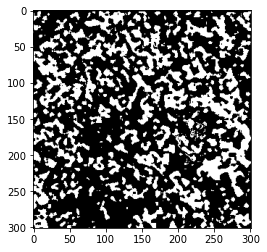

True Positive :  530
True Negative :  60290
False Positive :  29235
False Negative :  546
the oceral error is :  29781
the percentage correct classification :  0.6712950188187768
kappa score :  0.011714569568702538


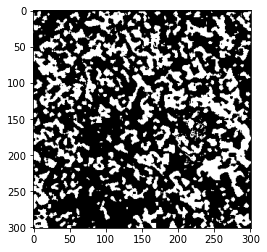

True Positive :  539
True Negative :  60290
False Positive :  29235
False Negative :  537
the oceral error is :  29772
the percentage correct classification :  0.6713943554706902
kappa score :  0.012301220598840312


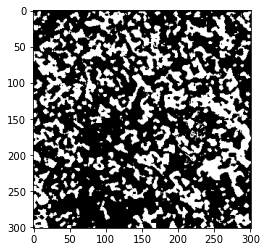

True Positive :  543
True Negative :  60300
False Positive :  29225
False Negative :  533
the oceral error is :  29758
the percentage correct classification :  0.6715488791514442
kappa score :  0.012573795398431509


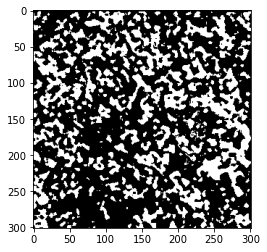

True Positive :  557
True Negative :  60299
False Positive :  29226
False Negative :  519
the oceral error is :  29745
the percentage correct classification :  0.6716923654264302
kappa score :  0.013484513379551366


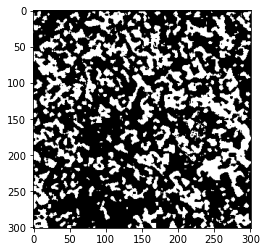

True Positive :  580
True Negative :  60298
False Positive :  29227
False Negative :  496
the oceral error is :  29723
the percentage correct classification :  0.6719351883533294
kappa score :  0.014979591583331398


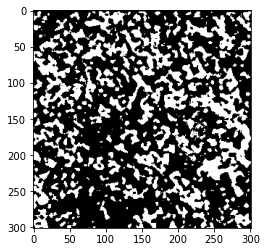

True Positive :  608
True Negative :  60294
False Positive :  29231
False Negative :  468
the oceral error is :  29699
the percentage correct classification :  0.672200086091765
kappa score :  0.01679285738862346


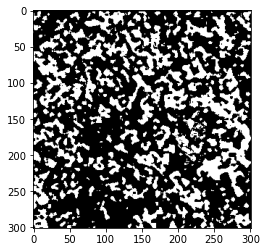

True Positive :  616
True Negative :  60270
False Positive :  29255
False Negative :  460
the oceral error is :  29715
the percentage correct classification :  0.6720234875994746
kappa score :  0.017279515275146262


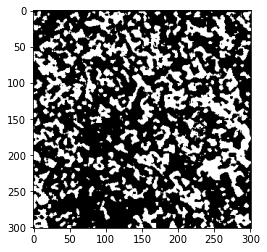

True Positive :  627
True Negative :  60283
False Positive :  29242
False Negative :  449
the oceral error is :  29691
the percentage correct classification :  0.6722883853379101
kappa score :  0.018009822906509432


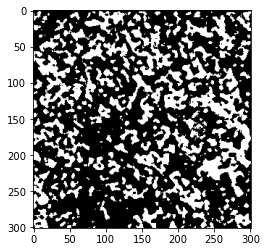

True Positive :  642
True Negative :  60274
False Positive :  29251
False Negative :  434
the oceral error is :  29685
the percentage correct classification :  0.672354609772519
kappa score :  0.018968479934631355


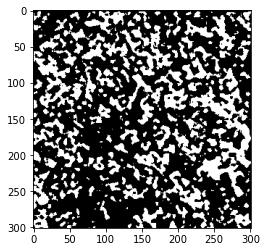

True Positive :  669
True Negative :  60269
False Positive :  29256
False Negative :  407
the oceral error is :  29663
the percentage correct classification :  0.6725974326994183
kappa score :  0.0207065778989185


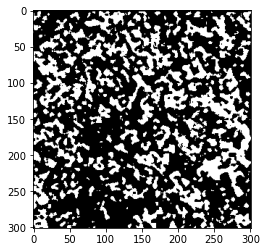

True Positive :  697
True Negative :  60264
False Positive :  29261
False Negative :  379
the oceral error is :  29640
the percentage correct classification :  0.6728512930320857
kappa score :  0.022505546324644743


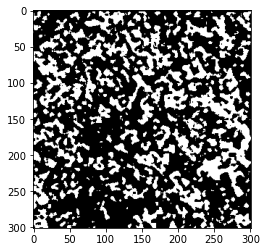

True Positive :  719
True Negative :  60253
False Positive :  29272
False Negative :  357
the oceral error is :  29629
the percentage correct classification :  0.6729727044955354
kappa score :  0.02390536944035626


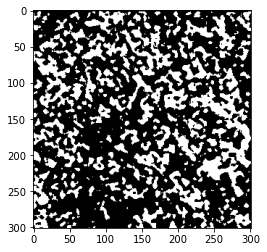

True Positive :  741
True Negative :  60247
False Positive :  29278
False Negative :  335
the oceral error is :  29613
the percentage correct classification :  0.6731493029878257
kappa score :  0.02531019846089011


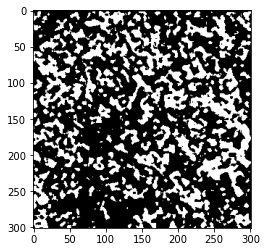

True Positive :  755
True Negative :  60262
False Positive :  29263
False Negative :  321
the oceral error is :  29584
the percentage correct classification :  0.673469387755102
kappa score :  0.026233422310915522


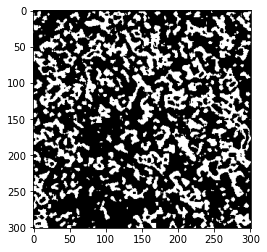

True Positive :  769
True Negative :  61770
False Positive :  27755
False Negative :  307
the oceral error is :  28062
the percentage correct classification :  0.6902683193342237
kappa score :  0.029751378766521674


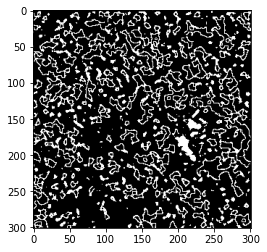

True Positive :  737
True Negative :  72145
False Positive :  17380
False Negative :  339
the oceral error is :  17719
the percentage correct classification :  0.8044282071941811
kappa score :  0.055625114858167235


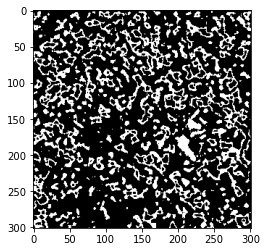

True Positive :  857
True Negative :  67026
False Positive :  22499
False Negative :  219
the oceral error is :  22718
the percentage correct classification :  0.749252215759208
kappa score :  0.04854986742670997


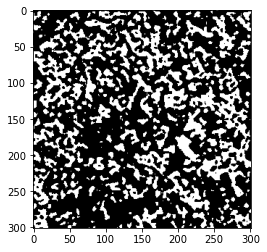

True Positive :  965
True Negative :  61216
False Positive :  28309
False Negative :  111
the oceral error is :  28420
the percentage correct classification :  0.6863169280692266
kappa score :  0.04163490680247506


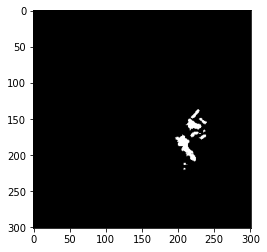

True Positive :  736
True Negative :  89482
False Positive :  43
False Negative :  340
the oceral error is :  383
the percentage correct classification :  0.9957726735907992
kappa score :  0.7914507670114861


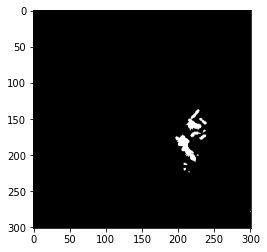

True Positive :  766
True Negative :  89468
False Positive :  57
False Negative :  310
the oceral error is :  367
the percentage correct classification :  0.9959492720830896
kappa score :  0.8047302832966438


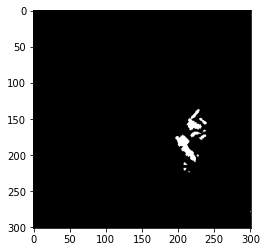

True Positive :  785
True Negative :  89466
False Positive :  59
False Negative :  291
the oceral error is :  350
the percentage correct classification :  0.9961369079811481
kappa score :  0.8157849063474976


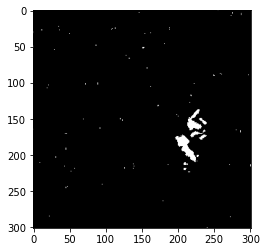

True Positive :  790
True Negative :  89353
False Positive :  172
False Negative :  286
the oceral error is :  458
the percentage correct classification :  0.9949448681581881
kappa score :  0.7727216446422283


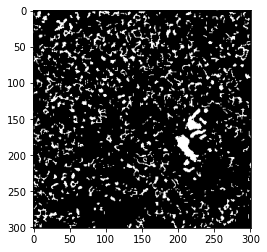

True Positive :  903
True Negative :  79878
False Positive :  9647
False Negative :  173
the oceral error is :  9820
the percentage correct classification :  0.8916126753567841
kappa score :  0.1367344998163278


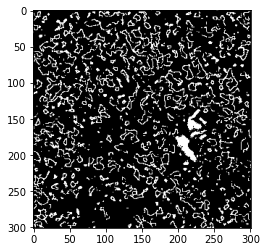

True Positive :  829
True Negative :  76139
False Positive :  13386
False Negative :  247
the oceral error is :  13633
the percentage correct classification :  0.8495270471628349
kappa score :  0.0882984430557292


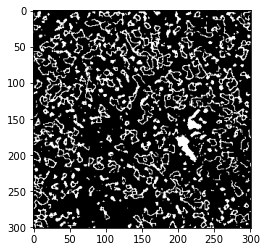

True Positive :  769
True Negative :  72944
False Positive :  16581
False Negative :  307
the oceral error is :  16888
the percentage correct classification :  0.8136002913875123
kappa score :  0.06250143153493937


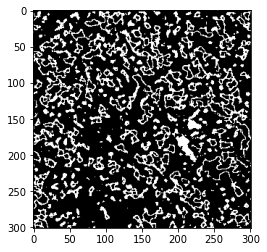

True Positive :  743
True Negative :  69469
False Positive :  20056
False Negative :  333
the oceral error is :  20389
the percentage correct classification :  0.7749583337932252
kappa score :  0.046395075923542195


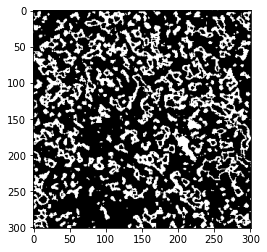

True Positive :  751
True Negative :  64816
False Positive :  24709
False Negative :  325
the oceral error is :  25034
the percentage correct classification :  0.7236895840001766
kappa score :  0.0346015338933926


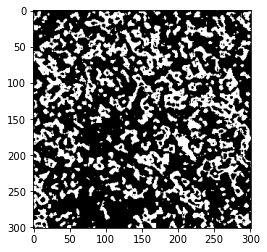

True Positive :  756
True Negative :  62288
False Positive :  27237
False Negative :  320
the oceral error is :  27557
the percentage correct classification :  0.6958422092471386
kappa score :  0.02982303450920043


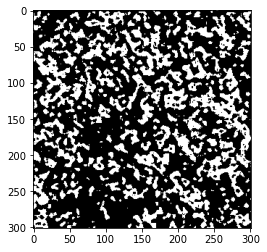

True Positive :  755
True Negative :  61049
False Positive :  28476
False Negative :  321
the oceral error is :  28797
the percentage correct classification :  0.6821558260946348
kappa score :  0.027545310243580756


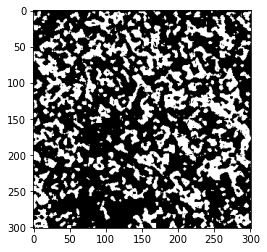

True Positive :  743
True Negative :  60598
False Positive :  28927
False Negative :  333
the oceral error is :  29260
the percentage correct classification :  0.677045507223982
kappa score :  0.02600634324482831


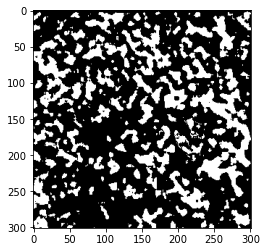

True Positive :  424
True Negative :  63094
False Positive :  26431
False Negative :  652
the oceral error is :  27083
the percentage correct classification :  0.7010739395812409
kappa score :  0.007698886600663757


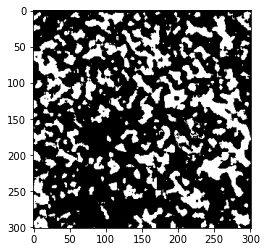

True Positive :  448
True Negative :  63095
False Positive :  26430
False Negative :  628
the oceral error is :  27058
the percentage correct classification :  0.7013498747254445
kappa score :  0.009429797072771584


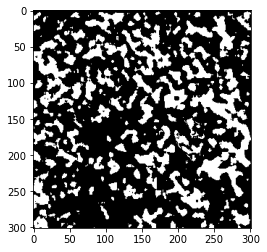

True Positive :  473
True Negative :  63091
False Positive :  26434
False Negative :  603
the oceral error is :  27037
the percentage correct classification :  0.7015816602465756
kappa score :  0.011223404570747109


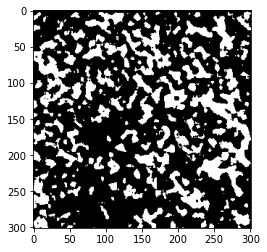

True Positive :  514
True Negative :  63094
False Positive :  26431
False Negative :  562
the oceral error is :  26993
the percentage correct classification :  0.7020673061003742
kappa score :  0.014170012745860716


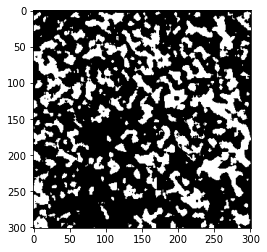

True Positive :  533
True Negative :  63092
False Positive :  26433
False Negative :  543
the oceral error is :  26976
the percentage correct classification :  0.7022549419984326
kappa score :  0.015527993465534462


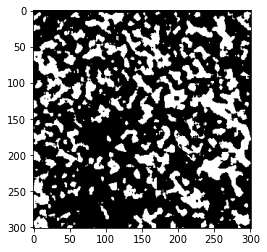

True Positive :  541
True Negative :  63090
False Positive :  26435
False Negative :  535
the oceral error is :  26970
the percentage correct classification :  0.7023211664330415
kappa score :  0.016097499849908714


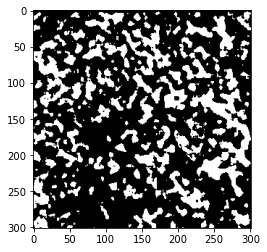

True Positive :  559
True Negative :  63080
False Positive :  26445
False Negative :  517
the oceral error is :  26962
the percentage correct classification :  0.7024094656791867
kappa score :  0.01736924556066044


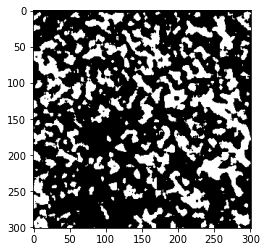

True Positive :  587
True Negative :  63081
False Positive :  26444
False Negative :  489
the oceral error is :  26933
the percentage correct classification :  0.702729550446463
kappa score :  0.01936818820010855


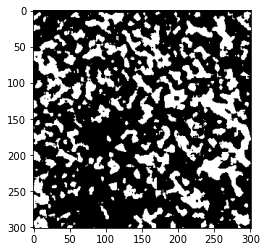

True Positive :  618
True Negative :  63076
False Positive :  26449
False Negative :  458
the oceral error is :  26907
the percentage correct classification :  0.7030165229964349
kappa score :  0.02156687970698301


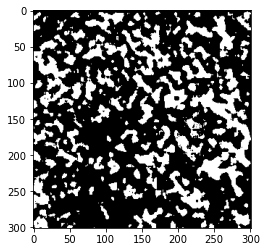

True Positive :  624
True Negative :  63060
False Positive :  26465
False Negative :  452
the oceral error is :  26917
the percentage correct classification :  0.7029061489387535
kappa score :  0.021967083770426887


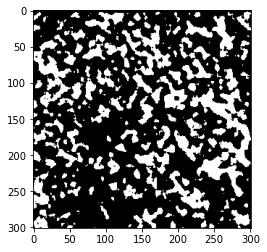

True Positive :  658
True Negative :  63066
False Positive :  26459
False Negative :  418
the oceral error is :  26877
the percentage correct classification :  0.7033476451694793
kappa score :  0.024389483678250112


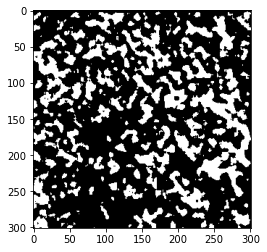

True Positive :  678
True Negative :  63061
False Positive :  26464
False Negative :  398
the oceral error is :  26862
the percentage correct classification :  0.7035132062560016
kappa score :  0.025797038072318257


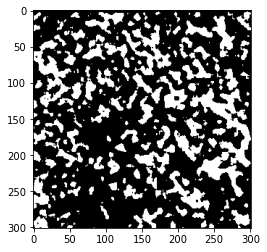

True Positive :  695
True Negative :  63031
False Positive :  26494
False Negative :  381
the oceral error is :  26875
the percentage correct classification :  0.7033697199810157
kappa score :  0.02694478958003399


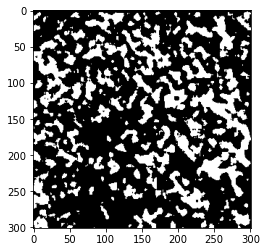

True Positive :  732
True Negative :  63012
False Positive :  26513
False Negative :  344
the oceral error is :  26857
the percentage correct classification :  0.7035683932848423
kappa score :  0.029517498411059884


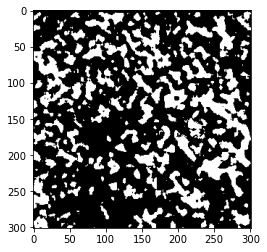

True Positive :  736
True Negative :  63019
False Positive :  26506
False Negative :  340
the oceral error is :  26846
the percentage correct classification :  0.703689804748292
kappa score :  0.02981230980069849


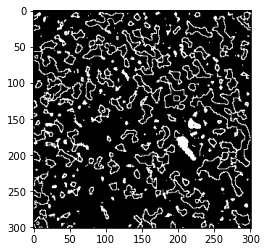

True Positive :  622
True Negative :  76162
False Positive :  13363
False Negative :  454
the oceral error is :  13817
the percentage correct classification :  0.8474961645014956
kappa score :  0.061907284110806926


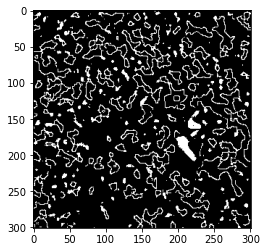

True Positive :  659
True Negative :  77442
False Positive :  12083
False Negative :  417
the oceral error is :  12500
the percentage correct classification :  0.8620324278981468
kappa score :  0.0751253948299192


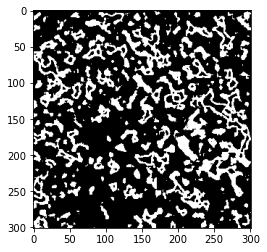

True Positive :  889
True Negative :  66009
False Positive :  23516
False Negative :  187
the oceral error is :  23703
the percentage correct classification :  0.7383803710775819
kappa score :  0.04812276179789465


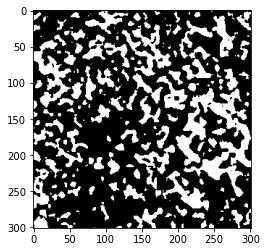

True Positive :  998
True Negative :  61993
False Positive :  27532
False Negative :  78
the oceral error is :  27610
the percentage correct classification :  0.6952572267414266
kappa score :  0.04557265288433843


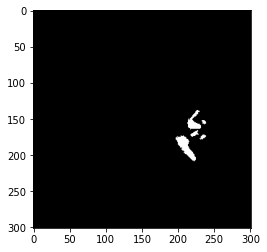

True Positive :  699
True Negative :  89473
False Positive :  52
False Negative :  377
the oceral error is :  429
the percentage correct classification :  0.9952649529254644
kappa score :  0.7628736234028193


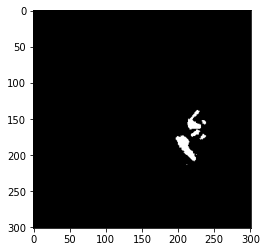

True Positive :  728
True Negative :  89457
False Positive :  68
False Negative :  348
the oceral error is :  416
the percentage correct classification :  0.9954084392004503
kappa score :  0.7755104588614306


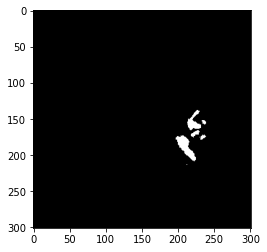

True Positive :  727
True Negative :  89465
False Positive :  60
False Negative :  349
the oceral error is :  409
the percentage correct classification :  0.9954857010408273
kappa score :  0.7782364607697254


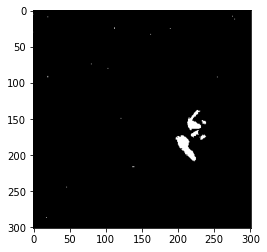

True Positive :  718
True Negative :  89441
False Positive :  84
False Negative :  358
the oceral error is :  442
the percentage correct classification :  0.9951214666504785
kappa score :  0.7622314307683828


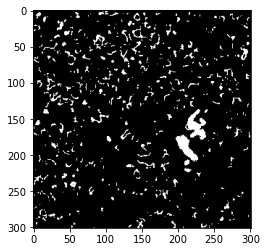

True Positive :  880
True Negative :  83812
False Positive :  5713
False Negative :  196
the oceral error is :  5909
the percentage correct classification :  0.9347799693160119
kappa score :  0.21343376704860983


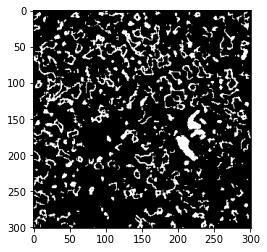

True Positive :  837
True Negative :  77022
False Positive :  12503
False Negative :  239
the oceral error is :  12742
the percentage correct classification :  0.8593613757022549
kappa score :  0.09625704296681181


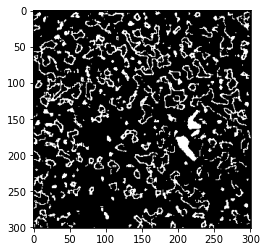

True Positive :  738
True Negative :  76348
False Positive :  13177
False Negative :  338
the oceral error is :  13515
the percentage correct classification :  0.8508294610434763
kappa score :  0.07813411898135847


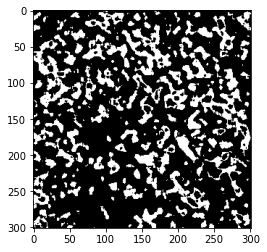

True Positive :  761
True Negative :  66606
False Positive :  22919
False Negative :  315
the oceral error is :  23234
the percentage correct classification :  0.7435569143828434
kappa score :  0.03966103479063443


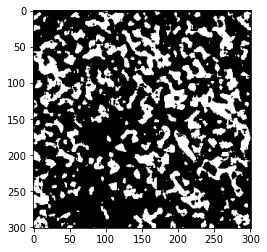

True Positive :  757
True Negative :  64272
False Positive :  25253
False Negative :  319
the oceral error is :  25572
the percentage correct classification :  0.7177514596969128
kappa score :  0.033859409802292295


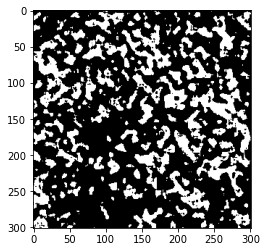

True Positive :  758
True Negative :  63876
False Positive :  25649
False Negative :  318
the oceral error is :  25967
the percentage correct classification :  0.7133916844184943
kappa score :  0.033094112687895305


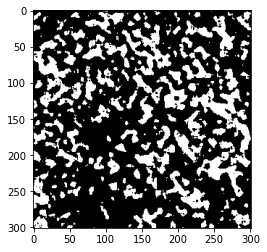

True Positive :  749
True Negative :  63448
False Positive :  26077
False Negative :  327
the oceral error is :  26404
the percentage correct classification :  0.7085683380978135
kappa score :  0.03157239444566784


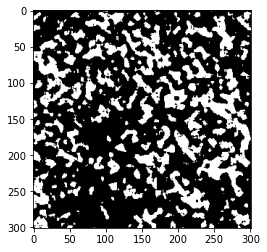

True Positive :  740
True Negative :  63321
False Positive :  26204
False Negative :  336
the oceral error is :  26540
the percentage correct classification :  0.7070672509133453
kappa score :  0.030679778122544077


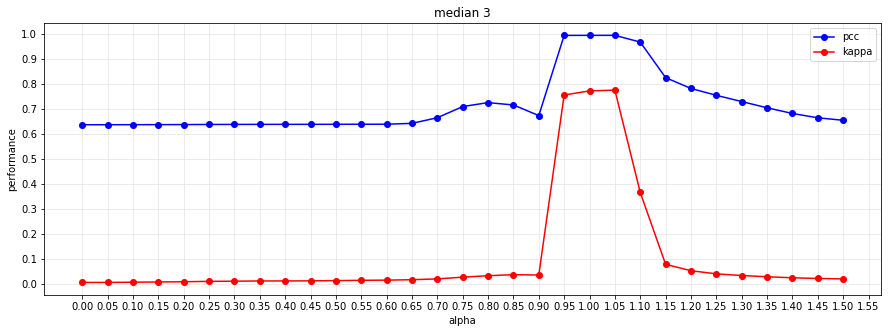

***********************
max pcc is :  0.9951876910850873
max kaapa score is :  0.7760442061188781
***********************
     ---------------------------------------------------------------------------------------------------------------


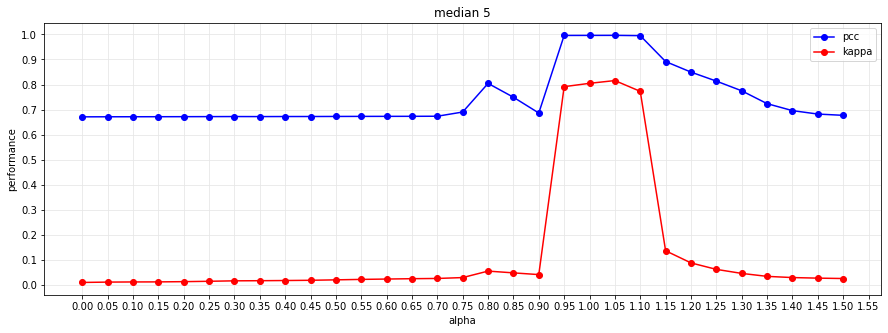

***********************
max pcc is :  0.9961369079811481
max kaapa score is :  0.8157849063474976
***********************
     ---------------------------------------------------------------------------------------------------------------


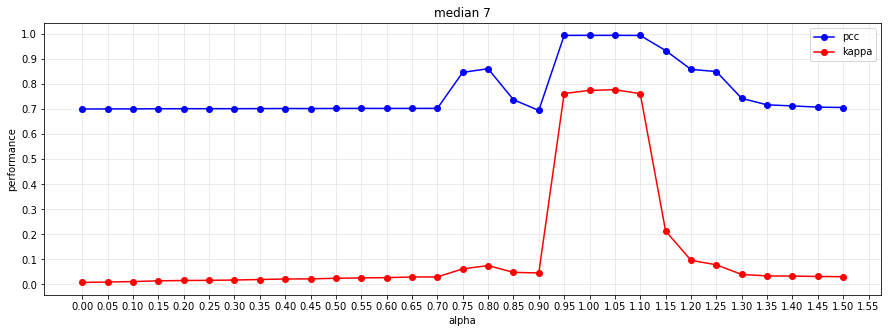

***********************
max pcc is :  0.9954857010408273
max kaapa score is :  0.7782364607697254
***********************
     ---------------------------------------------------------------------------------------------------------------


In [576]:
s2_tp=[]
s2_tn=[]
s2_fp=[]
s2_fn=[]
s2_pcc=[]
s2_kaapa=[]
s2_clustered_image=[]

for median in  median2_3channels:
    noisy_image1 = median
    kernel = np.array([[-1, -2, -1],
                       [-2, 13, -2],
                       [-1, -2, -1]])
    sharped_image1 = cv2.filter2D(src=noisy_image1, ddepth=-1, kernel=kernel)

    tem = golden_denoiser(sharped_image1)
    kmeans_result = kmeans(tem,  2,'k-means++' , 500 )
    tp,tn,fp,fn,pcc,kaapa = results(data2_im_gt, kmeans_result)
    
    s2_clustered_image.append(kmeans_result)
    s2_tp.append(tp)
    s2_tn.append(tn)
    s2_fp.append(fp)
    s2_fn.append(fn)
    s2_pcc.append(pcc)
    s2_kaapa.append(kaapa)

alpha_plotter(alpha_set,median_kernel, s2_pcc, s2_kaapa)

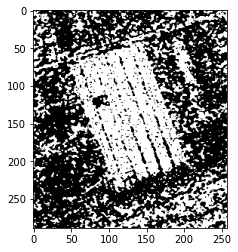

True Positive :  12112
True Negative :  40442
False Positive :  20414
False Negative :  1305
the oceral error is :  21719
the percentage correct classification :  0.7075787971402798
kappa score :  0.36478776611228514


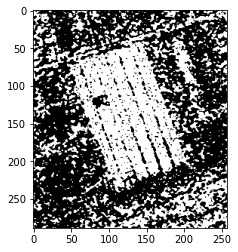

True Positive :  12147
True Negative :  40454
False Positive :  20402
False Negative :  1270
the oceral error is :  21672
the percentage correct classification :  0.708211597754231
kappa score :  0.3664345771010057


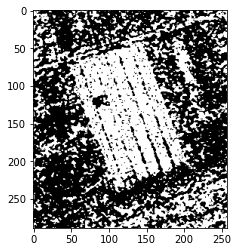

True Positive :  12149
True Negative :  40470
False Positive :  20386
False Negative :  1268
the oceral error is :  21654
the percentage correct classification :  0.7084539469255314
kappa score :  0.3667952670852086


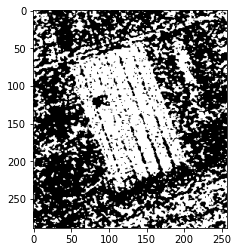

True Positive :  12153
True Negative :  40479
False Positive :  20377
False Negative :  1264
the oceral error is :  21641
the percentage correct classification :  0.7086289768825819
kappa score :  0.3671163098492567


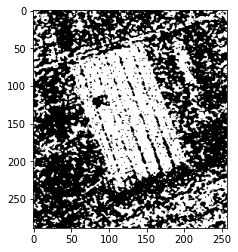

True Positive :  12156
True Negative :  40504
False Positive :  20352
False Negative :  1261
the oceral error is :  21613
the percentage correct classification :  0.7090059644823825
kappa score :  0.36767531557819744


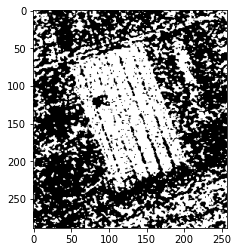

True Positive :  12142
True Negative :  40522
False Positive :  20334
False Negative :  1275
the oceral error is :  21609
the percentage correct classification :  0.7090598198537826
kappa score :  0.36741407470813503


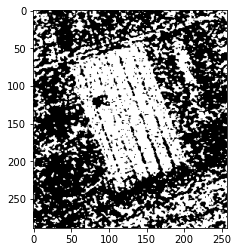

True Positive :  12125
True Negative :  40530
False Positive :  20326
False Negative :  1292
the oceral error is :  21618
the percentage correct classification :  0.7089386452681324
kappa score :  0.3668546471343008


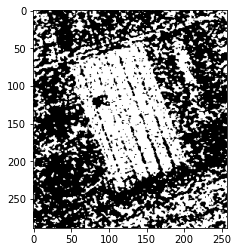

True Positive :  12120
True Negative :  40543
False Positive :  20313
False Negative :  1297
the oceral error is :  21610
the percentage correct classification :  0.7090463560109327
kappa score :  0.3668757665012782


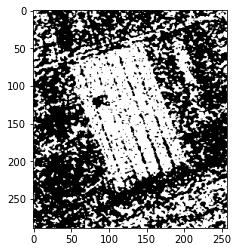

True Positive :  12091
True Negative :  40554
False Positive :  20302
False Negative :  1326
the oceral error is :  21628
the percentage correct classification :  0.7088040068396322
kappa score :  0.36587375606876094


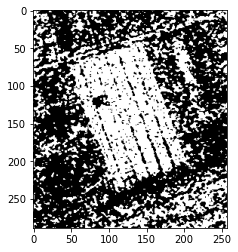

True Positive :  12066
True Negative :  40552
False Positive :  20304
False Negative :  1351
the oceral error is :  21655
the percentage correct classification :  0.7084404830826815
kappa score :  0.36480853684989245


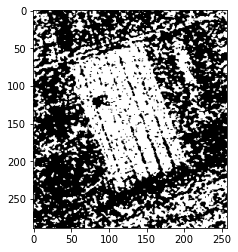

True Positive :  12030
True Negative :  40548
False Positive :  20308
False Negative :  1387
the oceral error is :  21695
the percentage correct classification :  0.7079019293686805
kappa score :  0.3632535040045668


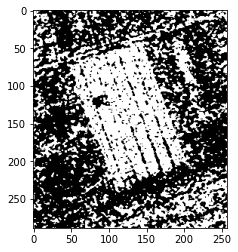

True Positive :  11956
True Negative :  40520
False Positive :  20336
False Negative :  1461
the oceral error is :  21797
the percentage correct classification :  0.7065286173979777
kappa score :  0.35970767430284656


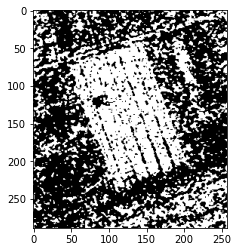

True Positive :  11848
True Negative :  40434
False Positive :  20422
False Negative :  1569
the oceral error is :  21991
the percentage correct classification :  0.7039166318850726
kappa score :  0.3537421195024224


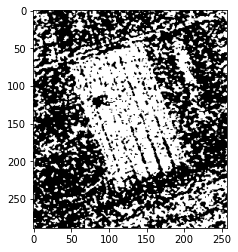

True Positive :  11743
True Negative :  39765
False Positive :  21091
False Negative :  1674
the oceral error is :  22765
the percentage correct classification :  0.6934956175191523
kappa score :  0.338004376888026


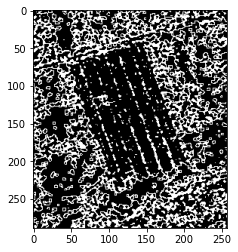

True Positive :  558
True Negative :  38543
False Positive :  22313
False Negative :  12859
the oceral error is :  35172
the percentage correct classification :  0.5264497192788766
kappa score :  -0.25502387820934036


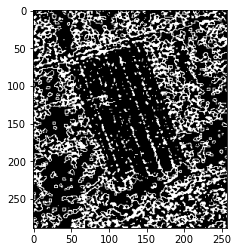

True Positive :  707
True Negative :  40146
False Positive :  20710
False Negative :  12710
the oceral error is :  33420
the percentage correct classification :  0.5500383719521226
kappa score :  -0.23337969890736665


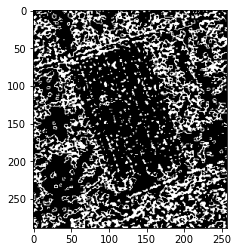

True Positive :  1249
True Negative :  41789
False Positive :  19067
False Negative :  12168
the oceral error is :  31235
the percentage correct classification :  0.5794568685794299
kappa score :  -0.1834551535194715


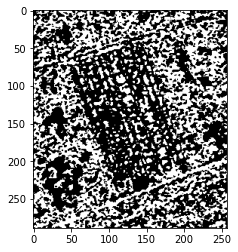

True Positive :  4484
True Negative :  33971
False Positive :  26885
False Negative :  8933
the oceral error is :  35818
the percentage correct classification :  0.5177520767977596
kappa score :  -0.07070474893833412


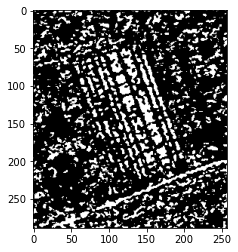

True Positive :  6377
True Negative :  50104
False Positive :  10752
False Negative :  7040
the oceral error is :  17792
the percentage correct classification :  0.7604513080123328
kappa score :  0.26954691290316646


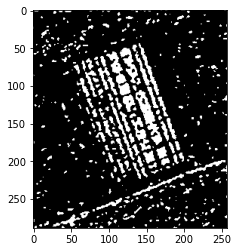

True Positive :  7672
True Negative :  57625
False Positive :  3231
False Negative :  5745
the oceral error is :  8976
the percentage correct classification :  0.8791485465781643
kappa score :  0.559586975921065


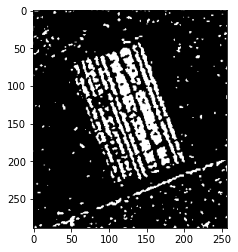

True Positive :  8653
True Negative :  58874
False Positive :  1982
False Negative :  4764
the oceral error is :  6746
the percentage correct classification :  0.9091729161337229
kappa score :  0.666199795796047


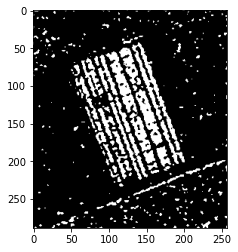

True Positive :  9176
True Negative :  58763
False Positive :  2093
False Negative :  4241
the oceral error is :  6334
the percentage correct classification :  0.9147200193879337
kappa score :  0.6927425882947063


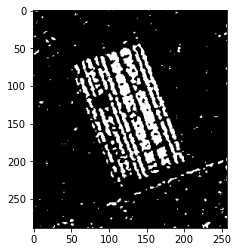

True Positive :  8247
True Negative :  60028
False Positive :  828
False Negative :  5170
the oceral error is :  5998
the percentage correct classification :  0.9192438705855426
kappa score :  0.6878204893730296


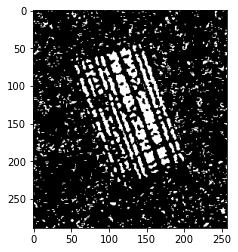

True Positive :  6812
True Negative :  56786
False Positive :  4070
False Negative :  6605
the oceral error is :  10675
the percentage correct classification :  0.8562734775759697
kappa score :  0.47587955292123063


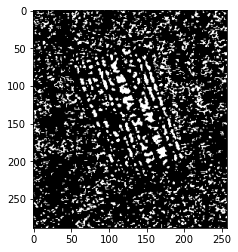

True Positive :  3898
True Negative :  52280
False Positive :  8576
False Negative :  9519
the oceral error is :  18095
the percentage correct classification :  0.7563717636287749
kappa score :  0.1538178232539712


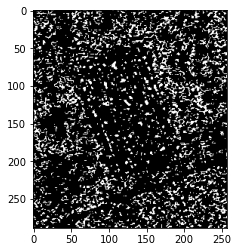

True Positive :  1253
True Negative :  49697
False Positive :  11159
False Negative :  12164
the oceral error is :  23323
the percentage correct classification :  0.6859827932088377
kappa score :  -0.09268425263768854


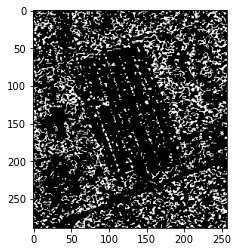

True Positive :  465
True Negative :  47067
False Positive :  13789
False Negative :  12952
the oceral error is :  26741
the percentage correct classification :  0.6399633783474479
kappa score :  -0.18737064808514114


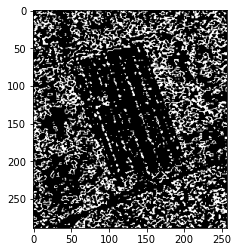

True Positive :  374
True Negative :  43887
False Positive :  16969
False Negative :  13043
the oceral error is :  30012
the percentage correct classification :  0.595923148385012
kappa score :  -0.22527120378211785


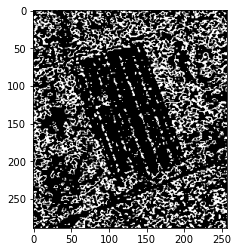

True Positive :  363
True Negative :  41484
False Positive :  19372
False Negative :  13054
the oceral error is :  32426
the percentage correct classification :  0.5634214317450487
kappa score :  -0.24610106614681126


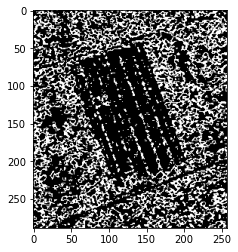

True Positive :  413
True Negative :  38618
False Positive :  22238
False Negative :  13004
the oceral error is :  35242
the percentage correct classification :  0.5255072502793747
kappa score :  -0.263858606660585


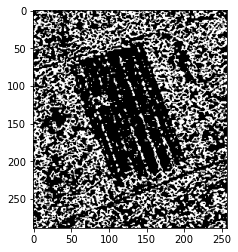

True Positive :  466
True Negative :  35726
False Positive :  25130
False Negative :  12951
the oceral error is :  38081
the percentage correct classification :  0.4872834004281502
kappa score :  -0.2793690758763119


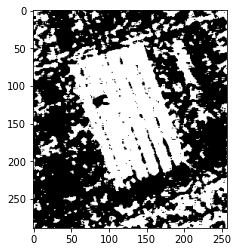

True Positive :  12550
True Negative :  42347
False Positive :  18509
False Negative :  867
the oceral error is :  19376
the percentage correct classification :  0.7391245809378912
kappa score :  0.4173460863349878


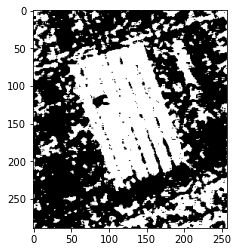

True Positive :  12553
True Negative :  42351
False Positive :  18505
False Negative :  864
the oceral error is :  19369
the percentage correct classification :  0.7392188278378414
kappa score :  0.4175453957027667


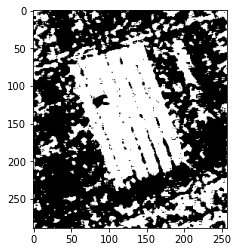

True Positive :  12555
True Negative :  42359
False Positive :  18497
False Negative :  862
the oceral error is :  19359
the percentage correct classification :  0.7393534662663417
kappa score :  0.4177790142621868


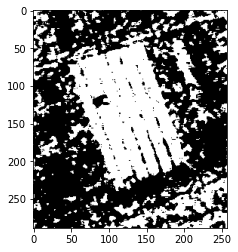

True Positive :  12553
True Negative :  42369
False Positive :  18487
False Negative :  864
the oceral error is :  19351
the percentage correct classification :  0.7394611770091419
kappa score :  0.41788543034480485


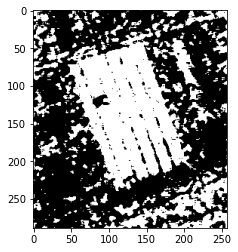

True Positive :  12551
True Negative :  42393
False Positive :  18463
False Negative :  866
the oceral error is :  19329
the percentage correct classification :  0.7397573815518426
kappa score :  0.4182566192467183


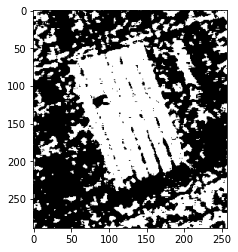

True Positive :  12546
True Negative :  42397
False Positive :  18459
False Negative :  871
the oceral error is :  19330
the percentage correct classification :  0.7397439177089925
kappa score :  0.4181258527602376


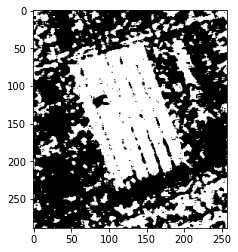

True Positive :  12538
True Negative :  42412
False Positive :  18444
False Negative :  879
the oceral error is :  19323
the percentage correct classification :  0.7398381646089427
kappa score :  0.41807923586120677


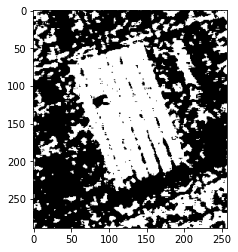

True Positive :  12528
True Negative :  42413
False Positive :  18443
False Negative :  889
the oceral error is :  19332
the percentage correct classification :  0.7397169900232925
kappa score :  0.4176849872512227


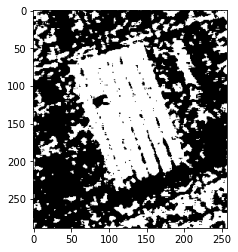

True Positive :  12517
True Negative :  42424
False Positive :  18432
False Negative :  900
the oceral error is :  19332
the percentage correct classification :  0.7397169900232925
kappa score :  0.41743841154449723


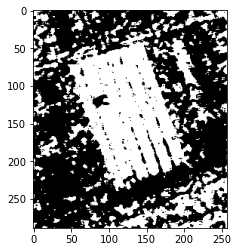

True Positive :  12495
True Negative :  42435
False Positive :  18421
False Negative :  922
the oceral error is :  19343
the percentage correct classification :  0.7395688877519422
kappa score :  0.41673646520435303


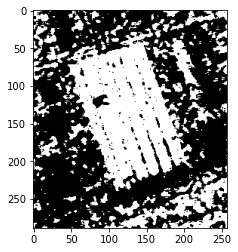

True Positive :  12453
True Negative :  42463
False Positive :  18393
False Negative :  964
the oceral error is :  19357
the percentage correct classification :  0.7393803939520418
kappa score :  0.4155263451170933


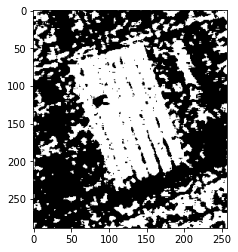

True Positive :  12417
True Negative :  42468
False Positive :  18388
False Negative :  1000
the oceral error is :  19388
the percentage correct classification :  0.738963014823691
kappa score :  0.41412706413375633


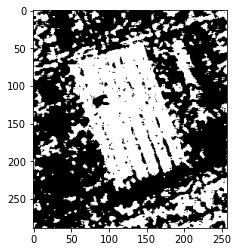

True Positive :  12346
True Negative :  42522
False Positive :  18334
False Negative :  1071
the oceral error is :  19405
the percentage correct classification :  0.7387341294952405
kappa score :  0.41219521580486673


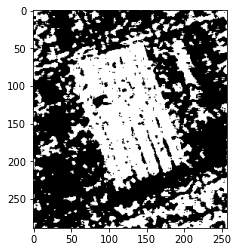

True Positive :  12085
True Negative :  42558
False Positive :  18298
False Negative :  1332
the oceral error is :  19630
the percentage correct classification :  0.7357047648539846
kappa score :  0.40194309633971936


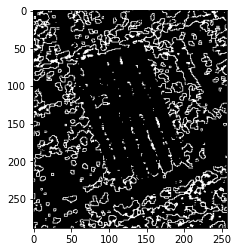

True Positive :  71
True Negative :  49793
False Positive :  11063
False Negative :  13346
the oceral error is :  24409
the percentage correct classification :  0.6713610598737092
kappa score :  -0.18903504276472072


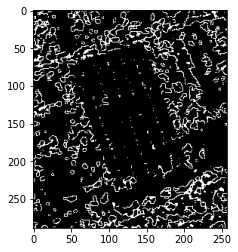

True Positive :  84
True Negative :  51520
False Positive :  9336
False Negative :  13333
the oceral error is :  22669
the percentage correct classification :  0.6947881464327549
kappa score :  -0.16648125615398857


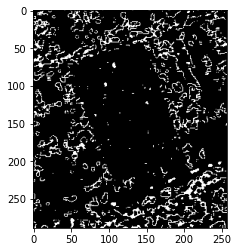

True Positive :  253
True Negative :  53130
False Positive :  7726
False Negative :  13164
the oceral error is :  20890
the percentage correct classification :  0.7187403228629515
kappa score :  -0.1283793792657253


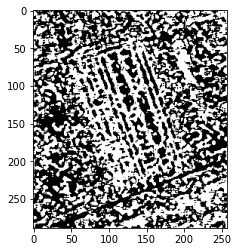

True Positive :  6274
True Negative :  30867
False Positive :  29989
False Negative :  7143
the oceral error is :  37132
the percentage correct classification :  0.5000605872928251
kappa score :  -0.015129460527812277


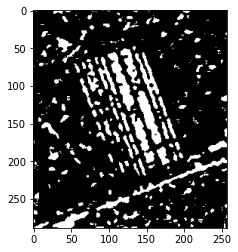

True Positive :  7045
True Negative :  55907
False Positive :  4949
False Negative :  6372
the oceral error is :  11321
the percentage correct classification :  0.8475758350948528
kappa score :  0.4628921281461622


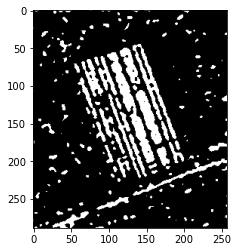

True Positive :  8901
True Negative :  57962
False Positive :  2894
False Negative :  4516
the oceral error is :  7410
the percentage correct classification :  0.9002329244813054
kappa score :  0.6463108301020188


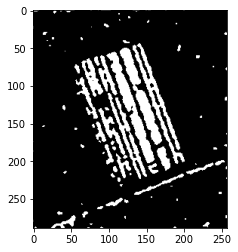

True Positive :  9638
True Negative :  59840
False Positive :  1016
False Negative :  3779
the oceral error is :  4795
the percentage correct classification :  0.9354408735341241
kappa score :  0.7628800111540309


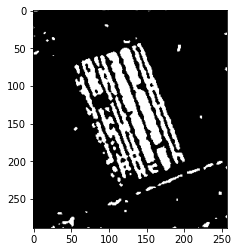

True Positive :  9927
True Negative :  60088
False Positive :  768
False Negative :  3490
the oceral error is :  4258
the percentage correct classification :  0.9426709571445883
kappa score :  0.7897077991172314


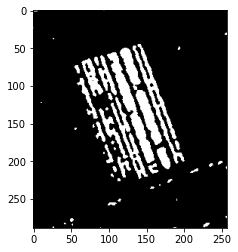

True Positive :  8978
True Negative :  60555
False Positive :  301
False Negative :  4439
the oceral error is :  4740
the percentage correct classification :  0.9361813848908755
kappa score :  0.7549577324420429


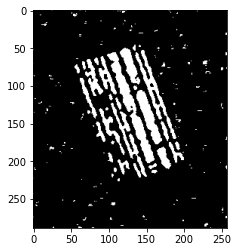

True Positive :  7746
True Negative :  60169
False Positive :  687
False Negative :  5671
the oceral error is :  6358
the percentage correct classification :  0.914396887159533
kappa score :  0.6618669985653635


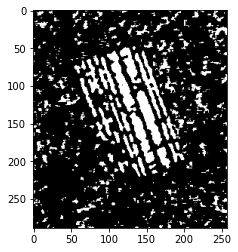

True Positive :  7398
True Negative :  55086
False Positive :  5770
False Negative :  6019
the oceral error is :  11789
the percentage correct classification :  0.8412747566410405
kappa score :  0.4599027282172877


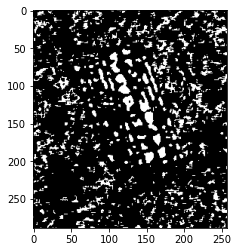

True Positive :  3387
True Negative :  52627
False Positive :  8229
False Negative :  10030
the oceral error is :  18259
the percentage correct classification :  0.7541636934013706
kappa score :  0.12369151498072373


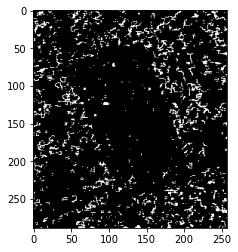

True Positive :  95
True Negative :  54504
False Positive :  6352
False Negative :  13322
the oceral error is :  19674
the percentage correct classification :  0.7351123557685835
kappa score :  -0.12199923137385738


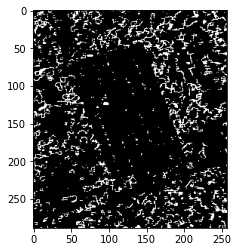

True Positive :  48
True Negative :  52358
False Positive :  8498
False Negative :  13369
the oceral error is :  21867
the percentage correct classification :  0.7055861483984759
kappa score :  -0.1584903934191193


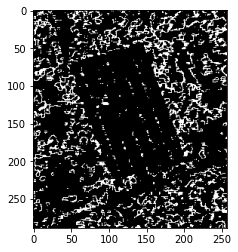

True Positive :  68
True Negative :  49658
False Positive :  11198
False Negative :  13349
the oceral error is :  24547
the percentage correct classification :  0.6695030495604055
kappa score :  -0.190866561951043


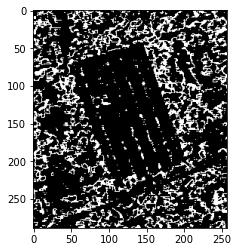

True Positive :  102
True Negative :  45308
False Positive :  15548
False Negative :  13315
the oceral error is :  28863
the percentage correct classification :  0.6113931038196923
kappa score :  -0.232785565202015


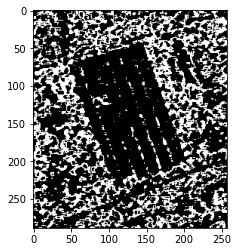

True Positive :  134
True Negative :  38851
False Positive :  22005
False Negative :  13283
the oceral error is :  35288
the percentage correct classification :  0.5248879135082736
kappa score :  -0.2805258818210772


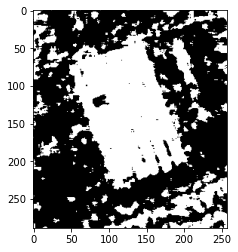

True Positive :  12604
True Negative :  43331
False Positive :  17525
False Negative :  813
the oceral error is :  18338
the percentage correct classification :  0.7531000498162186
kappa score :  0.4385306314235419


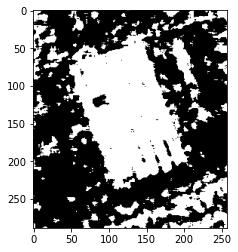

True Positive :  12605
True Negative :  43340
False Positive :  17516
False Negative :  812
the oceral error is :  18328
the percentage correct classification :  0.7532346882447188
kappa score :  0.43874900318745824


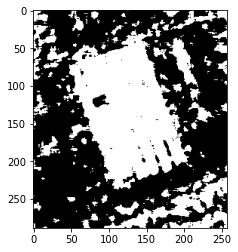

True Positive :  12603
True Negative :  43359
False Positive :  17497
False Negative :  814
the oceral error is :  18311
the percentage correct classification :  0.7534635735731693
kappa score :  0.4390391789060739


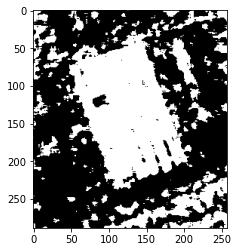

True Positive :  12597
True Negative :  43368
False Positive :  17488
False Negative :  820
the oceral error is :  18308
the percentage correct classification :  0.7535039651017194
kappa score :  0.43896641799464664


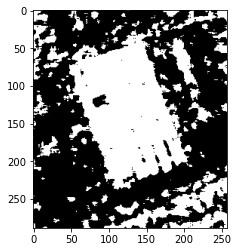

True Positive :  12600
True Negative :  43363
False Positive :  17493
False Negative :  817
the oceral error is :  18310
the percentage correct classification :  0.7534770374160192
kappa score :  0.4389929733784691


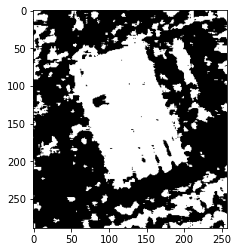

True Positive :  12598
True Negative :  43358
False Positive :  17498
False Negative :  819
the oceral error is :  18317
the percentage correct classification :  0.753382790516069
kappa score :  0.4388114446279858


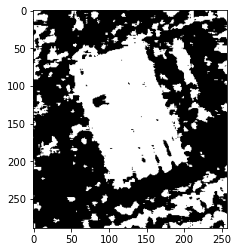

True Positive :  12599
True Negative :  43364
False Positive :  17492
False Negative :  818
the oceral error is :  18310
the percentage correct classification :  0.7534770374160192
kappa score :  0.43897101502301694


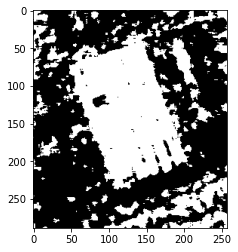

True Positive :  12596
True Negative :  43370
False Positive :  17486
False Negative :  821
the oceral error is :  18307
the percentage correct classification :  0.7535174289445694
kappa score :  0.4389641190755429


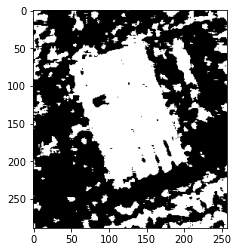

True Positive :  12593
True Negative :  43373
False Positive :  17483
False Negative :  824
the oceral error is :  18307
the percentage correct classification :  0.7535174289445694
kappa score :  0.43889822127625544


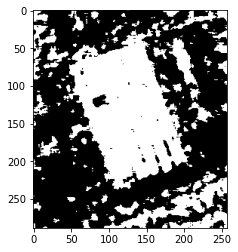

True Positive :  12591
True Negative :  43373
False Positive :  17483
False Negative :  826
the oceral error is :  18309
the percentage correct classification :  0.7534905012588693
kappa score :  0.4388149503518326


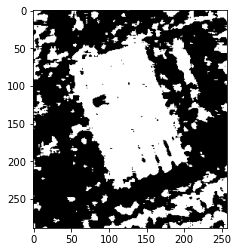

True Positive :  12583
True Negative :  43393
False Positive :  17463
False Negative :  834
the oceral error is :  18297
the percentage correct classification :  0.7536520673730697
kappa score :  0.43887517579962654


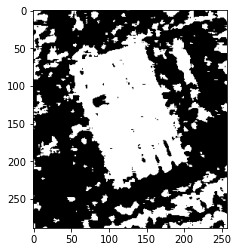

True Positive :  12562
True Negative :  43431
False Positive :  17425
False Negative :  855
the oceral error is :  18280
the percentage correct classification :  0.7538809527015201
kappa score :  0.43874789907534106


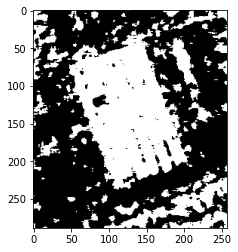

True Positive :  12522
True Negative :  43475
False Positive :  17381
False Negative :  895
the oceral error is :  18276
the percentage correct classification :  0.7539348080729201
kappa score :  0.4379448529682458


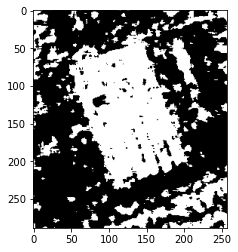

True Positive :  12315
True Negative :  43576
False Positive :  17280
False Negative :  1102
the oceral error is :  18382
the percentage correct classification :  0.7525076407308174
kappa score :  0.43124400230403115


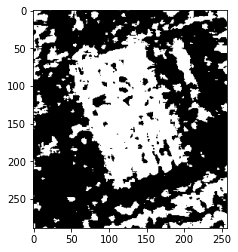

True Positive :  11665
True Negative :  43803
False Positive :  17053
False Negative :  1752
the oceral error is :  18805
the percentage correct classification :  0.7468124352052563
kappa score :  0.40789387668038357


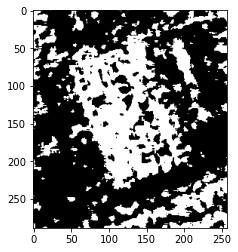

True Positive :  9978
True Negative :  44239
False Positive :  16617
False Negative :  3439
the oceral error is :  20056
the percentage correct classification :  0.7299691677998734
kappa score :  0.3403396579536958


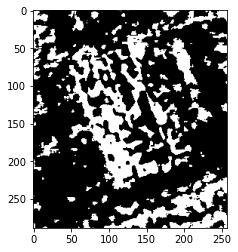

True Positive :  5899
True Negative :  45530
False Positive :  15326
False Negative :  7518
the oceral error is :  22844
the percentage correct classification :  0.6924319739340002
kappa score :  0.15309929090548824


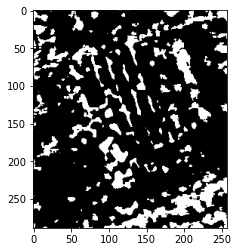

True Positive :  1882
True Negative :  47902
False Positive :  12954
False Negative :  11535
the oceral error is :  24489
the percentage correct classification :  0.670283952445707
kappa score :  -0.06971937311227538


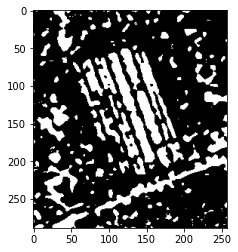

True Positive :  8585
True Negative :  51556
False Positive :  9300
False Negative :  4832
the oceral error is :  14132
the percentage correct classification :  0.8097289728434289
kappa score :  0.431086933551143


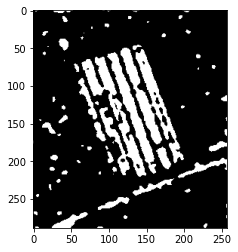

True Positive :  9839
True Negative :  58044
False Positive :  2812
False Negative :  3578
the oceral error is :  6390
the percentage correct classification :  0.9139660441883323
kappa score :  0.7027538655521799


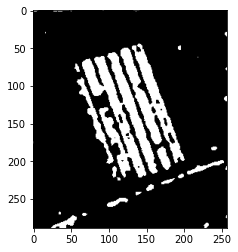

True Positive :  10608
True Negative :  59559
False Positive :  1297
False Negative :  2809
the oceral error is :  4106
the percentage correct classification :  0.9447174612577922
kappa score :  0.8046701931905023


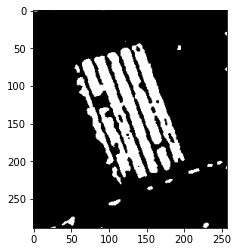

True Positive :  10783
True Negative :  59797
False Positive :  1059
False Negative :  2634
the oceral error is :  3693
the percentage correct classification :  0.9502780283548531
kappa score :  0.823980403758078


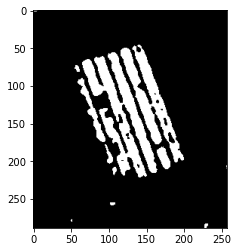

True Positive :  9843
True Negative :  60172
False Positive :  684
False Negative :  3574
the oceral error is :  4258
the percentage correct classification :  0.9426709571445883
kappa score :  0.7885874273362781


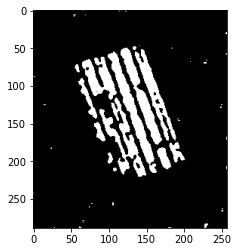

True Positive :  8747
True Negative :  60354
False Positive :  502
False Negative :  4670
the oceral error is :  5172
the percentage correct classification :  0.9303650047796642
kappa score :  0.73235964776402


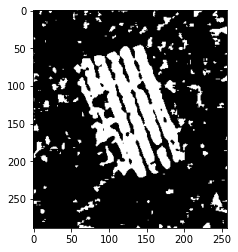

True Positive :  10499
True Negative :  55220
False Positive :  5636
False Negative :  2918
the oceral error is :  8554
the percentage correct classification :  0.8848302882608754
kappa score :  0.63941566766231


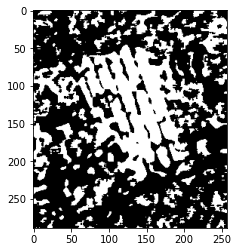

True Positive :  10020
True Negative :  43289
False Positive :  17567
False Negative :  3397
the oceral error is :  20964
the percentage correct classification :  0.7177439984920496
kappa score :  0.3245508839459261


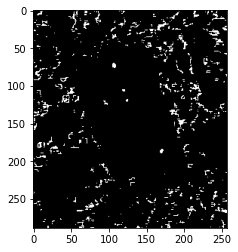

True Positive :  77
True Negative :  57289
False Positive :  3567
False Negative :  13340
the oceral error is :  16907
the percentage correct classification :  0.7723668089346061
kappa score :  -0.07383777913947887


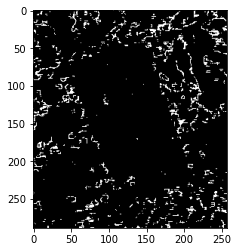

True Positive :  12
True Negative :  56278
False Positive :  4578
False Negative :  13405
the oceral error is :  17983
the percentage correct classification :  0.7578797140279778
kappa score :  -0.0999661712466291


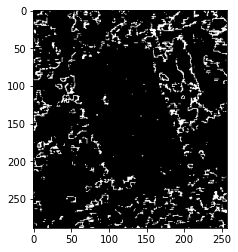

True Positive :  12
True Negative :  54618
False Positive :  6238
False Negative :  13405
the oceral error is :  19643
the percentage correct classification :  0.7355297348969343
kappa score :  -0.12832797800964646


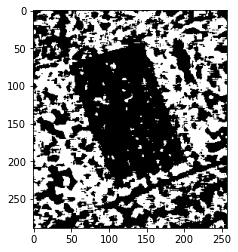

True Positive :  305
True Negative :  31400
False Positive :  29456
False Negative :  13112
the oceral error is :  42568
the percentage correct classification :  0.4268711375600824
kappa score :  -0.31278644327592975


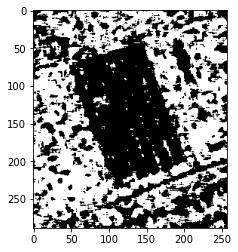

True Positive :  253
True Negative :  25808
False Positive :  35048
False Negative :  13164
the oceral error is :  48212
the percentage correct classification :  0.3508812085145342
kappa score :  -0.3405573608560861


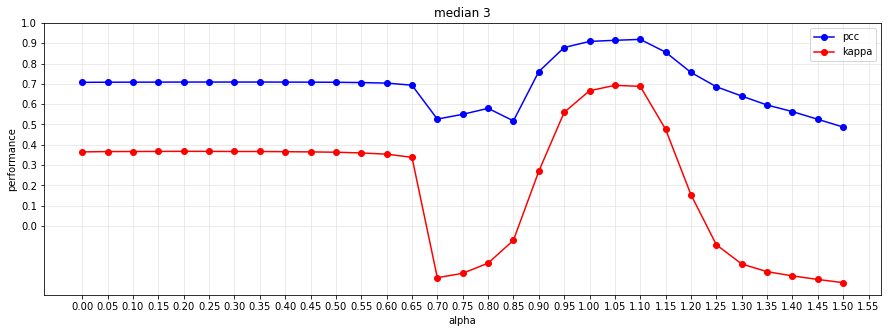

***********************
max pcc is :  0.9192438705855426
max kaapa score is :  0.6927425882947063
***********************
     ---------------------------------------------------------------------------------------------------------------


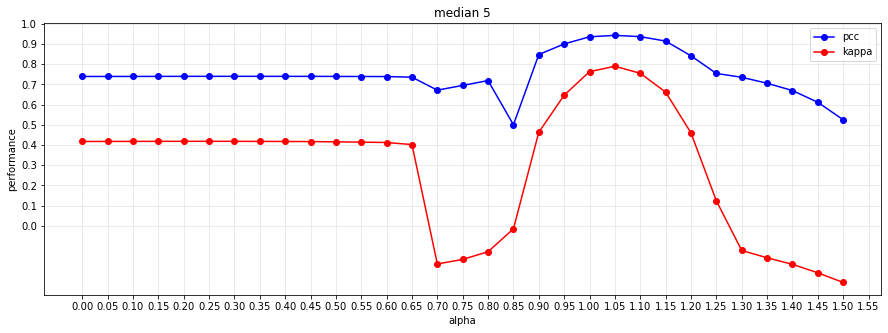

***********************
max pcc is :  0.9426709571445883
max kaapa score is :  0.7897077991172314
***********************
     ---------------------------------------------------------------------------------------------------------------


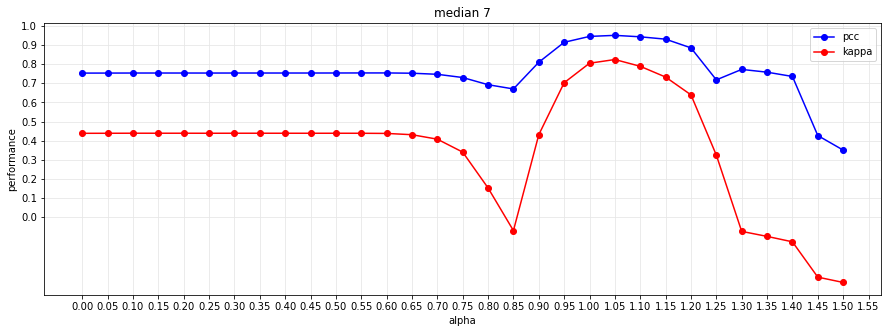

***********************
max pcc is :  0.9502780283548531
max kaapa score is :  0.823980403758078
***********************
     ---------------------------------------------------------------------------------------------------------------


In [577]:
s3_tp=[]
s3_tn=[]
s3_fp=[]
s3_fn=[]
s3_pcc=[]
s3_kaapa=[]
s3_clustered_image=[]

for median in  median3_3channels:
    noisy_image1 = median
    kernel = np.array([[-1, -2, -1],
                       [-2, 13, -2],
                       [-1, -2, -1]])
    sharped_image1 = cv2.filter2D(src=noisy_image1, ddepth=-1, kernel=kernel)

    tem = golden_denoiser(sharped_image1)
    kmeans_result = kmeans(tem,  2,'k-means++' , 500 )
    tp,tn,fp,fn,pcc,kaapa = results(data3_im_gt, kmeans_result)
    
    s3_clustered_image.append(kmeans_result)
    s3_tp.append(tp)
    s3_tn.append(tn)
    s3_fp.append(fp)
    s3_fn.append(fn)
    s3_pcc.append(pcc)
    s3_kaapa.append(kaapa)

alpha_plotter(alpha_set,median_kernel, s3_pcc, s3_kaapa)

In [732]:

def combined2(img1 , img2 ,ground_truth, alpha, median_kernel,gs_kernel, bi_kernel,  ncls, init, max_iter, plotter):

  
  img1_mean = cv2.blur(img1, (3,3))
  img2_mean = cv2.blur(img2, (3,3))


  mean_ratio= img1_mean.copy()
  for i in range(img1_mean.shape[0]):
    for j in range(img1_mean.shape[1]):
      mean_ratio[i][j]= (1 - np.minimum( img1_mean[i][j]/img2_mean[i][j]  , img2_mean[i][j]/img1_mean[i][j]  ))*255


  subtraction= np.abs(img1 - img2)

  
  combined = (alpha * mean_ratio ) + ((1 - alpha) * subtraction)


  final = combined.copy()
  for i in range(combined.shape[0]):
    for j in range(combined.shape[1]):
      if combined[i][j] <= 0 :
        final[i][j] = -combined[i][j]
      else:
        final[i][j] = combined[i][j]
  final.astype('uint8')

  
  median = cv2.medianBlur(final.astype('uint8'),median_kernel)
    
  median_result_gaussina = cv2.GaussianBlur(median,(1,gs_kernel),0)
  median_result_gaussina = cv2.GaussianBlur(median_result_gaussina,(gs_kernel,1),0)

  median_result_bilateral = cv2.bilateralFilter(median,bi_kernel,0,0)




  median_3channels = cv2.cvtColor(median.astype('uint8'), cv2.COLOR_GRAY2BGR)

  median_3channels_gaussina = cv2.cvtColor(median_result_gaussina.astype('uint8'), cv2.COLOR_GRAY2BGR)
  median_3channels_bilateral = cv2.cvtColor(median_result_bilateral.astype('uint8'), cv2.COLOR_GRAY2BGR)

  
  print('-----------------------------------------------------------')
  print('alpha is : ',alpha)
  print('median kernel is : ',median_kernel)
  
  if plotter:
    fig= plt.figure(figsize=(7, 20))
    ax1 = fig.add_subplot(421)
    ax2 = fig.add_subplot(422)
    ax3 = fig.add_subplot(423)
    ax4 = fig.add_subplot(424)
    ax5 = fig.add_subplot(425)
    ax6 = fig.add_subplot(426)



    ax1.imshow(img1_mean, cmap='gray')
    ax1.set_title('img1 mean')
    ax1.axis('off')

    ax2.imshow(img2_mean, cmap='gray')
    ax2.set_title('img2 mean')
    ax2.axis('off')

    ax3.imshow(mean_ratio, cmap='gray')
    ax3.set_title('mean ratio of 2 images')
    ax3.axis('off')

    ax4.imshow(subtraction, cmap='gray')
    ax4.set_title('subtraction of img1 and img2')
    ax4.axis('off')

    ax5.imshow(combined, cmap='gray')
    ax5.set_title('combined image')
    ax5.axis('off')

    ax6.imshow(median, cmap='gray')
    ax6.set_title('median image with kernel size of {} '.format(median_kernel) )
    ax6.axis('off')

    plt.show() 



    
  print('-----------------gaussina----------------')

  print('clustering image')
  gs_kmeans_result2= kmeans(median_3channels_gaussina, ncls, init, max_iter )

  print('result of k means clustering')
  gs_tp,gs_tn,gs_fp,gs_fn,gs_pcc,gs_kappa = results(ground_truth, gs_kmeans_result2)
    
    
  print('-----------------bilteral----------------')
  print('clustering image')
  bi_kmeans_result3= kmeans(median_3channels_bilateral, ncls, init, max_iter )

  print('result of k means clustering')
  bi_tp,bi_tn,bi_fp,bi_fn,bi_pcc,bi_kappa = results(ground_truth, bi_kmeans_result3)

  print('-----------------normal----------------')

  print('clustering image')
  nor_kmeans_result= kmeans(median_3channels, ncls, init, max_iter )

  print('result of k means clustering')
  nor_tp,nor_tn,nor_fp,nor_fn,nor_pcc,nor_kappa = results(ground_truth, nor_kmeans_result)

  return gs_pcc, gs_kappa, bi_pcc, bi_kappa, nor_pcc, nor_kappa

-----------------------------------------------------------
alpha is :  0.9
median kernel is :  3
-----------------gaussina----------------
clustering image


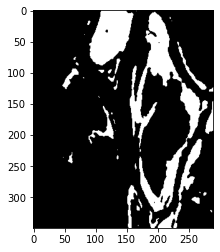

result of k means clustering
True Positive :  15001
True Negative :  82640
False Positive :  2987
False Negative :  864
the oceral error is :  3851
the percentage correct classification :  0.9619802955665024
kappa score :  0.8633587466455611
-----------------bilteral----------------
clustering image


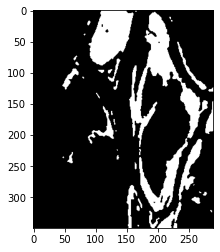

result of k means clustering
True Positive :  15054
True Negative :  82352
False Positive :  3275
False Negative :  811
the oceral error is :  4086
the percentage correct classification :  0.9596650246305418
kappa score :  0.8562308667570109
-----------------normal----------------
clustering image


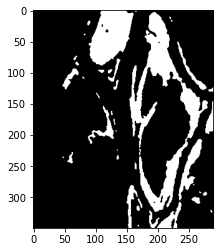

result of k means clustering
True Positive :  15065
True Negative :  82292
False Positive :  3335
False Negative :  800
the oceral error is :  4135
the percentage correct classification :  0.9591822660098522
kappa score :  0.854759028295432
-----------------------------------------------------------
alpha is :  0.95
median kernel is :  3
-----------------gaussina----------------
clustering image


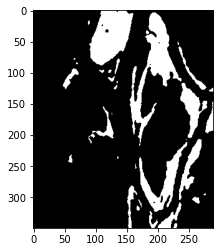

result of k means clustering
True Positive :  14716
True Negative :  83409
False Positive :  2218
False Negative :  1149
the oceral error is :  3367
the percentage correct classification :  0.9667487684729064
kappa score :  0.8773503839344634
-----------------bilteral----------------
clustering image


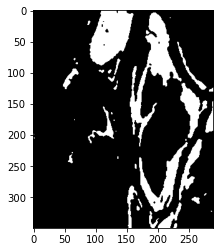

result of k means clustering
True Positive :  14746
True Negative :  83228
False Positive :  2399
False Negative :  1119
the oceral error is :  3518
the percentage correct classification :  0.9652610837438423
kappa score :  0.8725347178037025
-----------------normal----------------
clustering image


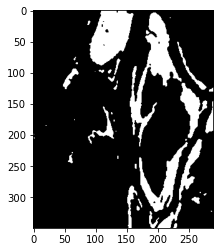

result of k means clustering
True Positive :  14767
True Negative :  83175
False Positive :  2452
False Negative :  1098
the oceral error is :  3550
the percentage correct classification :  0.9649458128078817
kappa score :  0.8716139686689707
-----------------------------------------------------------
alpha is :  1
median kernel is :  3
-----------------gaussina----------------
clustering image


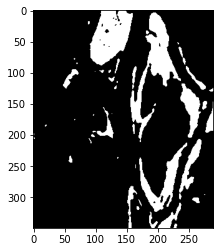

result of k means clustering
True Positive :  14368
True Negative :  83906
False Positive :  1721
False Negative :  1497
the oceral error is :  3218
the percentage correct classification :  0.9682167487684729
kappa score :  0.8802374518781885
-----------------bilteral----------------
clustering image


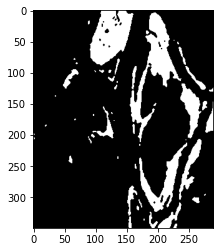

result of k means clustering
True Positive :  14319
True Negative :  83796
False Positive :  1831
False Negative :  1546
the oceral error is :  3377
the percentage correct classification :  0.9666502463054187
kappa score :  0.8745299997192151
-----------------normal----------------
clustering image


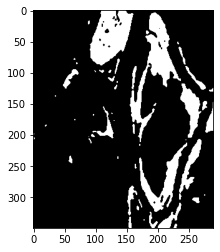

result of k means clustering
True Positive :  14262
True Negative :  83869
False Positive :  1758
False Negative :  1603
the oceral error is :  3361
the percentage correct classification :  0.966807881773399
kappa score :  0.8747081087887096
-----------------------------------------------------------
alpha is :  1.05
median kernel is :  3
-----------------gaussina----------------
clustering image


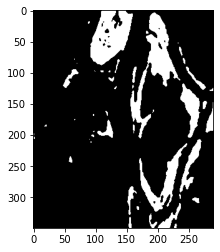

result of k means clustering
True Positive :  13630
True Negative :  84458
False Positive :  1169
False Negative :  2235
the oceral error is :  3404
the percentage correct classification :  0.9663842364532019
kappa score :  0.8690176788697903
-----------------bilteral----------------
clustering image


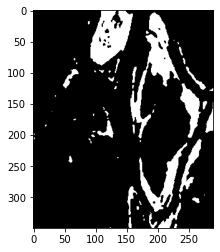

result of k means clustering
True Positive :  13598
True Negative :  84331
False Positive :  1296
False Negative :  2267
the oceral error is :  3563
the percentage correct classification :  0.9648177339901478
kappa score :  0.8632566290686372
-----------------normal----------------
clustering image


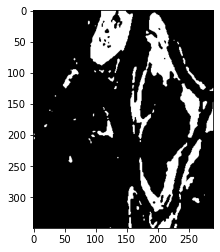

result of k means clustering
True Positive :  13631
True Negative :  84284
False Positive :  1343
False Negative :  2234
the oceral error is :  3577
the percentage correct classification :  0.964679802955665
kappa score :  0.8630089680326218
-----------------------------------------------------------
alpha is :  1.1
median kernel is :  3
-----------------gaussina----------------
clustering image


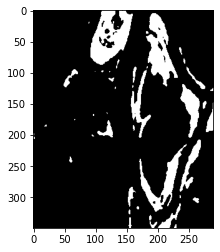

result of k means clustering
True Positive :  12606
True Negative :  84853
False Positive :  774
False Negative :  3259
the oceral error is :  4033
the percentage correct classification :  0.9601871921182266
kappa score :  0.838823939842524
-----------------bilteral----------------
clustering image


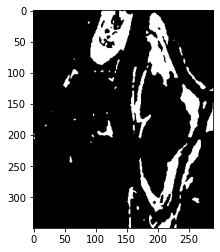

result of k means clustering
True Positive :  12561
True Negative :  84802
False Positive :  825
False Negative :  3304
the oceral error is :  4129
the percentage correct classification :  0.9592413793103448
kappa score :  0.8350220971628306
-----------------normal----------------
clustering image


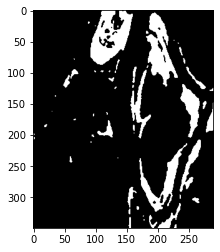

result of k means clustering
True Positive :  12612
True Negative :  84765
False Positive :  862
False Negative :  3253
the oceral error is :  4115
the percentage correct classification :  0.9593793103448276
kappa score :  0.8359760224921708
-----------------------------------------------------------
alpha is :  0.9
median kernel is :  5
-----------------gaussina----------------
clustering image


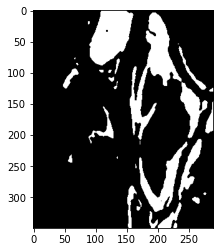

result of k means clustering
True Positive :  15022
True Negative :  82804
False Positive :  2823
False Negative :  843
the oceral error is :  3666
the percentage correct classification :  0.9638029556650246
kappa score :  0.8694549979327904
-----------------bilteral----------------
clustering image


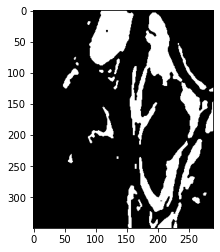

result of k means clustering
True Positive :  15098
True Negative :  82516
False Positive :  3111
False Negative :  767
the oceral error is :  3878
the percentage correct classification :  0.9617142857142857
kappa score :  0.8631388109005755
-----------------normal----------------
clustering image


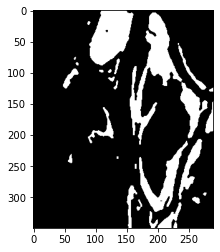

result of k means clustering
True Positive :  15079
True Negative :  82592
False Positive :  3035
False Negative :  786
the oceral error is :  3821
the percentage correct classification :  0.9622758620689655
kappa score :  0.8648354706080756
-----------------------------------------------------------
alpha is :  0.95
median kernel is :  5
-----------------gaussina----------------
clustering image


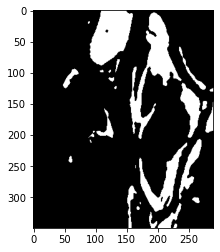

result of k means clustering
True Positive :  14717
True Negative :  83641
False Positive :  1986
False Negative :  1148
the oceral error is :  3134
the percentage correct classification :  0.9690443349753695
kappa score :  0.8851551233663468
-----------------bilteral----------------
clustering image


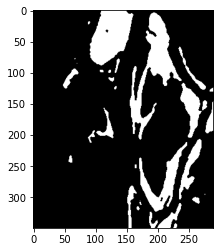

result of k means clustering
True Positive :  14805
True Negative :  83377
False Positive :  2250
False Negative :  1060
the oceral error is :  3310
the percentage correct classification :  0.9673103448275862
kappa score :  0.8797851193302665
-----------------normal----------------
clustering image


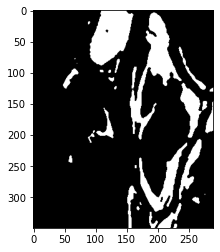

result of k means clustering
True Positive :  14760
True Negative :  83475
False Positive :  2152
False Negative :  1105
the oceral error is :  3257
the percentage correct classification :  0.9678325123152709
kappa score :  0.8812826176587871
-----------------------------------------------------------
alpha is :  1
median kernel is :  5
-----------------gaussina----------------
clustering image


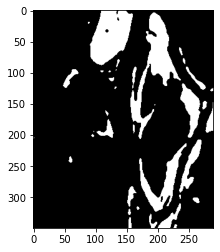

result of k means clustering
True Positive :  14316
True Negative :  84144
False Positive :  1483
False Negative :  1549
the oceral error is :  3032
the percentage correct classification :  0.9700492610837439
kappa score :  0.8863012219765851
-----------------bilteral----------------
clustering image


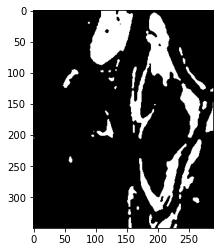

result of k means clustering
True Positive :  14313
True Negative :  84144
False Positive :  1483
False Negative :  1552
the oceral error is :  3035
the percentage correct classification :  0.9700197044334975
kappa score :  0.8861802416710486
-----------------normal----------------
clustering image


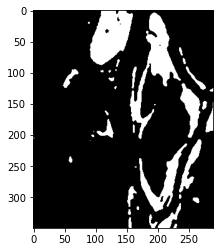

result of k means clustering
True Positive :  14358
True Negative :  84119
False Positive :  1508
False Negative :  1507
the oceral error is :  3015
the percentage correct classification :  0.9702167487684729
kappa score :  0.8871314315372869
-----------------------------------------------------------
alpha is :  1.05
median kernel is :  5
-----------------gaussina----------------
clustering image


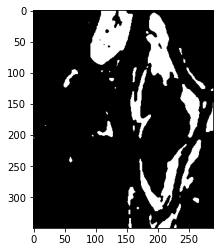

result of k means clustering
True Positive :  13480
True Negative :  84578
False Positive :  1049
False Negative :  2385
the oceral error is :  3434
the percentage correct classification :  0.9660886699507389
kappa score :  0.866914411879376
-----------------bilteral----------------
clustering image


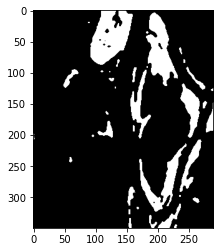

result of k means clustering
True Positive :  13477
True Negative :  84565
False Positive :  1062
False Negative :  2388
the oceral error is :  3450
the percentage correct classification :  0.9659310344827586
kappa score :  0.8663312912606267
-----------------normal----------------
clustering image


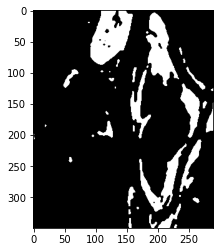

result of k means clustering
True Positive :  13532
True Negative :  84532
False Positive :  1095
False Negative :  2333
the oceral error is :  3428
the percentage correct classification :  0.9661477832512315
kappa score :  0.8674915013519287
-----------------------------------------------------------
alpha is :  1.1
median kernel is :  5
-----------------gaussina----------------
clustering image


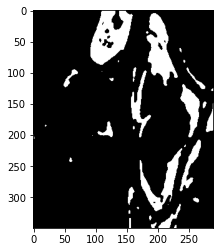

result of k means clustering
True Positive :  12614
True Negative :  84886
False Positive :  741
False Negative :  3251
the oceral error is :  3992
the percentage correct classification :  0.9605911330049262
kappa score :  0.8403498184312248
-----------------bilteral----------------
clustering image


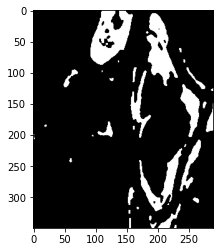

result of k means clustering
True Positive :  12526
True Negative :  84893
False Positive :  734
False Negative :  3339
the oceral error is :  4073
the percentage correct classification :  0.9597931034482758
kappa score :  0.8366823247620623
-----------------normal----------------
clustering image


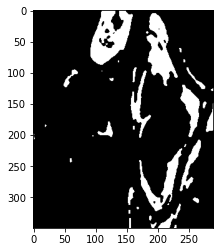

result of k means clustering
True Positive :  12448
True Negative :  84916
False Positive :  711
False Negative :  3417
the oceral error is :  4128
the percentage correct classification :  0.9592512315270936
kappa score :  0.8340201768385325
-----------------------------------------------------------
alpha is :  0.9
median kernel is :  7
-----------------gaussina----------------
clustering image


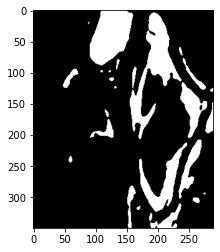

result of k means clustering
True Positive :  14886
True Negative :  82991
False Positive :  2636
False Negative :  979
the oceral error is :  3615
the percentage correct classification :  0.9643054187192118
kappa score :  0.8702435948127374
-----------------bilteral----------------
clustering image


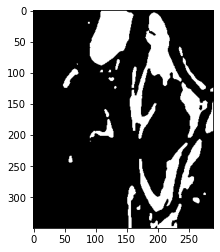

result of k means clustering
True Positive :  14942
True Negative :  82820
False Positive :  2807
False Negative :  923
the oceral error is :  3730
the percentage correct classification :  0.9631724137931035
kappa score :  0.8668688199319107
-----------------normal----------------
clustering image


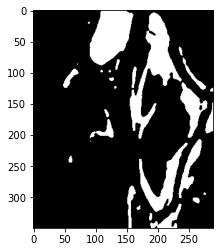

result of k means clustering
True Positive :  14915
True Negative :  82898
False Positive :  2729
False Negative :  950
the oceral error is :  3679
the percentage correct classification :  0.9636748768472907
kappa score :  0.8683468292024012
-----------------------------------------------------------
alpha is :  0.95
median kernel is :  7
-----------------gaussina----------------
clustering image


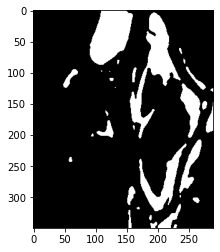

result of k means clustering
True Positive :  14394
True Negative :  83827
False Positive :  1800
False Negative :  1471
the oceral error is :  3271
the percentage correct classification :  0.9676945812807882
kappa score :  0.8785920449257771
-----------------bilteral----------------
clustering image


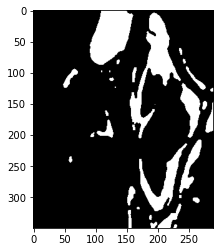

result of k means clustering
True Positive :  14517
True Negative :  83681
False Positive :  1946
False Negative :  1348
the oceral error is :  3294
the percentage correct classification :  0.9674679802955665
kappa score :  0.8785747664583612
-----------------normal----------------
clustering image


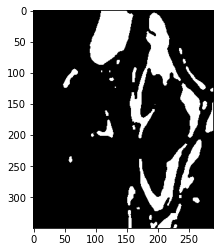

result of k means clustering
True Positive :  14480
True Negative :  83752
False Positive :  1875
False Negative :  1385
the oceral error is :  3260
the percentage correct classification :  0.9678029556650246
kappa score :  0.8794961219829839
-----------------------------------------------------------
alpha is :  1
median kernel is :  7
-----------------gaussina----------------
clustering image


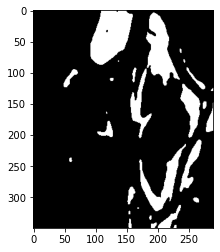

result of k means clustering
True Positive :  13905
True Negative :  84257
False Positive :  1370
False Negative :  1960
the oceral error is :  3330
the percentage correct classification :  0.9671133004926108
kappa score :  0.8734445459813086
-----------------bilteral----------------
clustering image


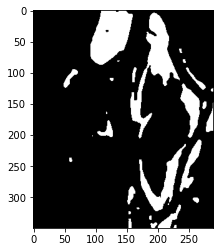

result of k means clustering
True Positive :  14002
True Negative :  84187
False Positive :  1440
False Negative :  1863
the oceral error is :  3303
the percentage correct classification :  0.9673793103448276
kappa score :  0.875015370718242
-----------------normal----------------
clustering image


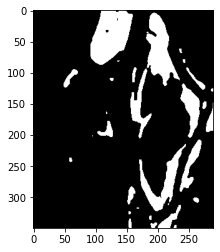

result of k means clustering
True Positive :  13960
True Negative :  84231
False Positive :  1396
False Negative :  1905
the oceral error is :  3301
the percentage correct classification :  0.9673990147783251
kappa score :  0.8748082848978471
-----------------------------------------------------------
alpha is :  1.05
median kernel is :  7
-----------------gaussina----------------
clustering image


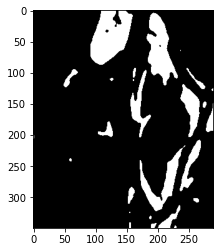

result of k means clustering
True Positive :  13184
True Negative :  84585
False Positive :  1042
False Negative :  2681
the oceral error is :  3723
the percentage correct classification :  0.9632413793103448
kappa score :  0.8545613373469398
-----------------bilteral----------------
clustering image


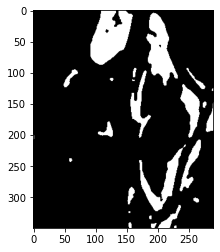

result of k means clustering
True Positive :  13184
True Negative :  84581
False Positive :  1046
False Negative :  2681
the oceral error is :  3727
the percentage correct classification :  0.9632019704433498
kappa score :  0.8544210142493784
-----------------normal----------------
clustering image


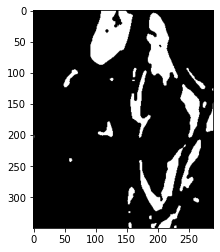

result of k means clustering
True Positive :  13125
True Negative :  84628
False Positive :  999
False Negative :  2740
the oceral error is :  3739
the percentage correct classification :  0.9630837438423645
kappa score :  0.8535373861096589
-----------------------------------------------------------
alpha is :  1.1
median kernel is :  7
-----------------gaussina----------------
clustering image


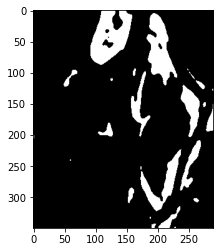

result of k means clustering
True Positive :  12177
True Negative :  84947
False Positive :  680
False Negative :  3688
the oceral error is :  4368
the percentage correct classification :  0.9568866995073891
kappa score :  0.8229186847579181
-----------------bilteral----------------
clustering image


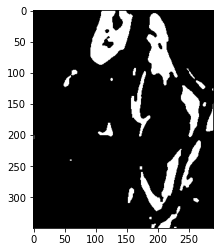

result of k means clustering
True Positive :  12095
True Negative :  84958
False Positive :  669
False Negative :  3770
the oceral error is :  4439
the percentage correct classification :  0.9561871921182266
kappa score :  0.8195738541018135
-----------------normal----------------
clustering image


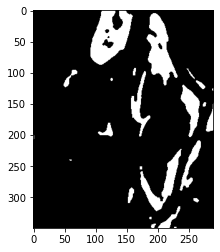

result of k means clustering
True Positive :  12160
True Negative :  84948
False Positive :  679
False Negative :  3705
the oceral error is :  4384
the percentage correct classification :  0.9567290640394088
kappa score :  0.8221821993492009
-----------------------------------------------------------
alpha is :  0.9
median kernel is :  9
-----------------gaussina----------------
clustering image


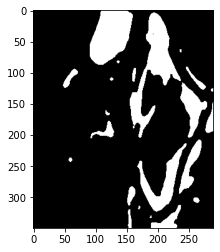

result of k means clustering
True Positive :  14563
True Negative :  82940
False Positive :  2687
False Negative :  1302
the oceral error is :  3989
the percentage correct classification :  0.9606206896551724
kappa score :  0.8558768528713905
-----------------bilteral----------------
clustering image


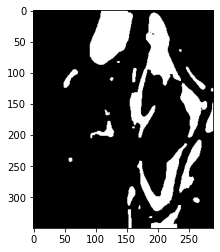

result of k means clustering
True Positive :  14540
True Negative :  82966
False Positive :  2661
False Negative :  1325
the oceral error is :  3986
the percentage correct classification :  0.9606502463054187
kappa score :  0.8558099272633
-----------------normal----------------
clustering image


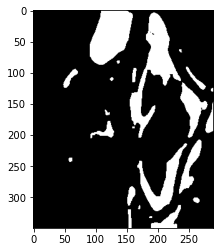

result of k means clustering
True Positive :  14565
True Negative :  82923
False Positive :  2704
False Negative :  1300
the oceral error is :  4004
the percentage correct classification :  0.9604729064039409
kappa score :  0.8554040720951409
-----------------------------------------------------------
alpha is :  0.95
median kernel is :  9
-----------------gaussina----------------
clustering image


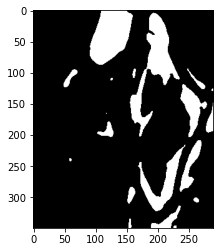

result of k means clustering
True Positive :  13862
True Negative :  83879
False Positive :  1748
False Negative :  2003
the oceral error is :  3751
the percentage correct classification :  0.9629655172413794
kappa score :  0.8587126328411145
-----------------bilteral----------------
clustering image


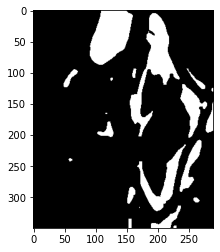

result of k means clustering
True Positive :  13970
True Negative :  83791
False Positive :  1836
False Negative :  1895
the oceral error is :  3731
the percentage correct classification :  0.9631625615763547
kappa score :  0.860172360870693
-----------------normal----------------
clustering image


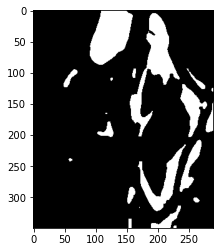

result of k means clustering
True Positive :  13934
True Negative :  83844
False Positive :  1783
False Negative :  1931
the oceral error is :  3714
the percentage correct classification :  0.9633300492610838
kappa score :  0.8604889653283244
-----------------------------------------------------------
alpha is :  1
median kernel is :  9
-----------------gaussina----------------
clustering image


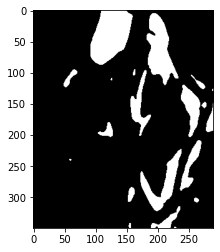

result of k means clustering
True Positive :  13365
True Negative :  84297
False Positive :  1330
False Negative :  2500
the oceral error is :  3830
the percentage correct classification :  0.9621871921182266
kappa score :  0.8522469479480581
-----------------bilteral----------------
clustering image


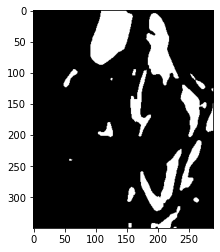

result of k means clustering
True Positive :  13420
True Negative :  84263
False Positive :  1364
False Negative :  2445
the oceral error is :  3809
the percentage correct classification :  0.9623940886699507
kappa score :  0.8534044916642324
-----------------normal----------------
clustering image


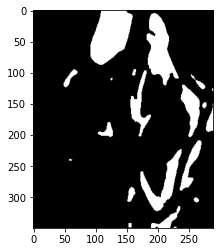

result of k means clustering
True Positive :  13384
True Negative :  84303
False Positive :  1324
False Negative :  2481
the oceral error is :  3805
the percentage correct classification :  0.9624334975369458
kappa score :  0.8532637394448741
-----------------------------------------------------------
alpha is :  1.05
median kernel is :  9
-----------------gaussina----------------
clustering image


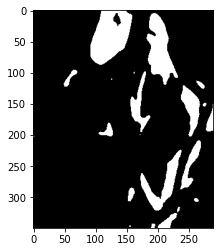

result of k means clustering
True Positive :  12648
True Negative :  84604
False Positive :  1023
False Negative :  3217
the oceral error is :  4240
the percentage correct classification :  0.9581477832512315
kappa score :  0.8319086254895195
-----------------bilteral----------------
clustering image


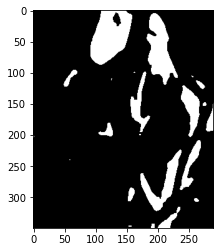

result of k means clustering
True Positive :  12637
True Negative :  84614
False Positive :  1013
False Negative :  3228
the oceral error is :  4241
the percentage correct classification :  0.9581379310344827
kappa score :  0.8317729768725299
-----------------normal----------------
clustering image


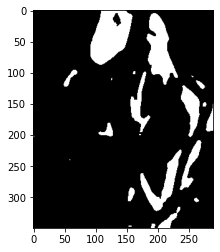

result of k means clustering
True Positive :  12697
True Negative :  84600
False Positive :  1027
False Negative :  3168
the oceral error is :  4195
the percentage correct classification :  0.9585911330049262
kappa score :  0.8339286325660143
-----------------------------------------------------------
alpha is :  1.1
median kernel is :  9
-----------------gaussina----------------
clustering image


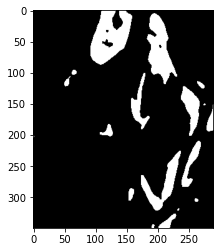

result of k means clustering
True Positive :  11697
True Negative :  84918
False Positive :  709
False Negative :  4168
the oceral error is :  4877
the percentage correct classification :  0.951871921182266
kappa score :  0.7997932123142268
-----------------bilteral----------------
clustering image


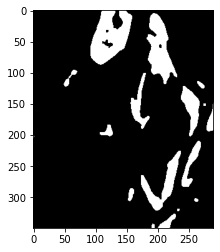

result of k means clustering
True Positive :  11791
True Negative :  84907
False Positive :  720
False Negative :  4074
the oceral error is :  4794
the percentage correct classification :  0.9526896551724138
kappa score :  0.8037807713395942
-----------------normal----------------
clustering image


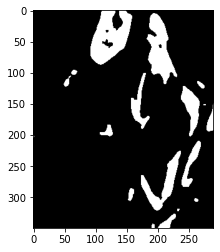

result of k means clustering
True Positive :  11707
True Negative :  84925
False Positive :  702
False Negative :  4158
the oceral error is :  4860
the percentage correct classification :  0.9520394088669951
kappa score :  0.8005124173714553
result for gauusian


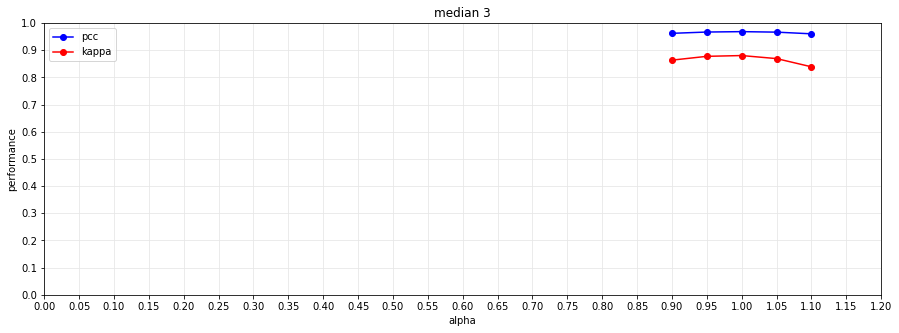

***********************
max pcc is :  0.9682167487684729
max kaapa score is :  0.8802374518781885
***********************
     ---------------------------------------------------------------------------------------------------------------


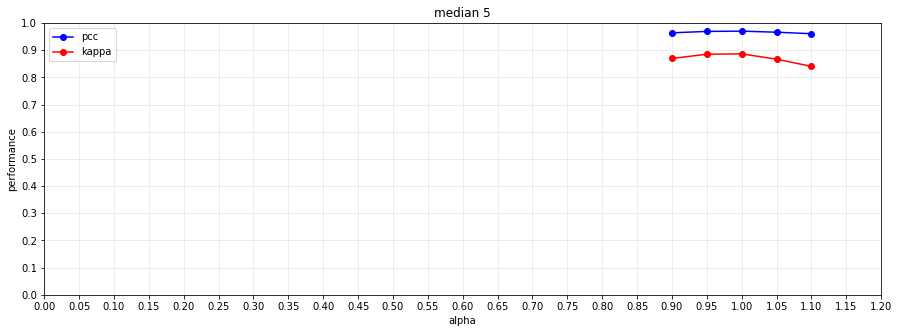

***********************
max pcc is :  0.9700492610837439
max kaapa score is :  0.8863012219765851
***********************
     ---------------------------------------------------------------------------------------------------------------


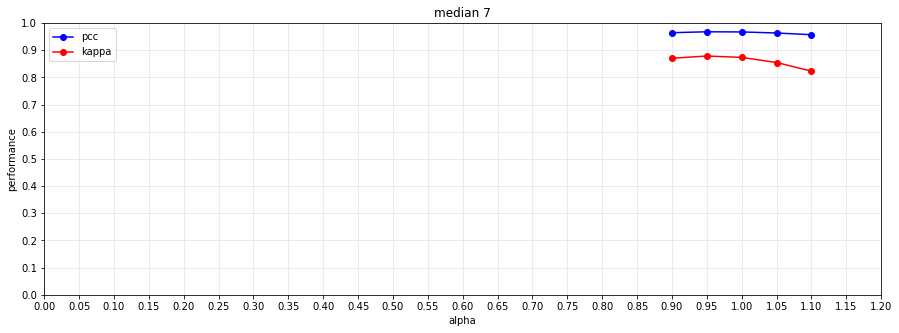

***********************
max pcc is :  0.9676945812807882
max kaapa score is :  0.8785920449257771
***********************
     ---------------------------------------------------------------------------------------------------------------


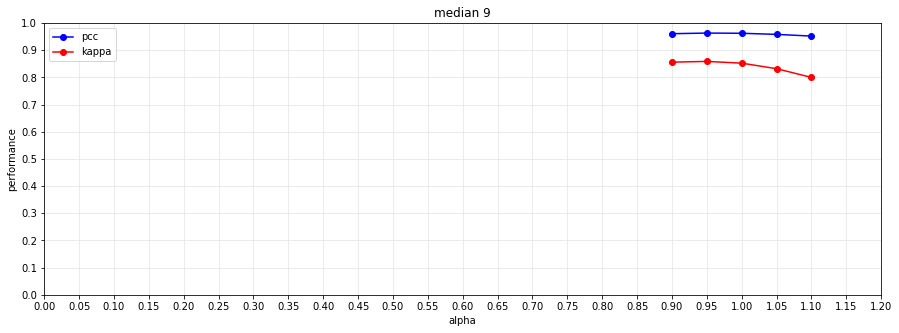

***********************
max pcc is :  0.9629655172413794
max kaapa score is :  0.8587126328411145
***********************
     ---------------------------------------------------------------------------------------------------------------
result for bilateral


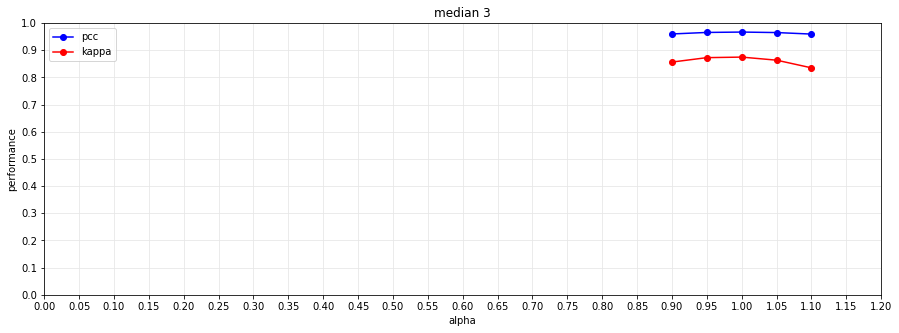

***********************
max pcc is :  0.9666502463054187
max kaapa score is :  0.8745299997192151
***********************
     ---------------------------------------------------------------------------------------------------------------


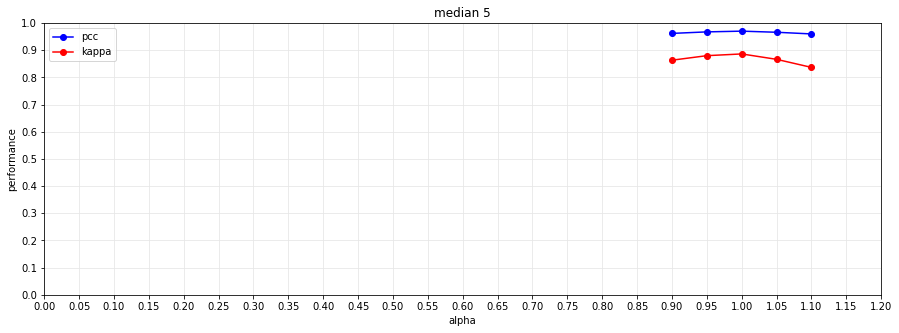

***********************
max pcc is :  0.9700197044334975
max kaapa score is :  0.8861802416710486
***********************
     ---------------------------------------------------------------------------------------------------------------


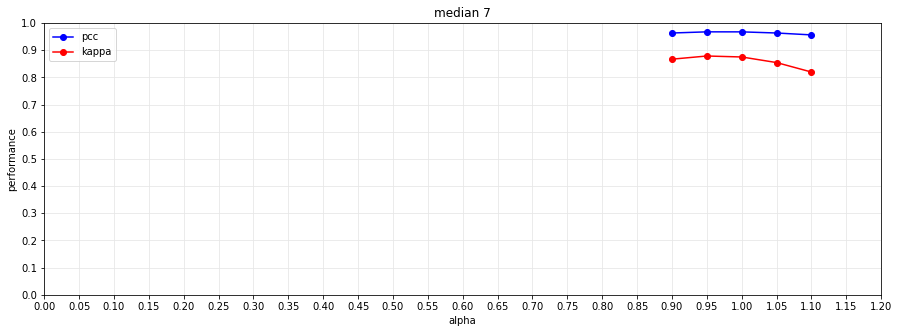

***********************
max pcc is :  0.9674679802955665
max kaapa score is :  0.8785747664583612
***********************
     ---------------------------------------------------------------------------------------------------------------


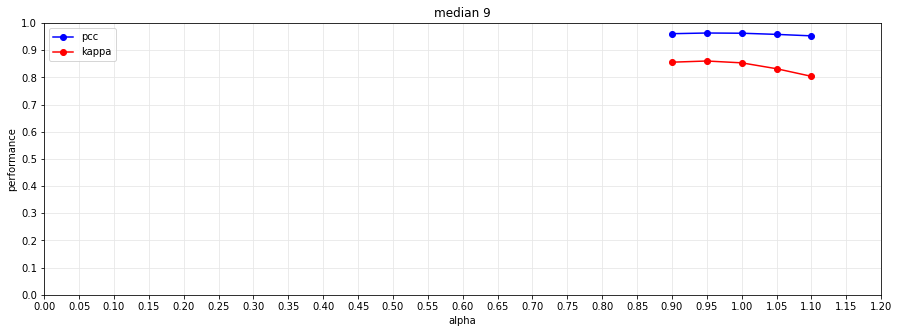

***********************
max pcc is :  0.9631625615763547
max kaapa score is :  0.860172360870693
***********************
     ---------------------------------------------------------------------------------------------------------------
result for normal


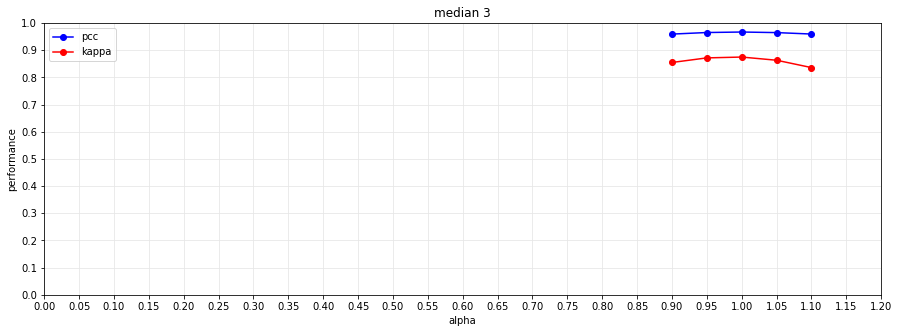

***********************
max pcc is :  0.966807881773399
max kaapa score is :  0.8747081087887096
***********************
     ---------------------------------------------------------------------------------------------------------------


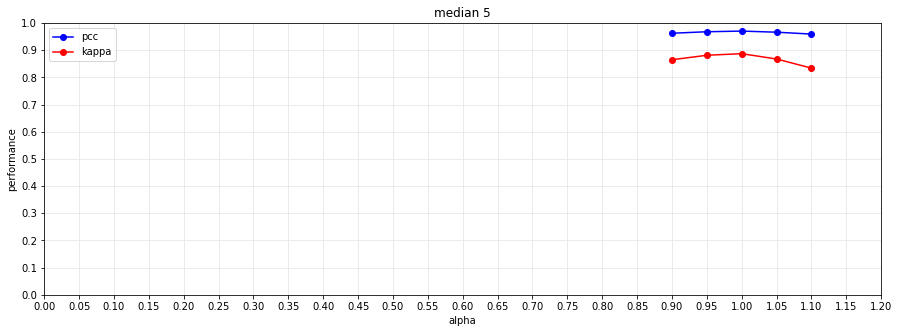

***********************
max pcc is :  0.9702167487684729
max kaapa score is :  0.8871314315372869
***********************
     ---------------------------------------------------------------------------------------------------------------


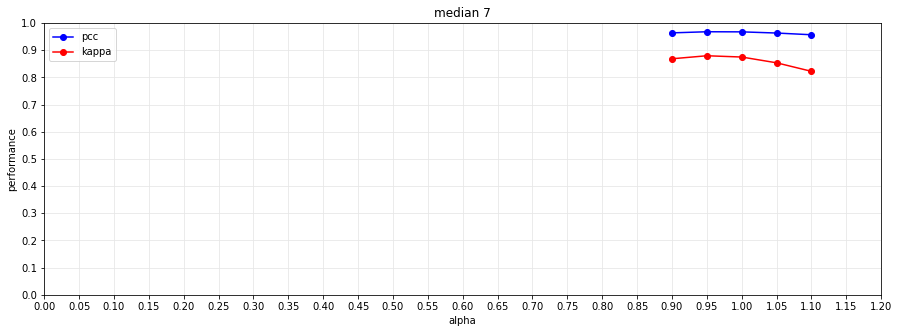

***********************
max pcc is :  0.9678029556650246
max kaapa score is :  0.8794961219829839
***********************
     ---------------------------------------------------------------------------------------------------------------


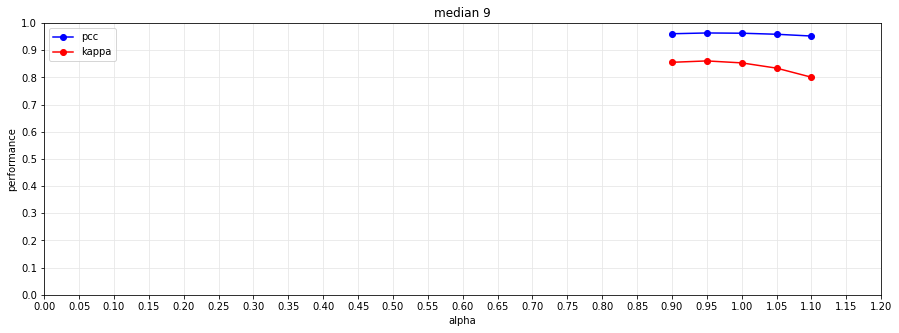

***********************
max pcc is :  0.9633300492610838
max kaapa score is :  0.8604889653283244
***********************
     ---------------------------------------------------------------------------------------------------------------


In [734]:

alpha_set = [ 0.9, 0.95, 1 , 1.05, 1.1 ]
median_kernel=[3,5,7,9]

gs_pcc1=[]
gs_kappa1=[]
bi_pcc1=[]
bi_kappa1=[]
nor_pcc1=[]
nor_kappa1=[]


for kernel in median_kernel:
  for alpha in alpha_set:
    temp_gs_pcc1, temp_gs_kappa1, temp_bi_pcc1, temp_bi_kappa1, temp_nor_pcc1, temp_nor_kappa1 =combined2(data1_img1, data1_img2 ,im_gt ,alpha, kernel,3,5,  2,'k-means++' , 500, False)

    gs_pcc1.append(temp_gs_pcc1)
    gs_kappa1.append(temp_gs_kappa1)
    bi_pcc1.append(temp_bi_pcc1)
    bi_kappa1.append(temp_bi_kappa1)
    nor_pcc1.append(temp_nor_pcc1)
    nor_kappa1.append(temp_nor_kappa1)

print('result for gauusian')
alpha_plotter(alpha_set,median_kernel, gs_pcc1, gs_kappa1)
print('result for bilateral')
alpha_plotter(alpha_set,median_kernel, bi_pcc1, bi_kappa1)

print('result for normal')
alpha_plotter(alpha_set,median_kernel, nor_pcc1, nor_kappa1)



In [724]:

def combined3(img1 , img2 ,ground_truth, alpha, median_kernel,gs_kernel, bi_kernel,  ncls, init, max_iter, plotter):

  
  img1_mean = cv2.blur(img1, (3,3))
  img2_mean = cv2.blur(img2, (3,3))


  mean_ratio= img1_mean.copy()
  for i in range(img1_mean.shape[0]):
    for j in range(img1_mean.shape[1]):
      mean_ratio[i][j]= (1 - np.minimum( img1_mean[i][j]/img2_mean[i][j]  , img2_mean[i][j]/img1_mean[i][j]  ))*255


  subtraction= np.abs(img1 - img2)

  
  combined = (alpha * mean_ratio ) + ((1 - alpha) * subtraction)


  final = combined.copy()
  for i in range(combined.shape[0]):
    for j in range(combined.shape[1]):
      if combined[i][j] <= 0 :
        final[i][j] = -combined[i][j]
      else:
        final[i][j] = combined[i][j]
  final.astype('uint8')



  median_result_bilateral = cv2.bilateralFilter(final.astype('uint8'),bi_kernel,15,15)
  
  median = cv2.medianBlur(median_result_bilateral,median_kernel)
    
  median_result_gaussina = cv2.GaussianBlur(mean_ratio,(gs_kernel,gs_kernel),0)

    
    




  median_3channels = cv2.cvtColor(median.astype('uint8'), cv2.COLOR_GRAY2BGR)

  median_3channels_gaussina = cv2.cvtColor(median_result_gaussina.astype('uint8'), cv2.COLOR_GRAY2BGR)
  median_3channels_bilateral = cv2.cvtColor(median_result_bilateral.astype('uint8'), cv2.COLOR_GRAY2BGR)

  
  print('-----------------------------------------------------------')
  print('alpha is : ',alpha)
  print('median kernel is : ',median_kernel)
  
  if plotter:
    fig= plt.figure(figsize=(7, 20))
    ax1 = fig.add_subplot(421)
    ax2 = fig.add_subplot(422)
    ax3 = fig.add_subplot(423)
    ax4 = fig.add_subplot(424)
    ax5 = fig.add_subplot(425)
    ax6 = fig.add_subplot(426)



    ax1.imshow(img1_mean, cmap='gray')
    ax1.set_title('img1 mean')
    ax1.axis('off')

    ax2.imshow(img2_mean, cmap='gray')
    ax2.set_title('img2 mean')
    ax2.axis('off')

    ax3.imshow(mean_ratio, cmap='gray')
    ax3.set_title('mean ratio of 2 images')
    ax3.axis('off')

    ax4.imshow(subtraction, cmap='gray')
    ax4.set_title('subtraction of img1 and img2')
    ax4.axis('off')

    ax5.imshow(combined, cmap='gray')
    ax5.set_title('combined image')
    ax5.axis('off')

    ax6.imshow(median, cmap='gray')
    ax6.set_title('median image with kernel size of {} '.format(median_kernel) )
    ax6.axis('off')

    plt.show() 



    
  print('-----------------gaussina----------------')

  print('clustering image')
  gs_kmeans_result2= kmeans(median_3channels_gaussina, ncls, init, max_iter )

  print('result of k means clustering')
  gs_tp,gs_tn,gs_fp,gs_fn,gs_pcc,gs_kappa = results(ground_truth, gs_kmeans_result2)
    
    
  print('-----------------bilteral----------------')
  print('clustering image')
  bi_kmeans_result3= kmeans(median_3channels_bilateral, ncls, init, max_iter )

  print('result of k means clustering')
  bi_tp,bi_tn,bi_fp,bi_fn,bi_pcc,bi_kappa = results(ground_truth, bi_kmeans_result3)

  print('-----------------normal----------------')

  print('clustering image')
  nor_kmeans_result= kmeans(median_3channels, ncls, init, max_iter )

  print('result of k means clustering')
  nor_tp,nor_tn,nor_fp,nor_fn,nor_pcc,nor_kappa = results(ground_truth, nor_kmeans_result)

  return gs_pcc, gs_kappa, bi_pcc, bi_kappa, nor_pcc, nor_kappa

<ipython-input-724-bd18934bbaa9>:11: RuntimeWarning: invalid value encountered in ubyte_scalars
  mean_ratio[i][j]= (1 - np.minimum( img1_mean[i][j]/img2_mean[i][j]  , img2_mean[i][j]/img1_mean[i][j]  ))*255


-----------------------------------------------------------
alpha is :  0.95
median kernel is :  3
-----------------gaussina----------------
clustering image


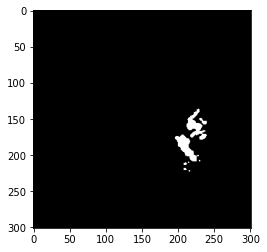

result of k means clustering
True Positive :  914
True Negative :  89382
False Positive :  143
False Negative :  162
the oceral error is :  305
the percentage correct classification :  0.9966335912407148
kappa score :  0.8553057903451327
-----------------bilteral----------------
clustering image


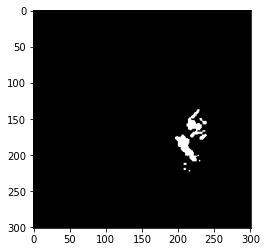

result of k means clustering
True Positive :  874
True Negative :  89438
False Positive :  87
False Negative :  202
the oceral error is :  289
the percentage correct classification :  0.9968101897330052
kappa score :  0.8565168543050922
-----------------normal----------------
clustering image


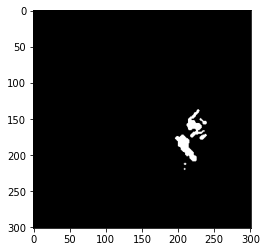

result of k means clustering
True Positive :  863
True Negative :  89439
False Positive :  86
False Negative :  213
the oceral error is :  299
the percentage correct classification :  0.9966998156753236
kappa score :  0.850683575595631


<ipython-input-724-bd18934bbaa9>:11: RuntimeWarning: invalid value encountered in ubyte_scalars
  mean_ratio[i][j]= (1 - np.minimum( img1_mean[i][j]/img2_mean[i][j]  , img2_mean[i][j]/img1_mean[i][j]  ))*255


-----------------------------------------------------------
alpha is :  1
median kernel is :  3
-----------------gaussina----------------
clustering image


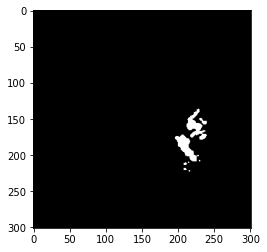

result of k means clustering
True Positive :  914
True Negative :  89382
False Positive :  143
False Negative :  162
the oceral error is :  305
the percentage correct classification :  0.9966335912407148
kappa score :  0.8553057903451327
-----------------bilteral----------------
clustering image


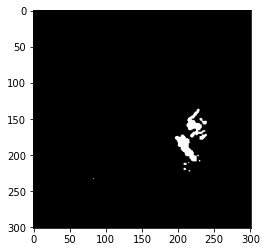

result of k means clustering
True Positive :  891
True Negative :  89410
False Positive :  115
False Negative :  185
the oceral error is :  300
the percentage correct classification :  0.9966887782695555
kappa score :  0.8542348413818535
-----------------normal----------------
clustering image


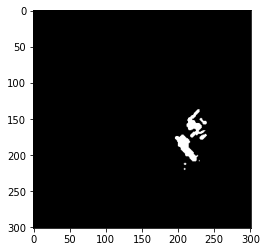

result of k means clustering
True Positive :  885
True Negative :  89415
False Positive :  110
False Negative :  191
the oceral error is :  301
the percentage correct classification :  0.9966777408637874
kappa score :  0.852981850338409


<ipython-input-724-bd18934bbaa9>:11: RuntimeWarning: invalid value encountered in ubyte_scalars
  mean_ratio[i][j]= (1 - np.minimum( img1_mean[i][j]/img2_mean[i][j]  , img2_mean[i][j]/img1_mean[i][j]  ))*255


-----------------------------------------------------------
alpha is :  1.05
median kernel is :  3
-----------------gaussina----------------
clustering image


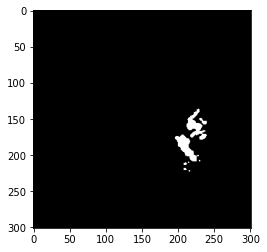

result of k means clustering
True Positive :  914
True Negative :  89382
False Positive :  143
False Negative :  162
the oceral error is :  305
the percentage correct classification :  0.9966335912407148
kappa score :  0.8553057903451327
-----------------bilteral----------------
clustering image


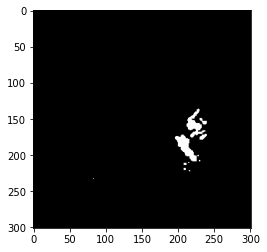

result of k means clustering
True Positive :  889
True Negative :  89410
False Positive :  115
False Negative :  187
the oceral error is :  302
the percentage correct classification :  0.9966667034580192
kappa score :  0.8531237342279868
-----------------normal----------------
clustering image


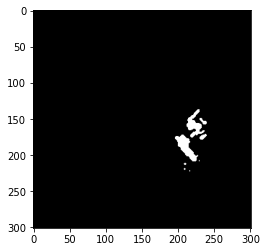

result of k means clustering
True Positive :  892
True Negative :  89417
False Positive :  108
False Negative :  184
the oceral error is :  292
the percentage correct classification :  0.9967770775157007
kappa score :  0.8577169665922532


<ipython-input-724-bd18934bbaa9>:11: RuntimeWarning: invalid value encountered in ubyte_scalars
  mean_ratio[i][j]= (1 - np.minimum( img1_mean[i][j]/img2_mean[i][j]  , img2_mean[i][j]/img1_mean[i][j]  ))*255


-----------------------------------------------------------
alpha is :  1.1
median kernel is :  3
-----------------gaussina----------------
clustering image


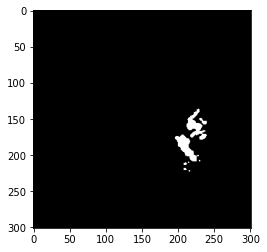

result of k means clustering
True Positive :  914
True Negative :  89382
False Positive :  143
False Negative :  162
the oceral error is :  305
the percentage correct classification :  0.9966335912407148
kappa score :  0.8553057903451327
-----------------bilteral----------------
clustering image


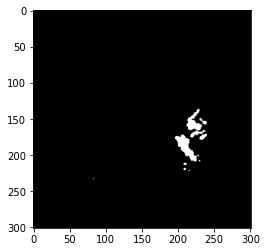

result of k means clustering
True Positive :  875
True Negative :  89427
False Positive :  98
False Negative :  201
the oceral error is :  299
the percentage correct classification :  0.9966998156753236
kappa score :  0.8524104595390601
-----------------normal----------------
clustering image


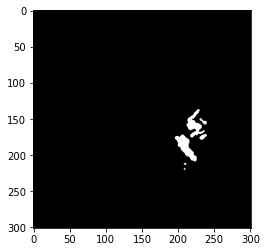

result of k means clustering
True Positive :  864
True Negative :  89426
False Positive :  99
False Negative :  212
the oceral error is :  311
the percentage correct classification :  0.9965673668061059
kappa score :  0.8457437944090536


<ipython-input-724-bd18934bbaa9>:11: RuntimeWarning: invalid value encountered in ubyte_scalars
  mean_ratio[i][j]= (1 - np.minimum( img1_mean[i][j]/img2_mean[i][j]  , img2_mean[i][j]/img1_mean[i][j]  ))*255


-----------------------------------------------------------
alpha is :  0.95
median kernel is :  5
-----------------gaussina----------------
clustering image


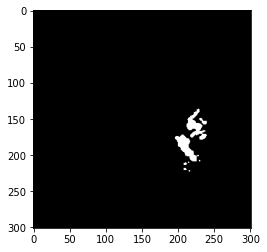

result of k means clustering
True Positive :  914
True Negative :  89382
False Positive :  143
False Negative :  162
the oceral error is :  305
the percentage correct classification :  0.9966335912407148
kappa score :  0.8553057903451327
-----------------bilteral----------------
clustering image


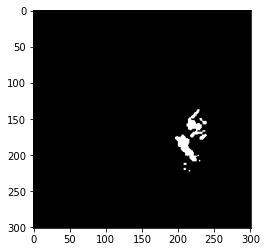

result of k means clustering
True Positive :  874
True Negative :  89438
False Positive :  87
False Negative :  202
the oceral error is :  289
the percentage correct classification :  0.9968101897330052
kappa score :  0.8565168543050922
-----------------normal----------------
clustering image


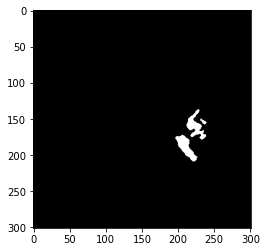

result of k means clustering
True Positive :  845
True Negative :  89416
False Positive :  109
False Negative :  231
the oceral error is :  340
the percentage correct classification :  0.9962472820388296
kappa score :  0.8306216285875072


<ipython-input-724-bd18934bbaa9>:11: RuntimeWarning: invalid value encountered in ubyte_scalars
  mean_ratio[i][j]= (1 - np.minimum( img1_mean[i][j]/img2_mean[i][j]  , img2_mean[i][j]/img1_mean[i][j]  ))*255


-----------------------------------------------------------
alpha is :  1
median kernel is :  5
-----------------gaussina----------------
clustering image


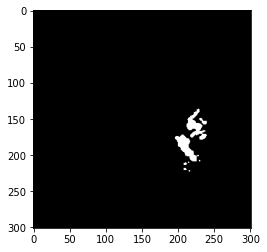

result of k means clustering
True Positive :  914
True Negative :  89382
False Positive :  143
False Negative :  162
the oceral error is :  305
the percentage correct classification :  0.9966335912407148
kappa score :  0.8553057903451327
-----------------bilteral----------------
clustering image


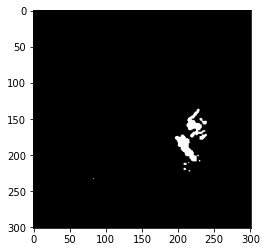

result of k means clustering
True Positive :  891
True Negative :  89410
False Positive :  115
False Negative :  185
the oceral error is :  300
the percentage correct classification :  0.9966887782695555
kappa score :  0.8542348413818535
-----------------normal----------------
clustering image


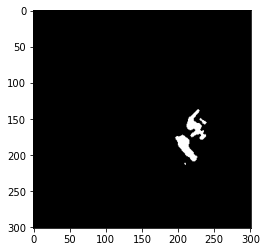

result of k means clustering
True Positive :  861
True Negative :  89403
False Positive :  122
False Negative :  215
the oceral error is :  337
the percentage correct classification :  0.996280394256134
kappa score :  0.8344510178201519


<ipython-input-724-bd18934bbaa9>:11: RuntimeWarning: invalid value encountered in ubyte_scalars
  mean_ratio[i][j]= (1 - np.minimum( img1_mean[i][j]/img2_mean[i][j]  , img2_mean[i][j]/img1_mean[i][j]  ))*255


-----------------------------------------------------------
alpha is :  1.05
median kernel is :  5
-----------------gaussina----------------
clustering image


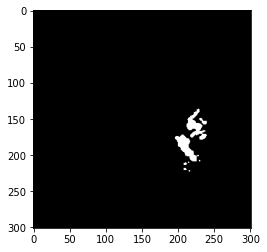

result of k means clustering
True Positive :  914
True Negative :  89382
False Positive :  143
False Negative :  162
the oceral error is :  305
the percentage correct classification :  0.9966335912407148
kappa score :  0.8553057903451327
-----------------bilteral----------------
clustering image


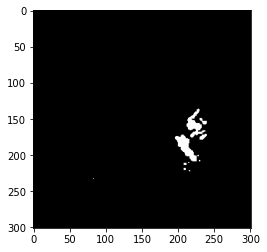

result of k means clustering
True Positive :  889
True Negative :  89410
False Positive :  115
False Negative :  187
the oceral error is :  302
the percentage correct classification :  0.9966667034580192
kappa score :  0.8531237342279868
-----------------normal----------------
clustering image


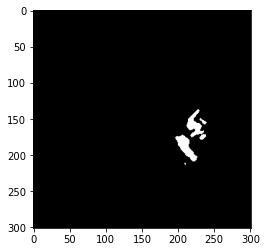

result of k means clustering
True Positive :  856
True Negative :  89413
False Positive :  112
False Negative :  220
the oceral error is :  332
the percentage correct classification :  0.9963355812849748
kappa score :  0.8357255050192209


<ipython-input-724-bd18934bbaa9>:11: RuntimeWarning: invalid value encountered in ubyte_scalars
  mean_ratio[i][j]= (1 - np.minimum( img1_mean[i][j]/img2_mean[i][j]  , img2_mean[i][j]/img1_mean[i][j]  ))*255


-----------------------------------------------------------
alpha is :  1.1
median kernel is :  5
-----------------gaussina----------------
clustering image


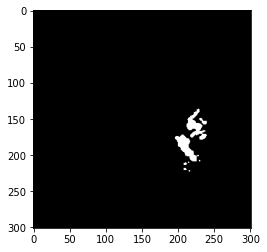

result of k means clustering
True Positive :  914
True Negative :  89382
False Positive :  143
False Negative :  162
the oceral error is :  305
the percentage correct classification :  0.9966335912407148
kappa score :  0.8553057903451327
-----------------bilteral----------------
clustering image


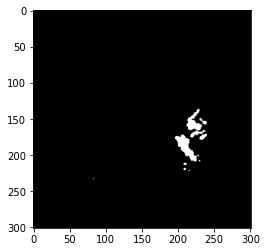

result of k means clustering
True Positive :  875
True Negative :  89427
False Positive :  98
False Negative :  201
the oceral error is :  299
the percentage correct classification :  0.9966998156753236
kappa score :  0.8524104595390601
-----------------normal----------------
clustering image


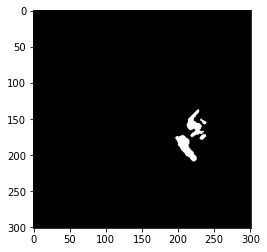

result of k means clustering
True Positive :  844
True Negative :  89420
False Positive :  105
False Negative :  232
the oceral error is :  337
the percentage correct classification :  0.996280394256134
kappa score :  0.8317069062733367


<ipython-input-724-bd18934bbaa9>:11: RuntimeWarning: invalid value encountered in ubyte_scalars
  mean_ratio[i][j]= (1 - np.minimum( img1_mean[i][j]/img2_mean[i][j]  , img2_mean[i][j]/img1_mean[i][j]  ))*255


-----------------------------------------------------------
alpha is :  0.95
median kernel is :  7
-----------------gaussina----------------
clustering image


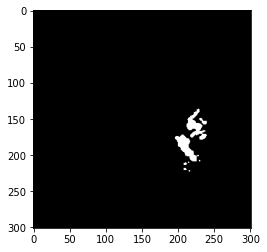

result of k means clustering
True Positive :  914
True Negative :  89382
False Positive :  143
False Negative :  162
the oceral error is :  305
the percentage correct classification :  0.9966335912407148
kappa score :  0.8553057903451327
-----------------bilteral----------------
clustering image


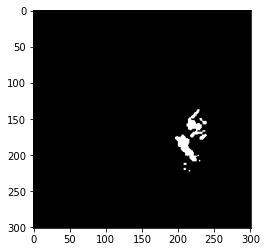

result of k means clustering
True Positive :  874
True Negative :  89438
False Positive :  87
False Negative :  202
the oceral error is :  289
the percentage correct classification :  0.9968101897330052
kappa score :  0.8565168543050922
-----------------normal----------------
clustering image


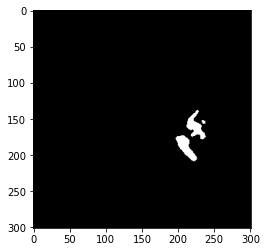

result of k means clustering
True Positive :  816
True Negative :  89385
False Positive :  140
False Negative :  260
the oceral error is :  400
the percentage correct classification :  0.9955850376927406
kappa score :  0.80092496360219


<ipython-input-724-bd18934bbaa9>:11: RuntimeWarning: invalid value encountered in ubyte_scalars
  mean_ratio[i][j]= (1 - np.minimum( img1_mean[i][j]/img2_mean[i][j]  , img2_mean[i][j]/img1_mean[i][j]  ))*255


-----------------------------------------------------------
alpha is :  1
median kernel is :  7
-----------------gaussina----------------
clustering image


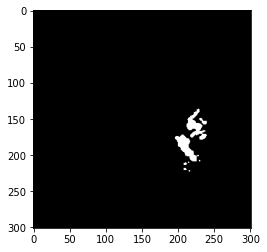

result of k means clustering
True Positive :  914
True Negative :  89382
False Positive :  143
False Negative :  162
the oceral error is :  305
the percentage correct classification :  0.9966335912407148
kappa score :  0.8553057903451327
-----------------bilteral----------------
clustering image


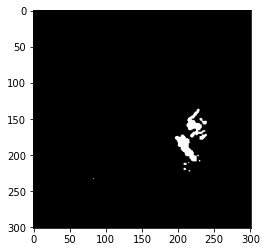

result of k means clustering
True Positive :  891
True Negative :  89410
False Positive :  115
False Negative :  185
the oceral error is :  300
the percentage correct classification :  0.9966887782695555
kappa score :  0.8542348413818535
-----------------normal----------------
clustering image


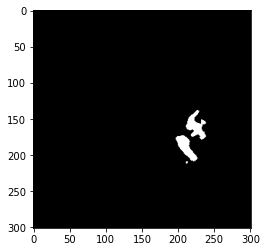

result of k means clustering
True Positive :  856
True Negative :  89338
False Positive :  187
False Negative :  220
the oceral error is :  407
the percentage correct classification :  0.9955077758523636
kappa score :  0.80565613656736


<ipython-input-724-bd18934bbaa9>:11: RuntimeWarning: invalid value encountered in ubyte_scalars
  mean_ratio[i][j]= (1 - np.minimum( img1_mean[i][j]/img2_mean[i][j]  , img2_mean[i][j]/img1_mean[i][j]  ))*255


-----------------------------------------------------------
alpha is :  1.05
median kernel is :  7
-----------------gaussina----------------
clustering image


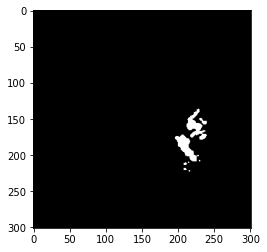

result of k means clustering
True Positive :  914
True Negative :  89382
False Positive :  143
False Negative :  162
the oceral error is :  305
the percentage correct classification :  0.9966335912407148
kappa score :  0.8553057903451327
-----------------bilteral----------------
clustering image


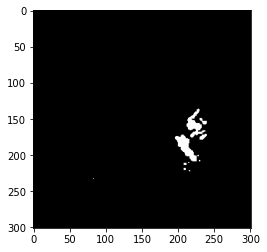

result of k means clustering
True Positive :  889
True Negative :  89410
False Positive :  115
False Negative :  187
the oceral error is :  302
the percentage correct classification :  0.9966667034580192
kappa score :  0.8531237342279868
-----------------normal----------------
clustering image


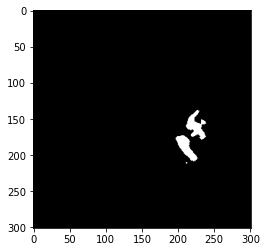

result of k means clustering
True Positive :  844
True Negative :  89348
False Positive :  177
False Negative :  232
the oceral error is :  409
the percentage correct classification :  0.9954857010408273
kappa score :  0.8026774784942184


<ipython-input-724-bd18934bbaa9>:11: RuntimeWarning: invalid value encountered in ubyte_scalars
  mean_ratio[i][j]= (1 - np.minimum( img1_mean[i][j]/img2_mean[i][j]  , img2_mean[i][j]/img1_mean[i][j]  ))*255


-----------------------------------------------------------
alpha is :  1.1
median kernel is :  7
-----------------gaussina----------------
clustering image


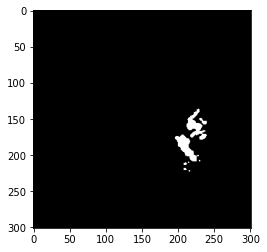

result of k means clustering
True Positive :  914
True Negative :  89382
False Positive :  143
False Negative :  162
the oceral error is :  305
the percentage correct classification :  0.9966335912407148
kappa score :  0.8553057903451327
-----------------bilteral----------------
clustering image


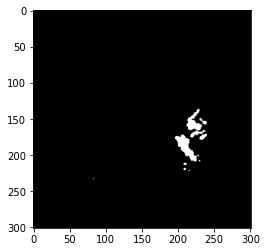

result of k means clustering
True Positive :  875
True Negative :  89427
False Positive :  98
False Negative :  201
the oceral error is :  299
the percentage correct classification :  0.9966998156753236
kappa score :  0.8524104595390601
-----------------normal----------------
clustering image


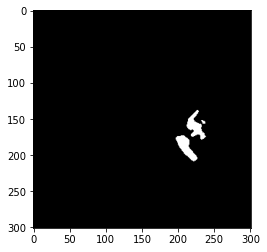

result of k means clustering
True Positive :  818
True Negative :  89382
False Positive :  143
False Negative :  258
the oceral error is :  401
the percentage correct classification :  0.9955740002869725
kappa score :  0.8009109293299029


<ipython-input-724-bd18934bbaa9>:11: RuntimeWarning: invalid value encountered in ubyte_scalars
  mean_ratio[i][j]= (1 - np.minimum( img1_mean[i][j]/img2_mean[i][j]  , img2_mean[i][j]/img1_mean[i][j]  ))*255


-----------------------------------------------------------
alpha is :  0.95
median kernel is :  9
-----------------gaussina----------------
clustering image


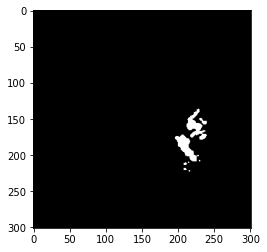

result of k means clustering
True Positive :  914
True Negative :  89382
False Positive :  143
False Negative :  162
the oceral error is :  305
the percentage correct classification :  0.9966335912407148
kappa score :  0.8553057903451327
-----------------bilteral----------------
clustering image


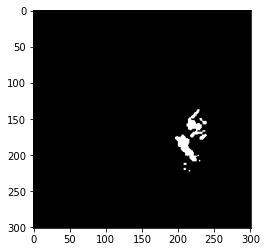

result of k means clustering
True Positive :  874
True Negative :  89438
False Positive :  87
False Negative :  202
the oceral error is :  289
the percentage correct classification :  0.9968101897330052
kappa score :  0.8565168543050922
-----------------normal----------------
clustering image


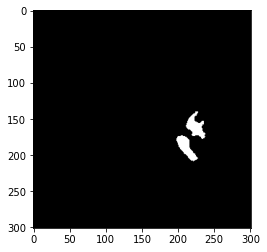

result of k means clustering
True Positive :  797
True Negative :  89342
False Positive :  183
False Negative :  279
the oceral error is :  462
the percentage correct classification :  0.9949007185351155
kappa score :  0.7727186135760399


<ipython-input-724-bd18934bbaa9>:11: RuntimeWarning: invalid value encountered in ubyte_scalars
  mean_ratio[i][j]= (1 - np.minimum( img1_mean[i][j]/img2_mean[i][j]  , img2_mean[i][j]/img1_mean[i][j]  ))*255


-----------------------------------------------------------
alpha is :  1
median kernel is :  9
-----------------gaussina----------------
clustering image


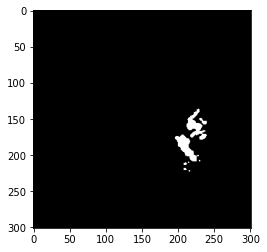

result of k means clustering
True Positive :  914
True Negative :  89382
False Positive :  143
False Negative :  162
the oceral error is :  305
the percentage correct classification :  0.9966335912407148
kappa score :  0.8553057903451327
-----------------bilteral----------------
clustering image


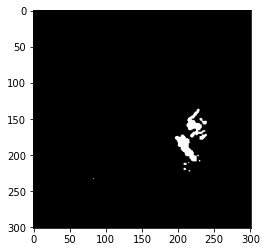

result of k means clustering
True Positive :  891
True Negative :  89410
False Positive :  115
False Negative :  185
the oceral error is :  300
the percentage correct classification :  0.9966887782695555
kappa score :  0.8542348413818535
-----------------normal----------------
clustering image


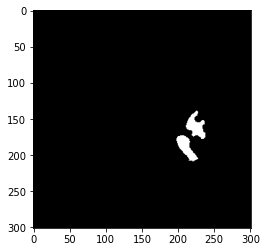

result of k means clustering
True Positive :  834
True Negative :  89308
False Positive :  217
False Negative :  242
the oceral error is :  459
the percentage correct classification :  0.9949338307524199
kappa score :  0.7816402894092477


<ipython-input-724-bd18934bbaa9>:11: RuntimeWarning: invalid value encountered in ubyte_scalars
  mean_ratio[i][j]= (1 - np.minimum( img1_mean[i][j]/img2_mean[i][j]  , img2_mean[i][j]/img1_mean[i][j]  ))*255


-----------------------------------------------------------
alpha is :  1.05
median kernel is :  9
-----------------gaussina----------------
clustering image


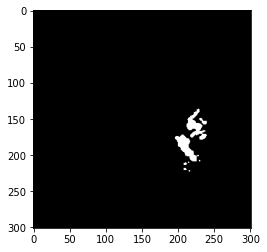

result of k means clustering
True Positive :  914
True Negative :  89382
False Positive :  143
False Negative :  162
the oceral error is :  305
the percentage correct classification :  0.9966335912407148
kappa score :  0.8553057903451327
-----------------bilteral----------------
clustering image


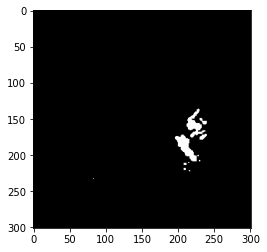

result of k means clustering
True Positive :  889
True Negative :  89410
False Positive :  115
False Negative :  187
the oceral error is :  302
the percentage correct classification :  0.9966667034580192
kappa score :  0.8531237342279868
-----------------normal----------------
clustering image


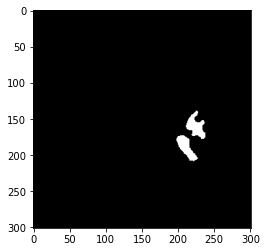

result of k means clustering
True Positive :  823
True Negative :  89316
False Positive :  209
False Negative :  253
the oceral error is :  462
the percentage correct classification :  0.9949007185351155
kappa score :  0.7782564008175115


<ipython-input-724-bd18934bbaa9>:11: RuntimeWarning: invalid value encountered in ubyte_scalars
  mean_ratio[i][j]= (1 - np.minimum( img1_mean[i][j]/img2_mean[i][j]  , img2_mean[i][j]/img1_mean[i][j]  ))*255


-----------------------------------------------------------
alpha is :  1.1
median kernel is :  9
-----------------gaussina----------------
clustering image


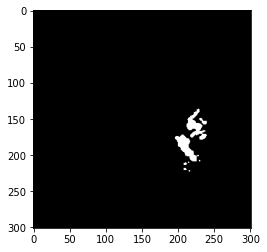

result of k means clustering
True Positive :  914
True Negative :  89382
False Positive :  143
False Negative :  162
the oceral error is :  305
the percentage correct classification :  0.9966335912407148
kappa score :  0.8553057903451327
-----------------bilteral----------------
clustering image


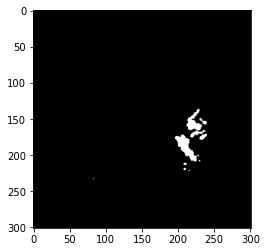

result of k means clustering
True Positive :  875
True Negative :  89427
False Positive :  98
False Negative :  201
the oceral error is :  299
the percentage correct classification :  0.9966998156753236
kappa score :  0.8524104595390601
-----------------normal----------------
clustering image


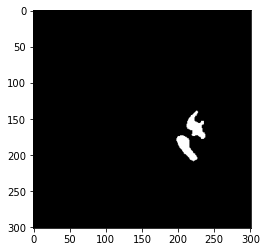

result of k means clustering
True Positive :  799
True Negative :  89343
False Positive :  182
False Negative :  277
the oceral error is :  459
the percentage correct classification :  0.9949338307524199
kappa score :  0.7743028613936398
result for gauusian


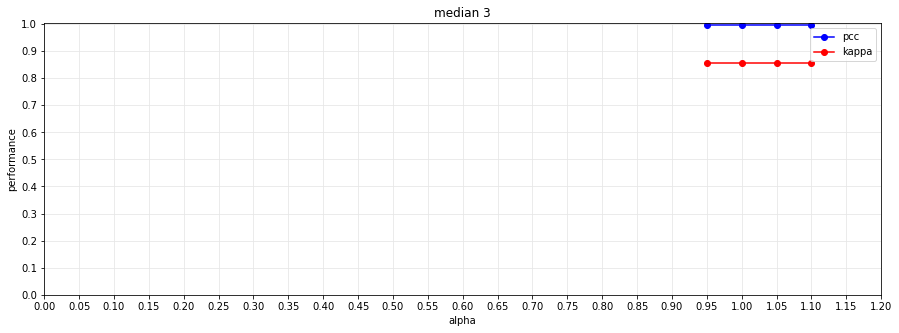

***********************
max pcc is :  0.9966335912407148
max kaapa score is :  0.8553057903451327
***********************
     ---------------------------------------------------------------------------------------------------------------


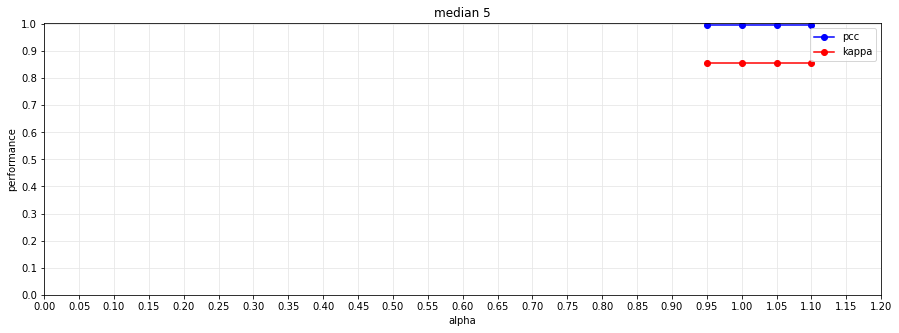

***********************
max pcc is :  0.9966335912407148
max kaapa score is :  0.8553057903451327
***********************
     ---------------------------------------------------------------------------------------------------------------


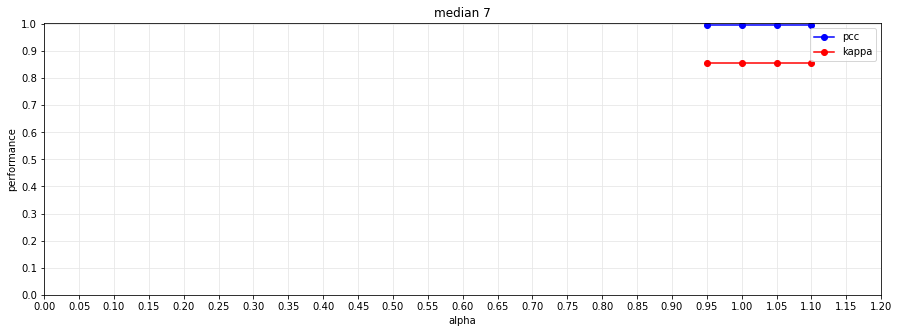

***********************
max pcc is :  0.9966335912407148
max kaapa score is :  0.8553057903451327
***********************
     ---------------------------------------------------------------------------------------------------------------


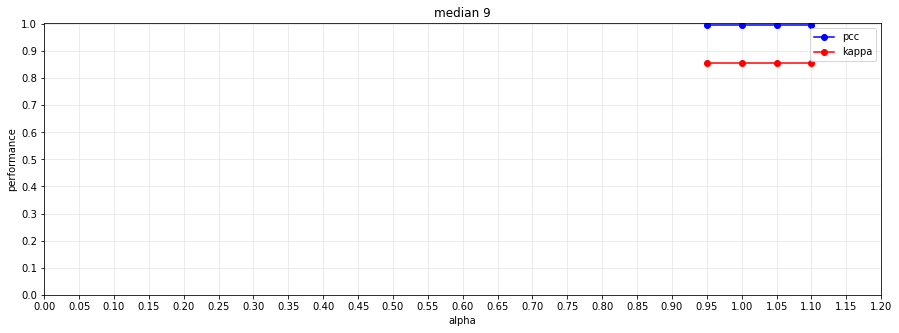

***********************
max pcc is :  0.9966335912407148
max kaapa score is :  0.8553057903451327
***********************
     ---------------------------------------------------------------------------------------------------------------
result for bilateral


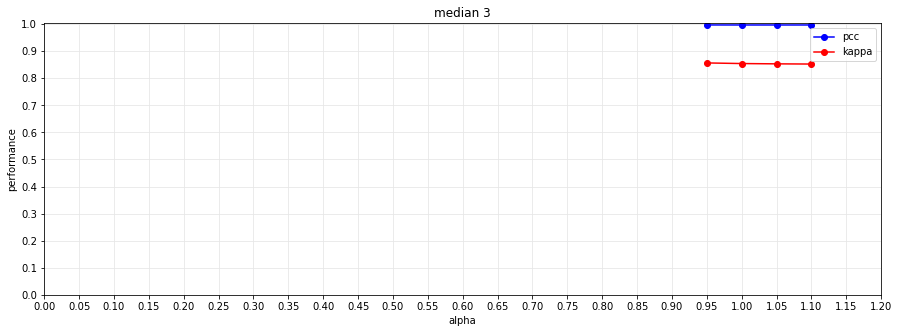

***********************
max pcc is :  0.9968101897330052
max kaapa score is :  0.8565168543050922
***********************
     ---------------------------------------------------------------------------------------------------------------


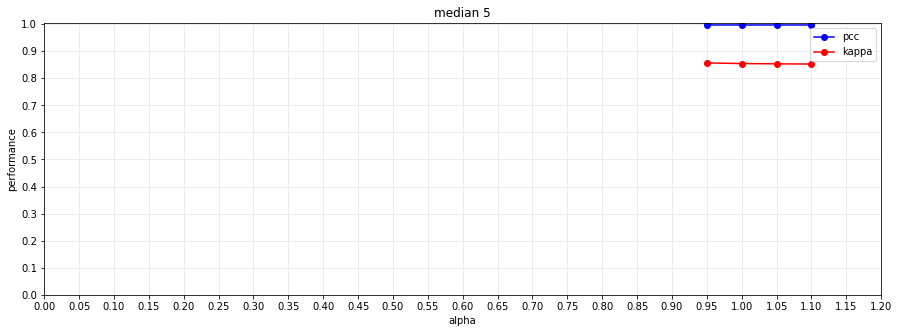

***********************
max pcc is :  0.9968101897330052
max kaapa score is :  0.8565168543050922
***********************
     ---------------------------------------------------------------------------------------------------------------


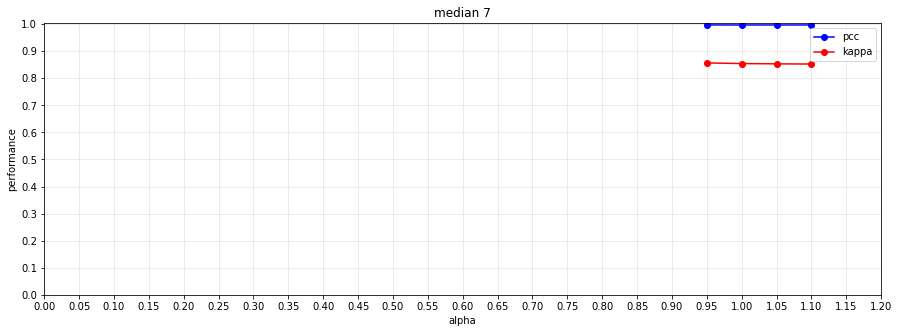

***********************
max pcc is :  0.9968101897330052
max kaapa score is :  0.8565168543050922
***********************
     ---------------------------------------------------------------------------------------------------------------


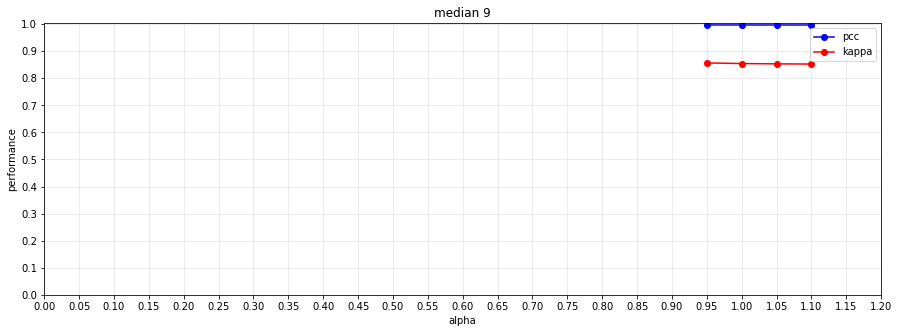

***********************
max pcc is :  0.9968101897330052
max kaapa score is :  0.8565168543050922
***********************
     ---------------------------------------------------------------------------------------------------------------
result for normal


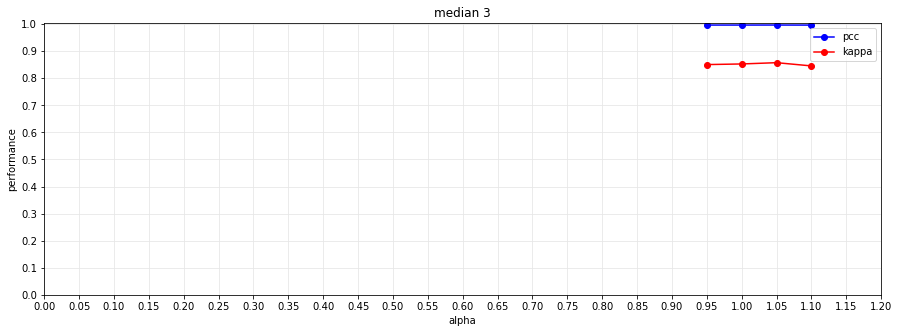

***********************
max pcc is :  0.9967770775157007
max kaapa score is :  0.8577169665922532
***********************
     ---------------------------------------------------------------------------------------------------------------


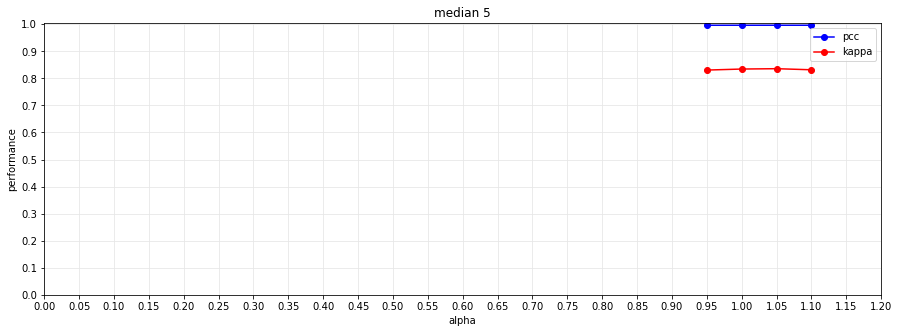

***********************
max pcc is :  0.9963355812849748
max kaapa score is :  0.8357255050192209
***********************
     ---------------------------------------------------------------------------------------------------------------


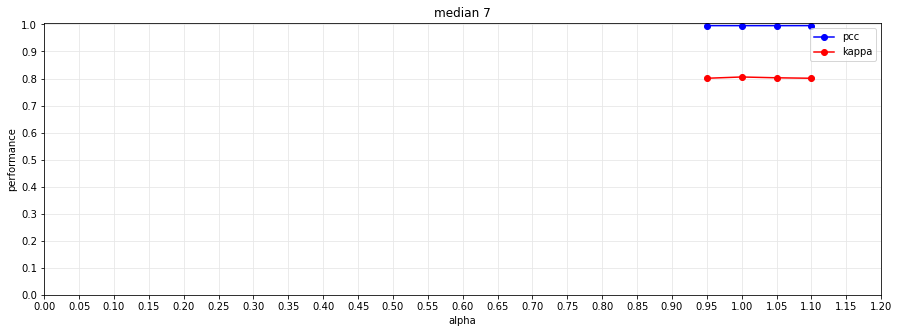

***********************
max pcc is :  0.9955850376927406
max kaapa score is :  0.80565613656736
***********************
     ---------------------------------------------------------------------------------------------------------------


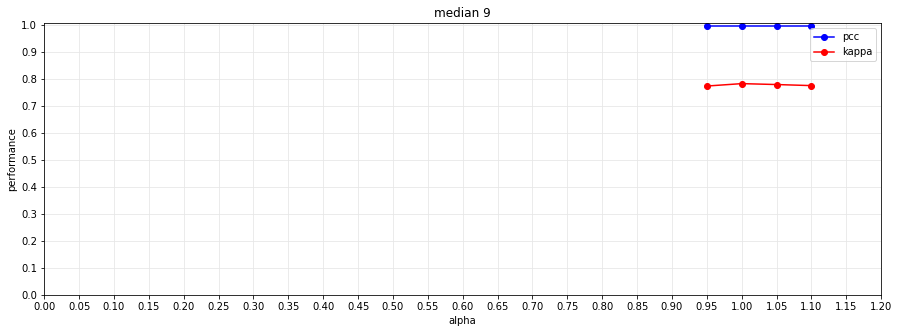

***********************
max pcc is :  0.9949338307524199
max kaapa score is :  0.7816402894092477
***********************
     ---------------------------------------------------------------------------------------------------------------


In [727]:

alpha_set = [  0.95, 1 , 1.05, 1.1 ]
median_kernel=[3,5,7,9]
gs_pcc2=[]
gs_kappa2=[]
bi_pcc2=[]
bi_kappa2=[]
nor_pcc2=[]
nor_kappa2=[]

for kernel in median_kernel:
  for alpha in alpha_set:
    temp_gs_pcc2, temp_gs_kappa2, temp_bi_pcc2, temp_bi_kappa2, temp_nor_pcc2, temp_nor_kappa2 =combined3(data2_morphology1, data2_morphology2 ,data2_im_gt ,alpha, kernel,3, 3,  2,'k-means++' , 500, False)

    gs_pcc2.append(temp_gs_pcc2)
    gs_kappa2.append(temp_gs_kappa2)
    bi_pcc2.append(temp_bi_pcc2)
    bi_kappa2.append(temp_bi_kappa2)
    nor_pcc2.append(temp_nor_pcc2)
    nor_kappa2.append(temp_nor_kappa2)

print('result for gauusian')
alpha_plotter(alpha_set,median_kernel, gs_pcc2, gs_kappa2)
print('result for bilateral')
alpha_plotter(alpha_set,median_kernel, bi_pcc2, bi_kappa2)

print('result for normal')
alpha_plotter(alpha_set,median_kernel, nor_pcc2, nor_kappa2)



-----------------------------------------------------------
alpha is :  0.95
median kernel is :  3
-----------------gaussina----------------
clustering image


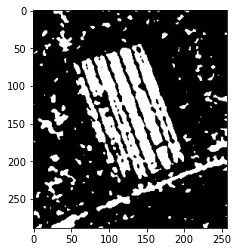

result of k means clustering
True Positive :  11583
True Negative :  54902
False Positive :  5954
False Negative :  1834
the oceral error is :  7788
the percentage correct classification :  0.8951435918839955
kappa score :  0.6836471282086201
-----------------bilteral----------------
clustering image


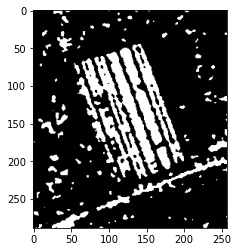

result of k means clustering
True Positive :  10496
True Negative :  56786
False Positive :  4070
False Negative :  2921
the oceral error is :  6991
the percentage correct classification :  0.9058742746354664
kappa score :  0.692303872449451
-----------------normal----------------
clustering image


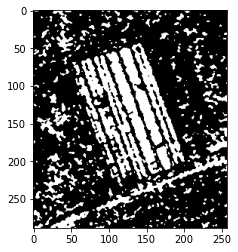

result of k means clustering
True Positive :  10974
True Negative :  52002
False Positive :  8854
False Negative :  2443
the oceral error is :  11297
the percentage correct classification :  0.8478989673232534
kappa score :  0.5668555170930318
-----------------------------------------------------------
alpha is :  1
median kernel is :  3
-----------------gaussina----------------
clustering image


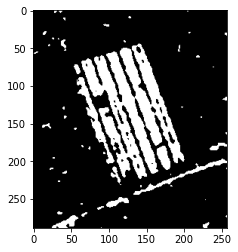

result of k means clustering
True Positive :  11549
True Negative :  58942
False Positive :  1914
False Negative :  1868
the oceral error is :  3782
the percentage correct classification :  0.9490797463412007
kappa score :  0.8282156045497231
-----------------bilteral----------------
clustering image


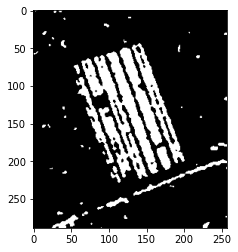

result of k means clustering
True Positive :  11066
True Negative :  59419
False Positive :  1437
False Negative :  2351
the oceral error is :  3788
the percentage correct classification :  0.9489989632841005
kappa score :  0.8230138662327405
-----------------normal----------------
clustering image


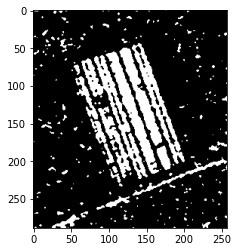

result of k means clustering
True Positive :  11014
True Negative :  58156
False Positive :  2700
False Negative :  2403
the oceral error is :  5103
the percentage correct classification :  0.9312940099363161
kappa score :  0.7698893309034625
-----------------------------------------------------------
alpha is :  1.05
median kernel is :  3
-----------------gaussina----------------
clustering image


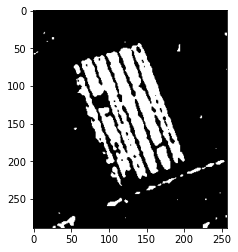

result of k means clustering
True Positive :  11514
True Negative :  59672
False Positive :  1184
False Negative :  1903
the oceral error is :  3087
the percentage correct classification :  0.958437117121969
kappa score :  0.8566010570472606
-----------------bilteral----------------
clustering image


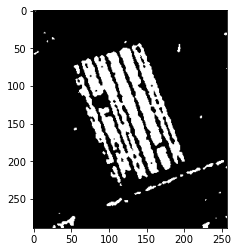

result of k means clustering
True Positive :  11071
True Negative :  59988
False Positive :  868
False Negative :  2346
the oceral error is :  3214
the percentage correct classification :  0.9567272090800156
kappa score :  0.847262028139929
-----------------normal----------------
clustering image


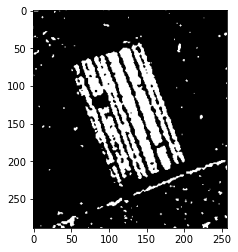

result of k means clustering
True Positive :  11145
True Negative :  59497
False Positive :  1359
False Negative :  2272
the oceral error is :  3631
the percentage correct classification :  0.9511127866115546
kappa score :  0.8303544154019328
-----------------------------------------------------------
alpha is :  1.1
median kernel is :  3
-----------------gaussina----------------
clustering image


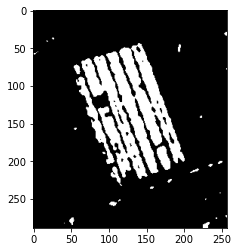

result of k means clustering
True Positive :  11414
True Negative :  59698
False Positive :  1158
False Negative :  2003
the oceral error is :  3161
the percentage correct classification :  0.957440792751067
kappa score :  0.852612578806799
-----------------bilteral----------------
clustering image


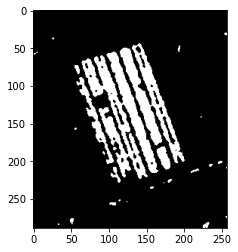

result of k means clustering
True Positive :  10432
True Negative :  60317
False Positive :  539
False Negative :  2985
the oceral error is :  3524
the percentage correct classification :  0.9525534177965075
kappa score :  0.8274604356958999
-----------------normal----------------
clustering image


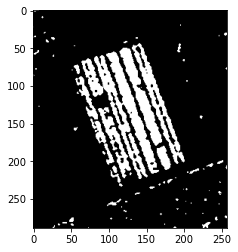

result of k means clustering
True Positive :  10524
True Negative :  60087
False Positive :  769
False Negative :  2893
the oceral error is :  3662
the percentage correct classification :  0.9506954074832038
kappa score :  0.8224912250385588
-----------------------------------------------------------
alpha is :  0.95
median kernel is :  5
-----------------gaussina----------------
clustering image


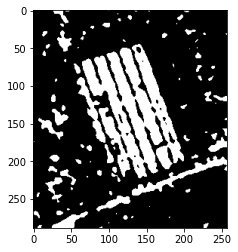

result of k means clustering
True Positive :  11541
True Negative :  55258
False Positive :  5598
False Negative :  1876
the oceral error is :  7474
the percentage correct classification :  0.8993712385389038
kappa score :  0.6932343096933842
-----------------bilteral----------------
clustering image


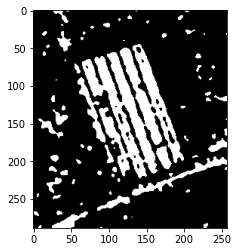

result of k means clustering
True Positive :  10934
True Negative :  56524
False Positive :  4332
False Negative :  2483
the oceral error is :  6815
the percentage correct classification :  0.908243910977071
kappa score :  0.7058387550293747
-----------------normal----------------
clustering image


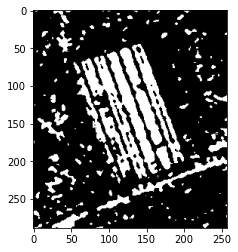

result of k means clustering
True Positive :  10836
True Negative :  55194
False Positive :  5662
False Negative :  2581
the oceral error is :  8243
the percentage correct classification :  0.8890175433872336
kappa score :  0.6558886875409462
-----------------------------------------------------------
alpha is :  1
median kernel is :  5
-----------------gaussina----------------
clustering image


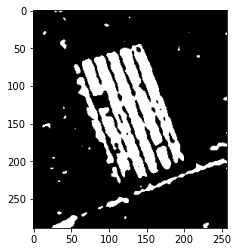

result of k means clustering
True Positive :  11768
True Negative :  58663
False Positive :  2193
False Negative :  1649
the oceral error is :  3842
the percentage correct classification :  0.9482719157701991
kappa score :  0.827975651222035
-----------------bilteral----------------
clustering image


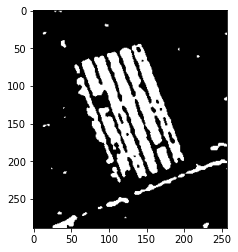

result of k means clustering
True Positive :  11291
True Negative :  59269
False Positive :  1587
False Negative :  2126
the oceral error is :  3713
the percentage correct classification :  0.9500087514978525
kappa score :  0.8284380129597635
-----------------normal----------------
clustering image


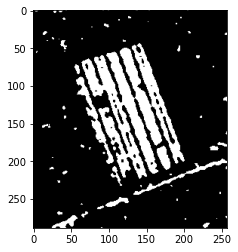

result of k means clustering
True Positive :  11063
True Negative :  59155
False Positive :  1701
False Negative :  2354
the oceral error is :  4055
the percentage correct classification :  0.9454041172431435
kappa score :  0.8120031494722038
-----------------------------------------------------------
alpha is :  1.05
median kernel is :  5
-----------------gaussina----------------
clustering image


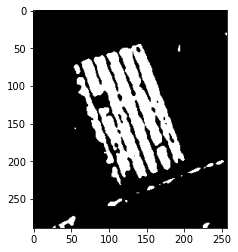

result of k means clustering
True Positive :  11612
True Negative :  59447
False Positive :  1409
False Negative :  1805
the oceral error is :  3214
the percentage correct classification :  0.9567272090800156
kappa score :  0.8521187808339321
-----------------bilteral----------------
clustering image


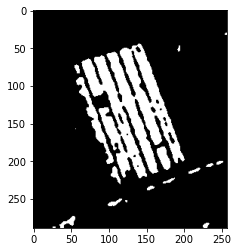

result of k means clustering
True Positive :  11203
True Negative :  59809
False Positive :  1047
False Negative :  2214
the oceral error is :  3261
the percentage correct classification :  0.9560944084660644
kappa score :  0.8464776919386859
-----------------normal----------------
clustering image


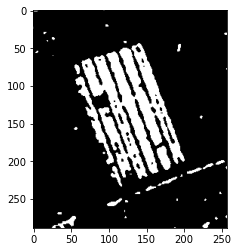

result of k means clustering
True Positive :  11322
True Negative :  59696
False Positive :  1160
False Negative :  2095
the oceral error is :  3255
the percentage correct classification :  0.9561751915231645
kappa score :  0.8478217735304487
-----------------------------------------------------------
alpha is :  1.1
median kernel is :  5
-----------------gaussina----------------
clustering image


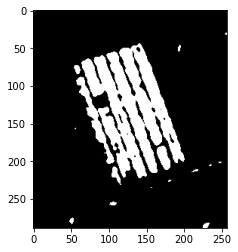

result of k means clustering
True Positive :  11540
True Negative :  59385
False Positive :  1471
False Negative :  1877
the oceral error is :  3348
the percentage correct classification :  0.9549230541381121
kappa score :  0.8459079443219963
-----------------bilteral----------------
clustering image


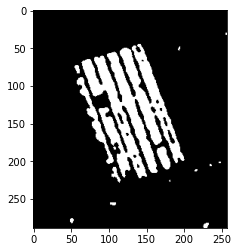

result of k means clustering
True Positive :  10643
True Negative :  60063
False Positive :  793
False Negative :  2774
the oceral error is :  3567
the percentage correct classification :  0.9519744725539564
kappa score :  0.8278583052960626
-----------------normal----------------
clustering image


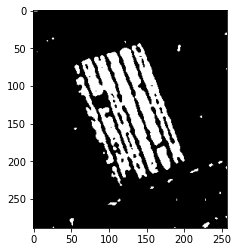

result of k means clustering
True Positive :  10671
True Negative :  60100
False Positive :  756
False Negative :  2746
the oceral error is :  3502
the percentage correct classification :  0.952849622339208
kappa score :  0.8309482763626339
-----------------------------------------------------------
alpha is :  0.95
median kernel is :  7
-----------------gaussina----------------
clustering image


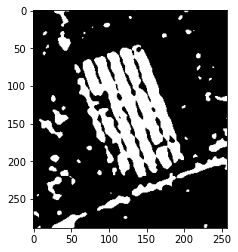

result of k means clustering
True Positive :  11456
True Negative :  55616
False Positive :  5240
False Negative :  1961
the oceral error is :  7201
the percentage correct classification :  0.903046867636961
kappa score :  0.7009666101191097
-----------------bilteral----------------
clustering image


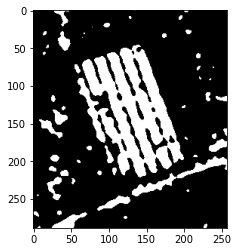

result of k means clustering
True Positive :  11296
True Negative :  55895
False Positive :  4961
False Negative :  2121
the oceral error is :  7082
the percentage correct classification :  0.9046490649361141
kappa score :  0.7024435840970937
-----------------normal----------------
clustering image


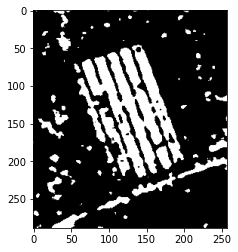

result of k means clustering
True Positive :  10879
True Negative :  56202
False Positive :  4654
False Negative :  2538
the oceral error is :  7192
the percentage correct classification :  0.9031680422226112
kappa score :  0.6918344049297116
-----------------------------------------------------------
alpha is :  1
median kernel is :  7
-----------------gaussina----------------
clustering image


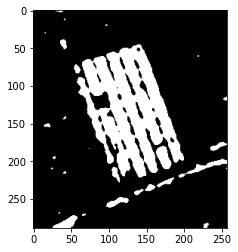

result of k means clustering
True Positive :  11943
True Negative :  58070
False Positive :  2786
False Negative :  1474
the oceral error is :  4260
the percentage correct classification :  0.9426440294588881
kappa score :  0.8133590892847447
-----------------bilteral----------------
clustering image


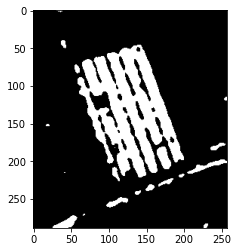

result of k means clustering
True Positive :  11539
True Negative :  58828
False Positive :  2028
False Negative :  1878
the oceral error is :  3906
the percentage correct classification :  0.9474102298277974
kappa score :  0.8231170156968342
-----------------normal----------------
clustering image


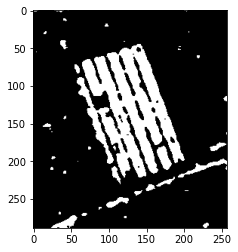

result of k means clustering
True Positive :  11526
True Negative :  58679
False Positive :  2177
False Negative :  1891
the oceral error is :  4068
the percentage correct classification :  0.9452290872860932
kappa score :  0.8165026719319997
-----------------------------------------------------------
alpha is :  1.05
median kernel is :  7
-----------------gaussina----------------
clustering image


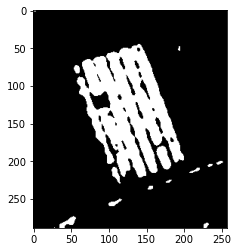

result of k means clustering
True Positive :  11719
True Negative :  58816
False Positive :  2040
False Negative :  1698
the oceral error is :  3738
the percentage correct classification :  0.9496721554266019
kappa score :  0.8316597481438599
-----------------bilteral----------------
clustering image


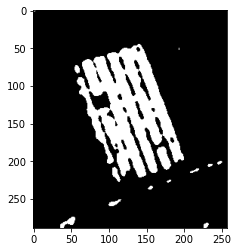

result of k means clustering
True Positive :  11379
True Negative :  59265
False Positive :  1591
False Negative :  2038
the oceral error is :  3629
the percentage correct classification :  0.9511397142972547
kappa score :  0.8327733367140738
-----------------normal----------------
clustering image


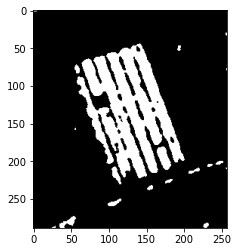

result of k means clustering
True Positive :  11462
True Negative :  59377
False Positive :  1479
False Negative :  1955
the oceral error is :  3434
the percentage correct classification :  0.9537651636530099
kappa score :  0.8416238831376193
-----------------------------------------------------------
alpha is :  1.1
median kernel is :  7
-----------------gaussina----------------
clustering image


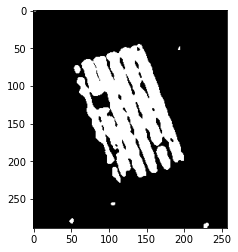

result of k means clustering
True Positive :  11602
True Negative :  58722
False Positive :  2134
False Negative :  1815
the oceral error is :  3949
the percentage correct classification :  0.9468312845852463
kappa score :  0.822039661129029
-----------------bilteral----------------
clustering image


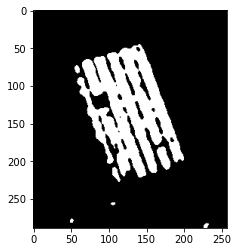

result of k means clustering
True Positive :  11125
True Negative :  59385
False Positive :  1471
False Negative :  2292
the oceral error is :  3763
the percentage correct classification :  0.9493355593553512
kappa score :  0.8246685424003313
-----------------normal----------------
clustering image


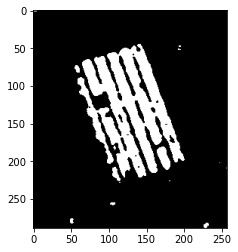

result of k means clustering
True Positive :  10767
True Negative :  59779
False Positive :  1077
False Negative :  2650
the oceral error is :  3727
the percentage correct classification :  0.9498202576979522
kappa score :  0.8223706756043224
result for gauusian


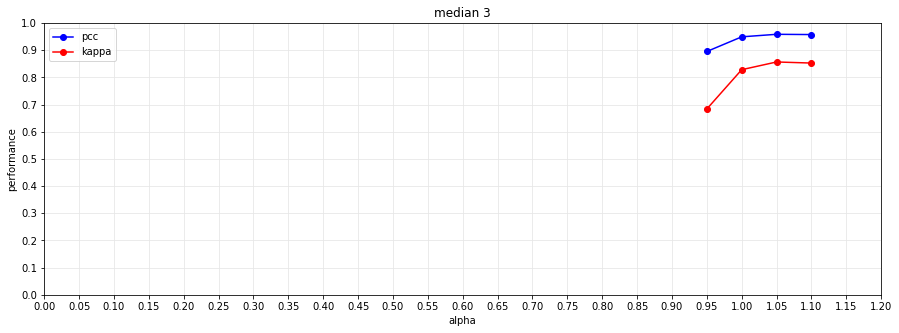

***********************
max pcc is :  0.958437117121969
max kaapa score is :  0.8566010570472606
***********************
     ---------------------------------------------------------------------------------------------------------------


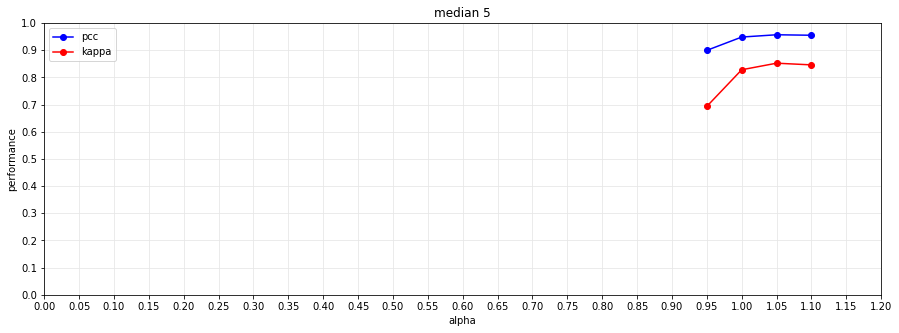

***********************
max pcc is :  0.9567272090800156
max kaapa score is :  0.8521187808339321
***********************
     ---------------------------------------------------------------------------------------------------------------


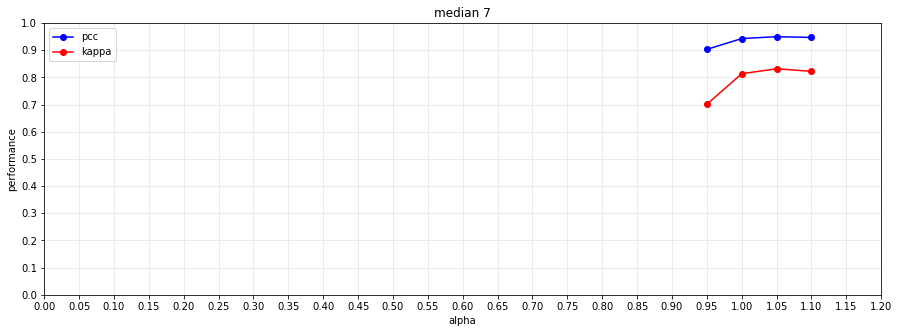

***********************
max pcc is :  0.9496721554266019
max kaapa score is :  0.8316597481438599
***********************
     ---------------------------------------------------------------------------------------------------------------
result for bilateral


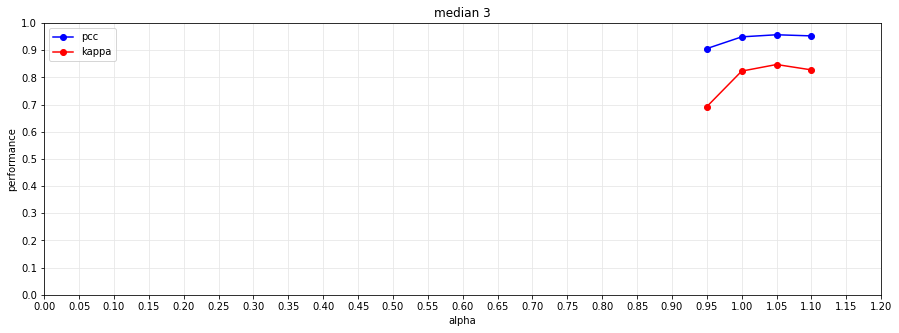

***********************
max pcc is :  0.9567272090800156
max kaapa score is :  0.847262028139929
***********************
     ---------------------------------------------------------------------------------------------------------------


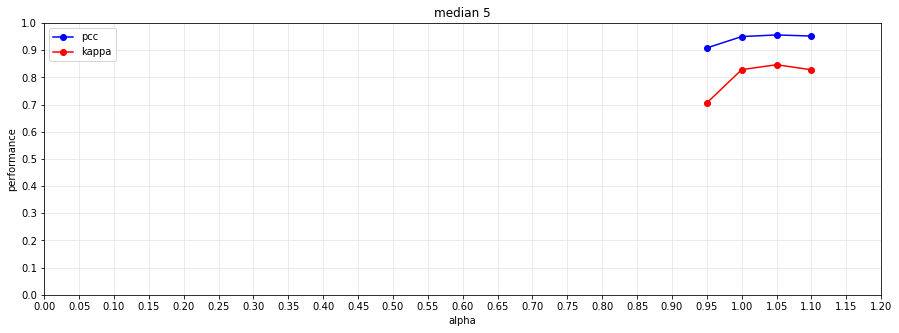

***********************
max pcc is :  0.9560944084660644
max kaapa score is :  0.8464776919386859
***********************
     ---------------------------------------------------------------------------------------------------------------


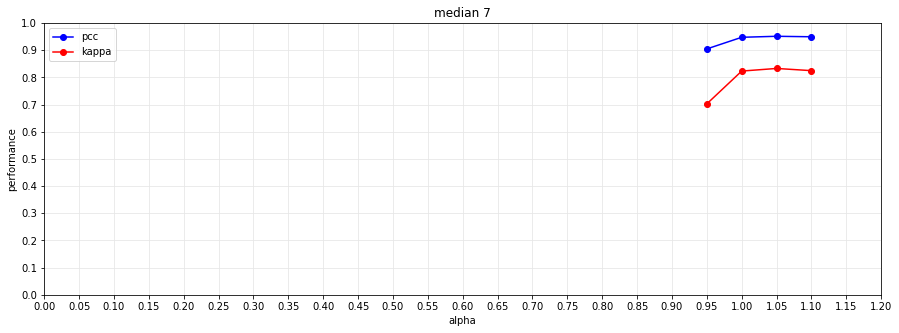

***********************
max pcc is :  0.9511397142972547
max kaapa score is :  0.8327733367140738
***********************
     ---------------------------------------------------------------------------------------------------------------
result for normal


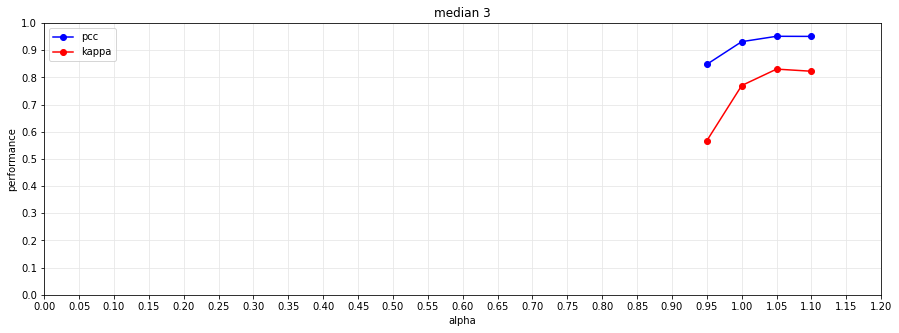

***********************
max pcc is :  0.9511127866115546
max kaapa score is :  0.8303544154019328
***********************
     ---------------------------------------------------------------------------------------------------------------


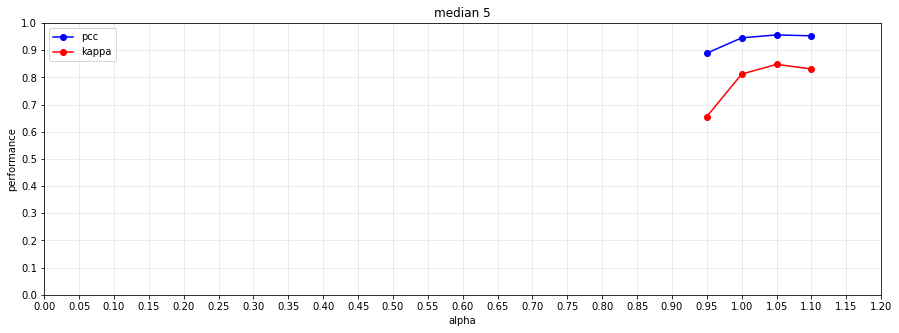

***********************
max pcc is :  0.9561751915231645
max kaapa score is :  0.8478217735304487
***********************
     ---------------------------------------------------------------------------------------------------------------


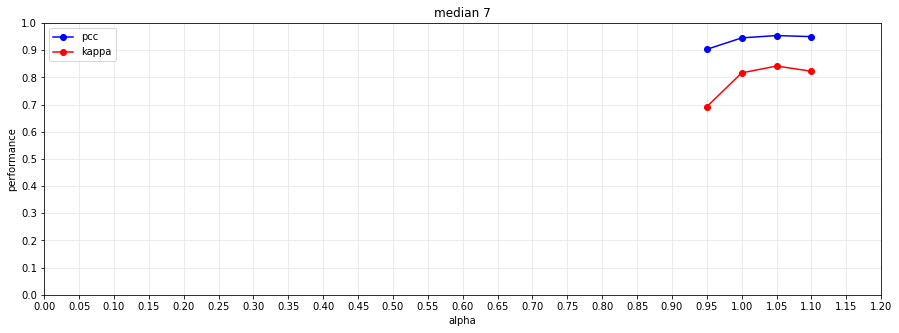

***********************
max pcc is :  0.9537651636530099
max kaapa score is :  0.8416238831376193
***********************
     ---------------------------------------------------------------------------------------------------------------


In [731]:

alpha_set = [  0.95, 1 , 1.05, 1.1 ]
median_kernel=[3,5,7]

gs_pcc3=[]
gs_kappa3=[]
bi_pcc3=[]
bi_kappa3=[]
nor_pcc3=[]
nor_kappa3=[]


for kernel in median_kernel:
  for alpha in alpha_set:
    temp_gs_pcc3, temp_gs_kappa3, temp_bi_pcc3, temp_bi_kappa3, temp_nor_pcc3, temp_nor_kappa3 =combined2(data3_morphology1, data3_morphology2 ,data3_im_gt ,alpha, kernel,7,7,  2,'k-means++' , 500, False)

    gs_pcc3.append(temp_gs_pcc3)
    gs_kappa3.append(temp_gs_kappa3)
    bi_pcc3.append(temp_bi_pcc3)
    bi_kappa3.append(temp_bi_kappa3)
    nor_pcc3.append(temp_nor_pcc3)
    nor_kappa3.append(temp_nor_kappa3)

print('result for gauusian')
alpha_plotter(alpha_set,median_kernel, gs_pcc3, gs_kappa3)
print('result for bilateral')
alpha_plotter(alpha_set,median_kernel, bi_pcc3, bi_kappa3)

print('result for normal')
alpha_plotter(alpha_set,median_kernel, nor_pcc3, nor_kappa3)

